# Train bidiractional LSTM RNN Functions 3cl


All functions and run example

In [4]:
import pandas as pd
import numpy as np
import time
import random
from string import ascii_letters, ascii_lowercase

from sklearn import preprocessing
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from keras import backend as K
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Dropout, Embedding, LSTM, Bidirectional
from keras.callbacks import EarlyStopping
from scipy.stats import mode

import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import clear_output
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
! pwd

/Users/michal/diploma/Hi-ChIP-ML/models/NN_models


# Functions

In [6]:
def main_analysis(data_path,  
                  cell_line, 
                  bioset, 
                  num_experements, 
                  sequenc_len_list = [6], 
                  num_lstm_units = 6, 
                  batch_size = 160, 
                  num_folds = 4,
                  min_delta = 0.001,
                  patience = 5,
                  do_only_1_feature_exps = True, 
                  do_drop_1_feature_exps = True,
                  do_all_together = False, 
                  use_chr_onehotenc=True,
                  use_coord_scale=True, 
                  verbose=True,
                 ):
    data_original = load_data(data_path, index_col=0, verbose=verbose)
    data = proccess_data(data_original, cell_line, bioset, 
                         use_chr_onehotenc=use_chr_onehotenc,
                         use_coord_scale=use_coord_scale)

    target_original, target = get_target(target_path, cell_line, verbose=verbose)
    # data_scaled_clean, target_clean, empty_chr_names, num_empty_bins = data, target, [], [] # cleanDataTarget(data, target)
    target_clean = target['gamma']  # target_clean[['gamma']]
    data_scaled_clean, target_clean = data, target_clean

    if verbose:
        print('data_original.head =', data_original.head())
        print('proccessed data.head =', data.head())
        print('proccessed data.shape =', data.shape)

        print('target_original.head =', target_original.head())
        print('proccessed target.shape =', target.shape)
        print('data_scaled_clean.shape, target_clean.shape =', 
              data_scaled_clean.shape, target_clean.shape)

    # Features correlation matrix
    d = data_original.copy()
    d['target'] = target_original.gamma
    corrs = correlationHeatmap(d, title="Features correlation - Original - c.l. " + cell_line)

    d = data_scaled_clean.copy()
    d['target'] = target_clean # gamma
    corrs = correlationHeatmap(d, title="Features correlation - scaled - c.l. " + cell_line)

    eval_models_df = pd.DataFrame(columns=["exper_num", "sequenc_len", "num_lstm_units", "n_epochs",
                                   "weighted_mse_test", "weighted_mse_train", "weighted_mse_val",
                                   "weighted_mse_test_const",
                                   "batch_size", "duration",
                                   "missing_feature"]) # , 'feature']) 

    eval_models_df_1, eval_models_df_drop, \
        feature_score_1, feature_score_drop = train_1_and_drop(data_scaled_clean=data_scaled_clean,
                                                         target_clean=target_clean,
                                                         eval_models_df=eval_models_df, 
                                                         sequenc_len_list =  sequenc_len_list,
                                                         num_lstm_units = num_lstm_units,
                                                         batch_size=batch_size,
                                                         n_epochs_max = n_epochs_max, 
                                                         num_experements = num_experements,
                                                         num_folds = num_folds,
                                                         min_delta = min_delta,
                                                         patience = patience,
                                                         file_path = file_path, 
                                                         random_state = random_state,
                                                         do_only_1_feature_exps = do_only_1_feature_exps,
                                                         do_drop_1_feature_exps = do_drop_1_feature_exps)

    mean_test_together, std_test_together = None, None
    if do_all_together:
        # print('\n-----\n use all FEATURES -- ' + len(data_scaled_clean) + '\n-----\n')
        # Use all features
        eval_models_df_together = pd.DataFrame(columns=["exper_num", "sequenc_len", "num_lstm_units", "n_epochs",
                                   "weighted_mse_test", "weighted_mse_train", "weighted_mse_val",
                                   "weighted_mse_test_const",
                                   "batch_size", "duration",
                                   "missing_feature"]) 
        get_full_model_experiments(
            data_scaled_clean, target_clean, eval_models_df_together, 
            sequenc_len_list =  sequenc_len_list ,#
            num_lstm_units = num_lstm_units,
            batch_size=batch_size,
            n_epochs_max = n_epochs_max, 
            num_experements = num_experements,
            num_folds = num_folds,
            min_delta = min_delta,
            patience = patience,
            file_path = file_path, 
            missing_feature = -1)

        mean_test_together = eval_models_df_together[eval_models_df_together['exper_num'] == 'mean']['weighted_mse_test']
        std_test_together = eval_models_df_together[eval_models_df_together['exper_num'] == 'std']['weighted_mse_test']

    return eval_models_df_1, eval_models_df_drop, eval_models_df_together, \
             mean_test_together, std_test_together, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, 


In [7]:
def plotData(data, ncols, nrows, method = 'hist', is_sharex=True, share_axes='y', bins=50, 
             plt_title='Histograms of data features', figsize=(20, 18), 
             cmin=None, cmax=None, min_val=None, max_val=None,
             verbose=False, fig=None, axes=None, alpha=0.6):
    if (min_val is None or  max_val is None):
        min_val, max_val = min(np.min(data)) - 3, max(np.max(data))
    if (fig is None or axes is None):
        if (share_axes == 'xy'):
            fig, axes = plt.subplots(ncols=ncols, nrows=nrows, figsize=figsize, 
                                     sharex='all', sharey='all')
        else:
            fig, axes = plt.subplots(ncols=ncols, nrows=nrows, figsize=figsize,
                                     sharex=is_sharex)
    fig.set_figheight(24)
    i = 0
    for row in range(nrows):
        if i >= len(data.columns):
                break      
        for col in range(ncols):
            if i >= len(data.columns):
                break
            axes[row][col].set_title(data.columns[i], fontsize=22)       
            if method == "hist":
                if (cmin is not None and  cmax is not None):
                    axes[row][col].hist(data[[data.columns[i]]].values, bins=bins, range=(cmin, cmax), alpha=0.6, label=plt_title) # cmin=cmin, cmax=cmax)
                else:
                    axes[row][col].hist(data[[data.columns[i]]].values, bins=bins, alpha=alpha, label=plt_title) # cmin=cmin, cmax=cmax)
                if is_sharex or share_axes == 'xy':
                    axes[row][col].set_xlim(min_val, max_val)
                
            elif method == "original":
                axes[row][col].scatter(np.arange(0, data.shape[0]), data[[data.columns[i]]].values,)
                if is_sharex or share_axes == 'xy':
                    axes[row][col].set_ylim(min_val, max_val)
                    
            if verbose:
                print(i)   
                print(data[[data.columns[i]]].mean(), data[[data.columns[i]]].std(), data[[data.columns[i]]].min(), data[[data.columns[i]]].max())
            i += 1
    plt.suptitle(plt_title, fontsize=30, y=0.92)
    # return fig, axes   


def correlationHeatmap(data, title="Features corrselation - scaled", figsize=(11, 9)):
    sns.set(style="white")
    # Generate a large random dataset
    rs = np.random.RandomState(33)
    # Compute the corrselation matrix
    corrs = data.corr()
    # Generate a mask for the upper triangle
    mask = np.zeros_like(corrs, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=figsize)
    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # # Draw the heatmap with the mask and corrsect aspect ratio
    # sns.heatmap(corrs, mask=mask, cmap=cmap, vmax=.3, center=0,
    #             square=True, linewidths=.5, cbar_kws={"shrink": .5})
    sns.heatmap(corrs, cmap=cmap, square=True, linewidths=.5, 
                cbar_kws={"shrink": .5})
    ax.set_title(title)
    plt.show()
    g = sns.clustermap(corrs,     
                       cmap = sns.diverging_palette(220, 10, as_cmap=True) ) 
    plt.title("Features corrselation - scaled sorted - c.l." + cell_line)
    plt.show()
    print(corrs['target'], corrs.index[np.argsort(corrs['target'])])
    return(corrs)


def OneHotEncode(data_feature, feature_preffix="", verbose=True):
    # Integer encode
    label_encoder = LabelEncoder()
    integer_encoded = label_encoder.fit_transform(data_feature.values)
    # Binary encode
    onehot_encoder = OneHotEncoder(sparse=False, categories='auto')
    integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
    onehot_encoded = onehot_encoder.fit_transform(integer_encoded)
    
    onehot_df = pd.DataFrame(onehot_encoded, 
                             columns = feature_preffix + label_encoder.classes_, 
                             index = data_feature.index )
    if verbose: 
        print("values: ", data_feature.values)
        print("integer values: ", integer_encoded.shape, integer_encoded)
        print("one-hot values: ", onehot_encoded.shape, onehot_encoded)
        ## Invert first example
        # inverted = label_encoder.inverse_transform([argmax(onehot_encoded[0, :])])
        # print("inversed of ", data_feature[0], " is ", inverted)
    return onehot_df, onehot_encoder, label_encoder


def load_data(data_path, index_col=0, verbose=True):
    data = pd.read_csv(data_path, index_col=index_col)
    if verbose:
        print('data.shape = ', data.shape)
        # print(data.head())
        print('column names =', data.columns.values)
    return(data)


def proccess_data(data_original, 
                  cell_line, 
                  bioset, 
                  do_scaling=True,
                  use_chr_onehotenc=True, 
                  use_coord_scale=True,
                  do_plots=True,
                  coord_scale_const=10000000,
                  verbose=True,
                 ):
    ''' Proccess data
         - Drop 'chrN', 'start_coord'
         - Use Biological Dataset if defined
         - Use 1 Cell Line if cell_line is not 'all'
         - Scaling for the non-binary data (specified in the list of features) if do_scaling=True
         - One Hot Encoding of the Chromasome Number feature 'ChrN' if use_chr_onehotenc=True
         - Start coordinate number of the bin scale: devide by const
         - Plot original and proccessed features if do_plots=Trues
         
    '''
    data = data_original.copy()
    
    if bioset:
        data = data[bioset]
        print("Using features bioset:", bioset)
    
    if cell_line != 'all':
        data = data[data[cell_line] == 1]
        data = data.drop(['is_s2', 'is_kc', 'is_bg'], axis=1)
        print("Using cell line:", cell_line)

    if do_scaling:
        features_to_scale = data.columns[[f not in ['chrN', 
                                                    'start_coord', 
                                                    'is_s2', 'is_kc', 'is_bg'] for f in data.columns]]
        data[features_to_scale] = preprocessing.scale(data[features_to_scale],
                                          axis=0, with_mean=True, with_std=True)
        print("Scaling of the features:", features_to_scale)
    
    if use_chr_onehotenc:
        onehot_df_chr, onehot_encoder, label_encoder = OneHotEncode(data['chrN'], 
                                                            feature_preffix="", 
                                                            verbose=False)
        data = pd.concat([onehot_df_chr, data.drop(['chrN'], axis=1)], axis=1)
        print("Using chromosome One Hot Encoding:", np.unique(data_original['chrN']))
    else:  
        # drop chrN column - not to work with strings
        data = data.drop(['chrN'], axis=1)
        
        
    if use_coord_scale:
        data[['start_coord']] = data[['start_coord']] / coord_scale_const
        
    if verbose:
        # print('proccessed data.head =', data.head())
        print('proccessed data.shape =', data.shape)
    
    # Plot features 
    if do_plots:
        ncols = 3
        nrows = data_original.shape[1] // ncols + 1
        plotData(data_original[data_original.columns[data_original.columns != 'chrN']],
                 ncols, nrows, bins=30, method = 'original', figsize=(20, 10),
                 is_sharex=False, plt_title='Original data features (ChIP-Seq) - c.l.' + cell_line)
        plotData(data_original[data_original.columns[data_original.columns != 'chrN']], ncols, nrows, 
                 bins=30, method = 'hist', is_sharex = False, 
                 plt_title='Histograms of original data features - c.l. ' + cell_line)


        nrows = data.shape[1] // ncols + 1
        plotData(data, ncols, nrows, bins=30, method = 'original', figsize=(20, 10),
                 is_sharex=False, plt_title='Proccessed data features (ChIP-Seq) - c.l. ' + cell_line)
        plotData(data, ncols, nrows, bins=30, method = 'hist', is_sharex = True, 
                 plt_title='Histograms of proccesed data features - c.l. ' + cell_line)
    return data

def load_target(target_path):
    target = pd.read_csv(target_path, index_col=0)
    if cell_line:
        target = target[target[cell_line] == 1]
        target = target.drop(['is_s2', 'is_kc', 'is_bg'], axis=1)
    print('target.shape =', target.shape)
    print('target.column =', target.columns)
    target.head()


def get_target(target_path, cell_line, verbose=True):
    target_original = pd.read_csv(target_path, index_col=0)

    if cell_line != 'all':
        target = target_original[target_original[cell_line] == 1]
        target = target.drop(['is_s2', 'is_kc', 'is_bg'], axis=1)
    else:
        target = target_original.copy()  

    if verbose:
        print('original target.shape =', target_original.shape)
        print('target.columns =', target_original.columns)
        target_original.head()

        print('target.shape =', target.shape)
        print('target.column =', target.columns)
        target.head()
        
    return target_original, target
    


def findEmptyChr(data, verbose=True):
    '''Find empty chromosoms.'''
    chr_names = np.unique(data['chrN'])
    empty_chr_names = []
    num_empty_bins = 0

    for chr_i in chr_names:
        gamma_sum = sum(data[data.chrN == chr_i].gamma)
        if (verbose):
            print("---\nChr name =", chr_i)
            print("Sum of gamma values =", gamma_sum)
            print("Number of bins =", len(data[data.chrN == chr_i]))

        if (gamma_sum == 0):
            empty_chr_names.append(chr_i)
            num_empty_bins += len(data[data.chrN == chr_i])
    print("===")
    print("Total num of chr =", len(chr_names), "\n", chr_names)
    print("Num of empty chr =", len(empty_chr_names), "\n", empty_chr_names)
    print("Total num of chr =", len(data.index))
    print("Num of empty bins =", num_empty_bins)
    
    return(empty_chr_names, num_empty_bins)


def cleanDataTarget(data, target, ncols = 3, do_plots=True, verbose=True):
    ''' Remove empty (zeros) chromosomes from data and target '''
    
    empty_chr_names, num_empty_bins = findEmptyChr(target, verbose)
    
    if num_empty_bins > 0:
        data_scaled_clean = data[~target.chrN.isin(empty_chr_names)]
        target_clean = target[~target.chrN.isin(empty_chr_names)]
    
    # Plot features 
    if do_plots:
        nrows = data_scaled_clean.shape[1] // ncols 
        plotData(data_scaled_clean, ncols, nrows, bins=30, method = 'original', figsize=(20, 10),
                 is_sharex=False, plt_title='Clean proccessed data features (ChIP-Seq) - c.l. ' + cell_line)
        plotData(data_scaled_clean, ncols, nrows, bins=30, method = 'hist', is_sharex = True, 
                 plt_title='Histograms of clean proccessed data features - c.l. ' + cell_line)
        
    return (data_scaled_clean, target_clean, empty_chr_names, num_empty_bins)

# ====================================================================== 
# FULL Experiment FUNCTIONS

In [8]:
def split_data_middle_target(data, target, sequenc_len = 6, 
                             overlop_len = 1, random_state=16, 
                             test_size=0.3, val_size=0.3, 
                             shuffle=True):
    '''
    для последовательности мы предсказываем значение целой переменной "центрального" элемента.
    по формуле: int(seq_lenght / 2 ) ( - 1 - т.к. индексация с нуля )
    округление вниз до ближайшего целого
    =>
    То есть в последовательности длины 7, мы каждый раз предсказываем значение 3-го элемента.
    в последовательности длины 6, мы каждый раз предсказываем значение 3-го элемента.
    в последовательности длины 5, мы каждый раз предсказываем значение 2-го элемента.
    в последовательности длины 9, мы каждый раз предсказываем значение 4-го элемента.
    =>
    if random_state is None - shuffel the splitting
    '''
    mid_indx = max(int(sequenc_len/2 + 0.5)-1, 0)
    
    sequenc_data = []
    sequenc_targets = []

    for obj_i in range(len(data)  - sequenc_len + 1):
        sequenc_data.append(data[obj_i: obj_i + sequenc_len]) 
        sequenc_targets.append(target[obj_i + mid_indx] )

    sequenc_data = np.array(sequenc_data)
    sequenc_targets = np.array(sequenc_targets)
    X, y = sequenc_data, sequenc_targets 

    if (random_state is None):
        # if random_state is None - shuffel the splitting
        random_state = random.randint(0, 10000)
    
    # split and mix learning samples
    X_train, X_test, y_train, y_test = train_test_split(X[:], y[:], test_size=test_size, 
                                                        random_state=random_state, shuffle=shuffle)
    
    X_test, X_val, y_test, y_val = train_test_split(X_test[:], y_test[:], test_size=val_size,
                                                    random_state=random_state, shuffle=shuffle)
    
    print('X_train.shape, X_test.shape, y_train.shape, y_test.shape =',
          X_train.shape, X_test.shape, y_train.shape, y_test.shape)
    
    return X_train, X_test, X_val, y_train, y_test, y_val, sequenc_data, sequenc_targets

In [9]:
def weighted_mse(y_true, y_pred, const_scale=11):   
    diff = ((y_true - y_pred)**2) * (const_scale - y_true) / const_scale # / 11
    return  K.mean(diff)  # K.mean(K.sum(diff, axis = -1)) # 

def mae_cout(y_true, y_pred):
    y_pred = np.hstack(y_pred)
    
    return np.mean(np.abs(y_true - y_pred))

def rmse_cout(y_true, y_pred):
    y_pred = np.hstack(y_pred)
    return np.sqrt(np.mean((y_true - y_pred)**2))

def weighted_mse_cout(y_true, y_pred, const_scale=11):
    y_pred = np.hstack(y_pred)
    return np.mean(((y_true - y_pred)**2) * (const_scale - y_true)) / const_scale  # / 11 ) 

def count_errors_by_target_grid(y_true, y_pred, const_scale=11):
    if (len(y_true) != len(y_pred)):
         return "ERROR of prediction and true size"
    
    mae_errors_by_grid = np.array([0]*const_scale, dtype=float)    
    rmse_errors_by_grid = np.array([0]*const_scale, dtype=float)    
    weig_mse_errors_by_grid = np.array([0]*const_scale, dtype=float)
    objs_by_grid = np.array([0]*const_scale, dtype=float)

    for i in range(len(y_true)):  # K.int_shape(y_true)):
        mae_errors_by_grid[int(y_true[i])] += np.abs(y_true[i] - y_pred[i]) # (y_true[i] - y_pred[i])**2 # mse
        rmse_errors_by_grid[int(y_true[i])] += (y_true[i] - y_pred[i])**2 # mse
        weig_mse_errors_by_grid[int(y_true[i])] += (y_true[i] - y_pred[i])**2 * (const_scale - y_true[i]) 
        objs_by_grid[int(y_true[i])] += 1
      
    mae_errors_by_grid /= objs_by_grid
    rmse_errors_by_grid /= objs_by_grid
    rmse_errors_by_grid = np.sqrt(rmse_errors_by_grid)
    weig_mse_errors_by_grid /= objs_by_grid
    
    return mae_errors_by_grid, rmse_errors_by_grid, weig_mse_errors_by_grid, objs_by_grid


def plot_train_res(history):
    # list all data in history
    print(history.history.keys())
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss - weighted mse')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

    # summarize history for MSE
    plt.plot(history.history['mean_squared_error'])
    plt.plot(history.history['val_mean_squared_error'])
    plt.title('model mean squared error')
    plt.ylabel('mse')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    
def count_plot_test_errors(model, x_test, y_test):
    y_pred_test = model.predict(x_test)
    print("test sizes = ", len(y_test), len(x_test), len(y_pred_test))

    mae_errors_by_grid, rmse_errors_by_grid, \
        weig_mse_errors_by_grid, objs_by_grid = count_errors_by_target_grid(y_test, y_pred_test)
    return mae_errors_by_grid, rmse_errors_by_grid, weig_mse_errors_by_grid, objs_by_grid

# Add colums to 
def add_columns(new_col_names, df):
    for col_name in new_col_names:
        df[col_name] = -1 + np.zeros_like(eval_models_df["model"])
    return df

do_add_columns = False
if do_add_columns:
    new_col_names = ["mae_errors_by_grid_const", "rmse_errors_by_grid_const", "weig_mse_errors_by_grid_const"]
    eval_models_df = add_columns(new_col_names, df=eval_models_df)

In [10]:
def biLSTM_Train_Test(x_train, x_test, x_val, 
                      y_train, y_test, y_val,
                      sequenc_data, sequenc_targets,
                      data, target, 
                      sequenc_len = 6,
                      num_lstm_units = 64,
                      num_epochs=3,
                      BATCH_SIZE = 32,
                      num_features = 5,
                      min_delta = 0.000001,
                      dropout_rat = 0.3,
                      patience = 5,
                      opt_name = 'adam',
                      loss = weighted_mse,
                      metrics = [weighted_mse, 'mse'],
                      rnn_cell_type = "Bidirectional LSTM",
                      overlop_len = -1,
                      output_size = 1,
                      const_scale = 11,
                      random_state = 16):
    start_time = time.time()
    
    # BiLSTM RNN model:
    model = Sequential()
    model.add(Bidirectional(LSTM(num_lstm_units), input_shape=(sequenc_len, num_features)))
    model.add(Dropout(dropout_rat))
    model.add(Dense(output_size))
    
    # Define early stopping callback
    print('min_delta = ',min_delta,
         'patience = ', patience)
    early_stopping_monitor = EarlyStopping(monitor='val_loss', 
                                           min_delta=min_delta, 
                                           patience=patience,
                                           verbose=1, mode='auto') # monitor='val_weighted_mse', mode='min', min_delta=0.000001)
    print('Train... with ')
    model.compile(opt_name, loss = loss, metrics = metrics)  # , mae_by_target_grid])
    history = model.fit(x_train, y_train,
                        batch_size=BATCH_SIZE,
                        epochs=num_epochs,
                        validation_data=[x_val, y_val], 
                        callbacks=[early_stopping_monitor], 
                        verbose=False)
    # plot_train_res(history)
    n_epochs_past = len(history.history["loss"])
    
    # ------------ PREDICTION -------------------------------------------------------------
    y_pred_test = model.predict(x_test)
    y_pred_train = model.predict(x_train)
    y_pred_val = model.predict(x_val)
    
    # -------------------------------------------------------------------------
    #          TEST PREDICTION Error
    # -------------------------------------------------------------------------
    weighted_mse_test = weighted_mse_cout(y_true = y_test, y_pred = y_pred_test, const_scale=const_scale)
    # -------------------------------------------------------------------------
    #          TRAIN PREDICTION Error
    # -------------------------------------------------------------------------
    weighted_mse_train = weighted_mse_cout(y_true = y_train, y_pred = y_pred_train, const_scale=const_scale)
    # -------------------------------------------------------------------------
    #          VAL PREDICTION Error
    # -------------------------------------------------------------------------
    weighted_mse_val = weighted_mse_cout(y_true = y_val, y_pred = y_pred_val, const_scale=const_scale)
    # -------------------------------------------------------------------------
    #          TEST Const Error
    # -------------------------------------------------------------------------
    const_pred = np.mean(y_train)
    const_pred_test = np.array([const_pred] * len(y_test))
    weighted_mse_test_const = weighted_mse_cout(y_true = y_test, 
                                                y_pred = const_pred_test, 
                                                const_scale=const_scale)

    # -- Duration --    
    end_time = time.time()
    duration = end_time - start_time 
    print("duration:", duration)
    
    
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    
    return (model, 
            weighted_mse_test, weighted_mse_train, weighted_mse_val, 
            weighted_mse_test_const, duration, n_epochs_past)     

In [11]:
def get_full_model(data,
                   target,
                   eval_models_df,
                   sequenc_len_list=[6], 
                   num_lstm_units_list=[16], 
                   n_epochs_list= [63],  
                   missing_feature = -1,
                   file_path = "./eval_models_NN.csv", 
                   exper_num=0, 
                   batch_size = 160,
                   random_state = None,
                   num_folds = 4,
                   overlop_len = -1,
                   output_size = 1,
                   rnn_cell_type = "Bidirectional LSTM",
                   opt_name = 'adam',
                   dropout_rat = 0.3,
                   min_delta = 0.001,
                   patience = 5,
                  ):

    num_features = data.shape[-1]

    for sequenc_len_i in sequenc_len_list:
        for num_lstm_units in num_lstm_units_list: 
            for n_epochs in n_epochs_list:
                ''' make more n_epochs'''
                
                x_train, x_test, x_val, y_train, y_test, y_val, \
                    sequenc_data, sequenc_targets = split_data_middle_target(data.values, 
                                                                             target.values,
                                                                             sequenc_len = sequenc_len_i,
                                                                             overlop_len = overlop_len,
                                                                             random_state = random_state  # if random_state is None - shuffel the splitting
                                                                            )
                # K-folds:
                indexes = np.arange(0, sequenc_data.shape[0])
                kf = KFold(n_splits=num_folds, shuffle=True, random_state=16) # 3)
                k = 0
                for train_idxs, test_idxs in kf.split(indexes):
                    test_idxs, val_idxs = train_test_split(test_idxs, 
                                                           test_size=0.3, 
                                                           random_state=random_state)
                    np.random.shuffle(train_idxs)
                    x_train = sequenc_data[train_idxs]
                    x_test = sequenc_data[test_idxs]
                    x_val = sequenc_data[val_idxs]

                    y_train = sequenc_targets[train_idxs]
                    y_test = sequenc_targets[test_idxs]
                    y_val = sequenc_targets[val_idxs]
                    
                    print('x_val.shape =', x_val.shape)
                    print('y_val.shape =', y_val.shape)
                    print('x_train.shape =', x_train.shape)
                    print('y_train.shape =', y_train.shape)
                    
                    model, \
                        weighted_mse_test, weighted_mse_train, weighted_mse_val, weighted_mse_test_const, \
                        duration, n_epochs_past = biLSTM_Train_Test(
                                    x_train, x_test, x_val, y_train, y_test, y_val,
                        
                                    sequenc_data, sequenc_targets, 

                                    data, target, sequenc_len = sequenc_len_i,

                                    num_lstm_units = num_lstm_units, 

                                    num_epochs= n_epochs,

                                    BATCH_SIZE = batch_size,

                                    num_features = num_features,

                                    dropout_rat = dropout_rat,
                                    
                                    min_delta = min_delta,
                                    
                                    patience = patience,

                                    opt_name = opt_name,

                                    loss = weighted_mse,

                                    metrics = [weighted_mse, 'mse'],

                                    rnn_cell_type = rnn_cell_type,

                                    overlop_len = overlop_len,
                                    
                                    output_size = output_size,

                                    random_state = random_state)
                    
                    model_name = "bidirect LSTM input_window = " + str(sequenc_len_i)

                    model_rezs = exper_num, sequenc_len_i, num_lstm_units, n_epochs_past, \
                        weighted_mse_test, weighted_mse_train, weighted_mse_val, weighted_mse_test_const,\
                        batch_size, duration, \
                        missing_feature

                    new_indx = eval_models_df.shape[0]
                    eval_models_df.loc[new_indx] = model_rezs
                    print("TEST WMSE = ", weighted_mse_test)
                    K.clear_session()
            
    print("TEST MEAN WMSE = ", weighted_mse_test)
    return model, \
                    weighted_mse_test, weighted_mse_train, weighted_mse_val, weighted_mse_test_const, \
                    duration, n_epochs_past,  \
                    eval_models_df, missing_feature


def get_full_model_experiments(data, 
                               target,
                               eval_models_df,
                               sequenc_len_list =  6, # [1, 5, 6, 8 ]  
                               num_lstm_units = 64,
                               n_epochs_max = 46, #  2 
                               num_experements = 4,
                               file_path = "./eval_LSTM", # data_csv,
                               missing_feature = -1, 
                               batch_size = 160,
                               random_state = None,
                               min_delta = 0.001,
                               patience = 5,
                               num_folds = 4):
    for sequenc_len_i in sequenc_len_list: 
        for exper_num in range(num_experements):
            K.clear_session()
            model, \
                weighted_mse_test, weighted_mse_train, weighted_mse_val, weighted_mse_test_const, \
                duration, n_epochs_past,  \
                eval_models_df, \
                missing_feature = get_full_model(data, target,
                           eval_models_df, 
                           sequenc_len_list=[sequenc_len_i], num_lstm_units_list=[num_lstm_units],
                           n_epochs_list = [n_epochs_max],  
                           missing_feature = missing_feature,
                           file_path = file_path,
                           exper_num = exper_num, 
                           batch_size = batch_size,
                           random_state = random_state,
                           min_delta = min_delta,
                           patience = patience,
                           num_folds = num_folds)
        
        new_indx = eval_models_df.shape[0]
        eval_models_df.loc[new_indx] = eval_models_df[new_indx - num_experements  * num_folds : new_indx ].mean(axis=0)
        eval_models_df["exper_num"][new_indx] = "mean"

        new_indx = eval_models_df.shape[0]
        eval_models_df.loc[new_indx] = eval_models_df[new_indx - num_experements  * num_folds : new_indx ].std(axis=0)
        eval_models_df["exper_num"][new_indx] = "std"


# RUN FULL EXPERIMENTS

In [12]:
def get_means_featured(data, eval_models_df, num_experements, 
                       num_folds, data_csv, do_save=True):
    # Set feature names
    features = np.hstack([data.columns, ['all']])
    print(eval_models_df, num_experements * num_folds, 
          np.hstack([[f]* (num_experements * num_folds + 2) for f in features]) )
    
    eval_models_df['feature'] = np.hstack([features[int(feat_idxs)] for feat_idxs in eval_models_df['missing_feature'].values]) # features[feat_idxs]
    
    print('eval_models_df.shape, eval_models_df.columns =',
          eval_models_df.shape, eval_models_df.columns)

    print('data.columns.shape, data.columns', 
          data.columns.shape, data.columns)

    ## Means - from experiments
    eval_models_df_means = eval_models_df[eval_models_df['exper_num'] == 'mean']
    # eval_models_df[num_experements * num_folds::num_experements * num_folds+2]
   
    ### std
    eval_models_df_std =  eval_models_df[eval_models_df['exper_num'] == 'std']
    
    if do_save:
        print(data_csv)
        eval_models_df.to_csv("../experiments/eval" + data_csv)
        data.to_csv("../experiments/data" + data_csv)
        eval_models_df_means.to_csv("../experiments/exp_means" + data_csv)
        eval_models_df_std.to_csv("../experiments/exp_stds" + data_csv)
        
    return eval_models_df_means, eval_models_df_std, eval_models_df


def plot_exps_together(eval_models_df_means, eval_models_df_std):
    exps_grid = np.arange(eval_models_df_means.shape[0])
    fig, ax0 = plt.subplots(nrows=1, figsize=(16, 10))

    value_name = 'weighted_mse_test'  
    means = np.sort(eval_models_df_means[value_name])
    arg_sort_features = np.argsort(eval_models_df_means[value_name]).values
    
    stds = eval_models_df_std[value_name].values[arg_sort_features] # eval_models_df_std[value_name]
    ax0.errorbar(exps_grid, means, yerr=stds,  fmt='-o', label=value_name, color='g')
    
    # Test value using all data
    ax0.plot([means[0]]*means.shape[0], color='g' )

    value_name = 'weighted_mse_train'
    means = eval_models_df_means[value_name].values[arg_sort_features]
    stds = eval_models_df_std[value_name].values[arg_sort_features]
    ax0.errorbar(exps_grid, means, yerr=stds,  fmt='-o', label=value_name, color='b')
    # ax0.plot([means.values[-1]]*means.shape[0])

    value_name = 'weighted_mse_val' 
    means = eval_models_df_means[value_name].values[arg_sort_features]
    stds = eval_models_df_std[value_name].values[arg_sort_features]
    ax0.errorbar(exps_grid, means, yerr=stds,  fmt='-o', label=value_name, color='y', alpha=0.7)

    plt.legend(loc='lower left')

    features = eval_models_df_means['feature'].values  # list(data.columns.values) 
    features_sorted = features[arg_sort_features]
    [print(f) for f in features_sorted]
    print('num_features: ', len(features))

    ax0.set_title(str(len(features))+' features - USE 1 -' + str(num_experements) +\
                  ' experiments (means,std) - C.L.' + cell_line + '\ntest features order', 
                  fontsize=18)
    # Set number of ticks for x-axis
    ax0.set_xticks(np.arange(means.shape[0]))
    # Set ticks labels for x-axis
    ax0.set_xticklabels(features_sorted, rotation='vertical', fontsize=18)

    plt.show()
    return features_sorted

    
def plot_exps_drops(eval_models_df_means, 
                    eval_models_df_std,
                    value_name = 'weighted_mse_train'):
    exps_grid = np.arange(eval_models_df_means.shape[0])
    fig, ax0 = plt.subplots(nrows=1, figsize=(16, 10))


    means = np.sort(eval_models_df_means[value_name])
    arg_sort_features = np.argsort(eval_models_df_means[value_name]).values
    stds = eval_models_df_std[value_name].values[arg_sort_features] 
    
    features = eval_models_df_means['feature'].values 
    features_sorted = features[arg_sort_features]

    len(features), features

    [print(f) for f in features_sorted]
    print('num_features: ', len(features))

    
    ax0.errorbar(exps_grid, means, yerr=stds,  fmt='-o', label=value_name)
    ax0.set_title(str(len(features)) +' features - USE 1 -' +
                  str(num_experements) + ' experiments (means,std) - C.L.' + 
                  cell_line + '\n' + value_name, 
                  fontsize=18)
    ax0.plot([means[0]]*means.shape[0])
    # Set number of ticks for x-axis
    ax0.set_xticks(np.arange(means.shape[0]))
    # Set ticks labels for x-axis
    ax0.set_xticklabels(features_sorted, rotation='vertical', fontsize=18)
    plt.legend(loc='lower left')
    plt.show()
    return(features_sorted)

    
def run_exps_use_1_features(data,
                            target,
                            eval_models_df, 
                            sequenc_len_list,
                            num_lstm_units,
                            n_epochs_max, 
                            num_experements,
                            num_folds, 
                            file_path, 
                            missing_feature,
                            batch_size,
                            min_delta,
                            patience,
                            random_state): 
    for out_feat_indx in range(data.shape[1]):
            K.clear_session()
            data_out1 = data[[data.columns[out_feat_indx]]].copy() 
            missing_feature = out_feat_indx    
            print('\n-----\n USE FEATURE NUMBER -- ' + str(out_feat_indx) + '\n-----\n')
            print('\n-----\n FEATURE NAME -- ' + str(data.columns[out_feat_indx]) + '\n-----\n')    
            get_full_model_experiments(
                data_out1, 
                target,
                eval_models_df, 
                sequenc_len_list =  sequenc_len_list,
                num_lstm_units = num_lstm_units,
                n_epochs_max = n_epochs_max, 
                num_experements = num_experements,
                num_folds = num_folds, 
                file_path = file_path, 
                missing_feature = missing_feature,
                batch_size = batch_size,
                min_delta = min_delta,
                patience = patience,
                random_state = random_state)

            eval_models_df.to_csv("../experiments/exps_1_feature" + data_csv)
            if out_feat_indx == data.shape[1]-1:    
                print('\n-----\n KEEP FEATURES -- ' + str(out_feat_indx) + '\n-----\n')
                # Use all features
                get_full_model_experiments(
                    data, target, eval_models_df, 
                    sequenc_len_list =  sequenc_len_list ,#
                    num_lstm_units = num_lstm_units,
                    n_epochs_max = n_epochs_max, 
                    num_experements = num_experements,
                    num_folds = num_folds, 

                    min_delta = min_delta,
                    patience = patience,
                    file_path = file_path, 
                    missing_feature = -1)
    return(eval_models_df)


def run_exps_drop_1_features(data,
                            target,
                            eval_models_df, 
                            sequenc_len_list,
                            num_lstm_units,
                            n_epochs_max, 
                            num_experements,
                            file_path, 
                            missing_feature,
                            batch_size,
                            min_delta,
                            patience,
                            num_folds, 
                            random_state): 
    for out_feat_indx in range(data.shape[1]):
            K.clear_session()
            data_out1 = data.copy()
            data_out1[data_out1.columns[out_feat_indx]] = 0
            missing_feature = out_feat_indx     

            print('\n-----\n DROP FEATURE NUMBER -- ' + str(out_feat_indx) + '\n-----\n')
            print('\n-----\n FEATURE NAME -- ' + str(data_out1.columns[out_feat_indx]) + '\n-----\n')
            get_full_model_experiments(
                data_out1, 
                target,
                eval_models_df, 
                sequenc_len_list =  sequenc_len_list,
                num_lstm_units = num_lstm_units,
                n_epochs_max = n_epochs_max, 
                num_experements = num_experements,
                file_path = file_path, 
                missing_feature = missing_feature, # -1 #missing_feature,
                batch_size = batch_size,
                min_delta = min_delta,
                patience = patience,
                num_folds = num_folds, 
                random_state = random_state)
            eval_models_df.to_csv("../experiments/exps_drop_1_" + data_csv)

            if out_feat_indx == data.shape[1]-1:    
                print('\n-----\n KEEP FEATURES -- ' + str(out_feat_indx) + '\n-----\n')
                # Use all features
                get_full_model_experiments(
                    data, target, eval_models_df, 
                    sequenc_len_list =  sequenc_len_list ,#
                    num_lstm_units = num_lstm_units,
                    n_epochs_max = n_epochs_max, 
                    num_experements = num_experements,
                    num_folds =  num_folds, 
                    file_path = file_path, 
                    min_delta = min_delta,
                    patience = patience,
                    missing_feature = -1)
    return(eval_models_df)


def train_1_and_drop(data_scaled_clean,
                     target_clean,
                     eval_models_df, 
                     sequenc_len_list,
                     num_lstm_units,
                     n_epochs_max, 
                     num_experements,
                     file_path, 
                     batch_size,
                     min_delta,
                     patience,
                     num_folds, 
                     random_state,
                     do_only_1_feature_exps = True,
                     do_drop_1_feature_exps = True):
    eval_models_df_1, eval_models_df_drop = None, None
    feature_score_1, feature_score_drop = None, None
    
    if do_only_1_feature_exps:
        eval_models_df_1 = pd.DataFrame(columns=["exper_num", "sequenc_len", "num_lstm_units", "n_epochs",
                                   "weighted_mse_test", "weighted_mse_train", "weighted_mse_val",
                                   "weighted_mse_test_const",
                                   "batch_size", "duration",
                                   "missing_feature"]) 
        eval_models_df_1 = run_exps_use_1_features(data=data_scaled_clean,
                                                 target=target_clean,
                                                 eval_models_df=eval_models_df_1, 
                                                 sequenc_len_list =  sequenc_len_list,
                                                 num_lstm_units = num_lstm_units,
                                                 n_epochs_max = n_epochs_max, 
                                                 num_experements = num_experements,
                                                 file_path = file_path, 
                                                 missing_feature = -1, # missing_feature,
                                                 batch_size = batch_size,
                                                 num_folds =  num_folds, 
                                                 min_delta = min_delta,
                                                 patience = patience,
                                                 random_state = random_state)

        eval_models_df_means, eval_models_df_std, eval_models_df = get_means_featured(data_scaled_clean, 
                                                                                      eval_models_df_1, 
                                                                                      num_experements,
                                                                                      num_folds, 
                                                                                      data_csv, 
                                                                                      do_save=True)
        plot_exps_together(eval_models_df_means, eval_models_df_std)
        plot_exps_drops(eval_models_df_means, eval_models_df_std, value_name = 'weighted_mse_train')
        plot_exps_drops(eval_models_df_means, eval_models_df_std, value_name = 'weighted_mse_test')
        

        value_name = 'weighted_mse_test'
        means = np.sort(eval_models_df_means[value_name])
        arg_sort_features = np.argsort(eval_models_df_means[value_name]).values
        # stds = eval_models_df_std[value_name].values[arg_sort_features] # eval_models_df_std[value_name
        features = list(eval_models_df_means.feature) 

        print('TEST wMSE using 1')
        [print(features[i], ',', eval_models_df_means[value_name].values[i])  for i in arg_sort_features] 

        feature_score_1 = [[features[i], eval_models_df_means[value_name].values[i]]  for i in arg_sort_features] 

    
    if do_drop_1_feature_exps:
        eval_models_df_drop = pd.DataFrame(columns=["exper_num", "sequenc_len", "num_lstm_units", "n_epochs",
                                   "weighted_mse_test", "weighted_mse_train", "weighted_mse_val",
                                   "weighted_mse_test_const",
                                   "batch_size", "duration",
                                   "missing_feature"]) 
        eval_models_df_drop = run_exps_drop_1_features(data=data_scaled_clean,
                                                 target=target_clean,
                                                 eval_models_df=eval_models_df_drop, 
                                                 sequenc_len_list =  sequenc_len_list,
                                                 num_lstm_units = num_lstm_units,
                                                 n_epochs_max = n_epochs_max, 
                                                 num_experements = num_experements,
                                                 num_folds=num_folds,
                                                 file_path = file_path, 
                                                 missing_feature = -1, # missing_feature,
                                                 batch_size = batch_size, 
                                                 min_delta = min_delta,
                                                 patience = patience,
                                                 random_state = random_state)

        eval_models_df_means, eval_models_df_std, eval_models_df = get_means_featured(data_scaled_clean, 
                                                                                      eval_models_df_drop, 
                                                                                      num_experements,
                                                                                      num_folds, 
                                                                                      data_csv, 
                                                                                      do_save=True)
        plot_exps_together(eval_models_df_means, eval_models_df_std)
        plot_exps_drops(eval_models_df_means, eval_models_df_std, value_name = 'weighted_mse_train')
        plot_exps_drops(eval_models_df_means, eval_models_df_std, value_name = 'weighted_mse_test')

        value_name = 'weighted_mse_test'
        means = np.sort(eval_models_df_means[value_name])
        arg_sort_features = np.argsort(eval_models_df_means[value_name]).values
        # stds = eval_models_df_std[value_name].values[arg_sort_features] # eval_models_df_std[value_name
        features = list(eval_models_df_means.feature) 

        print('TEST wMSE using 1')
        [print(features[i], ',', eval_models_df_means[value_name].values[i])  for i in arg_sort_features] 
        feature_score_drop = [[features[i], eval_models_df_means[value_name].values[i]]  for i in arg_sort_features] 
        feature_score_drop


    return eval_models_df_1, eval_models_df_drop, feature_score_1, feature_score_drop


# Run Experiments

In [13]:
# data_csv = "_3CL_5_bioset_1_exps_13_05_20.csv"

# num_experements = 1

# # cell_line = 'all' #  'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'

# bioset = None  # bioset: defines the biological features to use. 
#                #  If bioset is None, use all availible features
# bioset = [
#     'Chriz',
#     'CTCF',
#     'H3K27ac',
#     'H3K27me3',
#     'Su(Hw)',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
# ]


# data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path = data_path_18features


# target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"  # "../data/epigenetics/s2_kc_bg_clean_gamma.csv"
# index_col = 0
# random_state = 16 # None  # Shuffle the data splittings
# batch_size = 60 
# sequenc_len_list =  [6]
# num_lstm_units = 64 
# n_epochs_max = 364 
# num_folds = 5
# file_path = "./exps" + data_csv
# use_chr_onehotenc = True
# use_coord_scale = True

# do_only_1_feature_exps = True 
# do_drop_1_feature_exps = False

# eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
#             mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
#             data_scaled_clean, target_clean, = main_analysis(data_path,  
#                                                        cell_line, 
#                                                        bioset, 
#                                                        num_experements,
#                                                        sequenc_len_list = [6], 
#                                                        num_lstm_units = 6,
#                                                        num_folds = num_folds,
#                                                        batch_size = batch_size,
#                                                        do_only_1_feature_exps = do_only_1_feature_exps, 
#                                                        do_drop_1_feature_exps = do_drop_1_feature_exps,
#                                                        do_all_together = True,
#                                                        use_chr_onehotenc = use_chr_onehotenc,
#                                                        use_coord_scale=use_coord_scale,
#                                                        verbose=True)


In [14]:
eval_models_df_together_10x_5f

NameError: name 'eval_models_df_together_10x_5f' is not defined

In [ ]:
eval_models_df_1_10x_5f

data.shape =  (17850, 34)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'H1' 'H2Av' 'H2Bubi'
 'H3' 'H3K18ac' 'H3K23ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3'
 'H3K4me1' 'H3K4me2' 'H3K79me3' 'H3K9acS10P' 'H4K16ac' 'H4K8ac' 'HP1b'
 'HP1c' 'HP2' 'ISWI' 'JIL-1' 'MOF' 'MRG15' 'RNA-polymerase-II' 'Su(Hw)'
 'Su(var)3-7' 'WDS' 'dSFMBT']
Using features bioset: ['H3K4me2', 'ISWI', 'Chriz', 'WDS', 'MRG15', 'H3K79me3', 'RNA-polymerase-II', 'H1', 'H3K27me3', 'is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord']
Scaling of the features: Index(['H3K4me2', 'ISWI', 'Chriz', 'WDS', 'MRG15', 'H3K79me3',
       'RNA-polymerase-II', 'H1', 'H3K27me3'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (17850, 18)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (17850, 6)
target.column = Index(['is_s2', 'is_kc', '

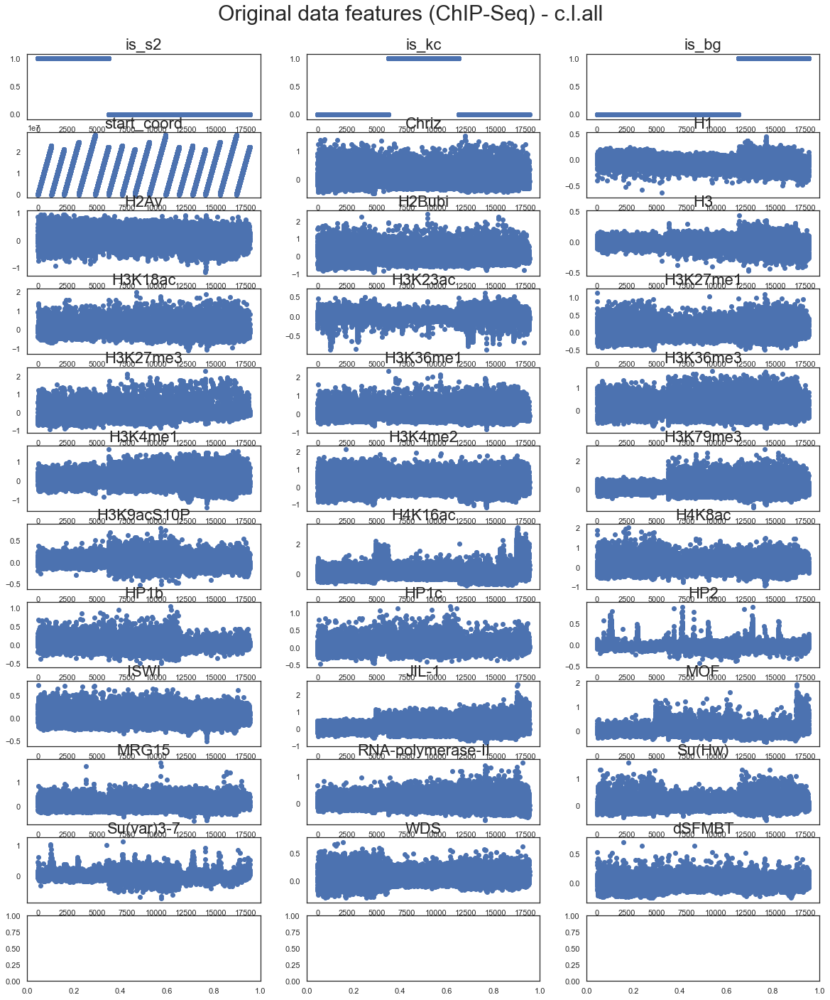

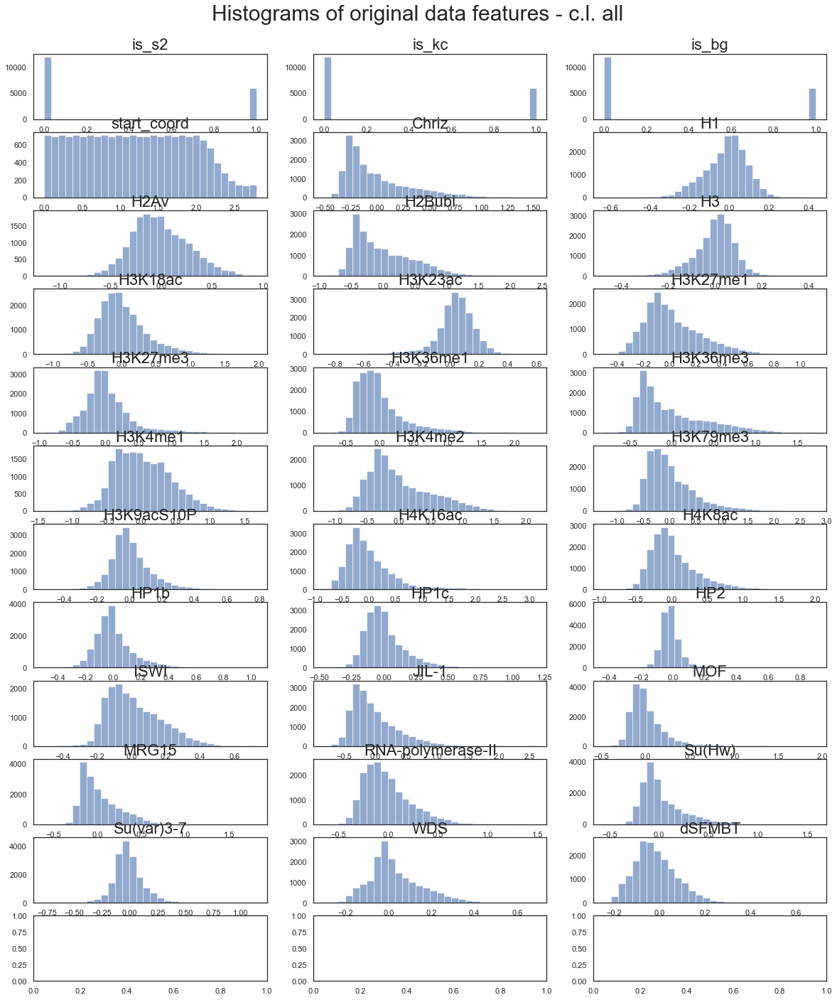

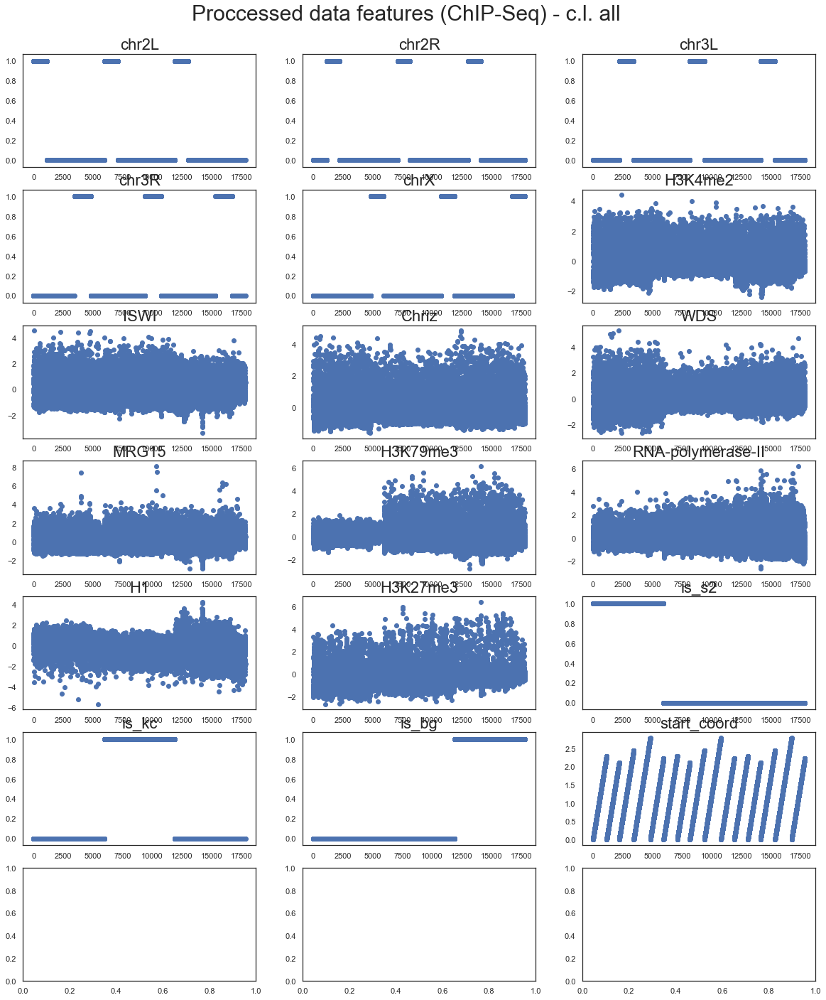

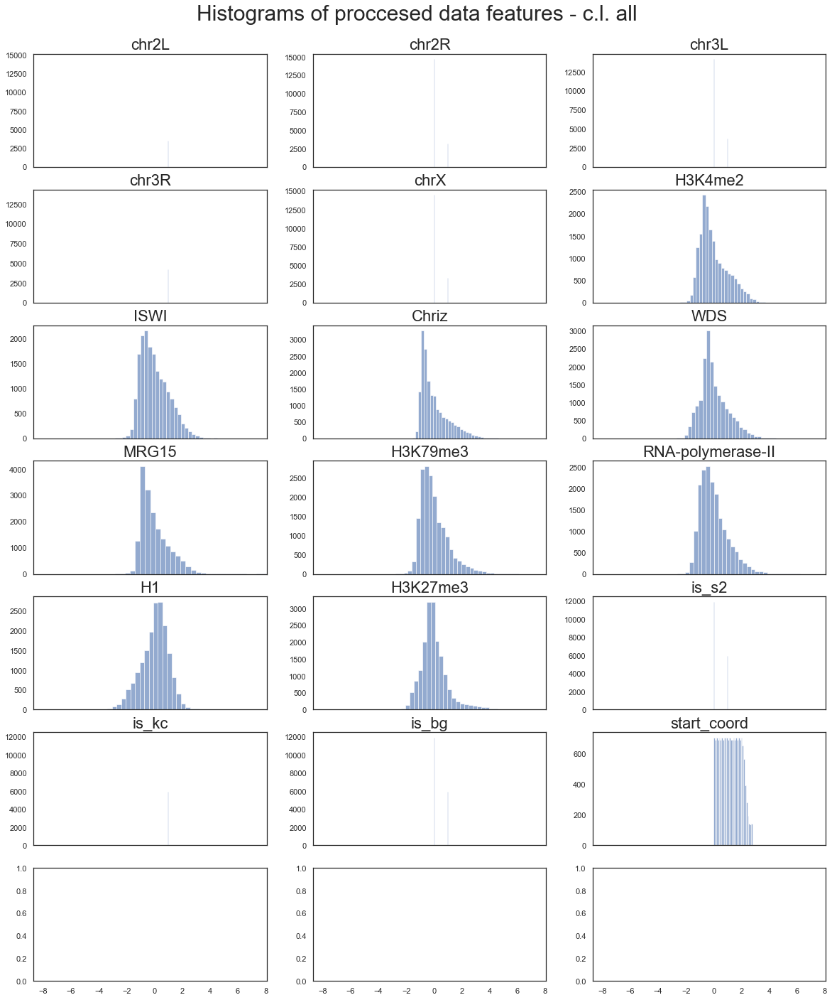

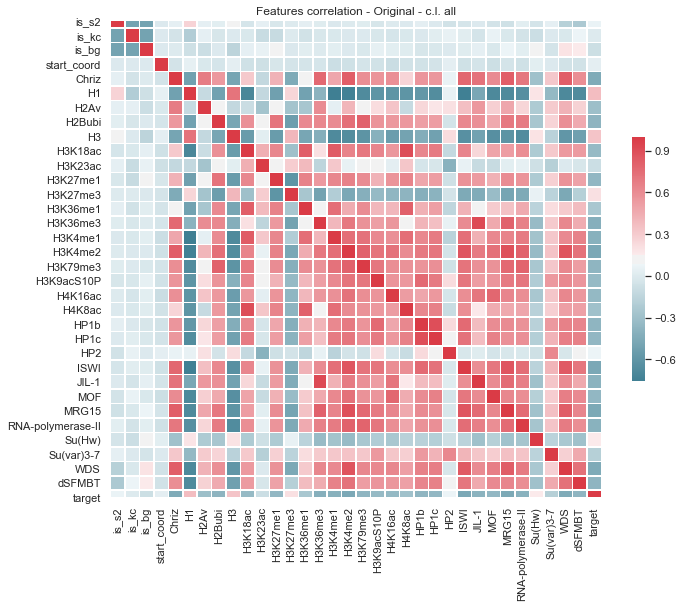

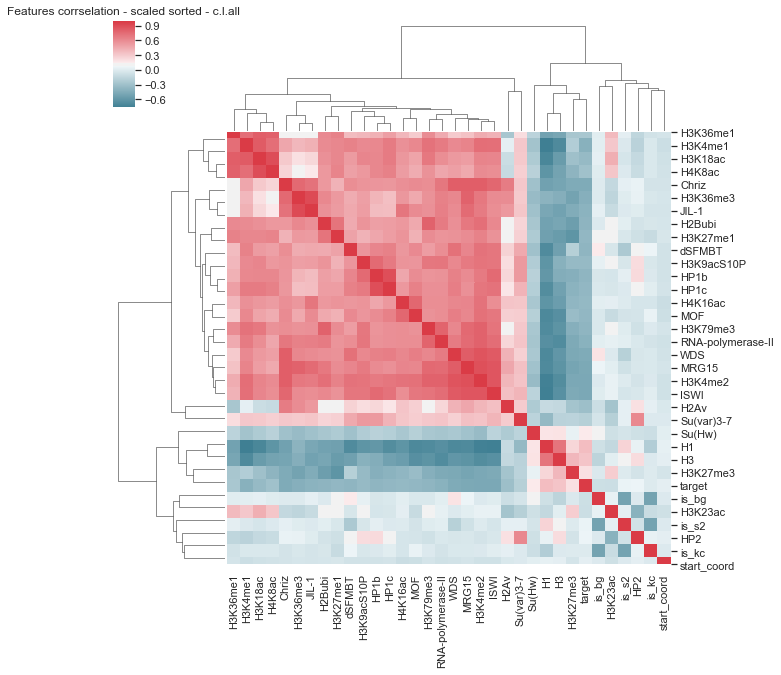

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.447513
H1                   0.368121
H2Av                -0.305448
H2Bubi              -0.376450
H3                   0.337213
H3K18ac             -0.333723
H3K23ac             -0.080334
H3K27me1            -0.358176
H3K27me3             0.206352
H3K36me1            -0.247128
H3K36me3            -0.413217
H3K4me1             -0.406032
H3K4me2             -0.467798
H3K79me3            -0.374167
H3K9acS10P          -0.339806
H4K16ac             -0.342435
H4K8ac              -0.287738
HP1b                -0.371539
HP1c                -0.358979
HP2                  0.076845
ISWI                -0.469752
JIL-1               -0.394342
MOF                 -0.359221
MRG15               -0.461165
RNA-polymerase-II   -0.400547
Su(Hw)               0.161442
Su(var)3-7          -0.187351
WDS                 -0.449091
dSFMBT              -0.372893
target    

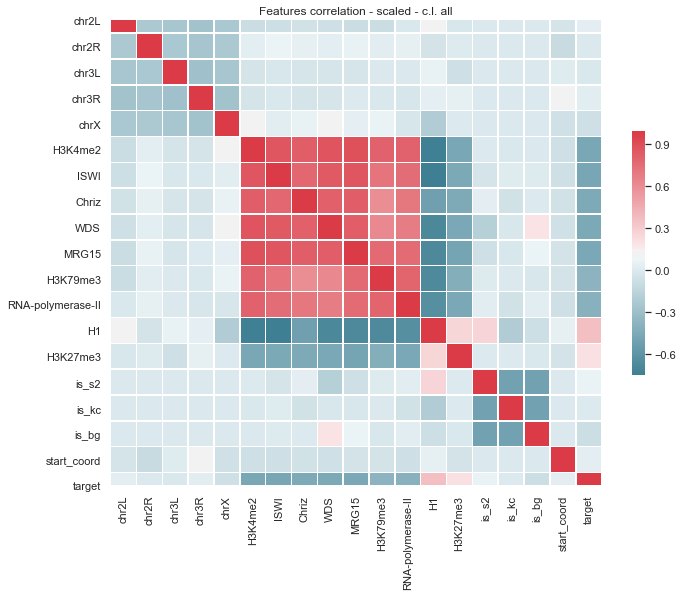

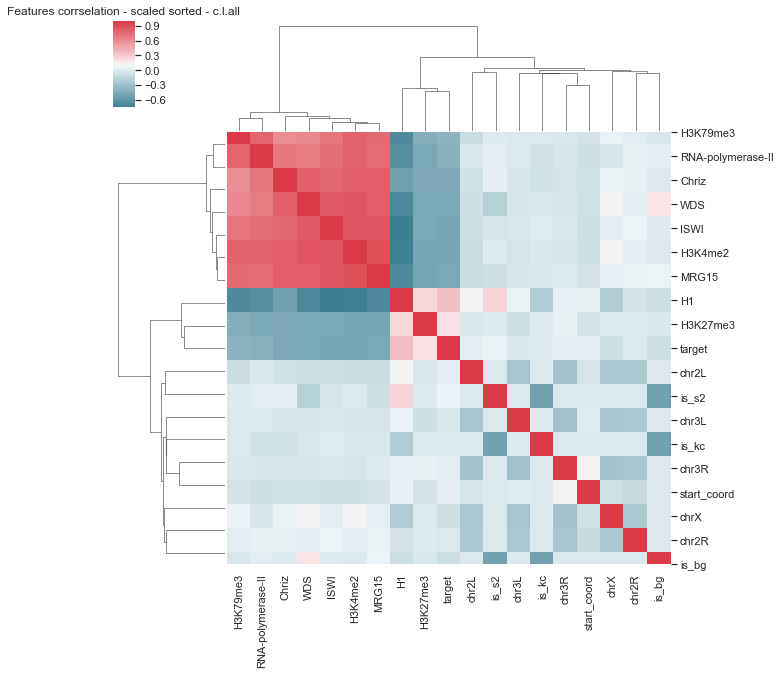

chr2L                0.039413
chr2R               -0.002480
chr3L               -0.008198
chr3R                0.028100
chrX                -0.059338
H3K4me2             -0.467798
ISWI                -0.469752
Chriz               -0.447513
WDS                 -0.449091
MRG15               -0.461165
H3K79me3            -0.374167
RNA-polymerase-II   -0.400547
H1                   0.368121
H3K27me3             0.206352
is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
target               1.000000
Name: target, dtype: float64 Index(['ISWI', 'H3K4me2', 'MRG15', 'WDS', 'Chriz', 'RNA-polymerase-II',
       'H3K79me3', 'is_bg', 'chrX', 'chr3L', 'chr2R', 'is_kc', 'chr3R',
       'start_coord', 'chr2L', 'is_s2', 'H3K27me3', 'H1', 'target'],
      dtype='object')
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 18) (3747, 6, 18) (12491,) (3747,)
x_val.shape = (1071, 6, 18)
y_val.shape = (1071,)
x_train.sha

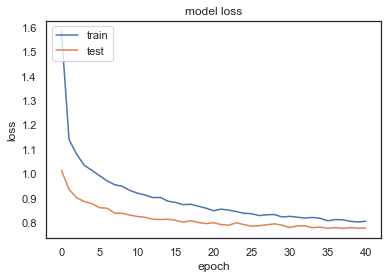

TEST WMSE =  0.7863422260055554
x_val.shape = (1071, 6, 18)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 18)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 75.79789805412292


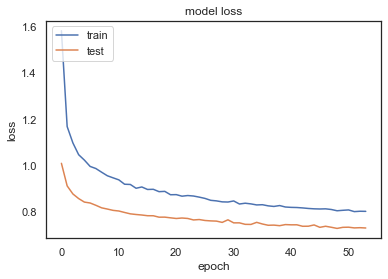

TEST WMSE =  0.7734025837901158
x_val.shape = (1071, 6, 18)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 18)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 97.49605894088745


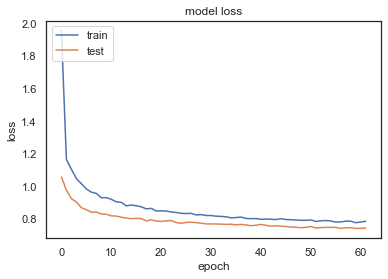

TEST WMSE =  0.7928023079904581
x_val.shape = (1071, 6, 18)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 18)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 59.652045011520386


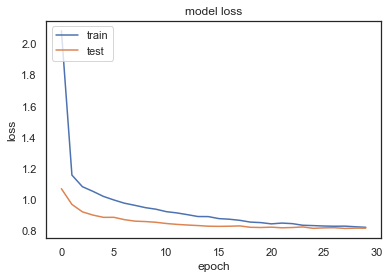

TEST WMSE =  0.7773637374016207
x_val.shape = (1071, 6, 18)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 18)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00065: early stopping
duration: 122.5277271270752


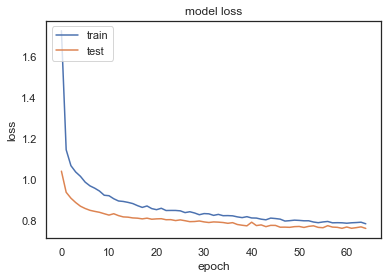

TEST WMSE =  0.7774518612322452
TEST MEAN WMSE =  0.7774518612322452


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [23]:
# data_csv = "_3CL_9_bioset_1_exps_13_05_20.csv"

# num_experements = 1

# cell_line = 'all' #  'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


# bioset = None  # bioset: defines the biological features to use. 
#                #  If bioset is None, use all availible features
# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
# data_path = data_path_35features

# target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
# index_col = 0

# random_state = 16 # None  # Shuffle the data splittings
# batch_size = 60 
# sequenc_len_list =  [6]
# num_lstm_units = 64 
# n_epochs_max = 364 
# num_folds = 5
# file_path = "./exps" + data_csv
# use_chr_onehotenc = True
# use_coord_scale = True

# eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
#             mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
#             data_scaled_clean, target_clean, = main_analysis(data_path,  
#                                                        cell_line, 
#                                                        bioset, 
#                                                        num_experements,
#                                                        sequenc_len_list = [6], 
#                                                        num_lstm_units = 6,
#                                                        num_folds = num_folds,
#                                                        batch_size = batch_size,
#                                                        do_only_1_feature_exps = False, 
#                                                        do_drop_1_feature_exps = False,
#                                                        do_all_together = True,
#                                                        use_chr_onehotenc = use_chr_onehotenc,
#                                                        use_coord_scale=use_coord_scale,
#                                                        verbose=True)


In [25]:
eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,41.000000,0.786342,0.745753,0.777745,1.501422,60.0,59.524028,-1.0
1,0,6.0,6.0,54.000000,0.773403,0.750680,0.731585,1.510930,60.0,75.797898,-1.0
2,0,6.0,6.0,62.000000,0.792802,0.728570,0.744814,1.532388,60.0,97.496059,-1.0
3,0,6.0,6.0,30.000000,0.777364,0.761055,0.816365,1.510951,60.0,59.652045,-1.0
4,0,6.0,6.0,65.000000,0.777452,0.743714,0.760998,1.458263,60.0,122.527727,-1.0
5,mean,6.0,6.0,50.400000,0.781473,0.745955,0.766302,1.502791,60.0,82.999551,-1.0
6,std,0.0,0.0,13.776502,0.007446,0.011807,0.032308,0.027346,0.0,23.766443,0.0


In [26]:
eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,41.000000,0.786342,0.745753,0.777745,1.501422,60.0,59.524028,-1.0
1,0,6.0,6.0,54.000000,0.773403,0.750680,0.731585,1.510930,60.0,75.797898,-1.0
2,0,6.0,6.0,62.000000,0.792802,0.728570,0.744814,1.532388,60.0,97.496059,-1.0
3,0,6.0,6.0,30.000000,0.777364,0.761055,0.816365,1.510951,60.0,59.652045,-1.0
4,0,6.0,6.0,65.000000,0.777452,0.743714,0.760998,1.458263,60.0,122.527727,-1.0
5,mean,6.0,6.0,50.400000,0.781473,0.745955,0.766302,1.502791,60.0,82.999551,-1.0
6,std,0.0,0.0,13.776502,0.007446,0.011807,0.032308,0.027346,0.0,23.766443,0.0


In [22]:
# eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,31.00000,0.935424,0.857891,1.095500,1.618290,60.0,18.708523,-1.0
1,0,6.0,6.0,41.00000,0.786037,0.858982,0.926255,1.609941,60.0,22.251281,-1.0
2,0,6.0,6.0,35.00000,0.785605,0.861486,0.920972,1.563746,60.0,20.567937,-1.0
3,0,6.0,6.0,30.00000,0.833040,0.859789,0.944144,1.517877,60.0,17.554228,-1.0
4,0,6.0,6.0,35.00000,0.923102,0.855886,0.937699,1.681724,60.0,19.573341,-1.0
5,mean,6.0,6.0,34.40000,0.852642,0.858807,0.964914,1.598316,60.0,19.731062,-1.0
6,std,0.0,0.0,3.91561,0.056807,0.002034,0.017226,0.060576,0.0,1.703396,0.0


data.shape =  (17850, 34)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'H1' 'H2Av' 'H2Bubi'
 'H3' 'H3K18ac' 'H3K23ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3'
 'H3K4me1' 'H3K4me2' 'H3K79me3' 'H3K9acS10P' 'H4K16ac' 'H4K8ac' 'HP1b'
 'HP1c' 'HP2' 'ISWI' 'JIL-1' 'MOF' 'MRG15' 'RNA-polymerase-II' 'Su(Hw)'
 'Su(var)3-7' 'WDS' 'dSFMBT']
Using features bioset: ['H3K4me2', 'ISWI', 'Chriz', 'WDS', 'MRG15', 'H3K79me3', 'RNA-polymerase-II', 'H1', 'H3K27me3', 'is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord']
Using cell line: is_s2
Scaling of the features: Index(['H3K4me2', 'ISWI', 'Chriz', 'WDS', 'MRG15', 'H3K79me3',
       'RNA-polymerase-II', 'H1', 'H3K27me3'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (5950, 15)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (5950, 3)
target.column = Index

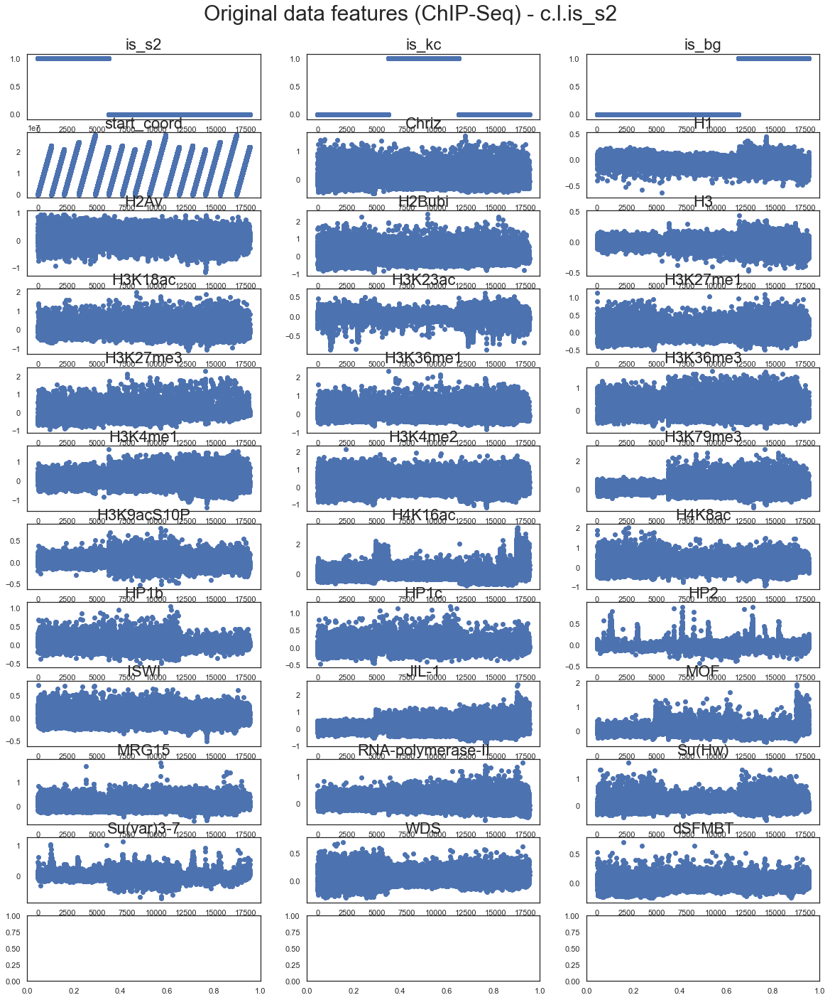

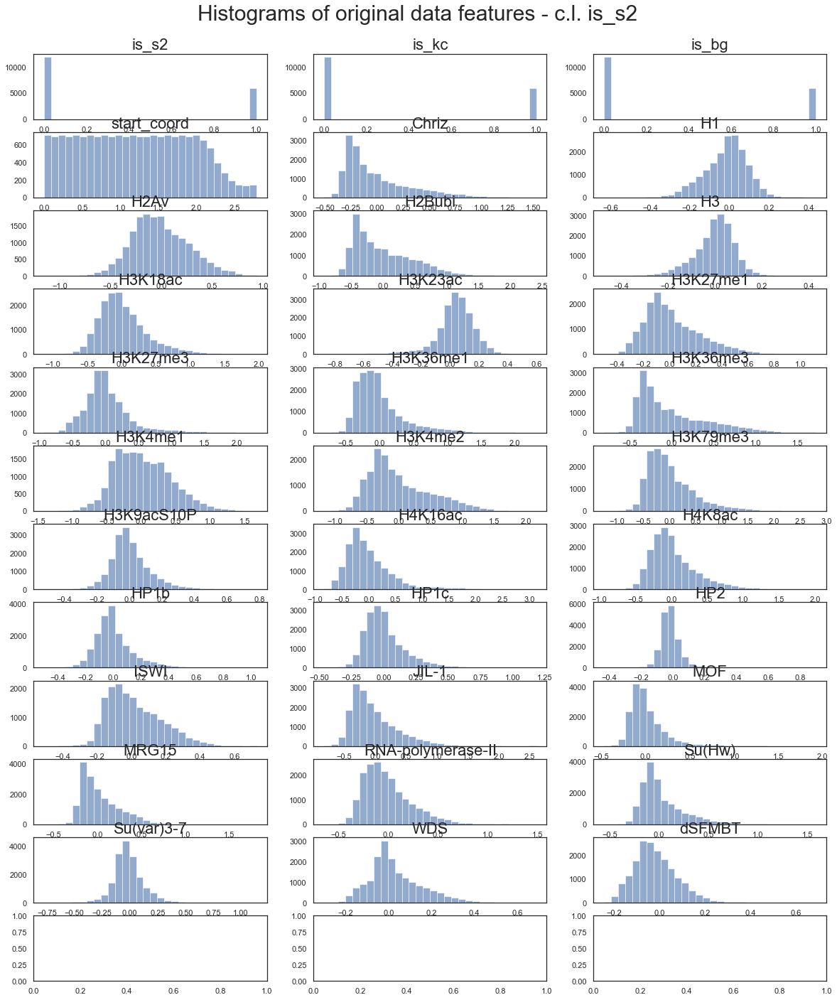

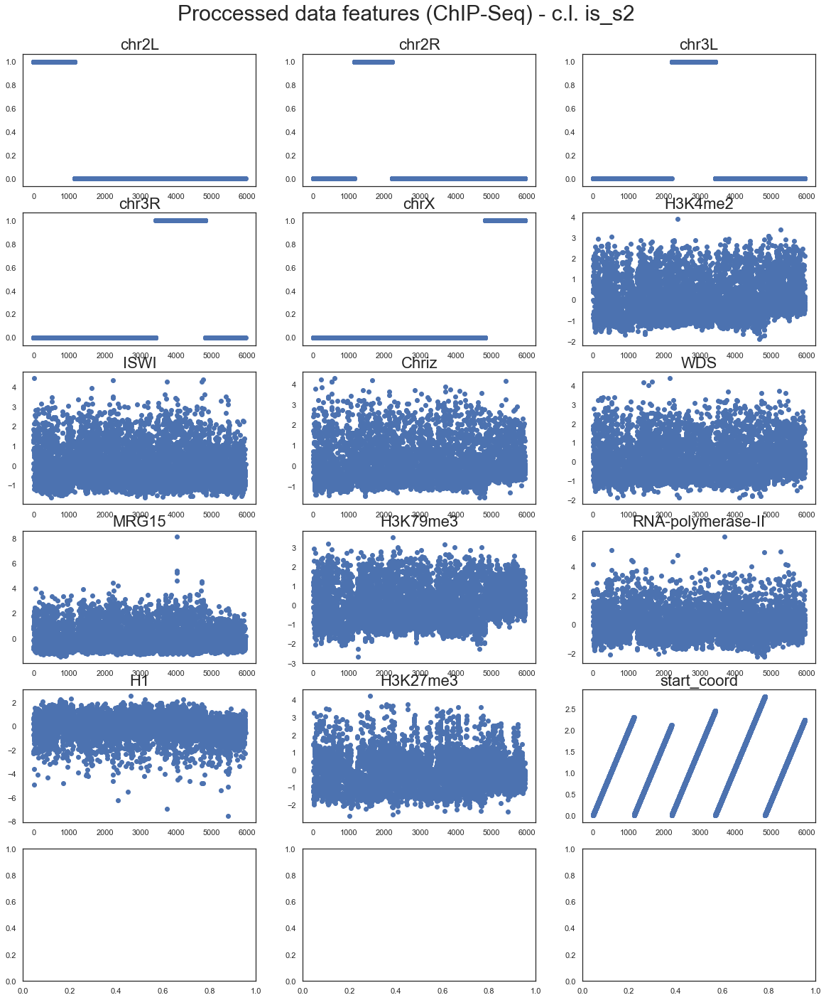

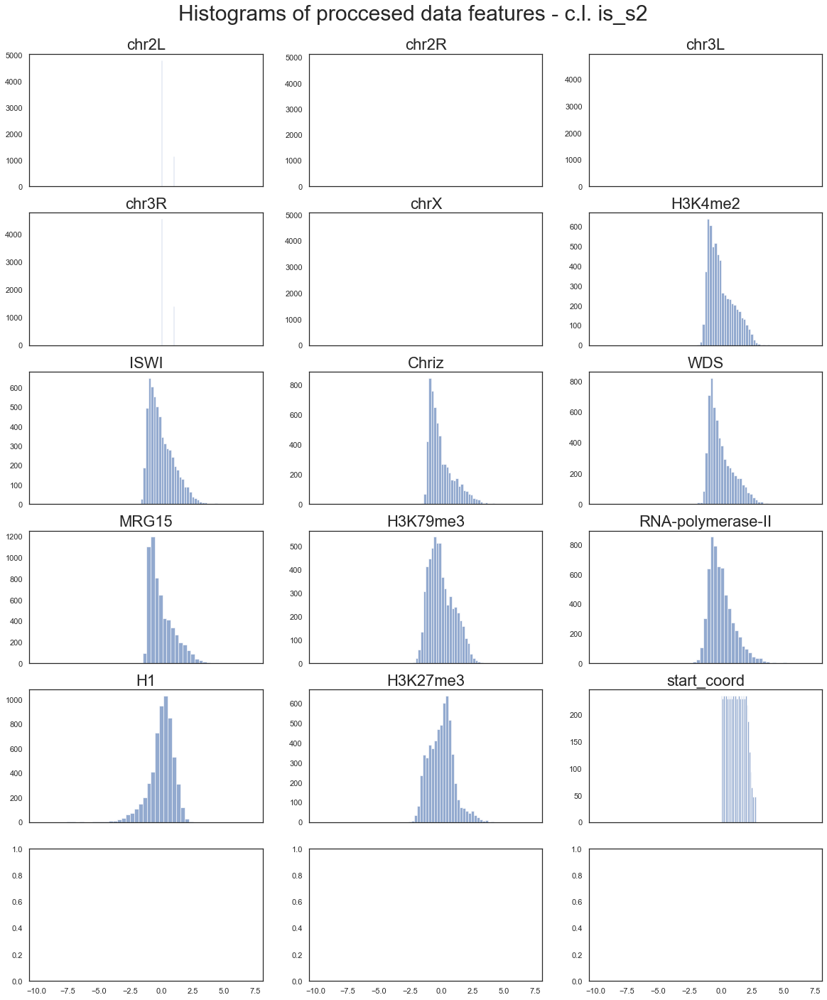

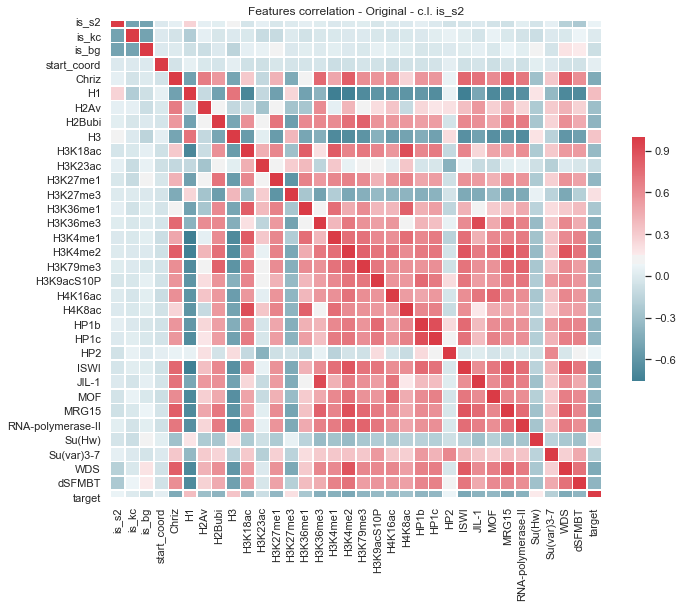

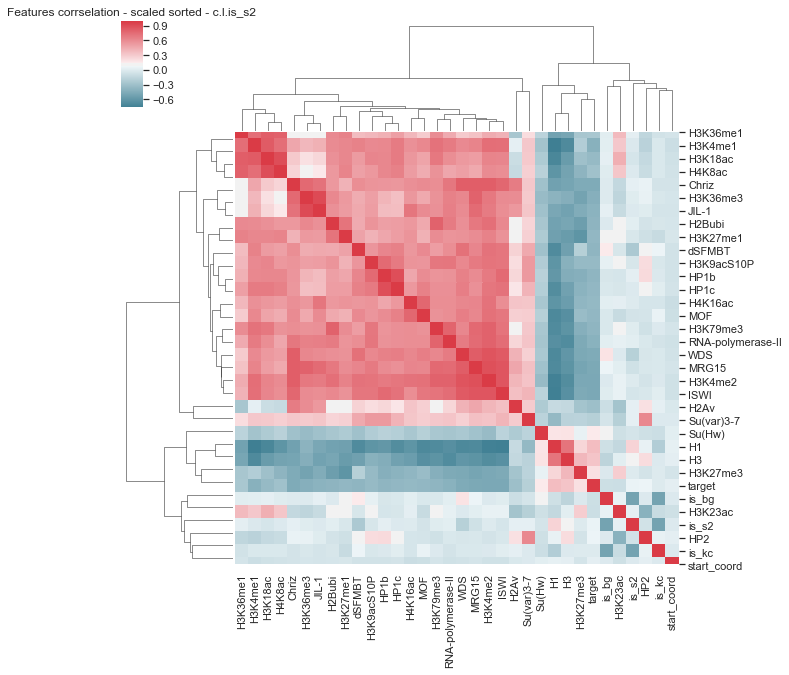

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.447513
H1                   0.368121
H2Av                -0.305448
H2Bubi              -0.376450
H3                   0.337213
H3K18ac             -0.333723
H3K23ac             -0.080334
H3K27me1            -0.358176
H3K27me3             0.206352
H3K36me1            -0.247128
H3K36me3            -0.413217
H3K4me1             -0.406032
H3K4me2             -0.467798
H3K79me3            -0.374167
H3K9acS10P          -0.339806
H4K16ac             -0.342435
H4K8ac              -0.287738
HP1b                -0.371539
HP1c                -0.358979
HP2                  0.076845
ISWI                -0.469752
JIL-1               -0.394342
MOF                 -0.359221
MRG15               -0.461165
RNA-polymerase-II   -0.400547
Su(Hw)               0.161442
Su(var)3-7          -0.187351
WDS                 -0.449091
dSFMBT              -0.372893
target    

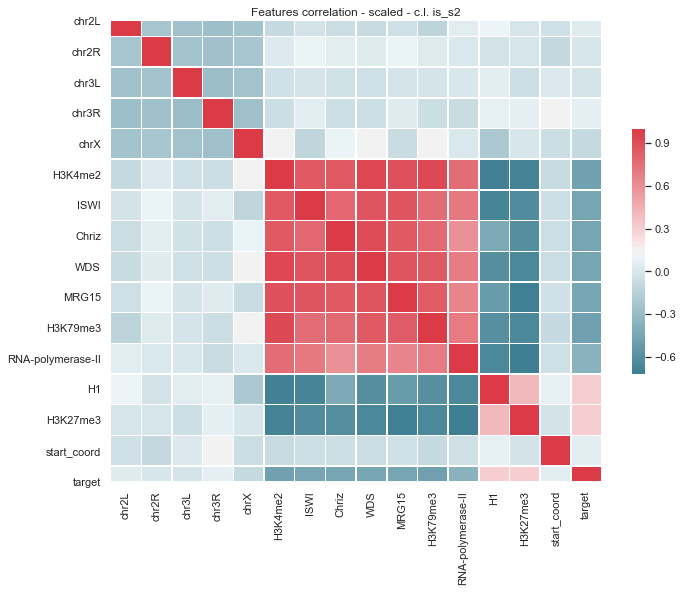

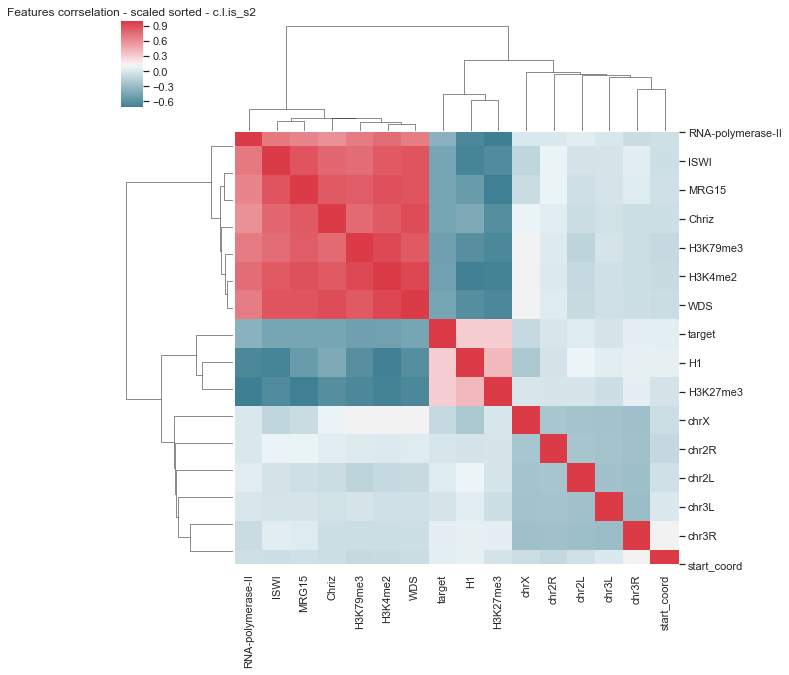

chr2L                0.040893
chr2R               -0.001248
chr3L               -0.016377
chr3R                0.063608
chrX                -0.092044
H3K4me2             -0.478476
ISWI                -0.450137
Chriz               -0.449578
WDS                 -0.453064
MRG15               -0.453526
H3K79me3            -0.485059
RNA-polymerase-II   -0.367820
H1                   0.313379
H3K27me3             0.314305
start_coord          0.051515
target               1.000000
Name: target, dtype: float64 Index(['H3K79me3', 'H3K4me2', 'MRG15', 'WDS', 'ISWI', 'Chriz',
       'RNA-polymerase-II', 'chrX', 'chr3L', 'chr2R', 'chr2L', 'start_coord',
       'chr3R', 'H1', 'H3K27me3', 'target'],
      dtype='object')

-----
 DROP FEATURE NUMBER -- 0
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... 

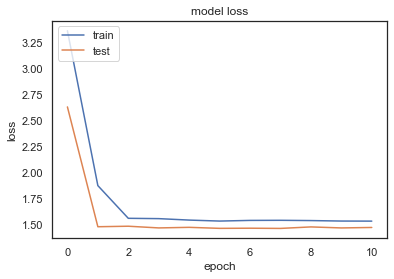

TEST WMSE =  1.6600668538803014
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 9.029971837997437


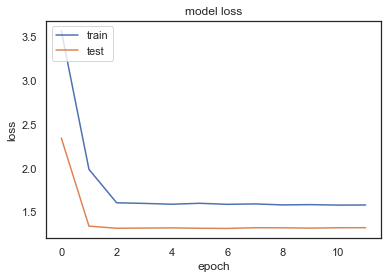

TEST WMSE =  1.453456814829921
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 9.639615058898926


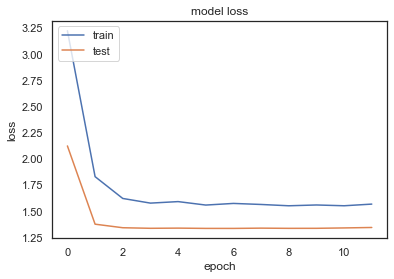

TEST WMSE =  1.480351368279748
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 9.824559926986694


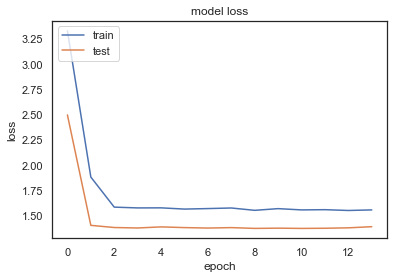

TEST WMSE =  1.4826621196134566
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 7.507519960403442


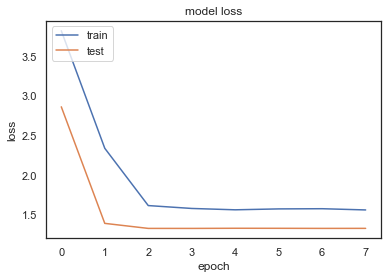

TEST WMSE =  1.5485257123353178
TEST MEAN WMSE =  1.5485257123353178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 1
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 9.036477088928223


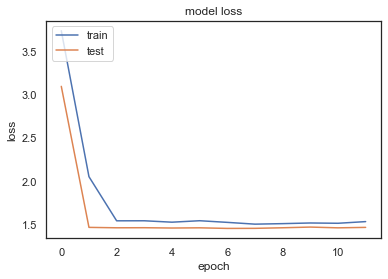

TEST WMSE =  1.661687624250128
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 7.648585319519043


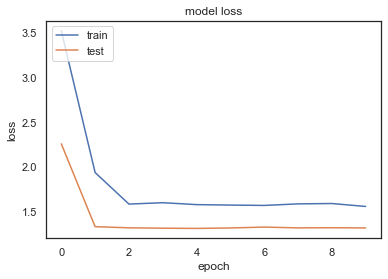

TEST WMSE =  1.4562294983365511
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 9.256098985671997


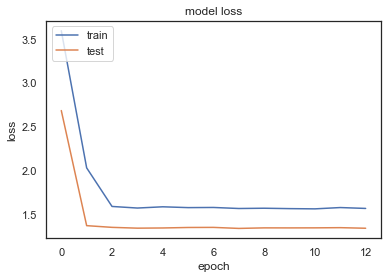

TEST WMSE =  1.4759073054463085
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 7.012377977371216


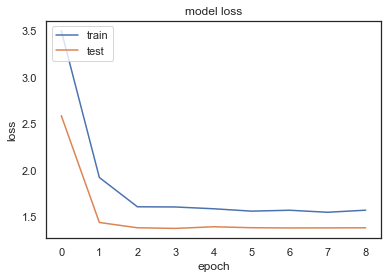

TEST WMSE =  1.4745633460420302
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 7.697879076004028


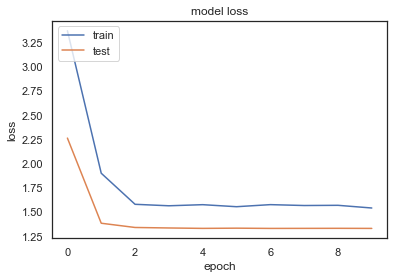

TEST WMSE =  1.5535338042984577
TEST MEAN WMSE =  1.5535338042984577


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 2
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 8.66063117980957


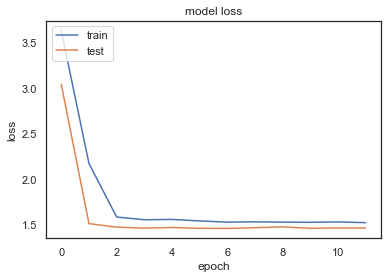

TEST WMSE =  1.6549267003738188
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 6.568645715713501


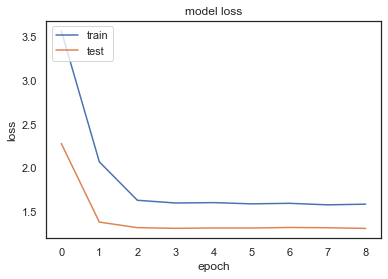

TEST WMSE =  1.459651032139859
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 7.7532689571380615


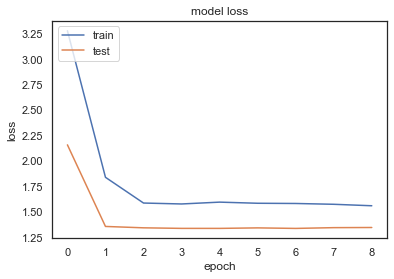

TEST WMSE =  1.4784438440610679
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 6.6509199142456055


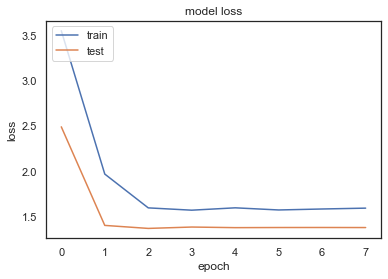

TEST WMSE =  1.4721857064589505
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 7.312302112579346


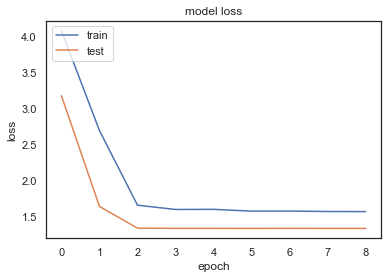

TEST WMSE =  1.5536514429951844
TEST MEAN WMSE =  1.5536514429951844


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 10.10663890838623


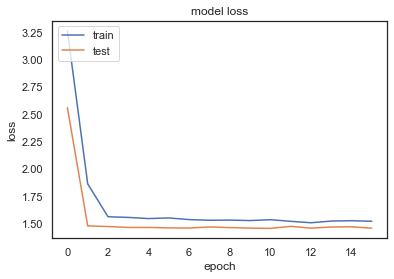

TEST WMSE =  1.638286545732514
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 9.038683891296387


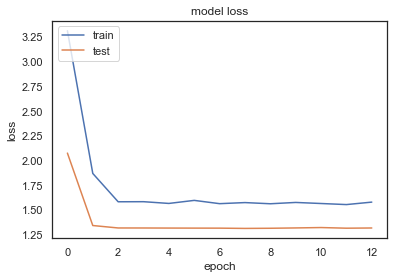

TEST WMSE =  1.4531172678743869
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 8.058698177337646


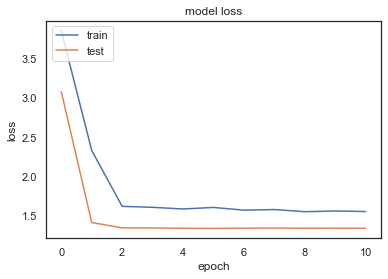

TEST WMSE =  1.4744151373271228
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 8.232608795166016


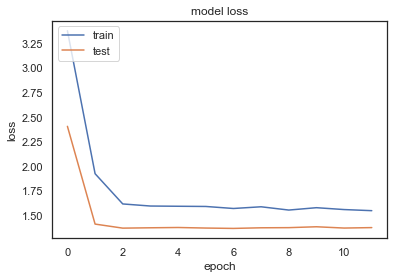

TEST WMSE =  1.4726153432309104
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 7.086516857147217


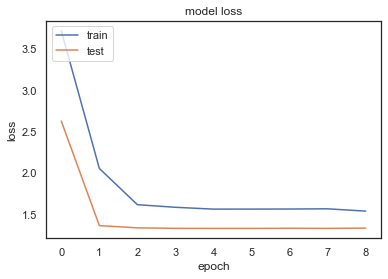

TEST WMSE =  1.5463488431265942
TEST MEAN WMSE =  1.5463488431265942


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 4
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 10.378891944885254


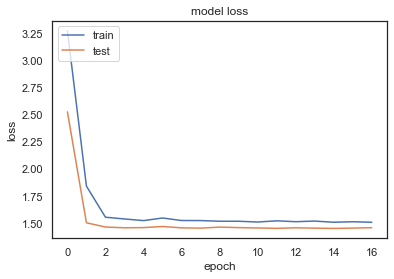

TEST WMSE =  1.649387487606771
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 6.911405801773071


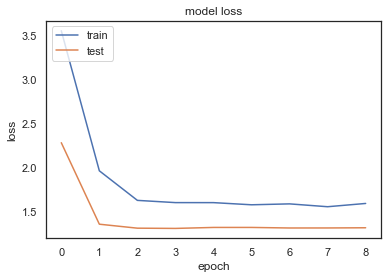

TEST WMSE =  1.4492698395190242
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 6.602558135986328


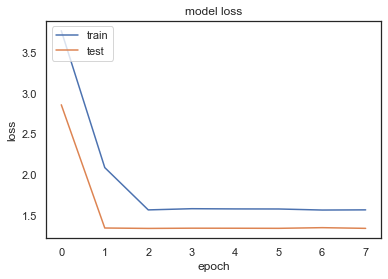

TEST WMSE =  1.4766637070895798
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 8.76075005531311


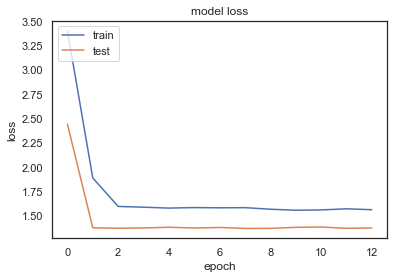

TEST WMSE =  1.4678995838929838
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 6.714762926101685


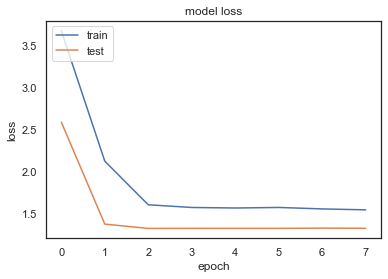

TEST WMSE =  1.5435667462557043
TEST MEAN WMSE =  1.5435667462557043


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 5
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 22.093805074691772


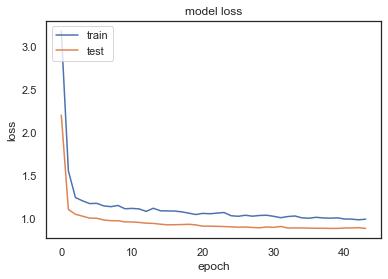

TEST WMSE =  1.1147779138175407
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 26.781222820281982


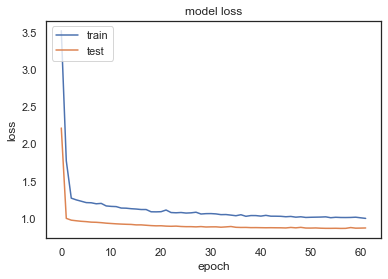

TEST WMSE =  0.9042293547358518
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 22.143769025802612


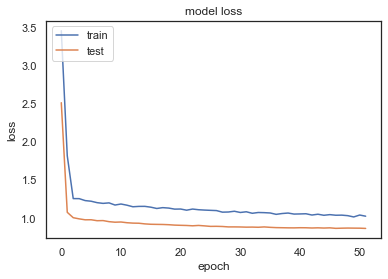

TEST WMSE =  0.9172877417114251
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 18.811142206192017


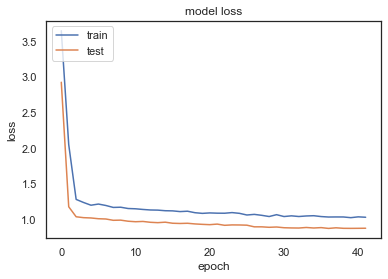

TEST WMSE =  0.9475633994703269
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 27.29037880897522


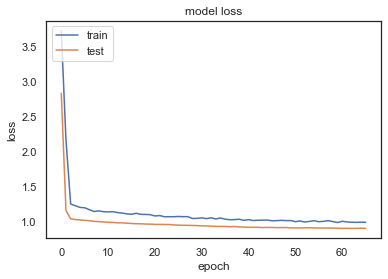

TEST WMSE =  1.0244154282346818
TEST MEAN WMSE =  1.0244154282346818


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 6
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 22.4532790184021


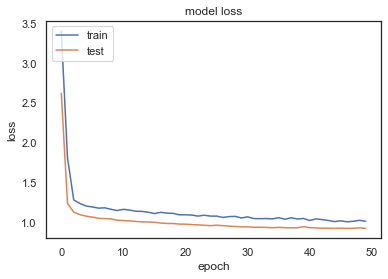

TEST WMSE =  1.1488791182170857
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00068: early stopping
duration: 27.935513734817505


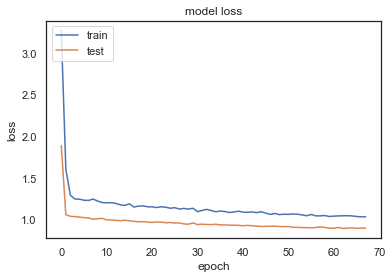

TEST WMSE =  0.964820234814884
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 12.791458129882812


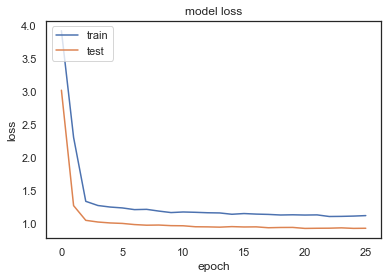

TEST WMSE =  0.969621519982171
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 20.698890924453735


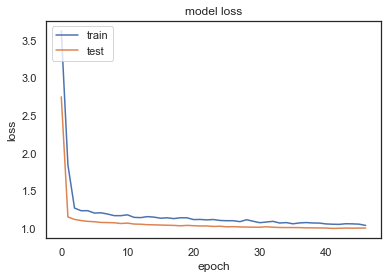

TEST WMSE =  0.9863935686368417
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 25.37545084953308


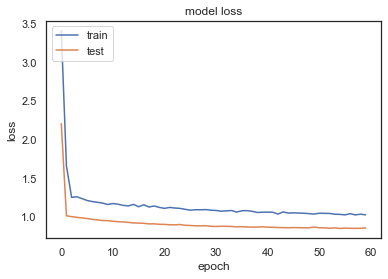

TEST WMSE =  1.0448814090666245
TEST MEAN WMSE =  1.0448814090666245


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 7
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00071: early stopping
duration: 29.102671146392822


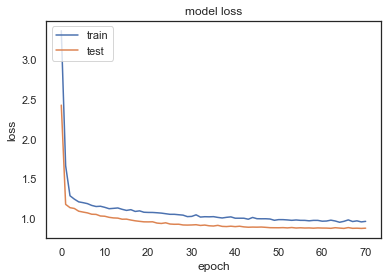

TEST WMSE =  1.1168105991702086
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 22.33202314376831


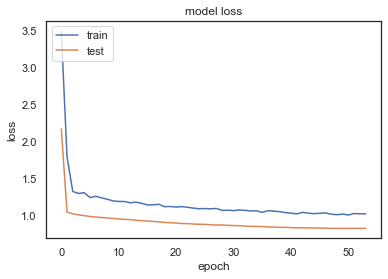

TEST WMSE =  0.9368922106298453
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 14.76979684829712


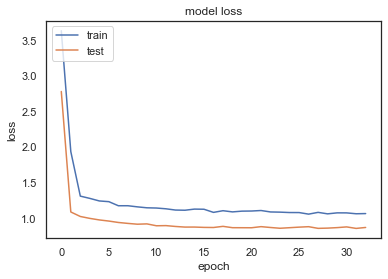

TEST WMSE =  0.9380601314965809
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 21.550186157226562


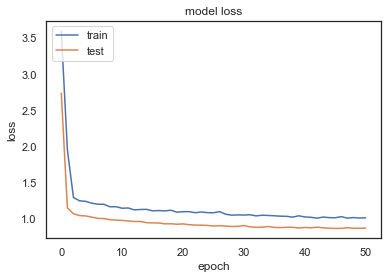

TEST WMSE =  0.9286980702517091
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 25.462255239486694


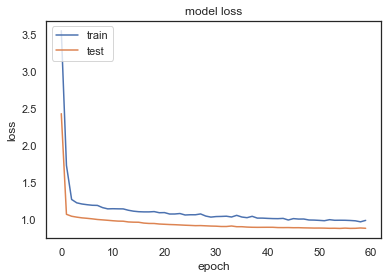

TEST WMSE =  1.0347232008506557
TEST MEAN WMSE =  1.0347232008506557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 8
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 22.991930961608887


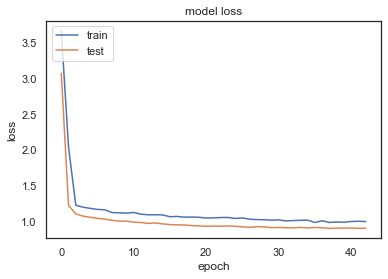

TEST WMSE =  1.1385763917163896
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 30.07842707633972


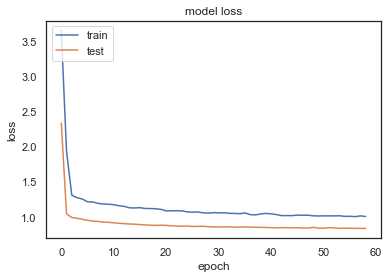

TEST WMSE =  0.9201665558986701
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 23.178335905075073


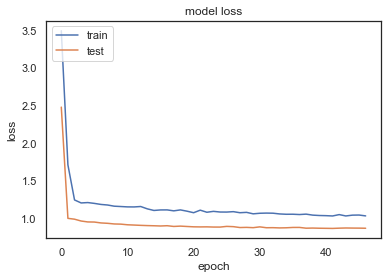

TEST WMSE =  0.9171261874555477
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 22.15510606765747


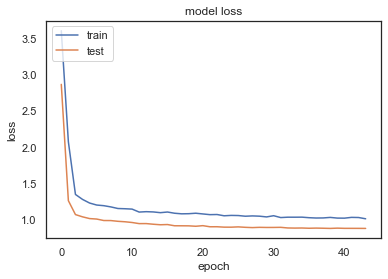

TEST WMSE =  0.9273245112691388
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 22.544681310653687


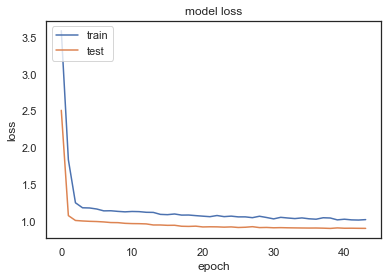

TEST WMSE =  1.0296994047051777
TEST MEAN WMSE =  1.0296994047051777


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 9
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 24.03309416770935


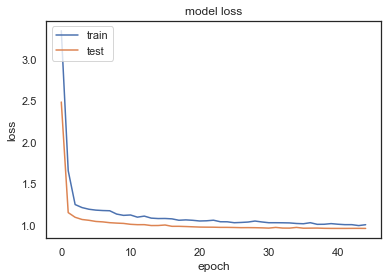

TEST WMSE =  1.1390333807486295
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 26.413438081741333


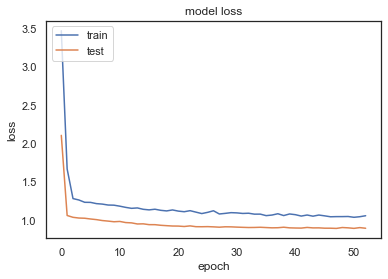

TEST WMSE =  0.9531658552717133
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 20.004889011383057


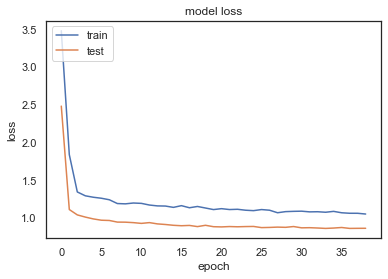

TEST WMSE =  0.9307470734510126
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00080: early stopping
duration: 41.093114137649536


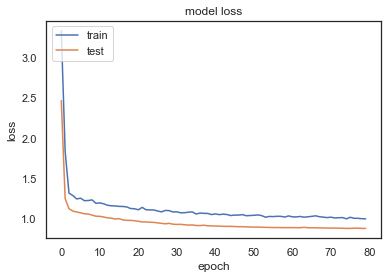

TEST WMSE =  0.9486368277610441
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00075: early stopping
duration: 39.99575996398926


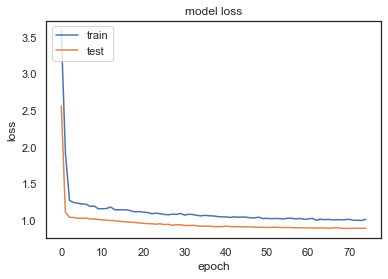

TEST WMSE =  1.0514199086998923
TEST MEAN WMSE =  1.0514199086998923


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 10
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 31.070863962173462


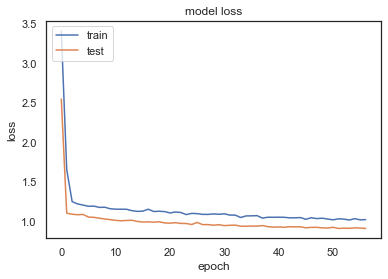

TEST WMSE =  1.1449492349822576
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 27.120605945587158


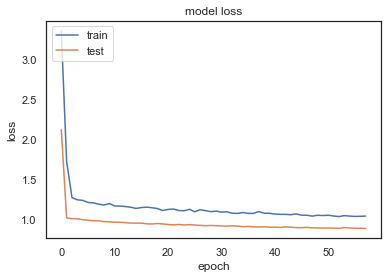

TEST WMSE =  0.944861923122652
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 27.192555904388428


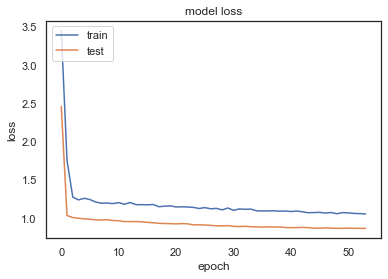

TEST WMSE =  0.9358792926090477
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 22.6219961643219


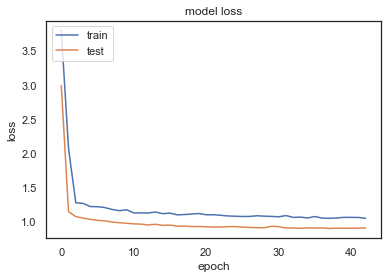

TEST WMSE =  0.9846626904297288
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 25.304111003875732


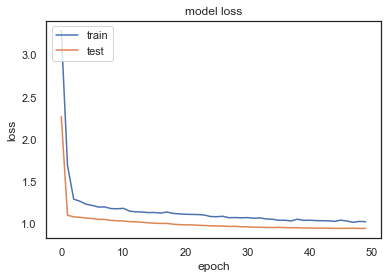

TEST WMSE =  1.0793376790121791
TEST MEAN WMSE =  1.0793376790121791


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 11
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 16.047213077545166


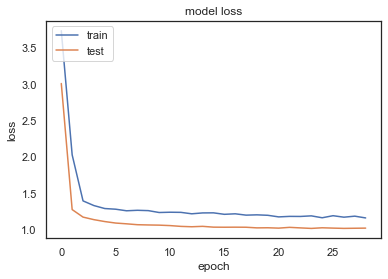

TEST WMSE =  1.2739466326435591
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 13.538097858428955


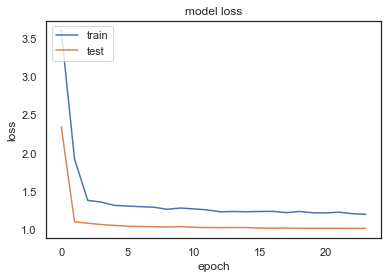

TEST WMSE =  1.070462231960189
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 22.468180179595947


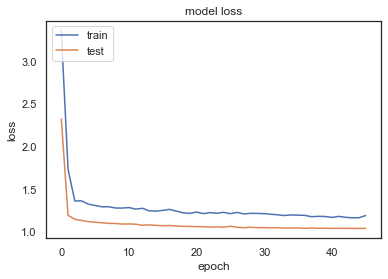

TEST WMSE =  1.0317109591928115
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 17.292803049087524


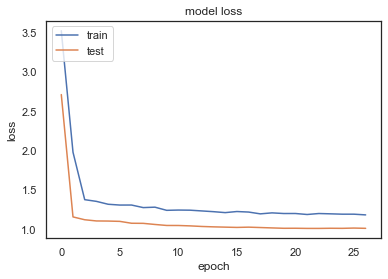

TEST WMSE =  1.091913335193208
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 24.943341732025146


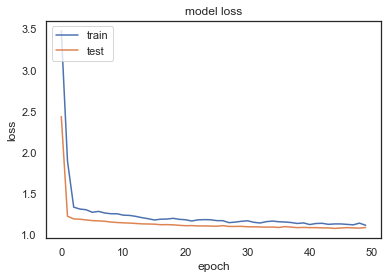

TEST WMSE =  1.192290640898437
TEST MEAN WMSE =  1.192290640898437


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 12
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 24.425336837768555


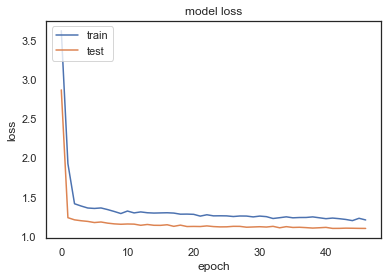

TEST WMSE =  1.3149359637704923
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 19.410688877105713


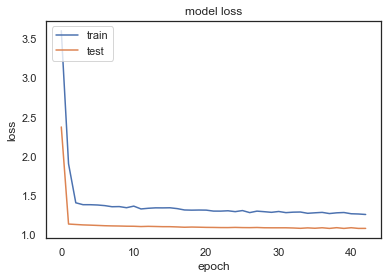

TEST WMSE =  1.1534080478243374
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 18.692296028137207


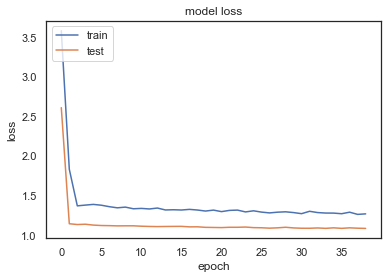

TEST WMSE =  1.1878818253253884
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 18.19177770614624


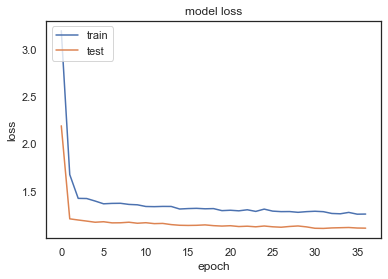

TEST WMSE =  1.2229303634279778
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 16.424279928207397


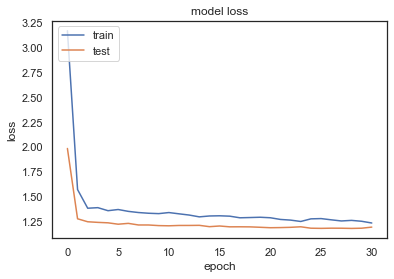

TEST WMSE =  1.2855899929599905
TEST MEAN WMSE =  1.2855899929599905


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 13
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 28.08936381340027


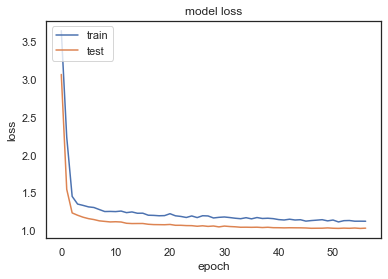

TEST WMSE =  1.2257294889970818
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 25.956101894378662


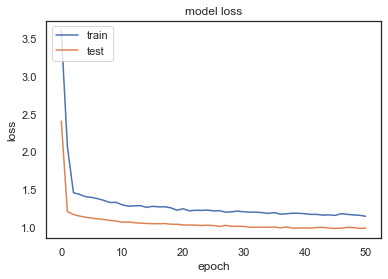

TEST WMSE =  1.0749320213081304
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 36.96120882034302


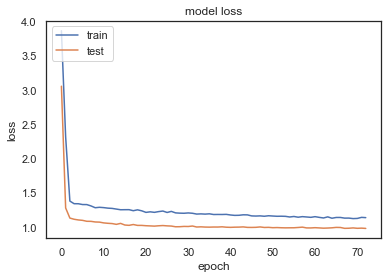

TEST WMSE =  1.0159436414603678
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 29.367552042007446


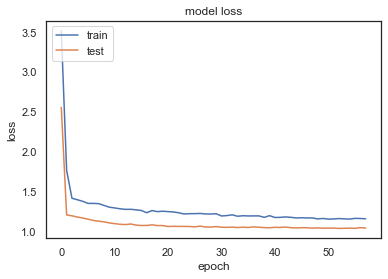

TEST WMSE =  1.1026602817433635
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 37.32749009132385


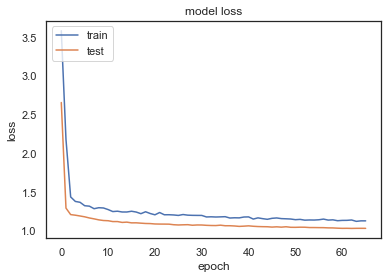

TEST WMSE =  1.1839464697955548
TEST MEAN WMSE =  1.1839464697955548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 14
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 1) (1248, 6, 1) (4161,) (1248,)
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 20.39760708808899


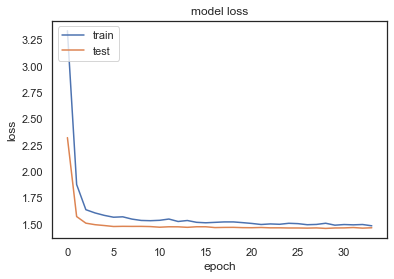

TEST WMSE =  1.6555278066731838
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 10.393879890441895


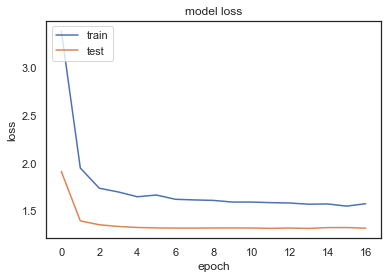

TEST WMSE =  1.458737330712565
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 10.411371231079102


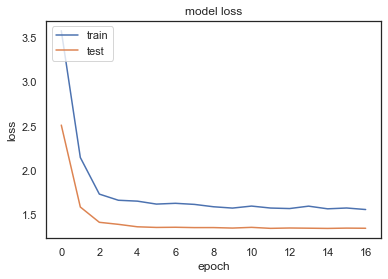

TEST WMSE =  1.4763565663479097
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 13.643718004226685


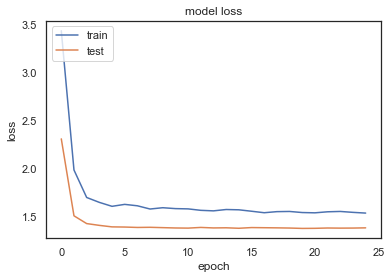

TEST WMSE =  1.4717319959368638
x_val.shape = (357, 6, 1)
y_val.shape = (357,)
x_train.shape = (4756, 6, 1)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 14.927885055541992


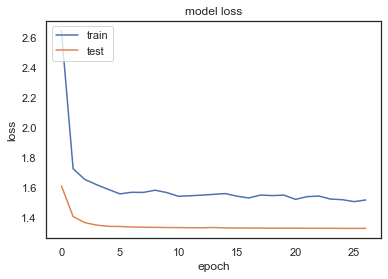

TEST WMSE =  1.552202023190165
TEST MEAN WMSE =  1.552202023190165


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 KEEP FEATURES -- 14
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 11.108644723892212


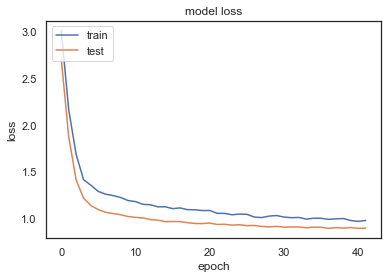

TEST WMSE =  1.008111526666847
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00069: early stopping
duration: 15.788991212844849


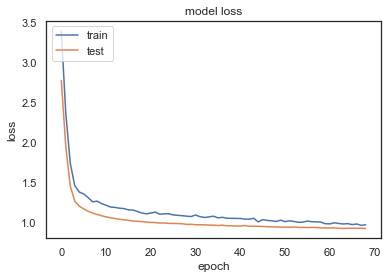

TEST WMSE =  0.8165413149246742
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00075: early stopping
duration: 17.11780095100403


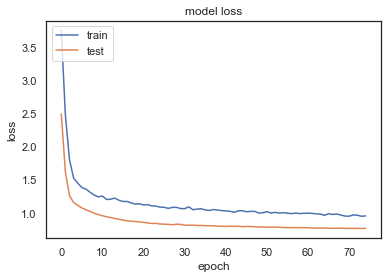

TEST WMSE =  0.861447936875863
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00082: early stopping
duration: 18.21562123298645


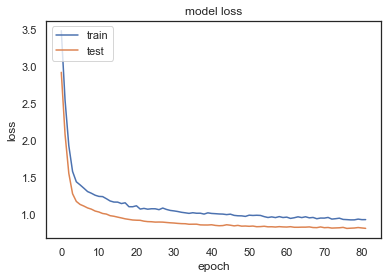

TEST WMSE =  0.8836435148683758
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 13.855070352554321


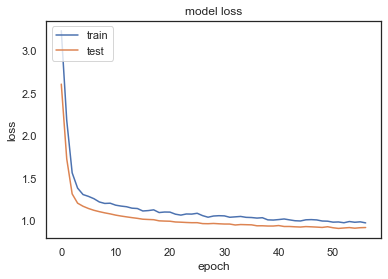

TEST WMSE =  0.9638788130807917
TEST MEAN WMSE =  0.9638788130807917


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


    exper_num  sequenc_len  num_lstm_units   n_epochs  weighted_mse_test  \
0           0          6.0             6.0  11.000000           1.660067   
1           0          6.0             6.0  12.000000           1.453457   
2           0          6.0             6.0  12.000000           1.480351   
3           0          6.0             6.0  14.000000           1.482662   
4           0          6.0             6.0   8.000000           1.548526   
5        mean          6.0             6.0  11.400000           1.525013   
6         std          0.0             0.0   2.179908           0.038123   
7           0          6.0             6.0  12.000000           1.661688   
8           0          6.0             6.0  10.000000           1.456229   
9           0          6.0             6.0  13.000000           1.475907   
10          0          6.0             6.0   9.000000           1.474563   
11          0          6.0             6.0  10.000000           1.553534   
12       mea

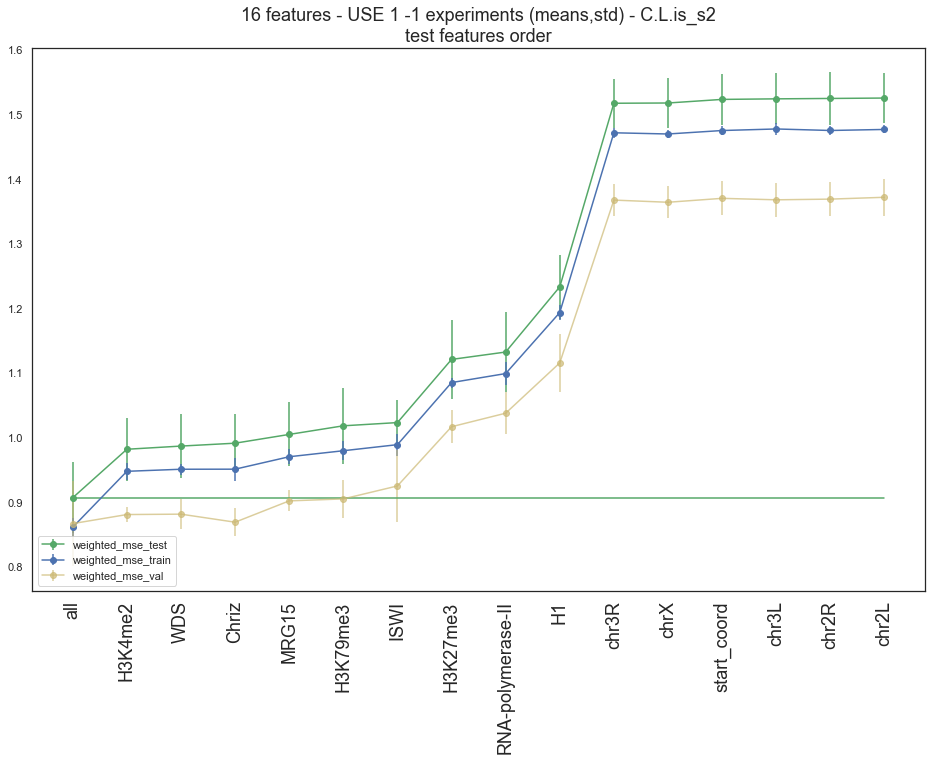

all
H3K4me2
WDS
Chriz
MRG15
H3K79me3
ISWI
H3K27me3
RNA-polymerase-II
H1
chrX
chr3R
start_coord
chr2R
chr2L
chr3L
num_features:  16


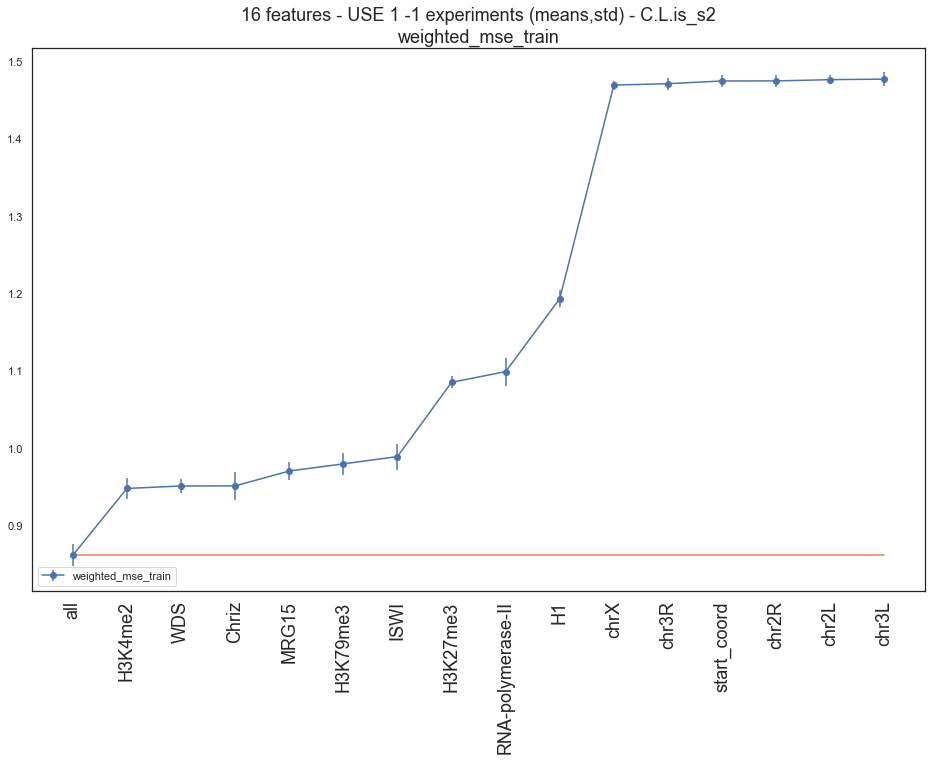

all
H3K4me2
WDS
Chriz
MRG15
H3K79me3
ISWI
H3K27me3
RNA-polymerase-II
H1
chr3R
chrX
start_coord
chr3L
chr2R
chr2L
num_features:  16


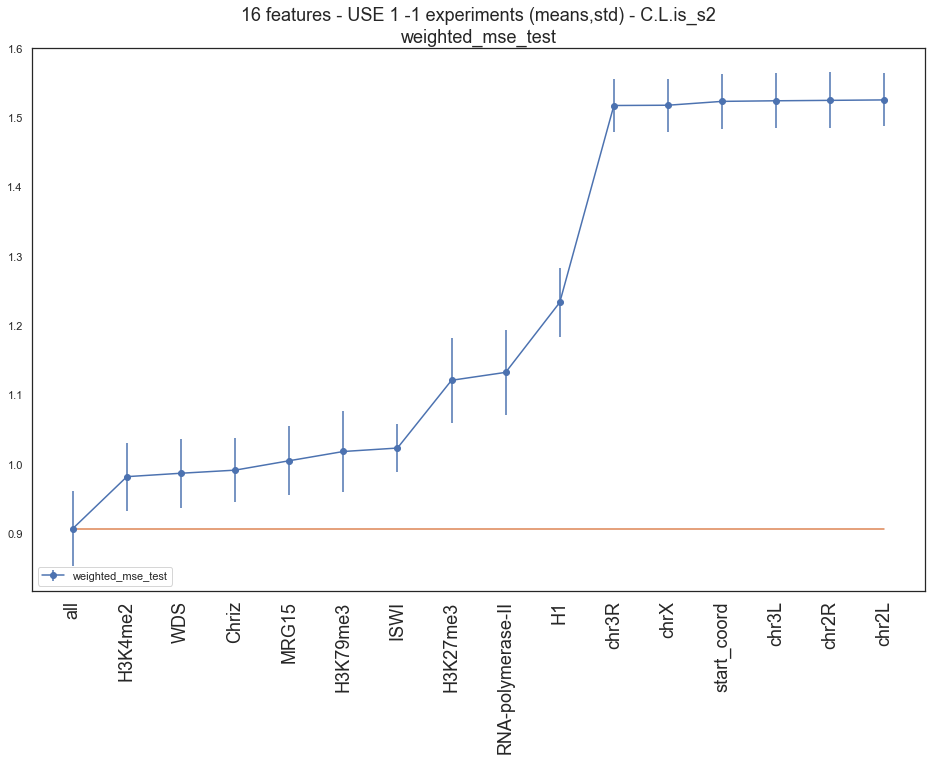

TEST wMSE using 1
all , 0.9067246212833103
H3K4me2 , 0.9816547675939653
WDS , 0.9865786102089847
Chriz , 0.9910368424798
MRG15 , 1.0046006091864583
H3K79me3 , 1.017938164031173
ISWI , 1.0229191701435212
H3K27me3 , 1.1206423806608998
RNA-polymerase-II , 1.132064759977641
H1 , 1.2329492386616372
chr3R , 1.5169566274583057
chrX , 1.5173574728728128
start_coord , 1.5229111445721375
chr3L , 1.5237717452057762
chr2R , 1.5243843156746952
chr2L , 1.5250125737877487

-----
 DROP FEATURE NUMBER -- 0
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00064: early stopping
duration: 32.42726016044617


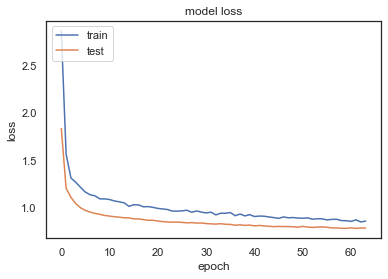

TEST WMSE =  0.9818429815291217
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 20.571763038635254


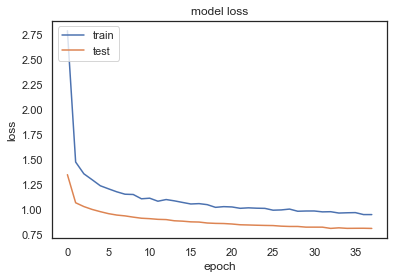

TEST WMSE =  0.8487103202759813
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 21.09718084335327


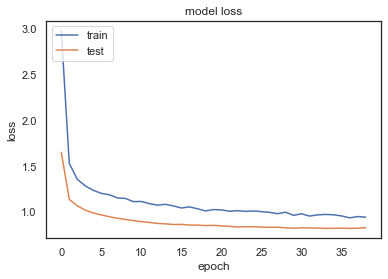

TEST WMSE =  0.836240934613312
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 27.923837900161743


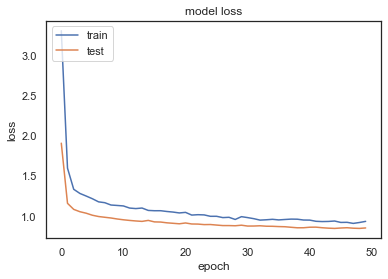

TEST WMSE =  0.8683724111934699
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 23.383185148239136


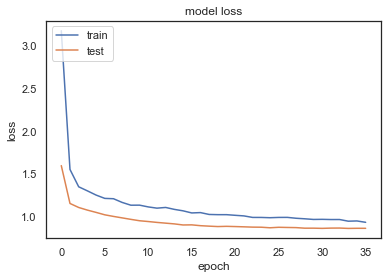

TEST WMSE =  0.9546702197110001
TEST MEAN WMSE =  0.9546702197110001


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 1
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 27.77965807914734


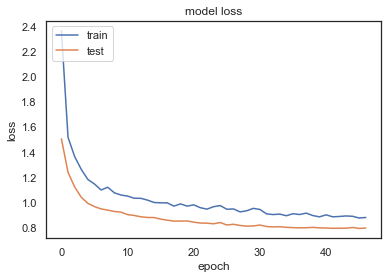

TEST WMSE =  1.0247806154871728
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00079: early stopping
duration: 40.52802801132202


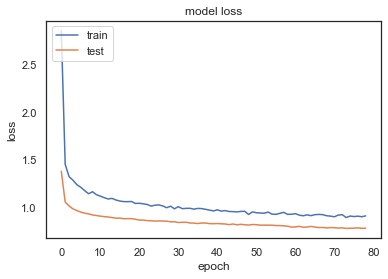

TEST WMSE =  0.8519770221952203
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 20.494822025299072


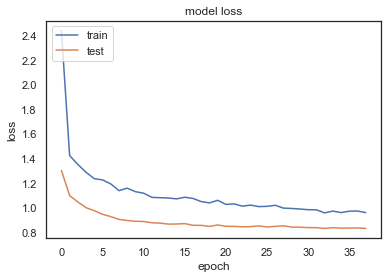

TEST WMSE =  0.8280316515131356
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00080: early stopping
duration: 38.49381923675537


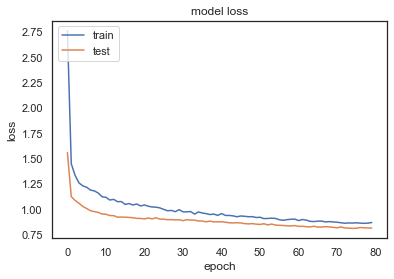

TEST WMSE =  0.8455253774224036
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 29.407469987869263


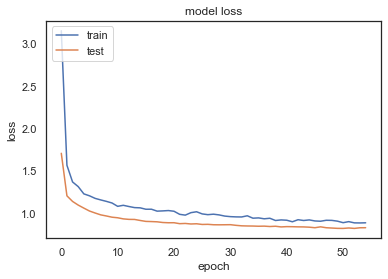

TEST WMSE =  0.9199806074666075
TEST MEAN WMSE =  0.9199806074666075


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 2
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 37.15639400482178


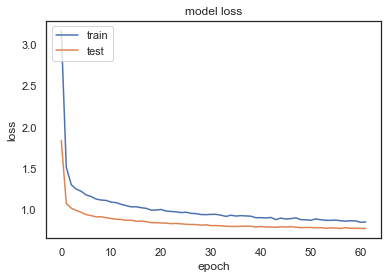

TEST WMSE =  0.9814037400062012
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00074: early stopping
duration: 38.306373834609985


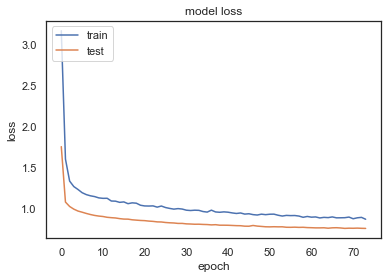

TEST WMSE =  0.839623156474283
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 30.01798701286316


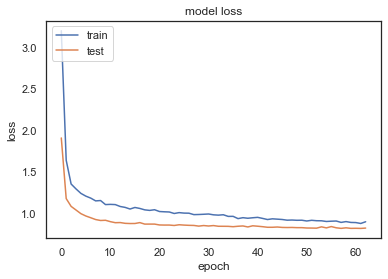

TEST WMSE =  0.8087616889369166
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 21.453463077545166


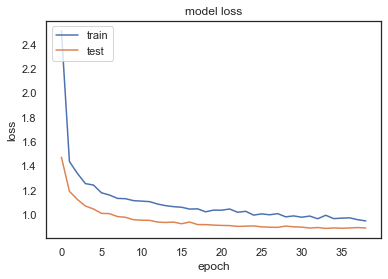

TEST WMSE =  0.8970140953901012
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 33.39368009567261


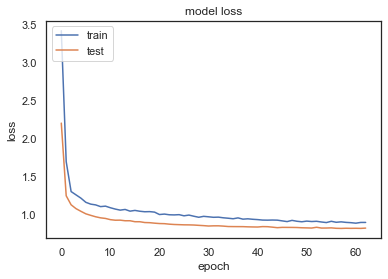

TEST WMSE =  0.9214728905765295
TEST MEAN WMSE =  0.9214728905765295


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 25.662945985794067


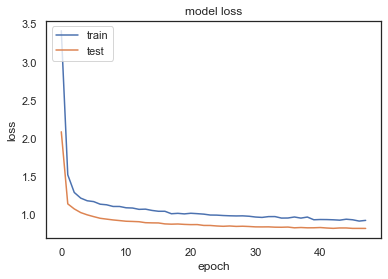

TEST WMSE =  1.056006195437172
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 27.369262218475342


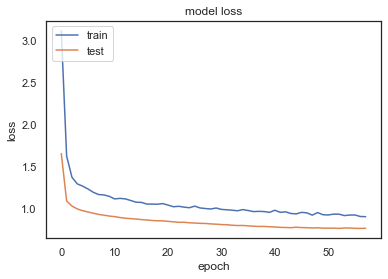

TEST WMSE =  0.82038354518974
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 18.885584831237793


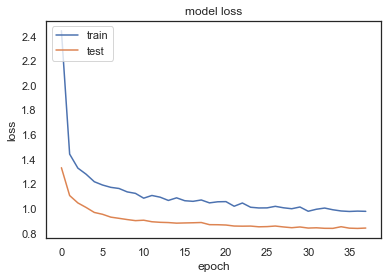

TEST WMSE =  0.8339544367568282
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 17.828334093093872


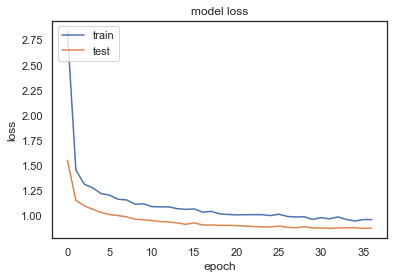

TEST WMSE =  0.8882778425658135
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 27.114765882492065


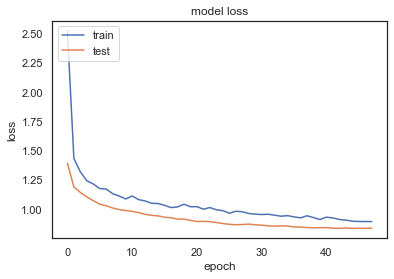

TEST WMSE =  0.9332706654002014
TEST MEAN WMSE =  0.9332706654002014


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 4
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00088: early stopping
duration: 41.666019916534424


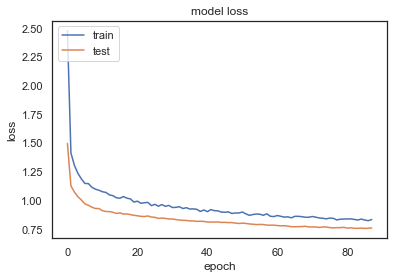

TEST WMSE =  0.9986113033636578
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00064: early stopping
duration: 30.799122095108032


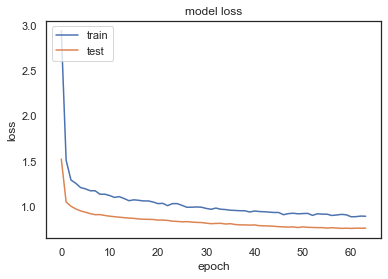

TEST WMSE =  0.8372500591524132
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 20.147637844085693


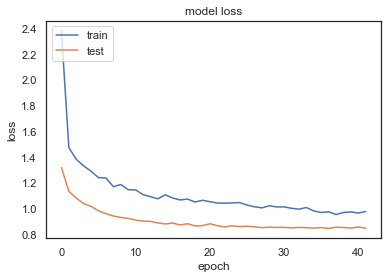

TEST WMSE =  0.8333249018960015
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00083: early stopping
duration: 36.12814784049988


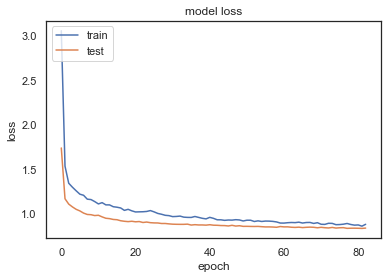

TEST WMSE =  0.8615510691372311
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 25.607517957687378


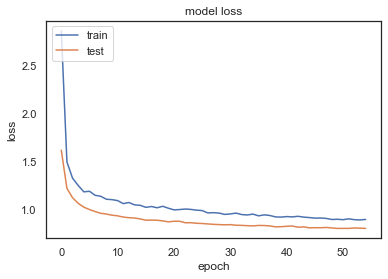

TEST WMSE =  0.9382930426813479
TEST MEAN WMSE =  0.9382930426813479


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 5
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 34.93279504776001


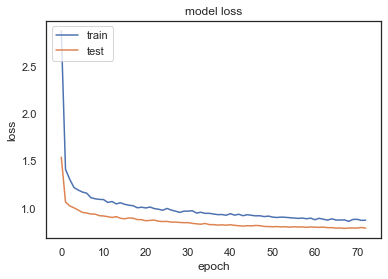

TEST WMSE =  1.0152749794244986
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 27.881407976150513


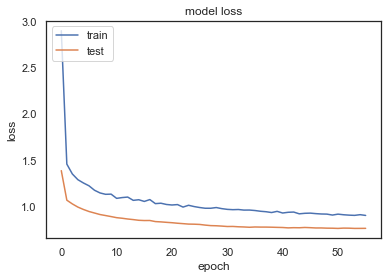

TEST WMSE =  0.8333394584059096
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 28.778265237808228


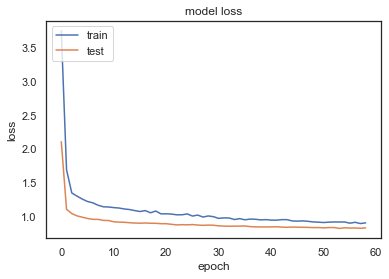

TEST WMSE =  0.8206011061803552
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00082: early stopping
duration: 37.93092179298401


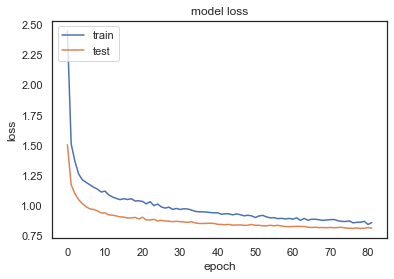

TEST WMSE =  0.8547371981023922
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00067: early stopping
duration: 33.33890414237976


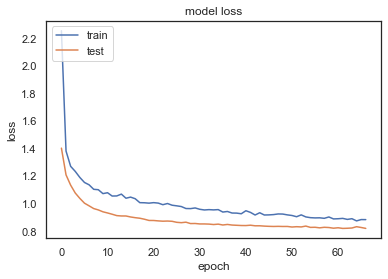

TEST WMSE =  0.9062803082563584
TEST MEAN WMSE =  0.9062803082563584


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 6
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 28.412342071533203


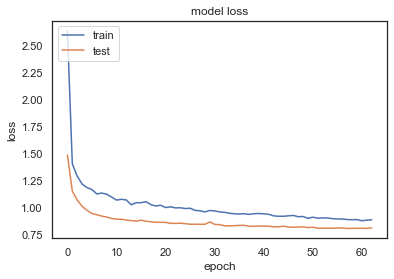

TEST WMSE =  1.0412881414412767
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00068: early stopping
duration: 32.246057987213135


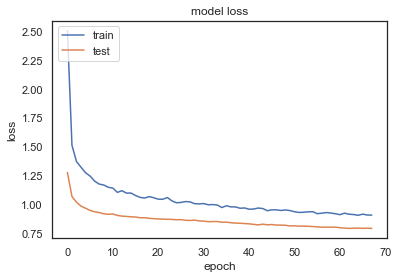

TEST WMSE =  0.8347263401516013
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 25.23599600791931


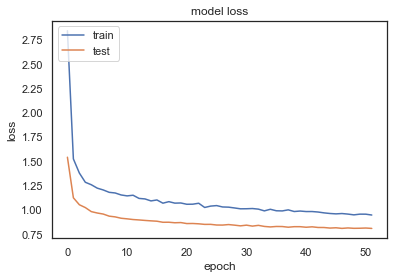

TEST WMSE =  0.8363696577573823
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 24.708109140396118


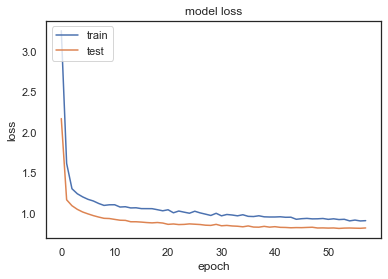

TEST WMSE =  0.8744385327059262
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 25.18083381652832


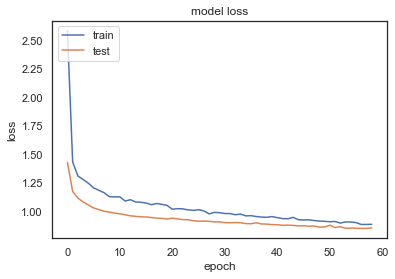

TEST WMSE =  0.937565370418869
TEST MEAN WMSE =  0.937565370418869


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 7
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00070: early stopping
duration: 29.940791130065918


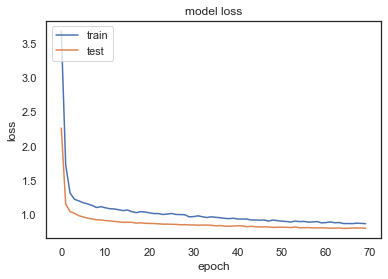

TEST WMSE =  1.0146306674004215
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00070: early stopping
duration: 41.325220823287964


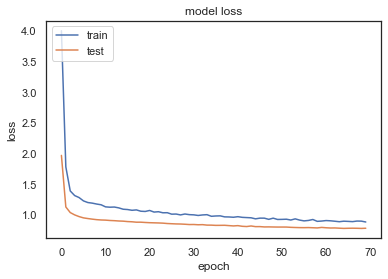

TEST WMSE =  0.8473478090092178
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 30.193281888961792


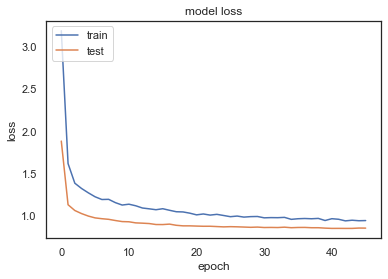

TEST WMSE =  0.8330302940080017
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 27.96123695373535


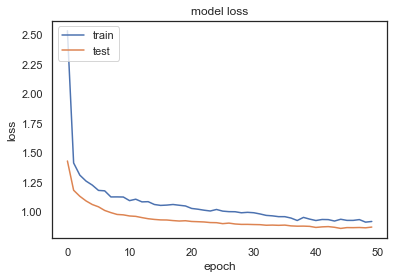

TEST WMSE =  0.8832681109485976
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 18.143821001052856


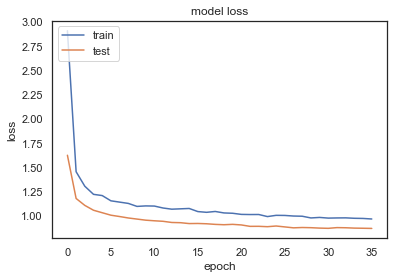

TEST WMSE =  0.9735634716246828
TEST MEAN WMSE =  0.9735634716246828


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 8
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 27.50092887878418


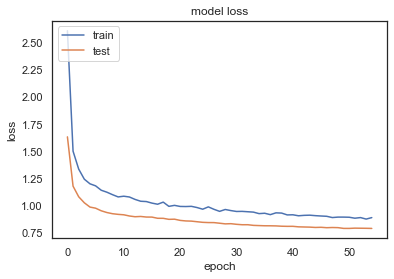

TEST WMSE =  1.0145146850243725
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 23.53434109687805


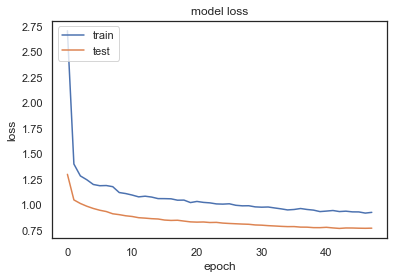

TEST WMSE =  0.8255721405823846
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00067: early stopping
duration: 32.31109094619751


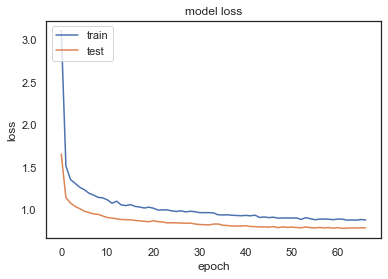

TEST WMSE =  0.803581513194072
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 17.310749292373657


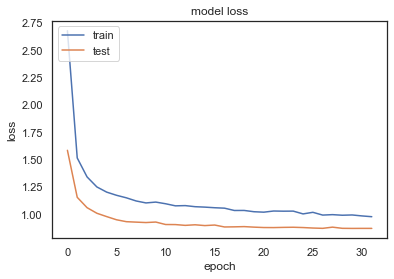

TEST WMSE =  0.8850775587230636
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 18.467793941497803


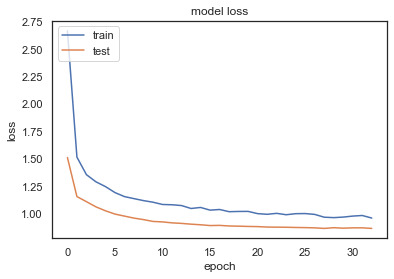

TEST WMSE =  0.9690316607129404
TEST MEAN WMSE =  0.9690316607129404


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 9
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 29.97549295425415


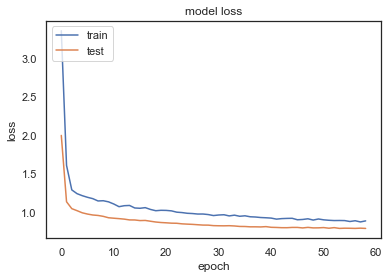

TEST WMSE =  1.0043227309048939
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00064: early stopping
duration: 31.397953033447266


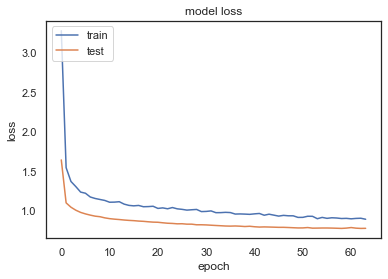

TEST WMSE =  0.8116401579470867
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 25.149399995803833


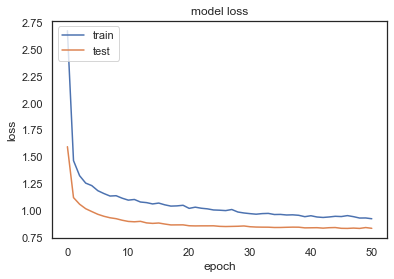

TEST WMSE =  0.8137721855617923
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 26.376803159713745


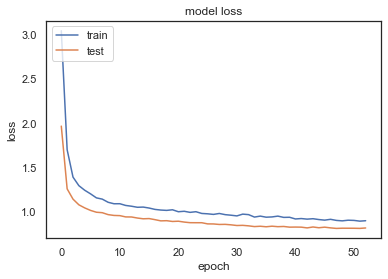

TEST WMSE =  0.8676306513848077
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 30.17506694793701


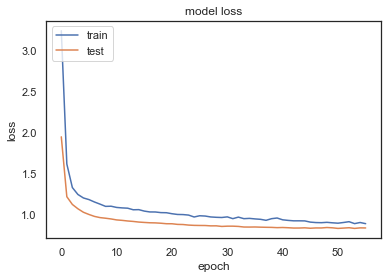

TEST WMSE =  0.9018682310970143
TEST MEAN WMSE =  0.9018682310970143


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 10
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00064: early stopping
duration: 36.56956386566162


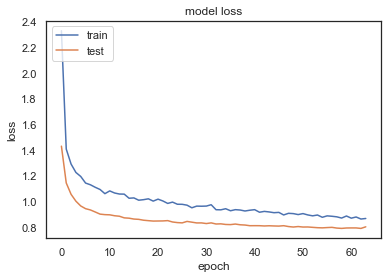

TEST WMSE =  1.0342808280706064
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00071: early stopping
duration: 36.03429698944092


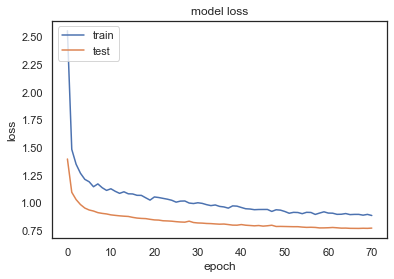

TEST WMSE =  0.8230950084886456
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 17.185341119766235


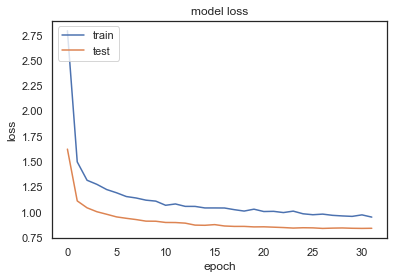

TEST WMSE =  0.8426167197568882
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 20.357242107391357


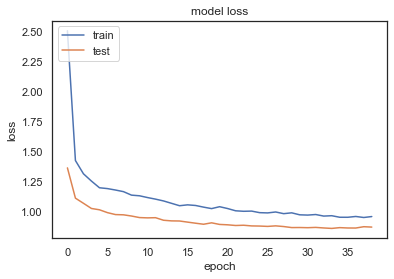

TEST WMSE =  0.8933765963069967
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 25.45770764350891


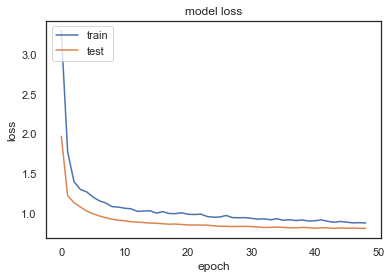

TEST WMSE =  0.9273277420004746
TEST MEAN WMSE =  0.9273277420004746


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 11
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 23.752854108810425


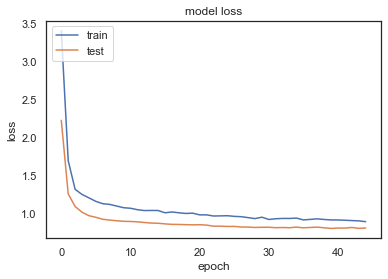

TEST WMSE =  1.0171128330503505
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00069: early stopping
duration: 33.495726108551025


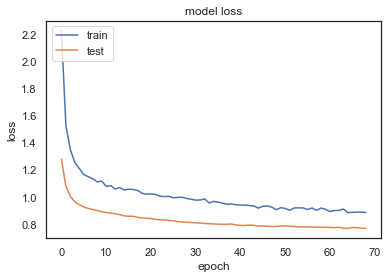

TEST WMSE =  0.8432243052864926
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 29.297138929367065


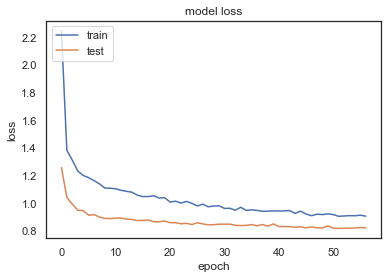

TEST WMSE =  0.8184998370074509
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00071: early stopping
duration: 34.83955216407776


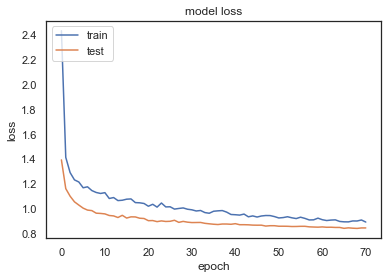

TEST WMSE =  0.8656429115054298
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 22.219552040100098


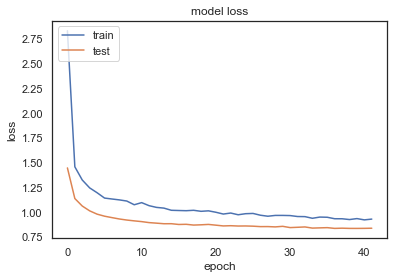

TEST WMSE =  0.9680413086484443
TEST MEAN WMSE =  0.9680413086484443


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 12
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 24.17204189300537


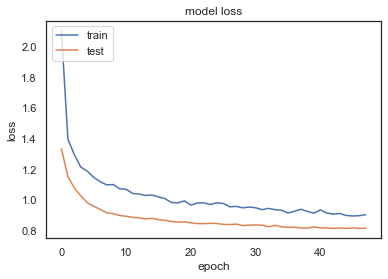

TEST WMSE =  1.0400234449213213
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 21.682472229003906


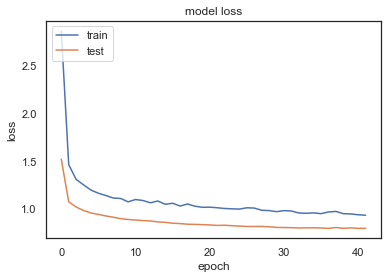

TEST WMSE =  0.8464655851651144
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 19.563172817230225


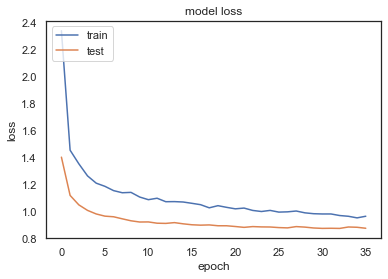

TEST WMSE =  0.8366388999015903
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 15.270745992660522


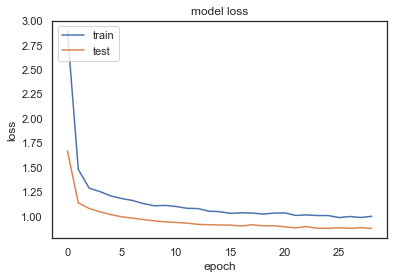

TEST WMSE =  0.8830063945711563
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 19.894974946975708


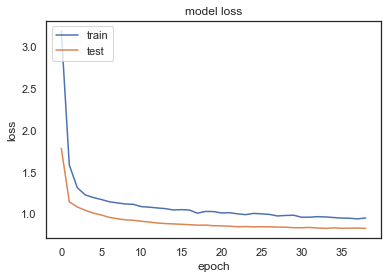

TEST WMSE =  0.9469454623538858
TEST MEAN WMSE =  0.9469454623538858


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 13
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 24.85679578781128


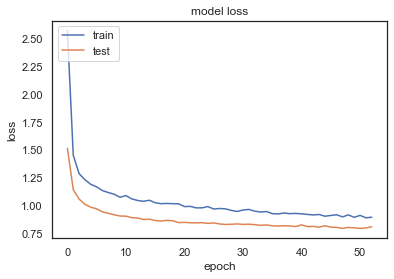

TEST WMSE =  1.0429929036268393
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00082: early stopping
duration: 33.53437900543213


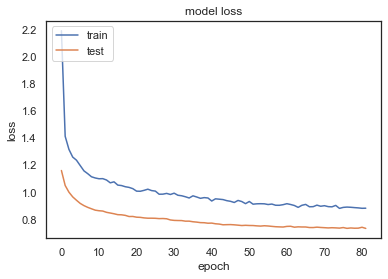

TEST WMSE =  0.8474022258040126
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 22.86417293548584


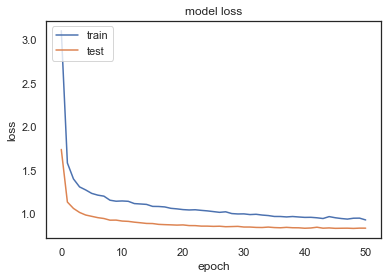

TEST WMSE =  0.8183787880496207
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 17.277733087539673


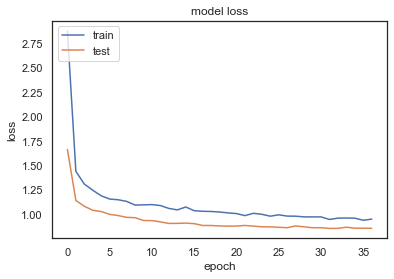

TEST WMSE =  0.885819319905157
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00074: early stopping
duration: 30.88310480117798


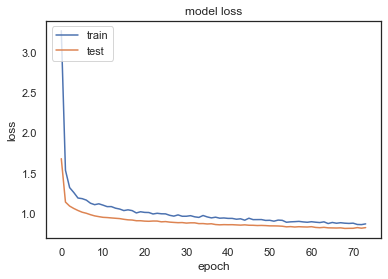

TEST WMSE =  0.9121637441283177
TEST MEAN WMSE =  0.9121637441283177


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 DROP FEATURE NUMBER -- 14
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00061: early stopping
duration: 25.470157146453857


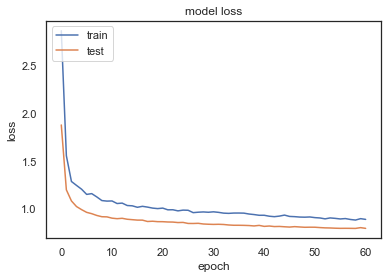

TEST WMSE =  1.0137023734320587
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 24.70128583908081


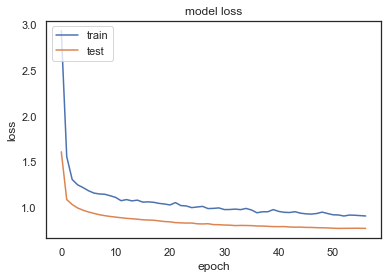

TEST WMSE =  0.8516342587228203
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 21.55947780609131


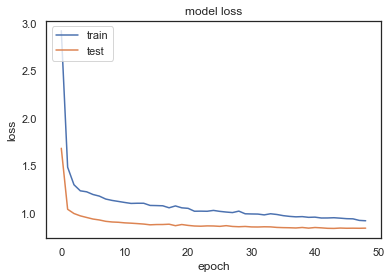

TEST WMSE =  0.8280349291340525
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 32.06357192993164


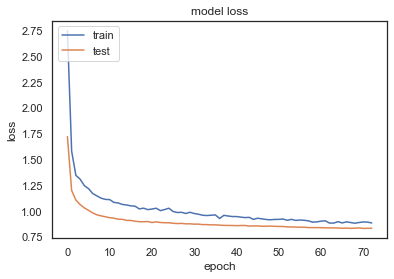

TEST WMSE =  0.869304699786282
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 30.073421001434326


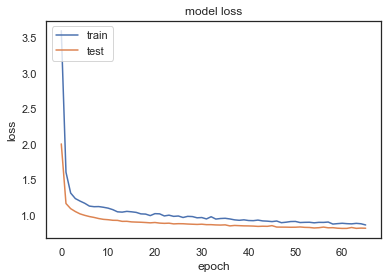

TEST WMSE =  0.9370146093902872
TEST MEAN WMSE =  0.9370146093902872


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 KEEP FEATURES -- 14
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 11.92466402053833


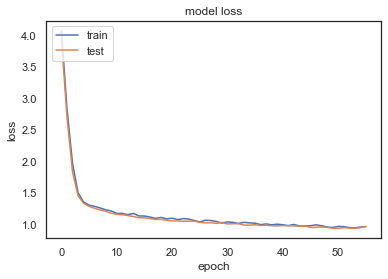

TEST WMSE =  0.9725414821323844
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00091: early stopping
duration: 17.58828616142273


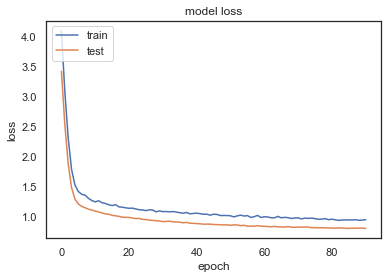

TEST WMSE =  0.8222738127043652
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 14.423312902450562


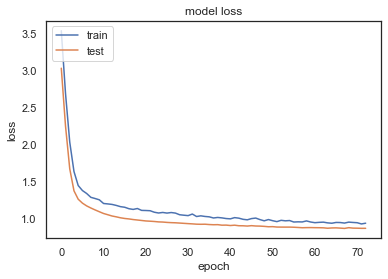

TEST WMSE =  0.7923482692849135
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00084: early stopping
duration: 16.25183892250061


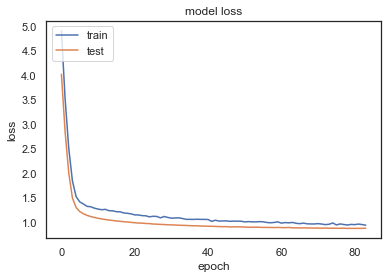

TEST WMSE =  0.8690470651505915
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00111: early stopping
duration: 20.666509866714478


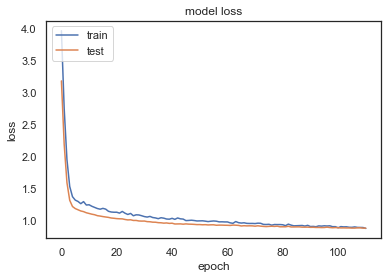

TEST WMSE =  0.8734449468588482
TEST MEAN WMSE =  0.8734449468588482


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


    exper_num  sequenc_len  num_lstm_units    n_epochs  weighted_mse_test  \
0           0          6.0             6.0   64.000000           0.981843   
1           0          6.0             6.0   38.000000           0.848710   
2           0          6.0             6.0   39.000000           0.836241   
3           0          6.0             6.0   50.000000           0.868372   
4           0          6.0             6.0   36.000000           0.954670   
5        mean          6.0             6.0   45.400000           0.897967   
6         std          0.0             0.0    5.831981           0.047224   
7           0          6.0             6.0   47.000000           1.024781   
8           0          6.0             6.0   79.000000           0.851977   
9           0          6.0             6.0   38.000000           0.828032   
10          0          6.0             6.0   80.000000           0.845525   
11          0          6.0             6.0   55.000000           0.919981   

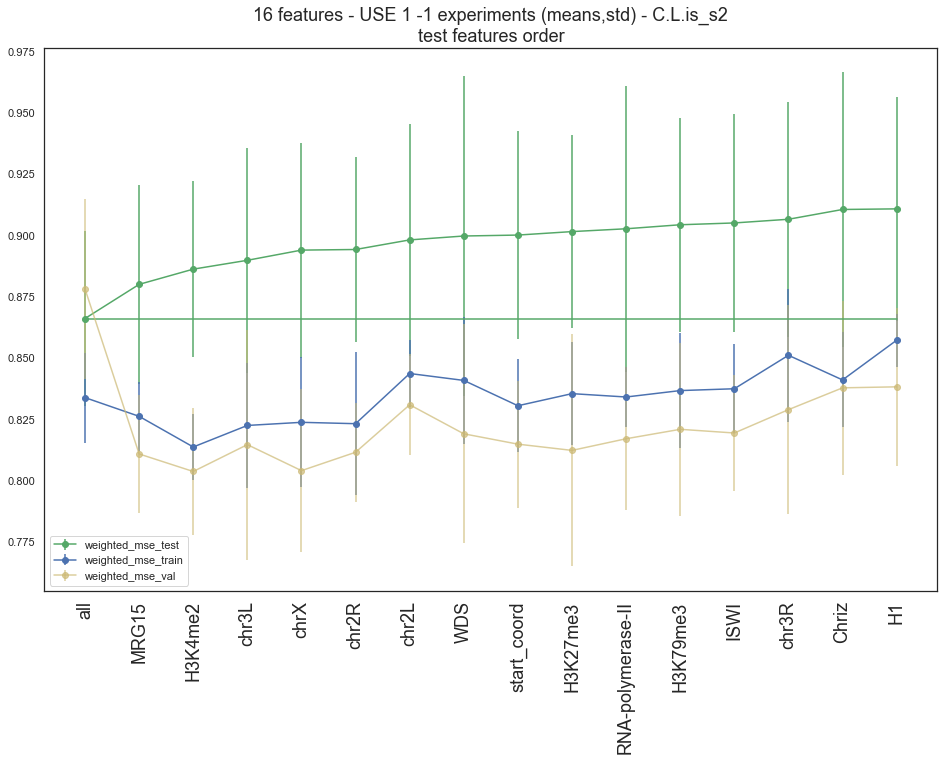

H3K4me2
chr3L
chr2R
chrX
MRG15
start_coord
all
RNA-polymerase-II
H3K27me3
H3K79me3
ISWI
WDS
Chriz
chr2L
chr3R
H1
num_features:  16


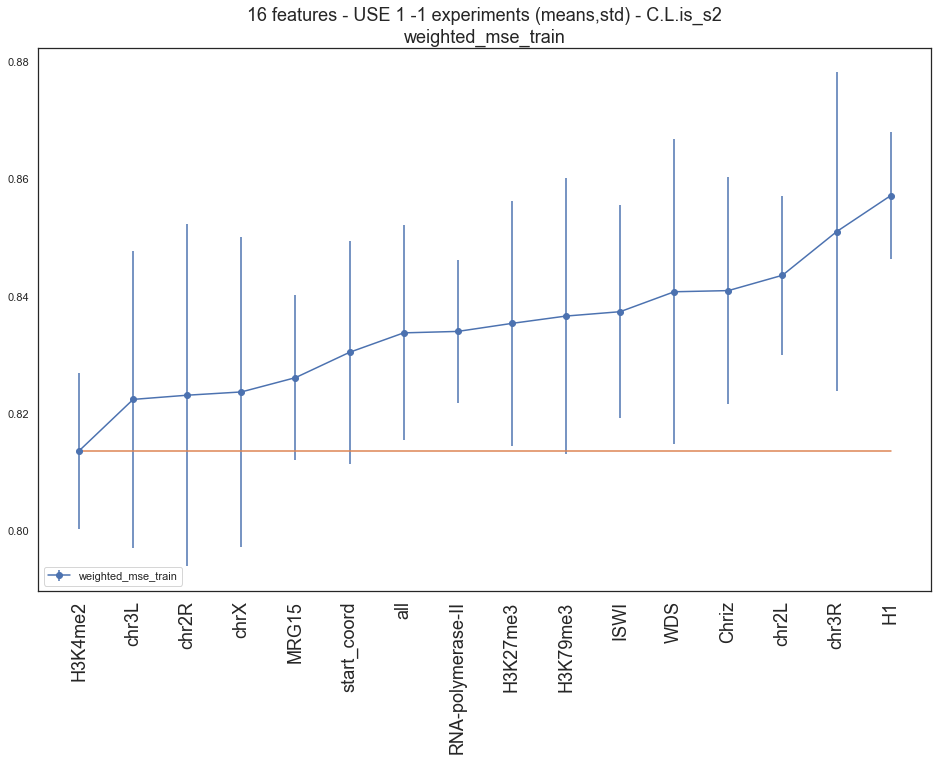

all
MRG15
H3K4me2
chr3L
chrX
chr2R
chr2L
WDS
start_coord
H3K27me3
RNA-polymerase-II
H3K79me3
ISWI
chr3R
Chriz
H1
num_features:  16


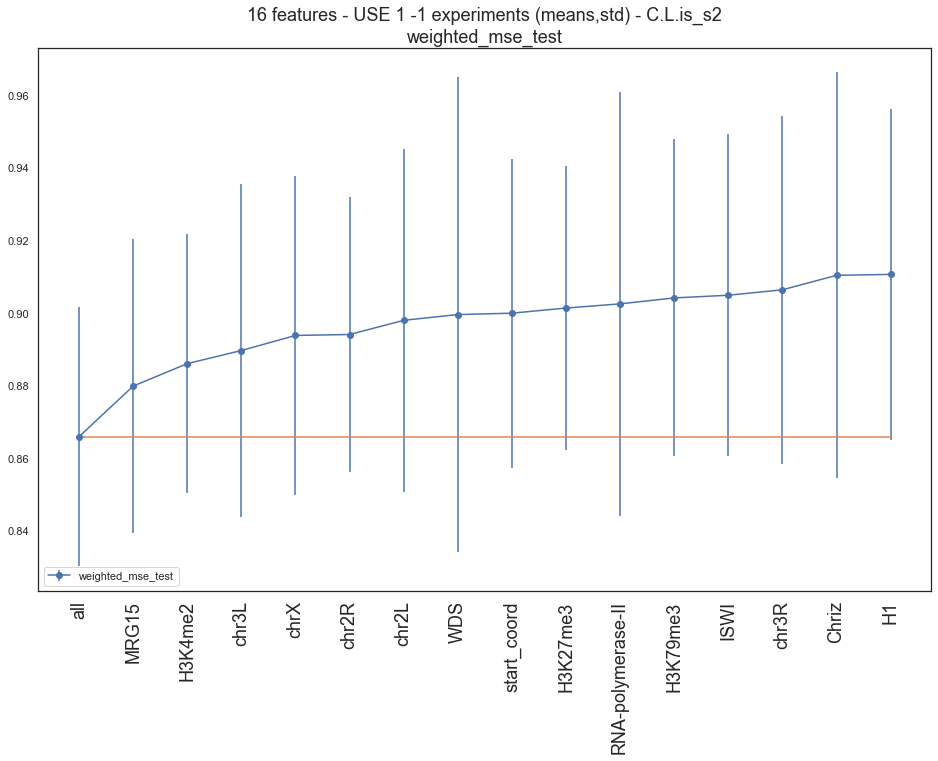

TEST wMSE using 1
all , 0.8659311152262206
MRG15 , 0.8798467913791189
H3K4me2 , 0.8860466100739028
chr3L , 0.8896551142768063
chrX , 0.8938060752461302
chr2R , 0.8940590548169081
chr2L , 0.897967373464577
WDS , 0.8995555116473666
start_coord , 0.8999381740931002
H3K27me3 , 0.9013513963027895
RNA-polymerase-II , 0.9025042390996336
H3K79me3 , 0.9041393789247223
ISWI , 0.9048776084950111
chr3R , 0.906378537069951
Chriz , 0.9103680705981845
H1 , 0.9106159573826137
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 15) (1248, 6, 15) (4161,) (1248,)
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 24.463202953338623


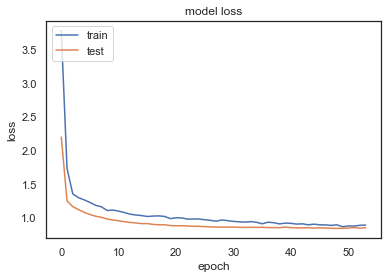

TEST WMSE =  0.9774959755737501
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 15.748439073562622


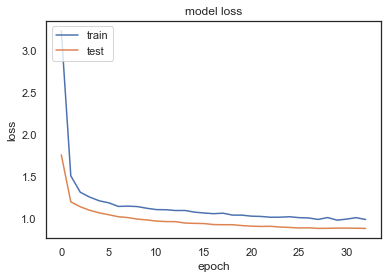

TEST WMSE =  0.8478612210608929
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 27.126292943954468


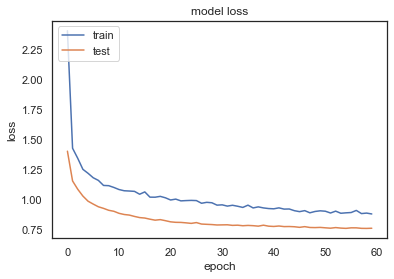

TEST WMSE =  0.8234450731135972
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 29.7569420337677


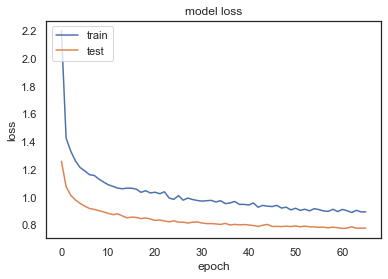

TEST WMSE =  0.8912575700141768
x_val.shape = (357, 6, 15)
y_val.shape = (357,)
x_train.shape = (4756, 6, 15)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 30.153145790100098


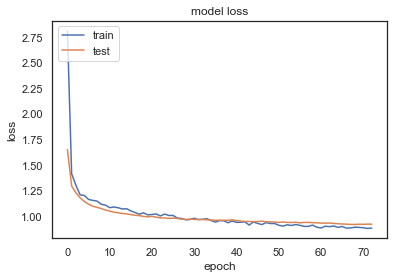

TEST WMSE =  0.8820163555920815
TEST MEAN WMSE =  0.8820163555920815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [26]:
# data_csv = "_example_results_18_bioset_10_exps_23_04_20.csv"

# num_experements = 1

# cell_line = 'is_s2' #  'all' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'

# bioset = None  # bioset: defines the biological features to use. 
#                #  If bioset is None, use all availible features
# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
# data_path = data_path_35features


# target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"  # "../data/epigenetics/s2_kc_bg_clean_gamma.csv"
# index_col = 0
# random_state = 16 # None  # Shuffle the data splittings
# batch_size = 60 
# sequenc_len_list =  [6]
# num_lstm_units = 64 
# n_epochs_max = 364 
# num_folds = 5
# file_path = "../exps" + data_csv
# use_chr_onehotenc = True
# use_coord_scale = True

# do_only_1_feature_exps = True 
# do_drop_1_feature_exps = True

# eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
#             mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
#             data_scaled_clean, target_clean, = main_analysis(data_path,  
#                                                        cell_line, 
#                                                        bioset, 
#                                                        num_experements,
#                                                        sequenc_len_list = [6], 
#                                                        num_lstm_units = 6,
#                                                        num_folds = num_folds,
#                                                        batch_size = batch_size,
#                                                        do_only_1_feature_exps = do_only_1_feature_exps, 
#                                                        do_drop_1_feature_exps = do_drop_1_feature_exps,
#                                                        do_all_together = True,
#                                                        use_chr_onehotenc = use_chr_onehotenc,
#                                                        use_coord_scale=use_coord_scale,
#                                                        verbose=True)


In [27]:
eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,54.000000,0.977496,0.803833,0.854980,1.654079,60.0,24.463203,-1.0
1,0,6.0,6.0,33.000000,0.847861,0.888689,0.877758,1.613542,60.0,15.748439,-1.0
2,0,6.0,6.0,60.000000,0.823445,0.810757,0.759329,1.630521,60.0,27.126293,-1.0
3,0,6.0,6.0,66.000000,0.891258,0.822202,0.778491,1.671273,60.0,29.756942,-1.0
4,0,6.0,6.0,73.000000,0.882016,0.815993,0.925336,1.651430,60.0,30.153146,-1.0
5,mean,6.0,6.0,57.200000,0.884415,0.828295,0.839179,1.644169,60.0,25.449605,-1.0
6,std,0.0,0.0,15.153481,0.029040,0.031717,0.068776,0.021749,0.0,5.861010,0.0


# KC 

data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Using features bioset: ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac', 'is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord']
Using cell line: is_kc
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac'], dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (5950, 11)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (5950, 3)
target.column = Index(['chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF    Su(Hw)  \
0      1      0      0  chr2L            

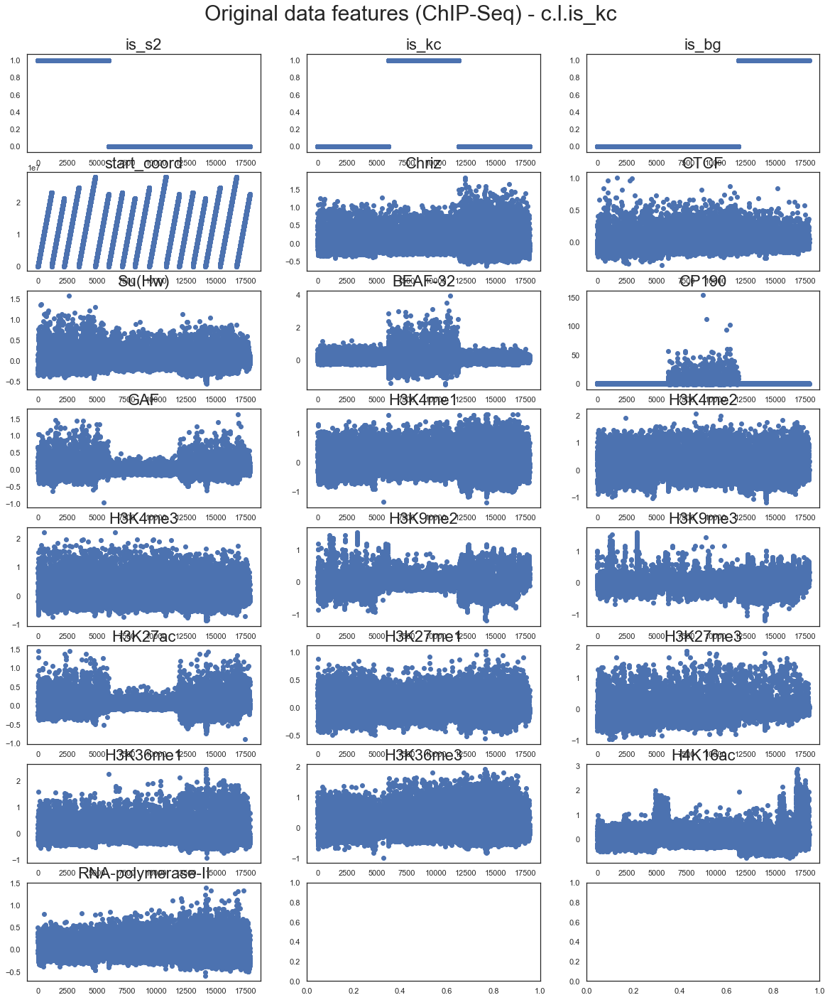

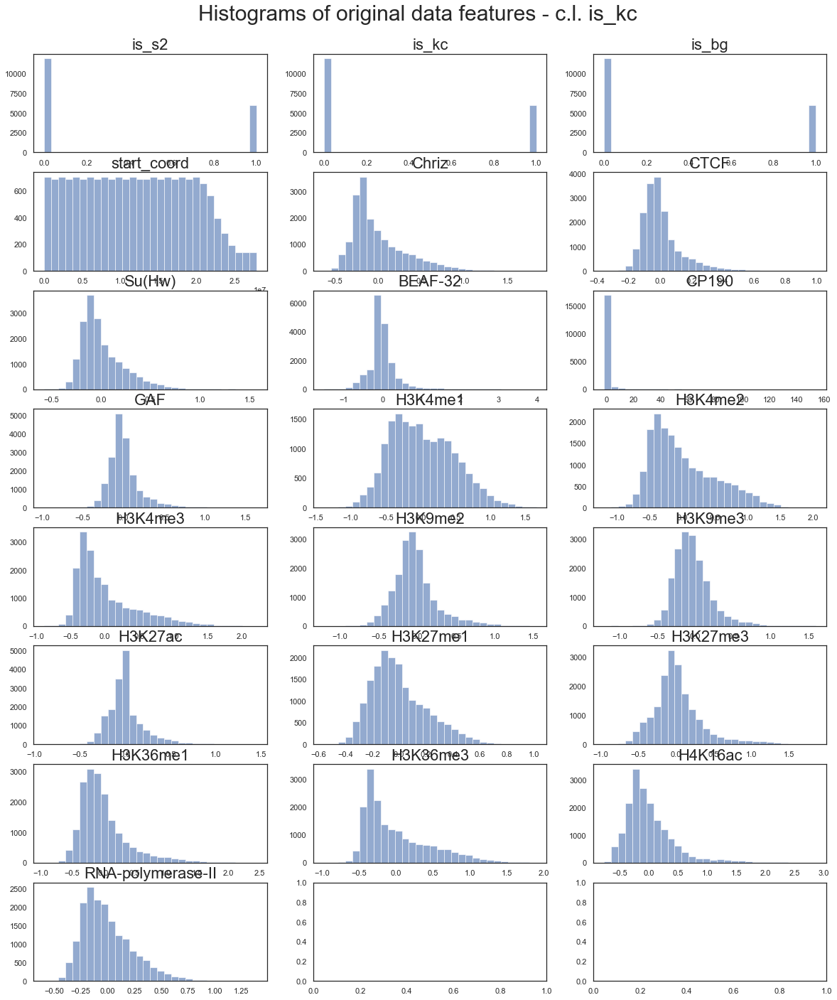

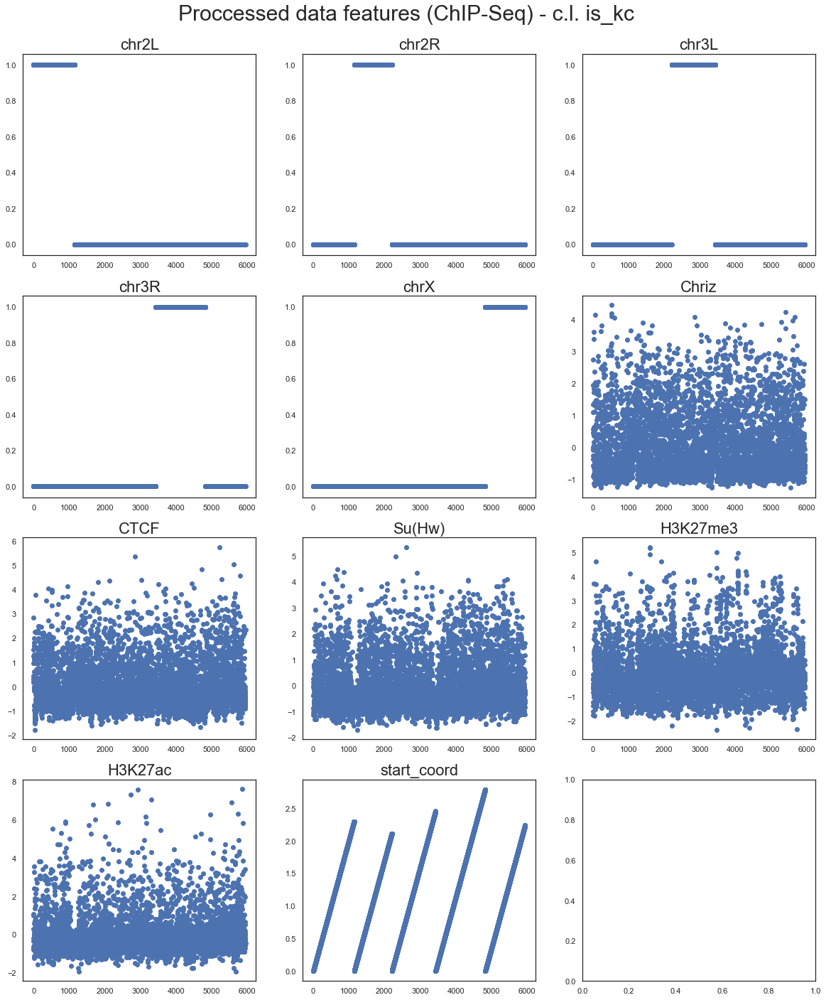

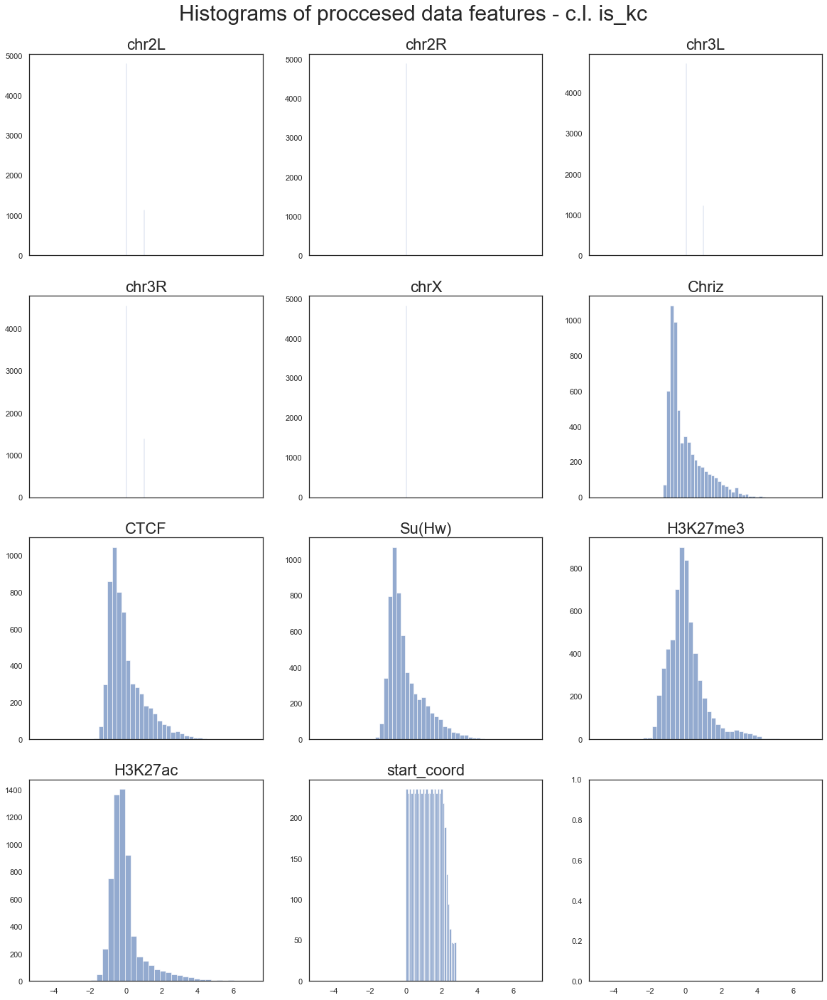

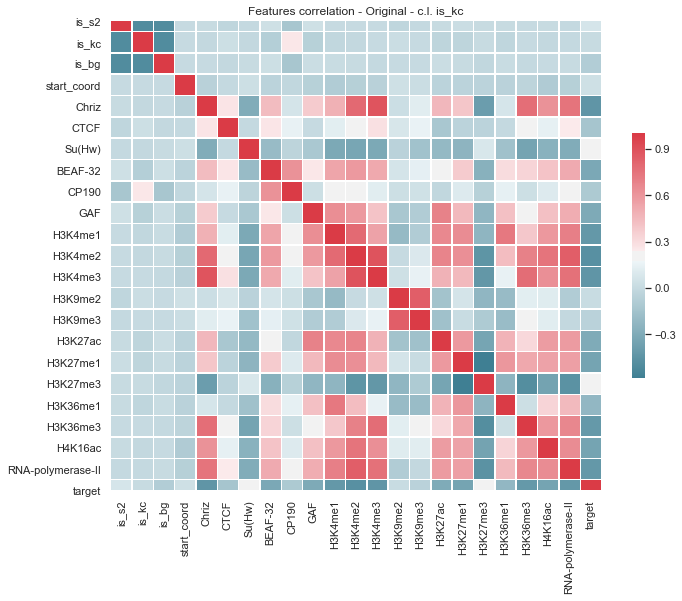

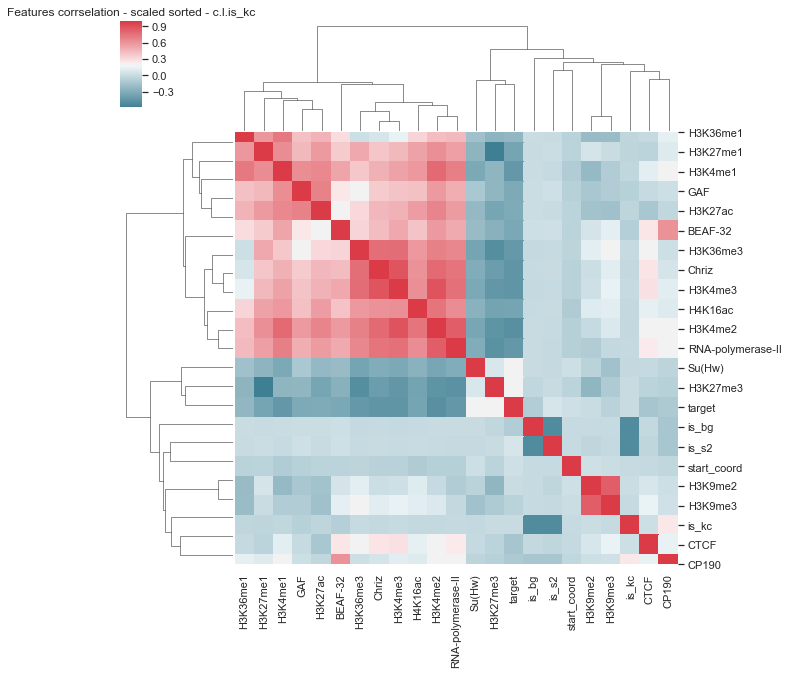

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


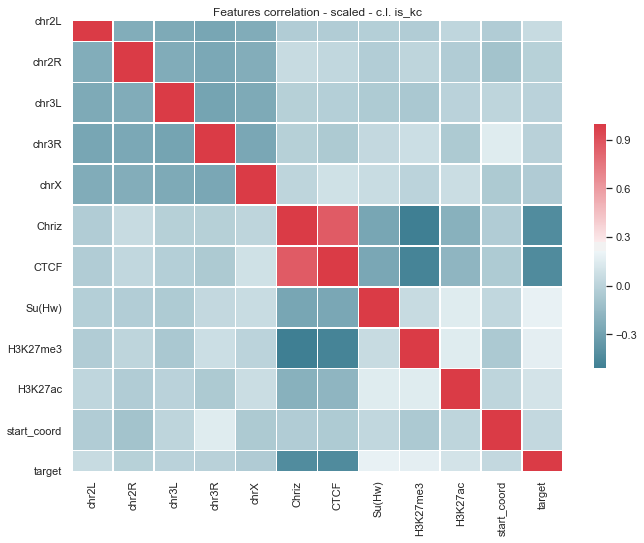

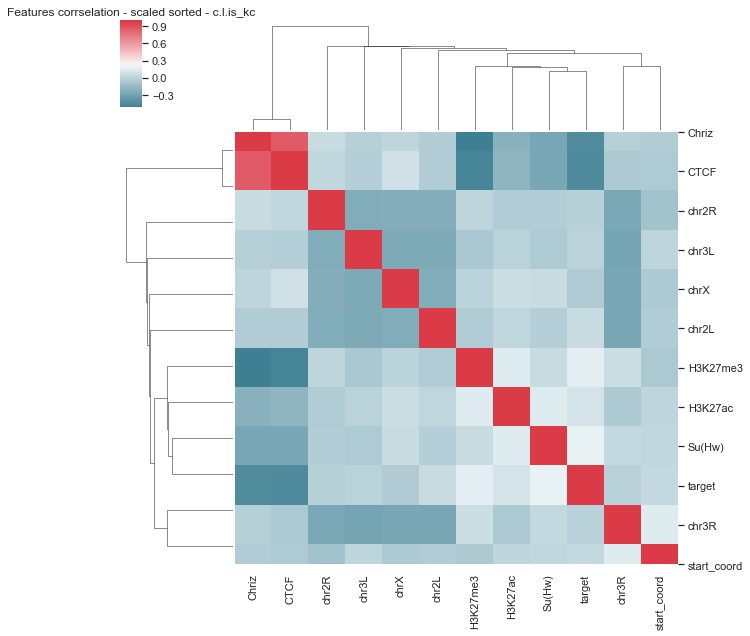

chr2L          0.051025
chr2R         -0.011596
chr3L          0.002322
chr3R         -0.002619
chrX          -0.039756
Chriz         -0.428247
CTCF          -0.437151
Su(Hw)         0.188862
H3K27me3       0.170791
H3K27ac        0.098358
start_coord    0.036143
target         1.000000
Name: target, dtype: float64 Index(['CTCF', 'Chriz', 'chrX', 'chr2R', 'chr3R', 'chr3L', 'start_coord',
       'chr2L', 'H3K27ac', 'H3K27me3', 'Su(Hw)', 'target'],
      dtype='object')
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 11) (1248, 6, 11) (4161,) (1248,)
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 24.121410846710205


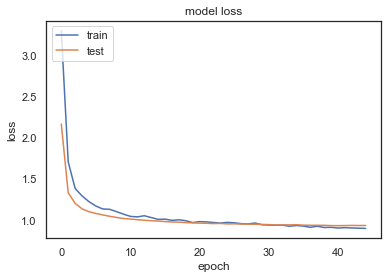

TEST WMSE =  0.8523743219506074
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 


In [ ]:
# data_csv = "_KC_9_bioset_1_exps_13_05_20.csv"

# num_experements = 1

# cell_line =  'is_kc' #  'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


# bioset = None  # bioset: defines the biological features to use. 
#                #  If bioset is None, use all availible features
# bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
#          'is_s2', 'is_kc', 'is_bg', 
#          'chrN', 'start_coord']

# # bioset = [ 
# #     'H3K4me2', 
# #     'ISWI',
# #     'Chriz',
# #     'WDS', 
# #     'MRG15',
# #     'H3K79me3', 
# #     'RNA-polymerase-II',
# #     'H1', 
# #     'H3K27me3',
# #     'is_s2', 'is_kc', 'is_bg', 
# #     'chrN', 
# #     'start_coord',
# #   ]


# # data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
# data_path = data_path_18features

# target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
# index_col = 0

# random_state = 16 # None  # Shuffle the data splittings
# batch_size = 60 
# sequenc_len_list =  [6]
# num_lstm_units = 64 
# n_epochs_max = 364 
# num_folds = 5
# file_path = "./exps" + data_csv
# use_chr_onehotenc = True
# use_coord_scale = True

# eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
#             mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
#             data_scaled_clean, target_clean, = main_analysis(data_path,  
#                                                        cell_line, 
#                                                        bioset, 
#                                                        num_experements,
#                                                        sequenc_len_list = [6], 
#                                                        num_lstm_units = 6,
#                                                        num_folds = num_folds,
#                                                        batch_size = batch_size,
#                                                        do_only_1_feature_exps = False, 
#                                                        do_drop_1_feature_exps = False,
#                                                        do_all_together = True,
#                                                        use_chr_onehotenc = use_chr_onehotenc,
#                                                        use_coord_scale=use_coord_scale,
#                                                        verbose=True)


data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Using features bioset: ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac', 'is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord']
Using cell line: is_bg
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac'], dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (5950, 11)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (5950, 3)
target.column = Index(['chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF    Su(Hw)  \
0      1      0      0  chr2L            

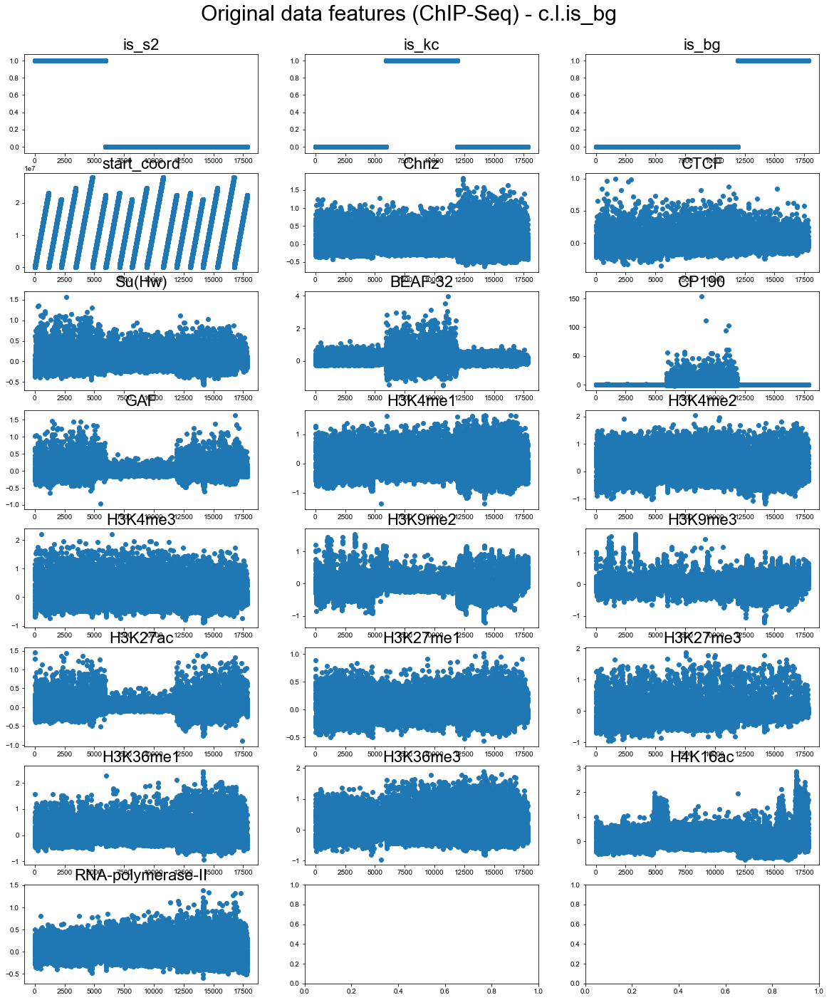

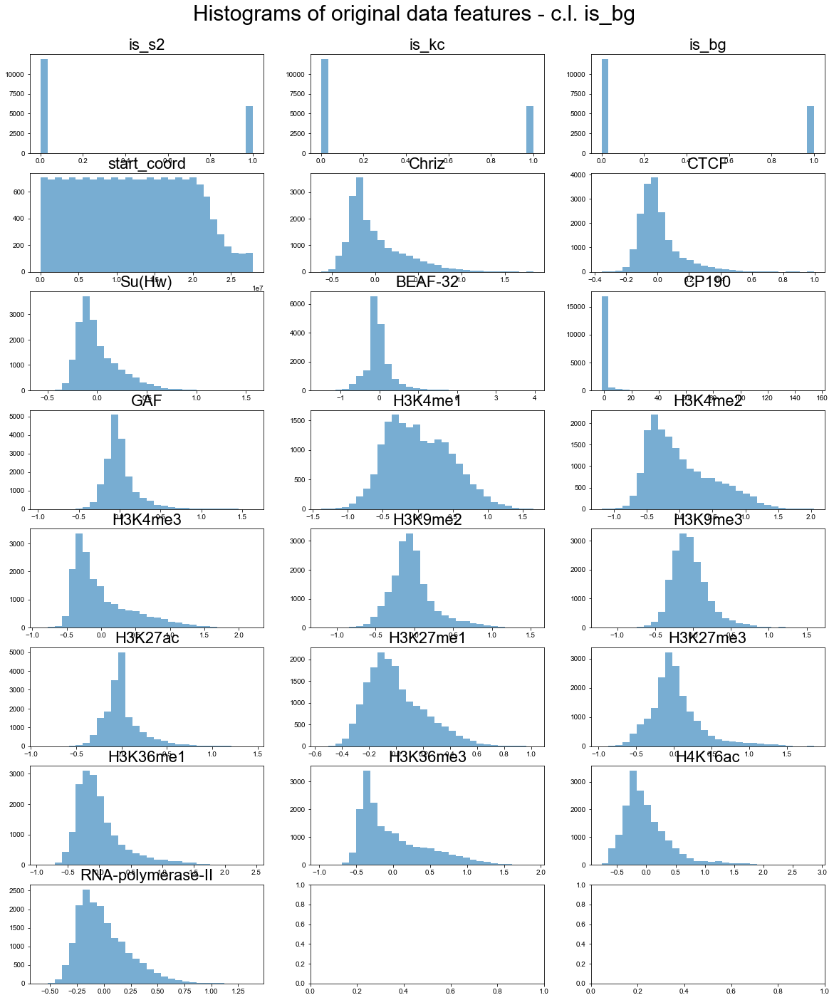

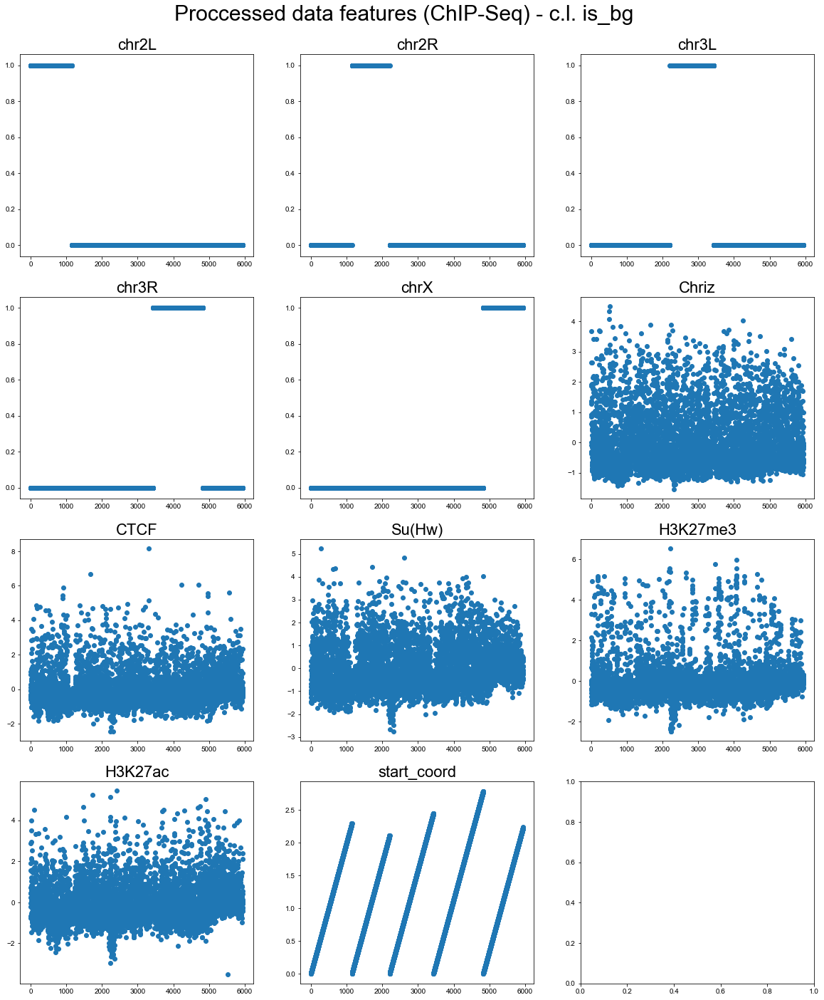

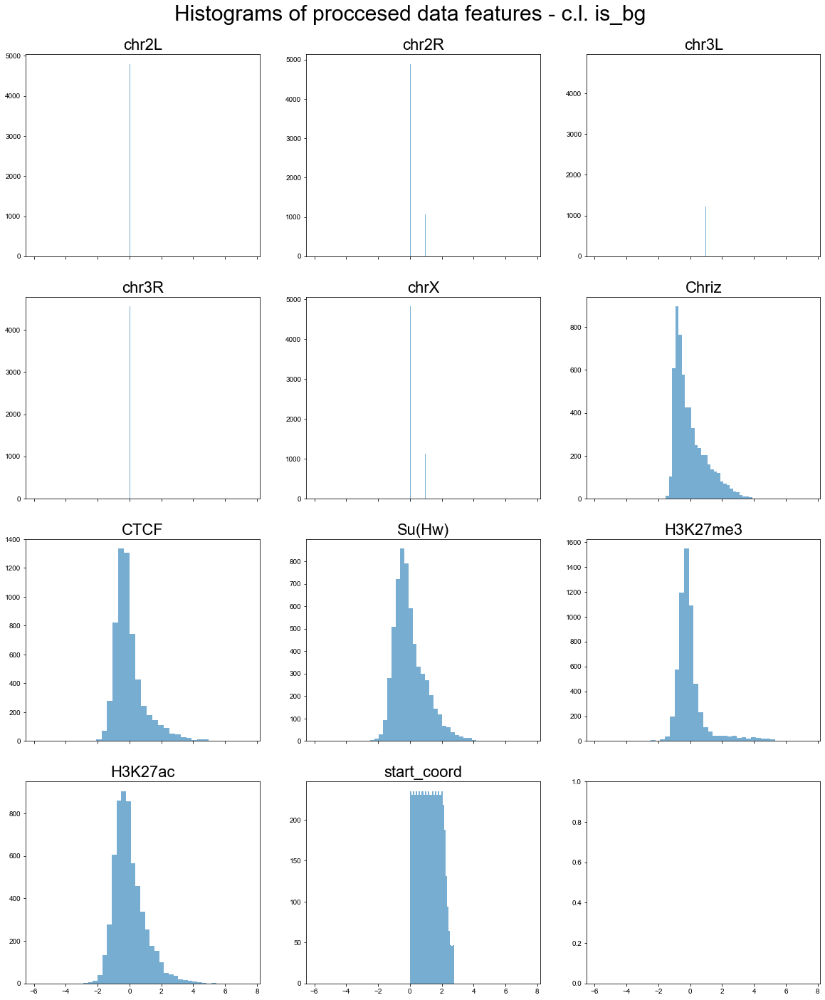

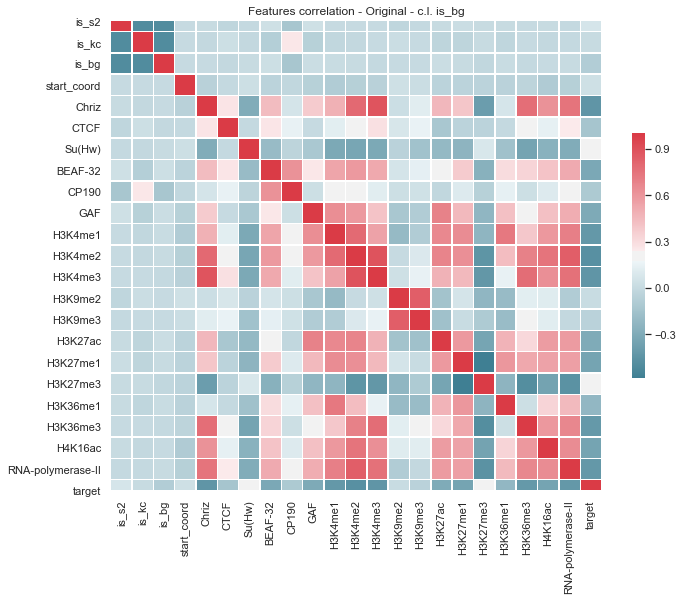

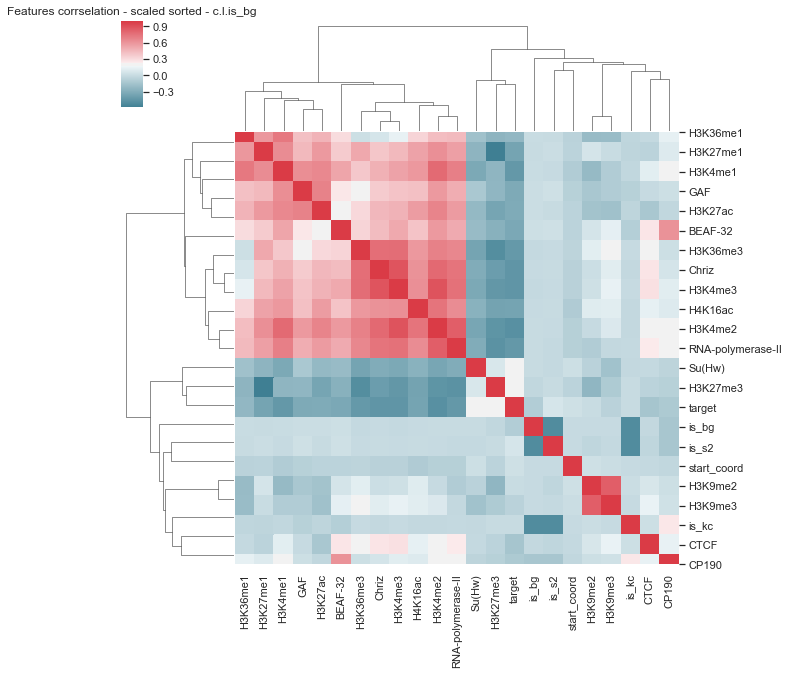

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


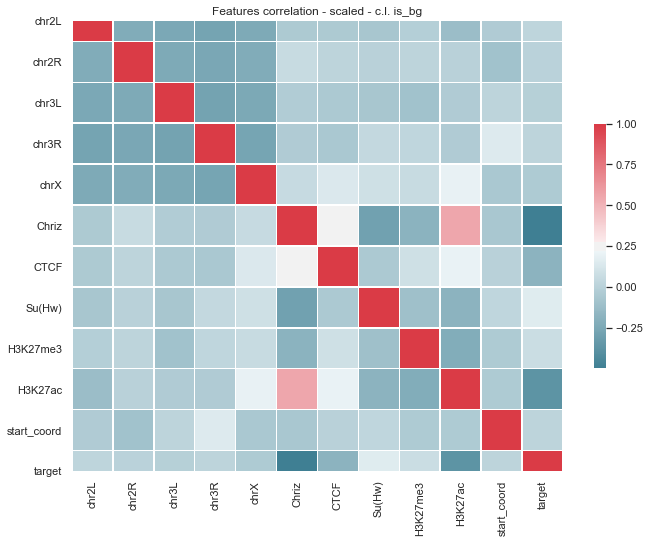

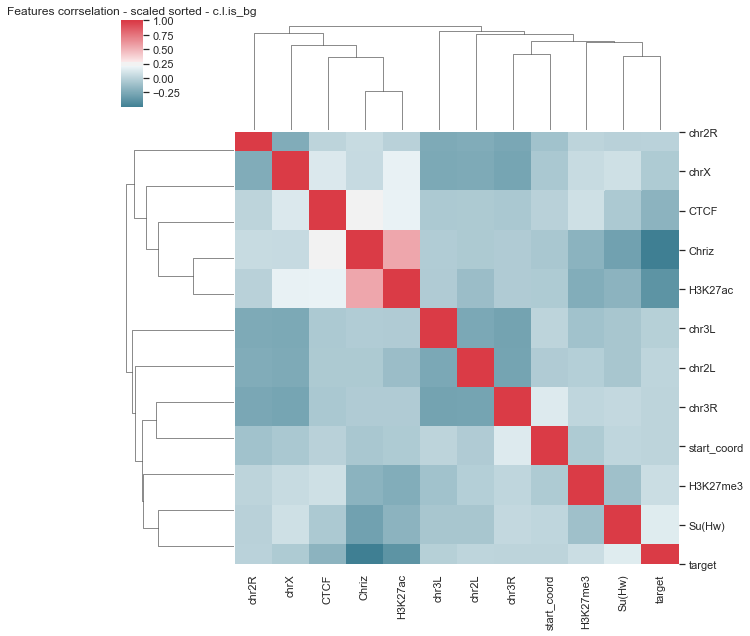

chr2L          0.025166
chr2R          0.006512
chr3L         -0.010068
chr3R          0.018438
chrX          -0.041338
Chriz         -0.499150
CTCF          -0.181844
Su(Hw)         0.159509
H3K27me3       0.072787
H3K27ac       -0.374909
start_coord    0.020135
target         1.000000
Name: target, dtype: float64 Index(['Chriz', 'H3K27ac', 'CTCF', 'chrX', 'chr3L', 'chr2R', 'chr3R',
       'start_coord', 'chr2L', 'H3K27me3', 'Su(Hw)', 'target'],
      dtype='object')
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (4161, 6, 11) (1248, 6, 11) (4161,) (1248,)
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 24.747675895690918


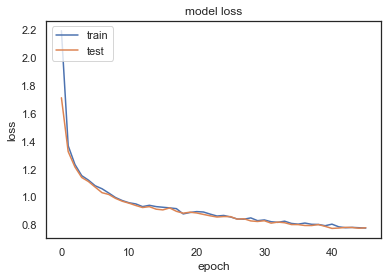

TEST WMSE =  0.7264999048470826
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 26.792768955230713


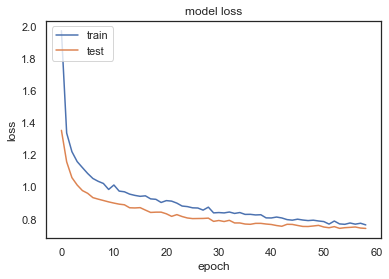

TEST WMSE =  0.7141331195893744
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 20.565337657928467


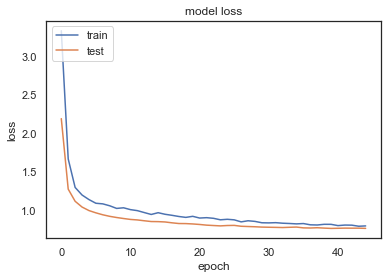

TEST WMSE =  0.6823592895052758
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 26.511956930160522


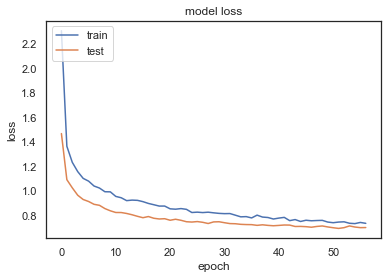

TEST WMSE =  0.8022355623732215
x_val.shape = (357, 6, 11)
y_val.shape = (357,)
x_train.shape = (4756, 6, 11)
y_train.shape = (4756,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 29.679569005966187


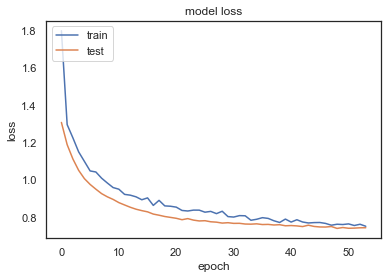

TEST WMSE =  0.7270640583509136
TEST MEAN WMSE =  0.7270640583509136


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [14]:
data_csv = "_BG_9_bioset_1_exps_13_05_20.csv"

num_experements = 1

cell_line = 'is_bg' #   'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
         'is_s2', 'is_kc', 'is_bg', 
         'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 5
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = False, 
                                                       do_drop_1_feature_exps = False,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)


In [15]:
eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,46.000000,0.726500,0.712944,0.780232,1.389985,60.0,24.747676,-1.0
1,0,6.0,6.0,59.000000,0.714133,0.697686,0.742784,1.345697,60.0,26.792769,-1.0
2,0,6.0,6.0,45.000000,0.682359,0.718220,0.766337,1.347187,60.0,20.565338,-1.0
3,0,6.0,6.0,57.000000,0.802236,0.672510,0.699802,1.446614,60.0,26.511957,-1.0
4,0,6.0,6.0,54.000000,0.727064,0.687694,0.744934,1.322466,60.0,29.679569,-1.0
5,mean,6.0,6.0,52.200000,0.730458,0.697811,0.746818,1.370390,60.0,25.659462,-1.0
6,std,0.0,0.0,5.400741,0.043990,0.016682,0.024434,0.047901,0.0,3.314975,0.0


In [ ]:
data_csv = "_BG_18_bioset_1_exps_13_05_20.csv"

num_experements = 1

cell_line = 'is_bg' #   'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
# bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
#          'is_s2', 'is_kc', 'is_bg', 
#          'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 5
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_18f, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = False, 
                                                       do_drop_1_feature_exps = False,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)


data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Using cell line: is_bg
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'BEAF-32', 'CP190', 'GAF', 'H3K4me1',
       'H3K4me2', 'H3K4me3', 'H3K9me2', 'H3K9me3', 'H3K27ac', 'H3K27me1',
       'H3K27me3', 'H3K36me1', 'H3K36me3', 'H4K16ac', 'RNA-polymerase-II'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (5950, 24)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (5950, 3)
target.column = Index(['chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF    Su(Hw

data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Using features bioset: ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac', 'is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord']
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac'], dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (17850, 14)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (17850, 6)
target.column = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF    Su(Hw)  \
0      1      0      0  chr2L      

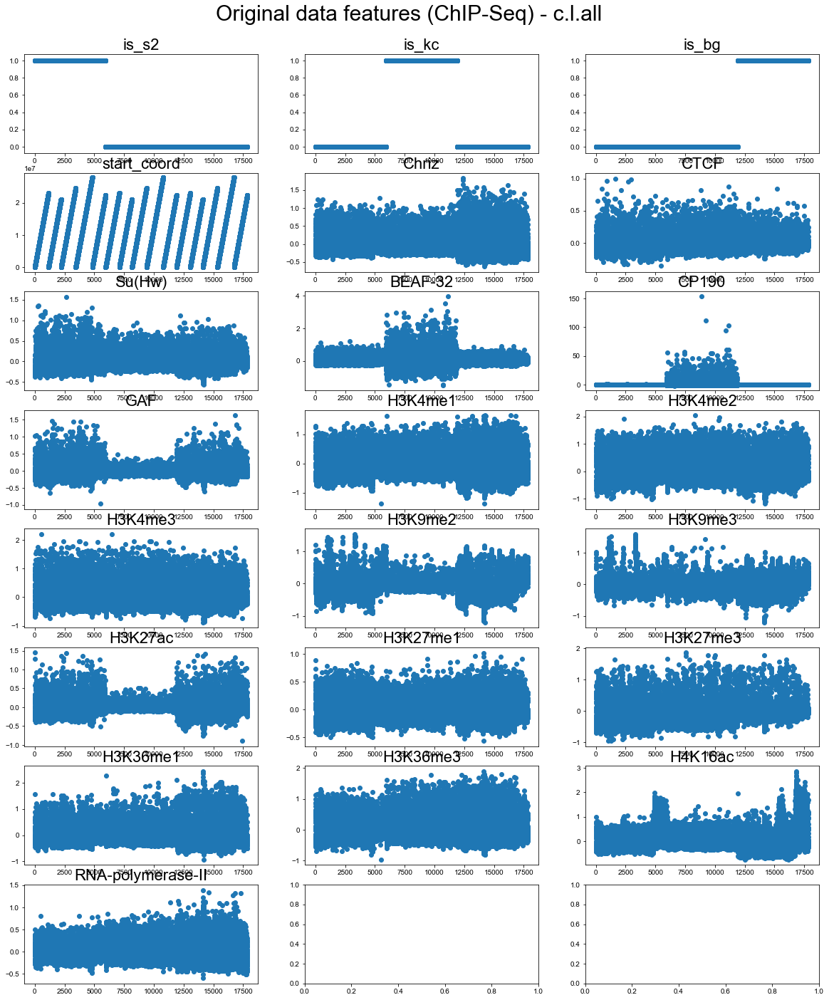

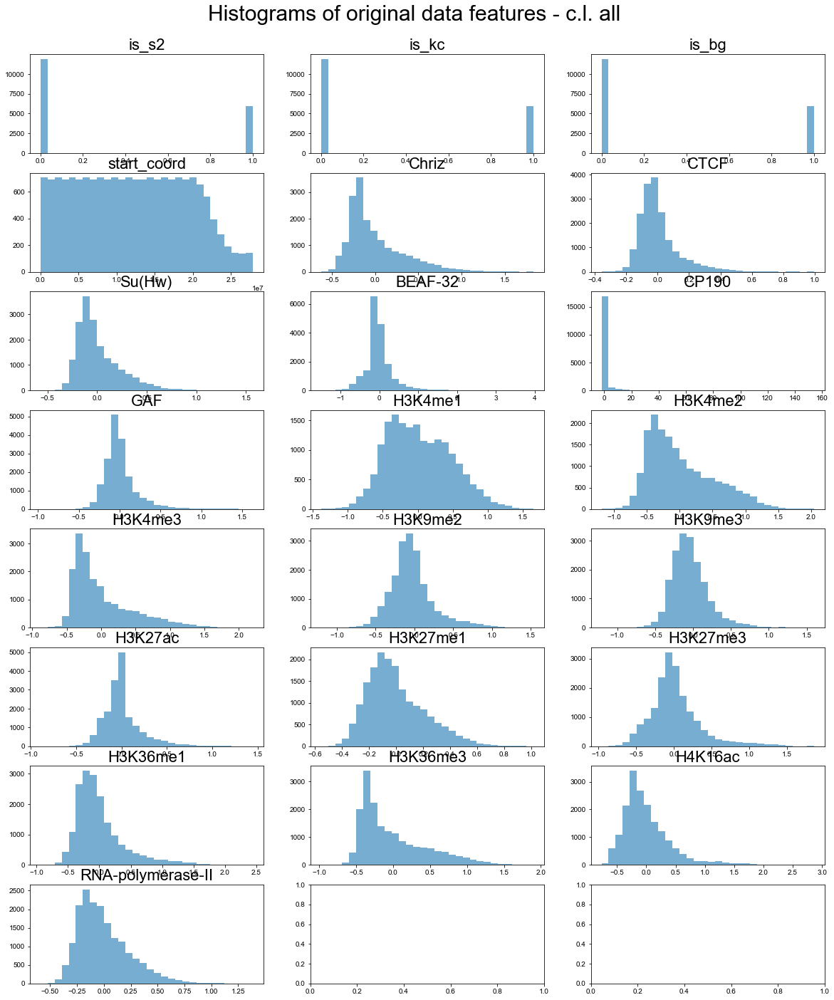

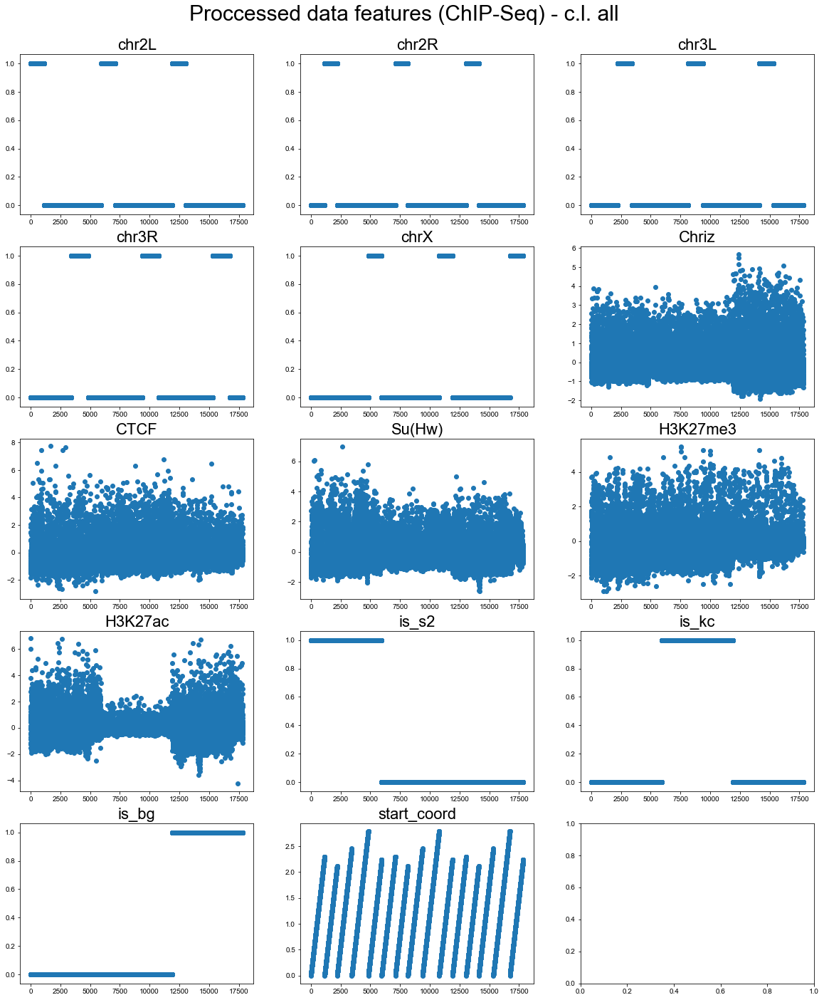

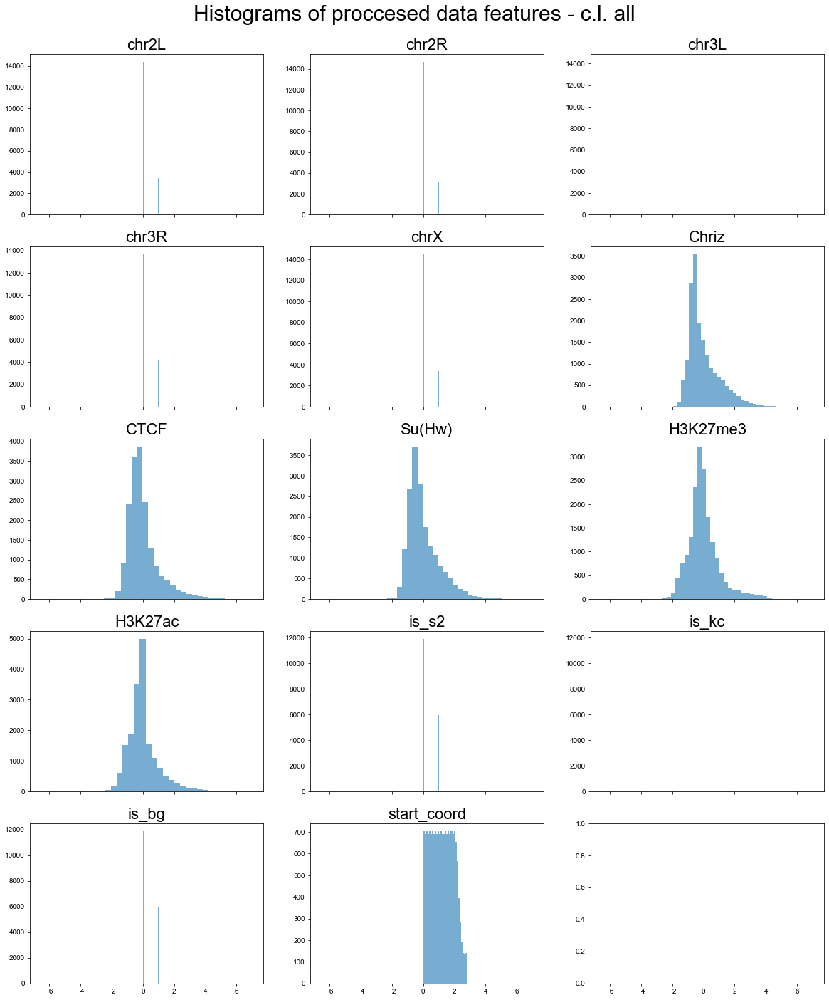

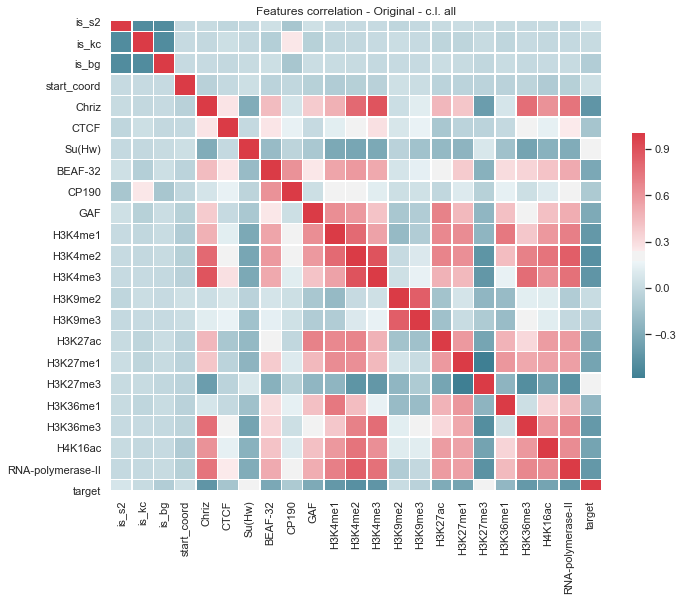

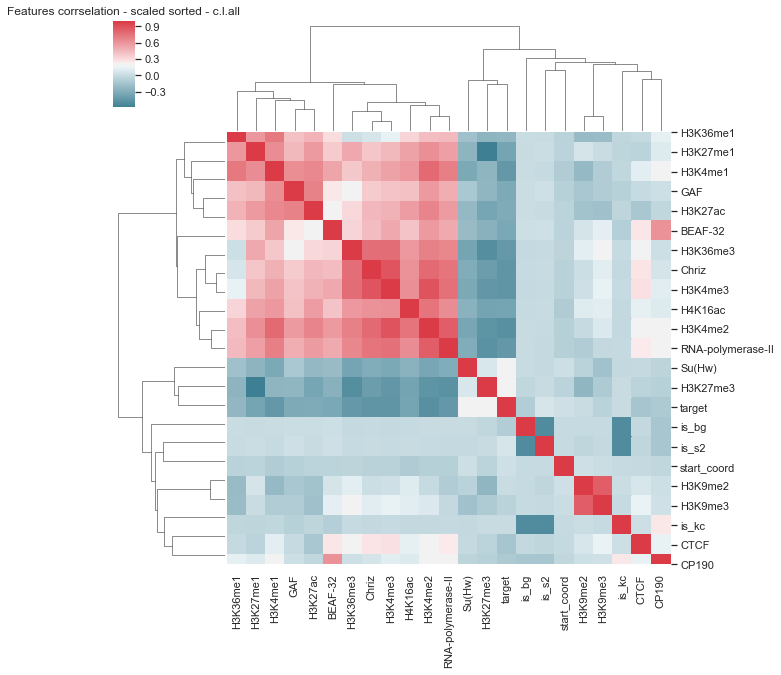

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


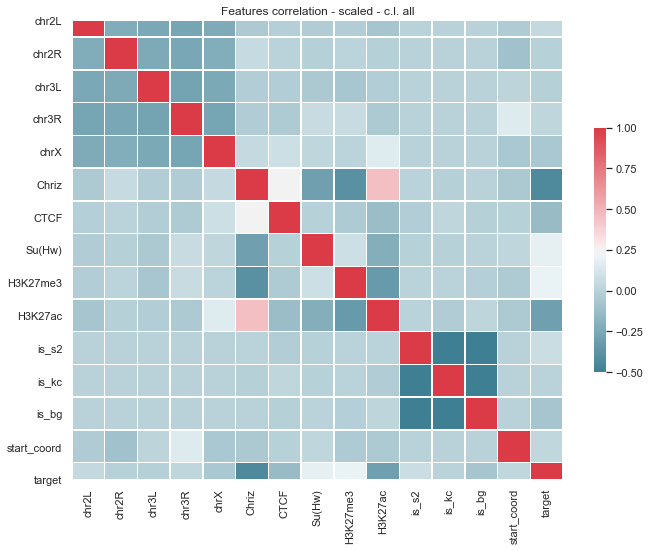

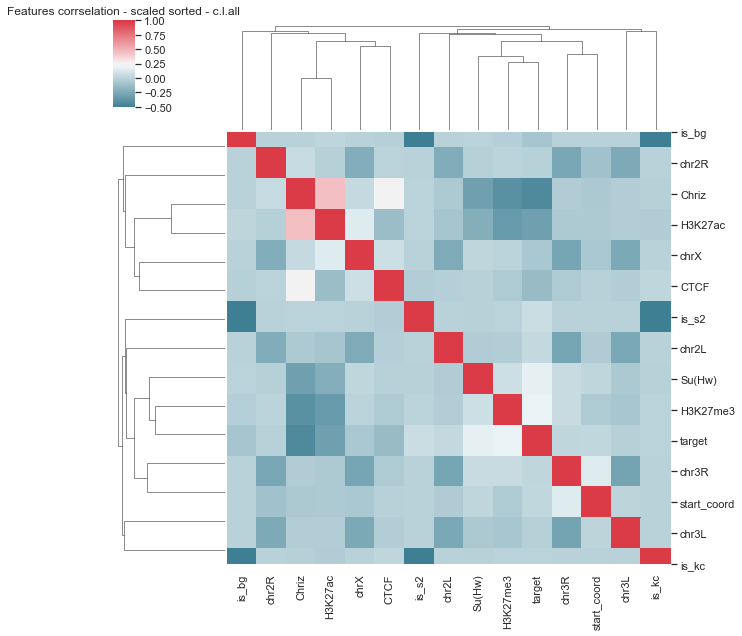

chr2L          0.039413
chr2R         -0.002480
chr3L         -0.008198
chr3R          0.028100
chrX          -0.059338
Chriz         -0.435195
CTCF          -0.134135
Su(Hw)         0.189629
H3K27me3       0.199935
H3K27ac       -0.299087
is_s2          0.068995
is_kc          0.006377
is_bg         -0.075372
start_coord    0.036987
target         1.000000
Name: target, dtype: float64 Index(['Chriz', 'H3K27ac', 'CTCF', 'is_bg', 'chrX', 'chr3L', 'chr2R', 'is_kc',
       'chr3R', 'start_coord', 'chr2L', 'is_s2', 'Su(Hw)', 'H3K27me3',
       'target'],
      dtype='object')
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 14) (3747, 6, 14) (12491,) (3747,)
x_val.shape = (1071, 6, 14)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 14)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 108.0793399810791


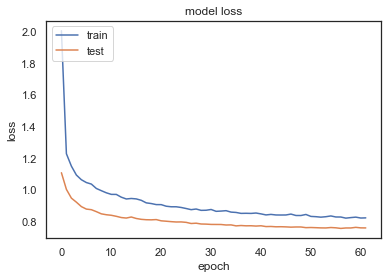

TEST WMSE =  0.818554694519941
x_val.shape = (1071, 6, 14)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 14)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 78.74691820144653


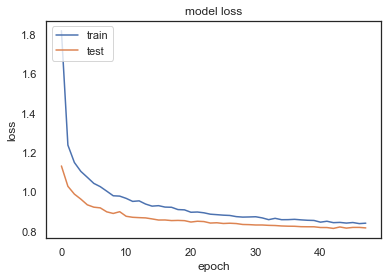

TEST WMSE =  0.78878250011361
x_val.shape = (1071, 6, 14)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 14)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 68.47267484664917


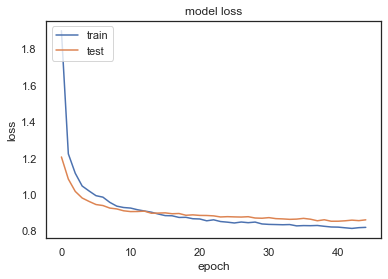

TEST WMSE =  0.831186865822944
x_val.shape = (1071, 6, 14)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 14)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 66.46078991889954


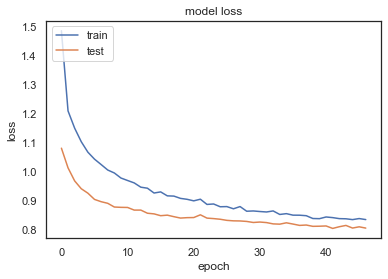

TEST WMSE =  0.7997940319963107
x_val.shape = (1071, 6, 14)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 14)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00071: early stopping
duration: 100.27814388275146


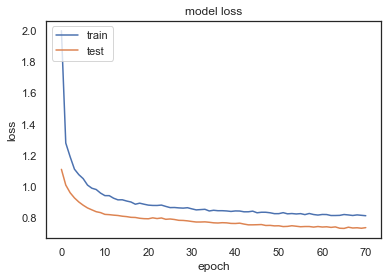

TEST WMSE =  0.8076944007048042
TEST MEAN WMSE =  0.8076944007048042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [16]:
data_csv = "_3cl_5_bioset_1_exps_13_05_20.csv"

num_experements = 1

cell_line = 'all' #   'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
         'is_s2', 'is_kc', 'is_bg', 
         'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 5
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_5f, eval_models_df_drop_10x_5f, eval_models_df_together_10x_5f, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = False, 
                                                       do_drop_1_feature_exps = False,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)


In [17]:
eval_models_df_together_10x_5f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,62.000000,0.818555,0.767100,0.757835,1.534037,60.0,108.079340,-1.0
1,0,6.0,6.0,48.000000,0.788783,0.789151,0.817429,1.513783,60.0,78.746918,-1.0
2,0,6.0,6.0,45.000000,0.831187,0.780256,0.861952,1.511121,60.0,68.472675,-1.0
3,0,6.0,6.0,47.000000,0.799794,0.777873,0.804090,1.554350,60.0,66.460790,-1.0
4,0,6.0,6.0,71.000000,0.807694,0.764483,0.738657,1.475389,60.0,100.278144,-1.0
5,mean,6.0,6.0,54.600000,0.809202,0.775773,0.795993,1.517736,60.0,84.407573,-1.0
6,std,0.0,0.0,10.624123,0.015601,0.008887,0.044362,0.028018,0.0,13.673474,0.0


data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'BEAF-32', 'CP190', 'GAF', 'H3K4me1',
       'H3K4me2', 'H3K4me3', 'H3K9me2', 'H3K9me3', 'H3K27ac', 'H3K27me1',
       'H3K27me3', 'H3K36me1', 'H3K36me3', 'H4K16ac', 'RNA-polymerase-II'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (17850, 27)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (17850, 6)
target.column = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF   

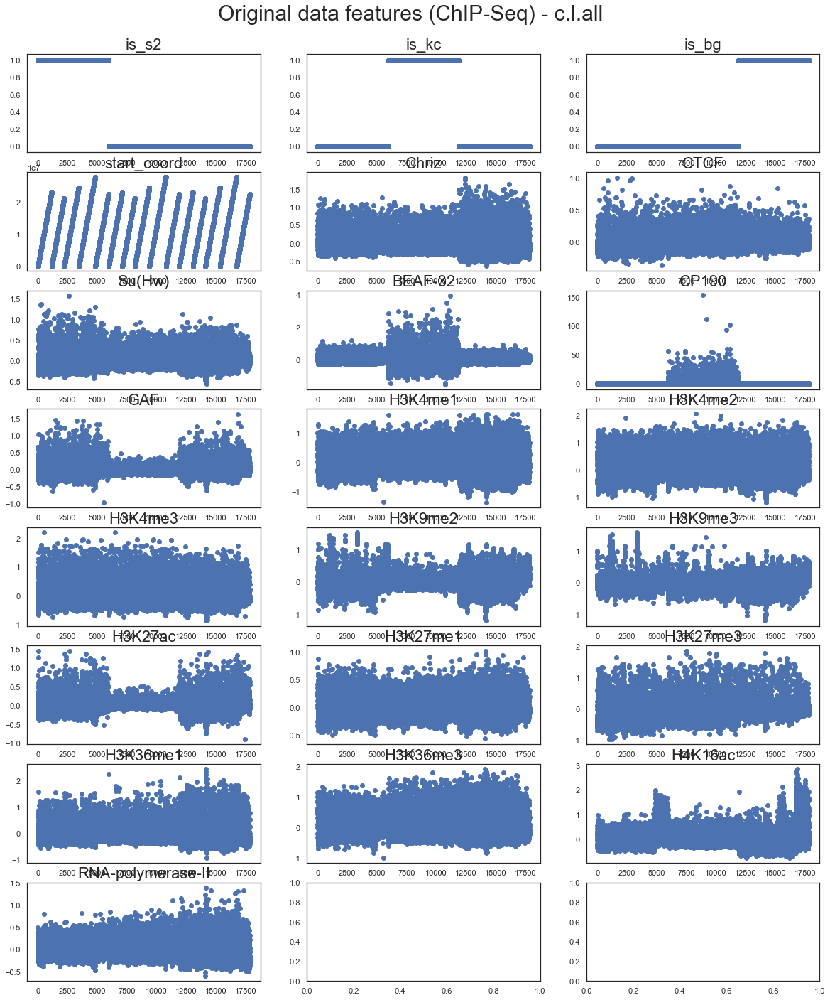

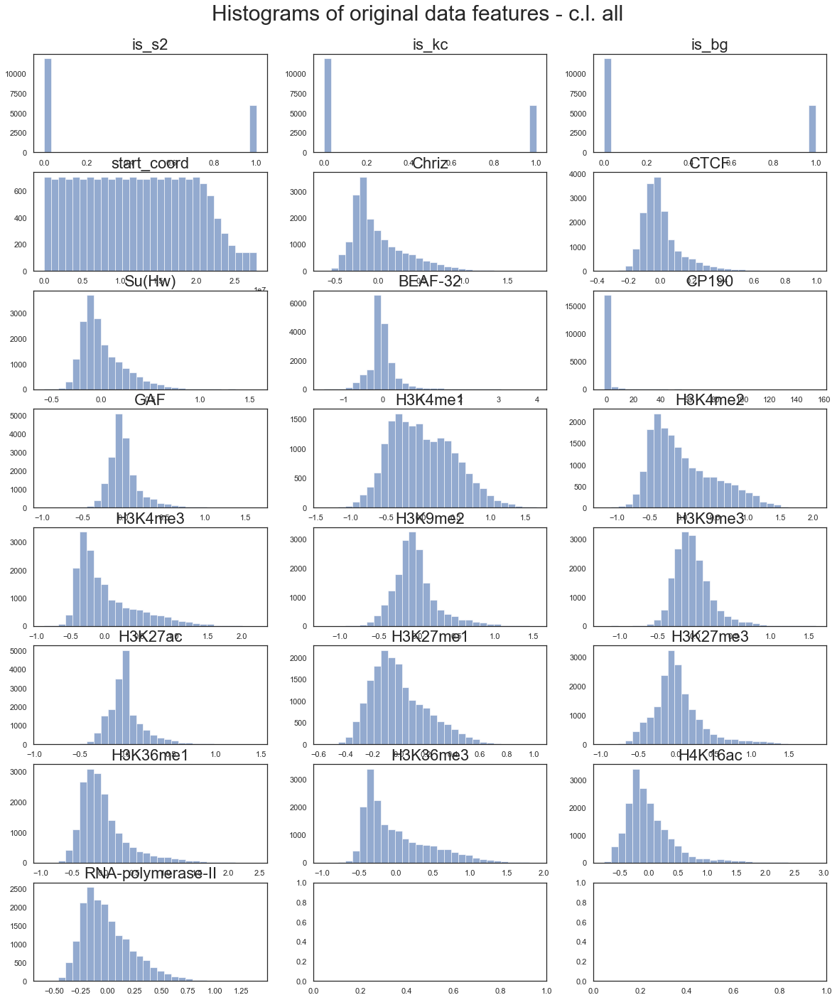

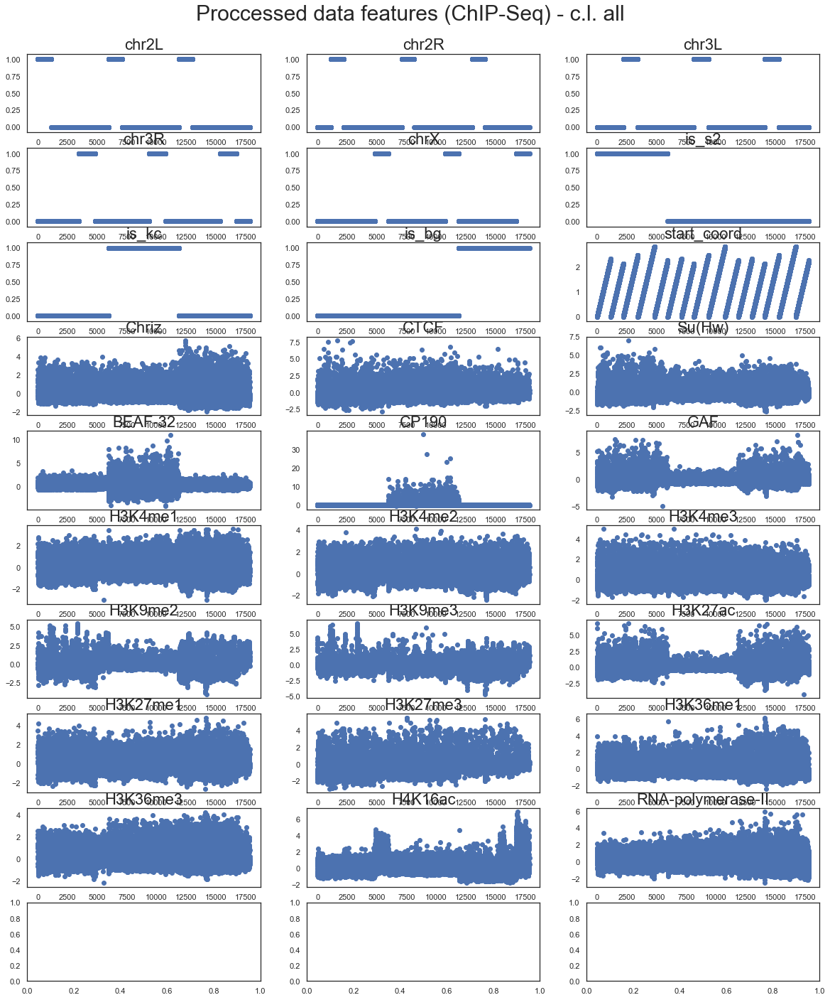

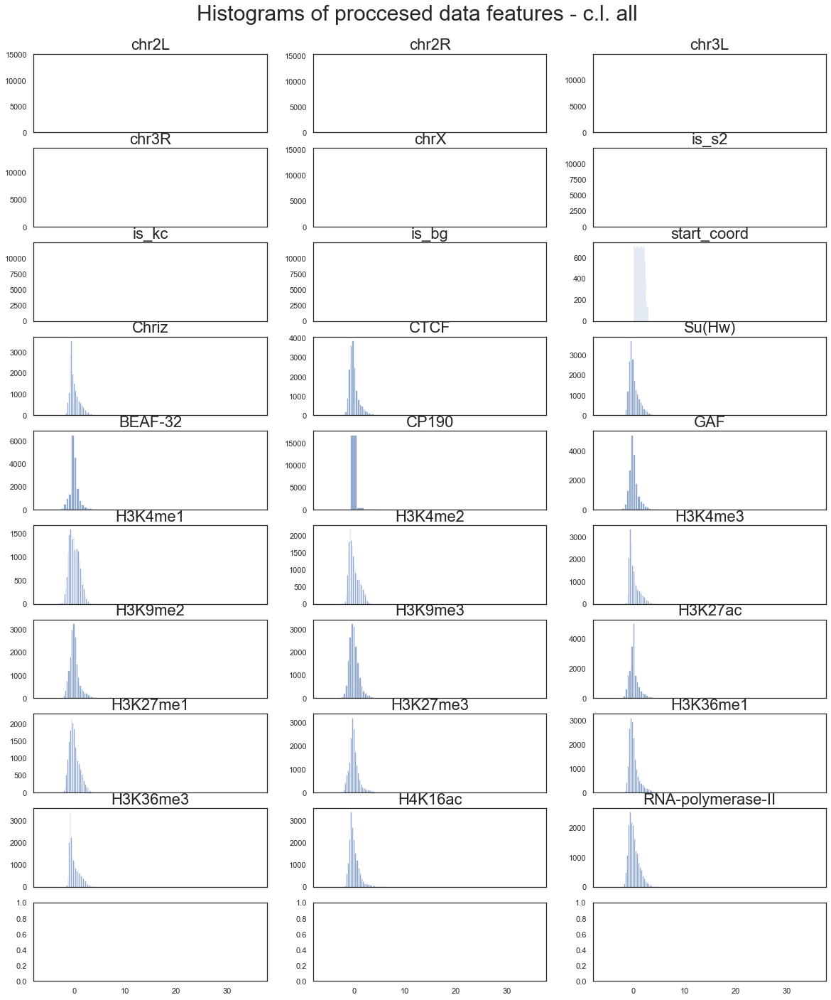

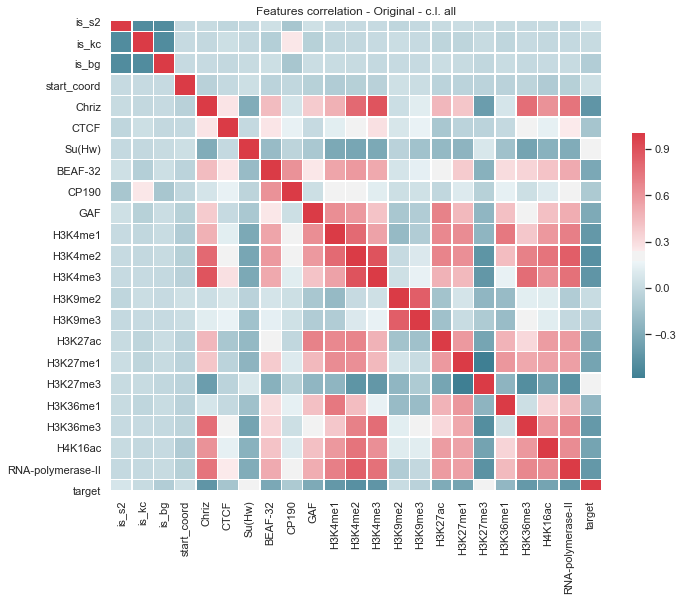

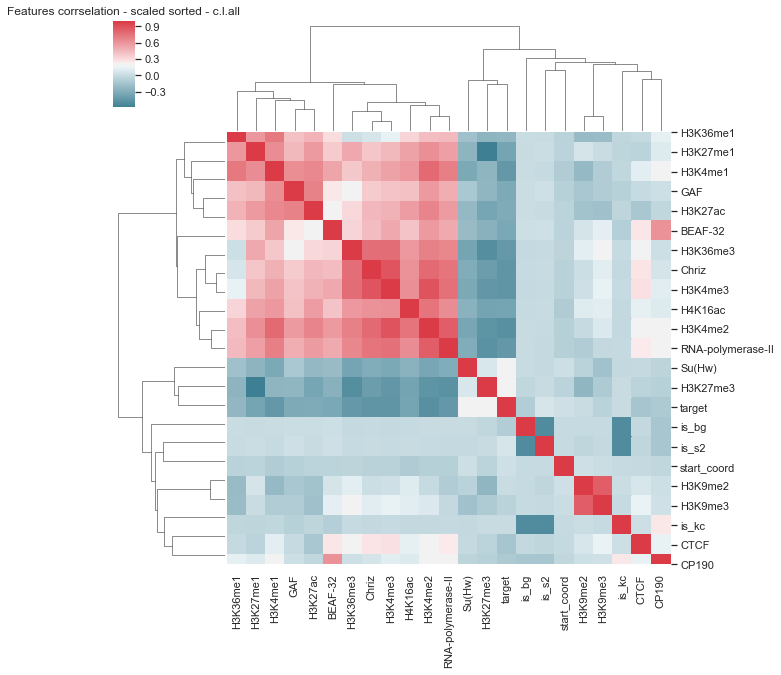

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


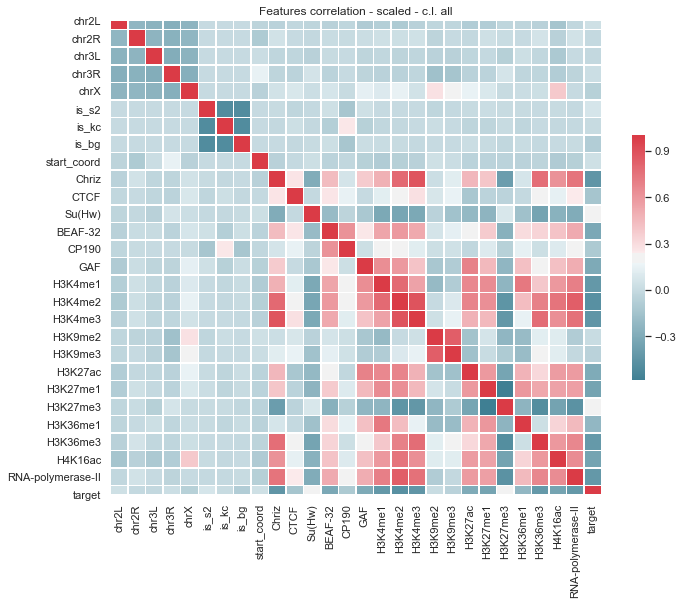

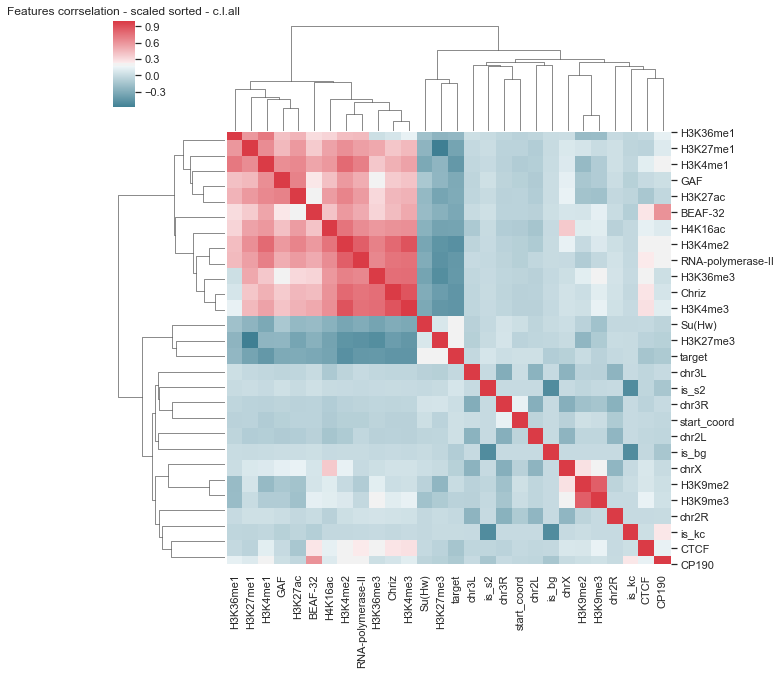

chr2L                0.039413
chr2R               -0.002480
chr3L               -0.008198
chr3R                0.028100
chrX                -0.059338
is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', '

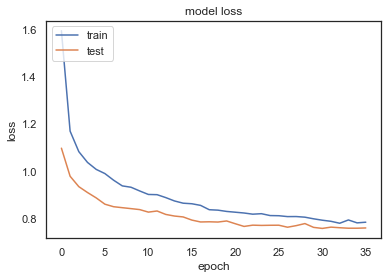

TEST WMSE =  0.7883045833513481
x_val.shape = (1071, 6, 27)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 27)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 50.35358428955078


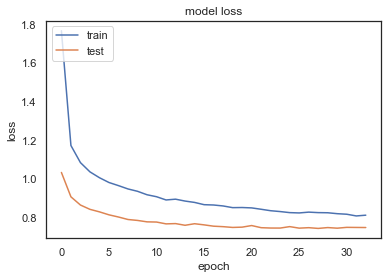

TEST WMSE =  0.7772468987911825
x_val.shape = (1071, 6, 27)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 27)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 76.01013970375061


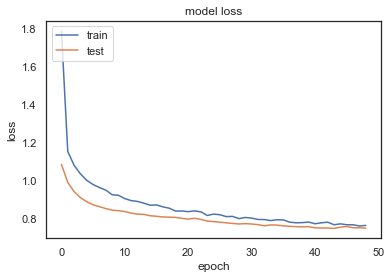

TEST WMSE =  0.7947878826142712
x_val.shape = (1071, 6, 27)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 27)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 72.82276797294617


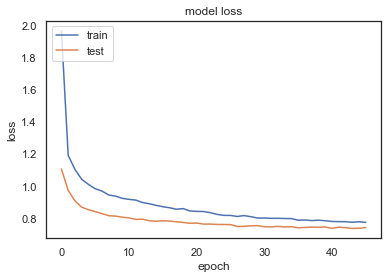

TEST WMSE =  0.7926419133203703
x_val.shape = (1071, 6, 27)
y_val.shape = (1071,)
x_train.shape = (14276, 6, 27)
y_train.shape = (14276,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 94.17907977104187


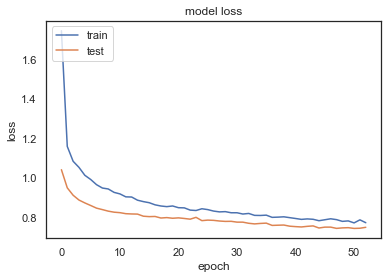

TEST WMSE =  0.7634191636103165
TEST MEAN WMSE =  0.7634191636103165


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [18]:
data_csv = "_3cl_18_bioset_1_exps_13_05_20.csv"

num_experements = 1

cell_line = 'all' #   'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
# bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
#          'is_s2', 'is_kc', 'is_bg', 
#          'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
# data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 5
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_18f, eval_models_df_drop_10x_18f, eval_models_df_together_10x_18f, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = False, 
                                                       do_drop_1_feature_exps = False,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)


In [19]:
eval_models_df_together_10x_18f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,36.000000,0.788305,0.723147,0.762758,1.515179,60.0,51.802030,-1.0
1,0,6.0,6.0,33.000000,0.777247,0.739425,0.747955,1.488849,60.0,50.353584,-1.0
2,0,6.0,6.0,49.000000,0.794788,0.709919,0.752061,1.535912,60.0,76.010140,-1.0
3,0,6.0,6.0,46.000000,0.792642,0.710644,0.742359,1.538749,60.0,72.822768,-1.0
4,0,6.0,6.0,53.000000,0.763419,0.716522,0.750790,1.461085,60.0,94.179080,-1.0
5,mean,6.0,6.0,43.400000,0.783280,0.719931,0.751184,1.507955,60.0,69.033520,-1.0
6,std,0.0,0.0,7.541353,0.012707,0.012001,0.003951,0.032716,0.0,15.691446,0.0


data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'BEAF-32', 'CP190', 'GAF', 'H3K4me1',
       'H3K4me2', 'H3K4me3', 'H3K9me2', 'H3K9me3', 'H3K27ac', 'H3K27me1',
       'H3K27me3', 'H3K36me1', 'H3K36me3', 'H4K16ac', 'RNA-polymerase-II'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (17850, 27)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (17850, 6)
target.column = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF   

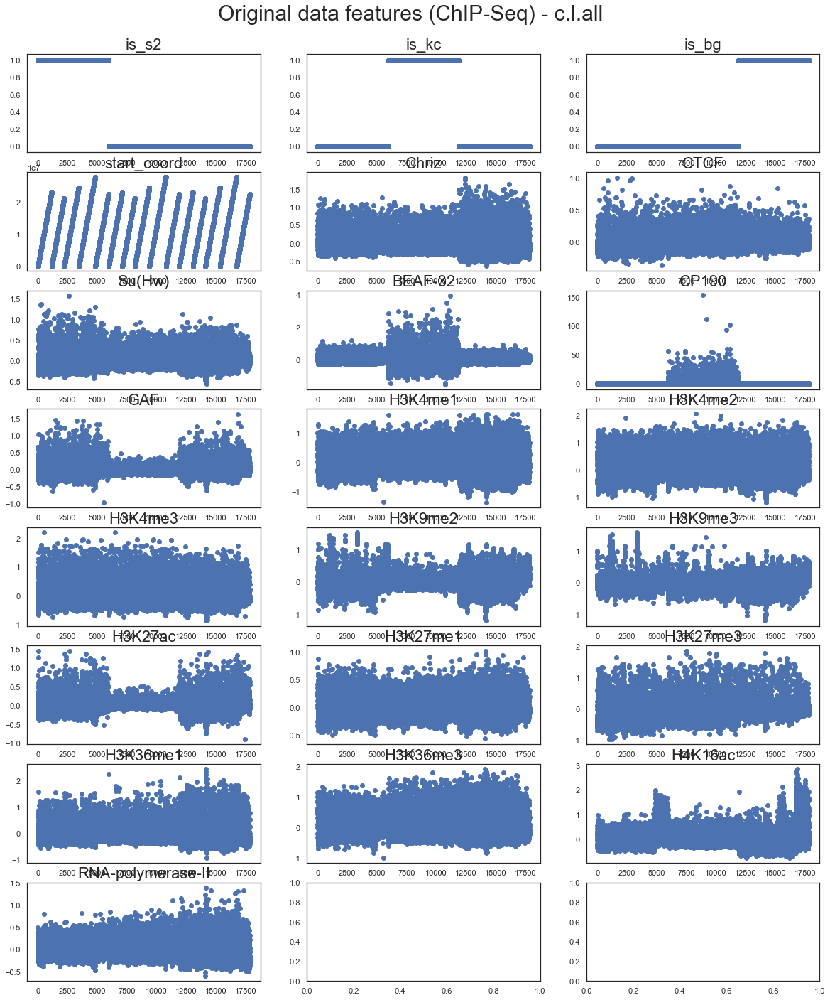

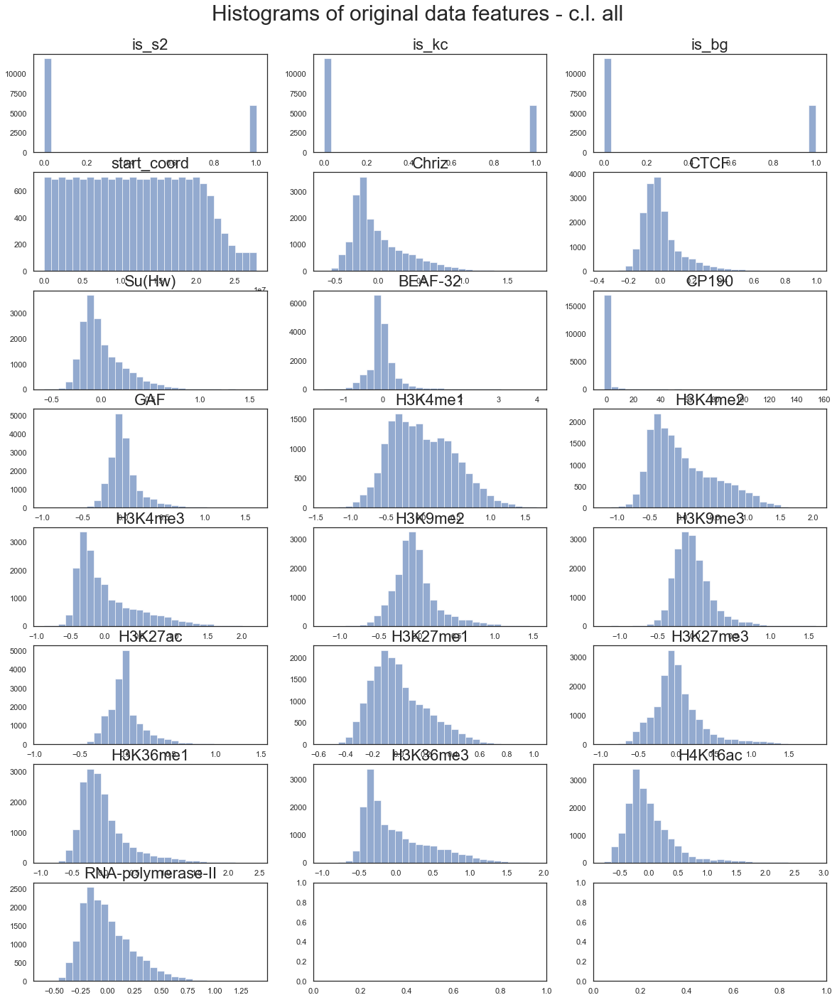

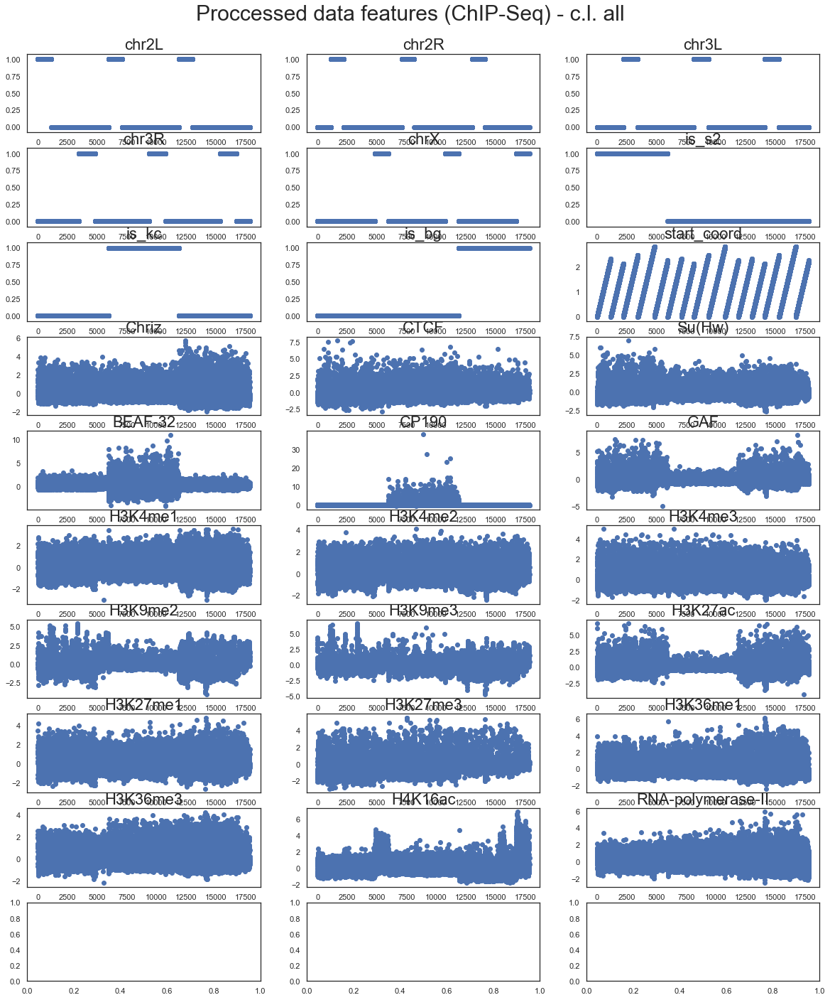

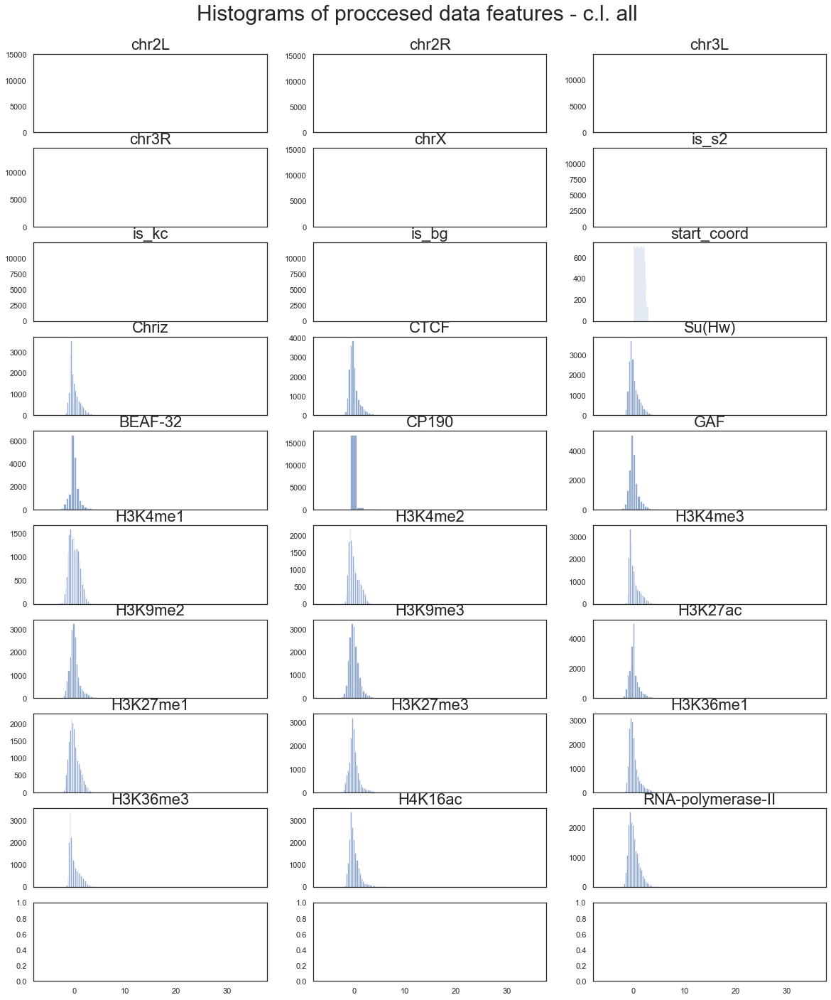

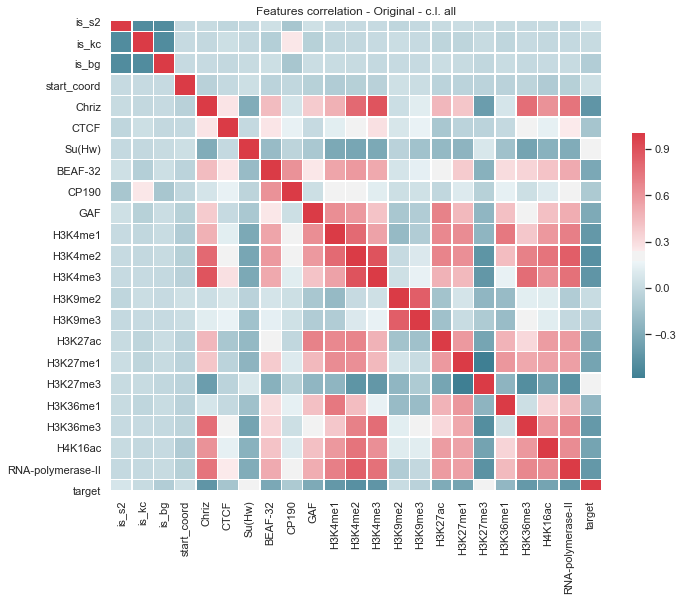

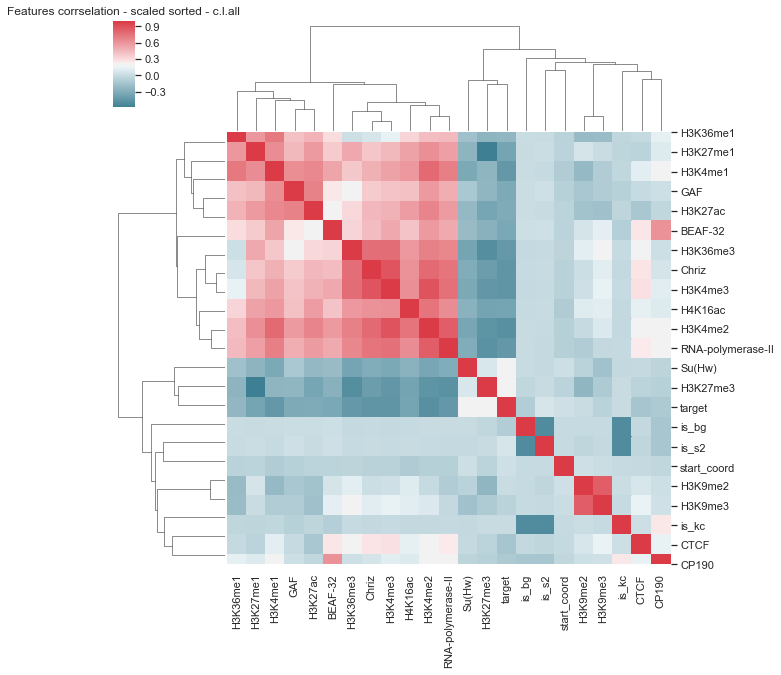

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


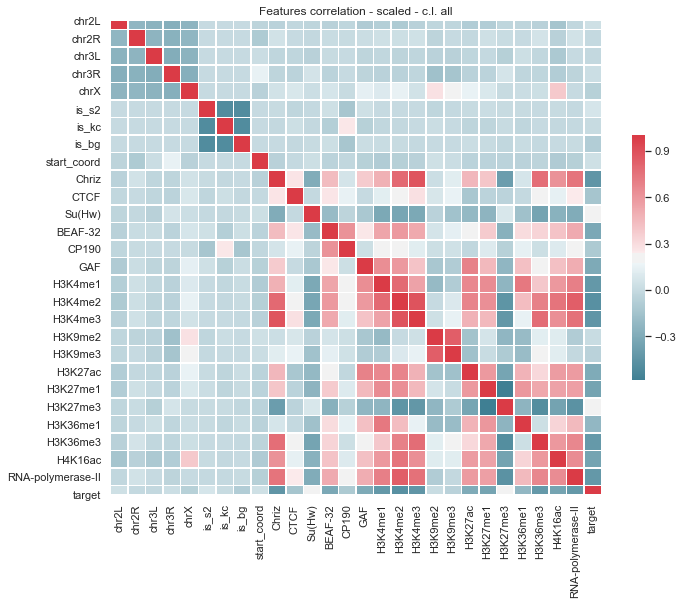

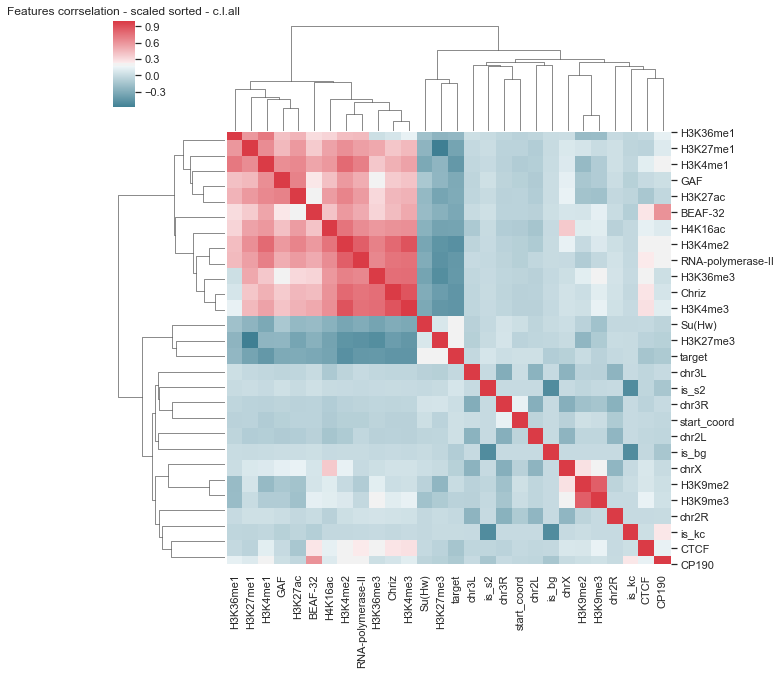

chr2L                0.039413
chr2R               -0.002480
chr3L               -0.008198
chr3R                0.028100
chrX                -0.059338
is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', '

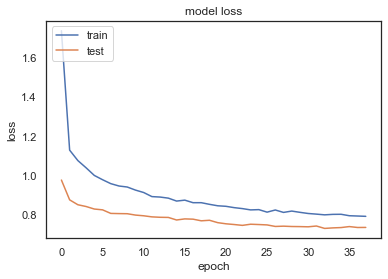

TEST WMSE =  0.7321691753627205
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 65.9104392528534


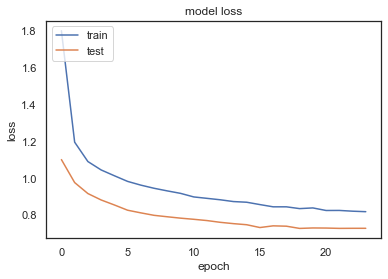

TEST WMSE =  0.8525274656590652
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 140.10437107086182


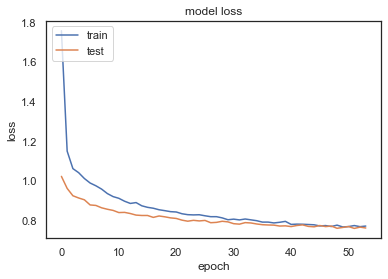

TEST WMSE =  0.740821069549504
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 80.32608389854431


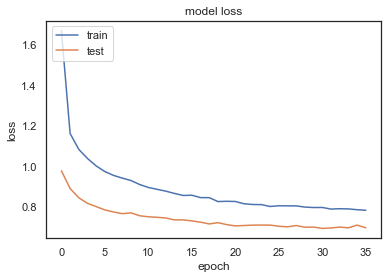

TEST WMSE =  0.7859823128404702
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 97.49680471420288


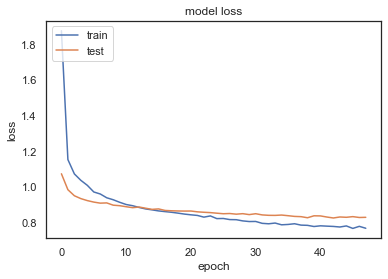

TEST WMSE =  0.7930436743894327
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 113.72033905982971


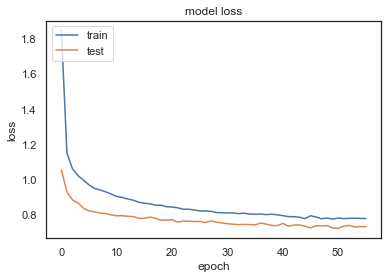

TEST WMSE =  0.7723656706869341
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 61.40881681442261


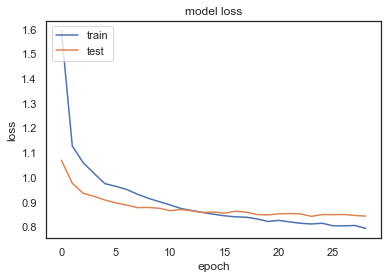

TEST WMSE =  0.770620714434452
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 82.90504503250122


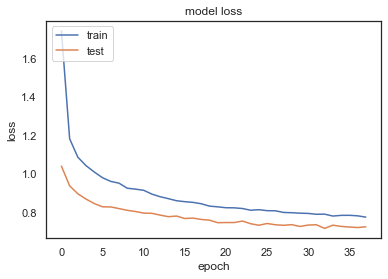

TEST WMSE =  0.7911728721177785
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 99.78847694396973


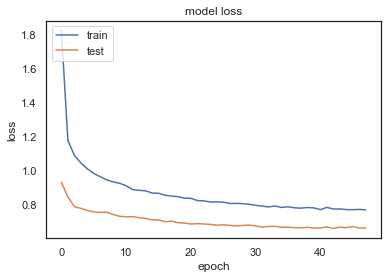

TEST WMSE =  0.7484453620853517
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 75.11222124099731


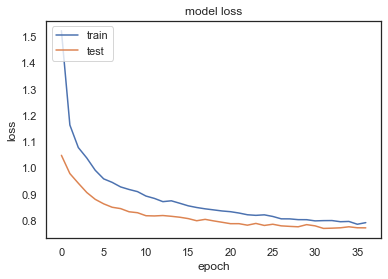

TEST WMSE =  0.801910827247278
TEST MEAN WMSE =  0.801910827247278
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 27) (3747, 6, 27) (12491,) (3747,)
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 80.59609484672546


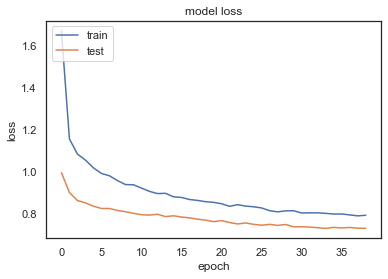

TEST WMSE =  0.7370347034058269
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 57.10508394241333


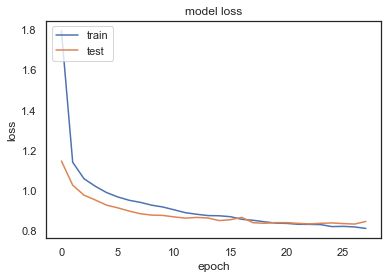

TEST WMSE =  0.8310784622386943
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 72.07689332962036


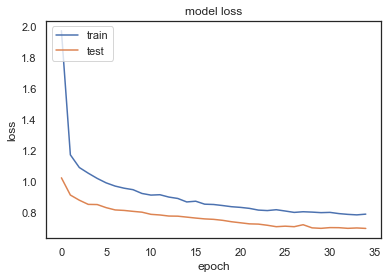

TEST WMSE =  0.7621892715212681
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 49.47242188453674


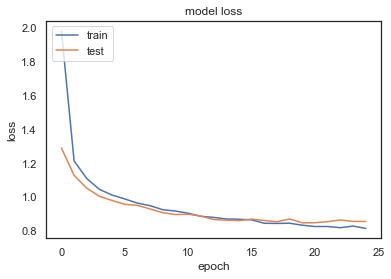

TEST WMSE =  0.7319140062576482
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 105.29173517227173


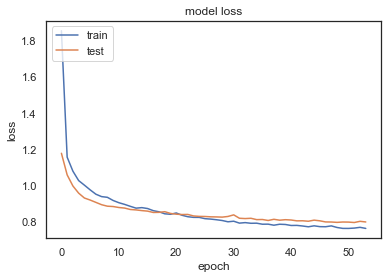

TEST WMSE =  0.7862863219520839
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 109.13249182701111


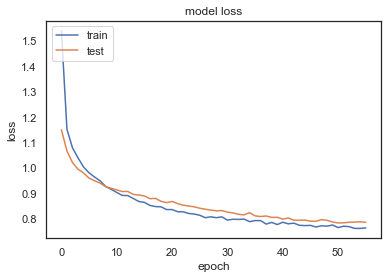

TEST WMSE =  0.7503357247588732
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 65.25193285942078


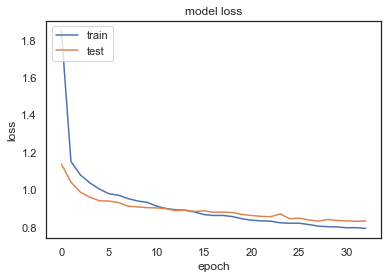

TEST WMSE =  0.7788216052845803
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 53.10971784591675


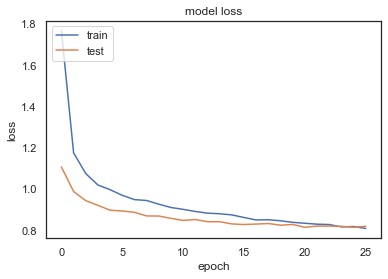

TEST WMSE =  0.7747052470388744
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 79.9426760673523


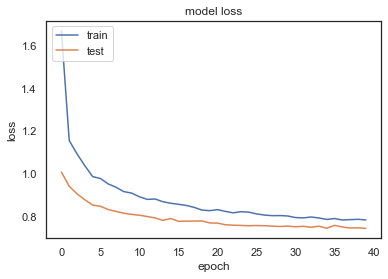

TEST WMSE =  0.7354752709756499
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 97.14601111412048


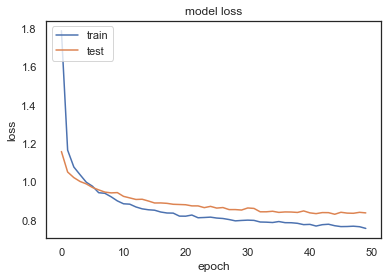

TEST WMSE =  0.7398280752053922
TEST MEAN WMSE =  0.7398280752053922
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 27) (3747, 6, 27) (12491,) (3747,)
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 77.64717411994934


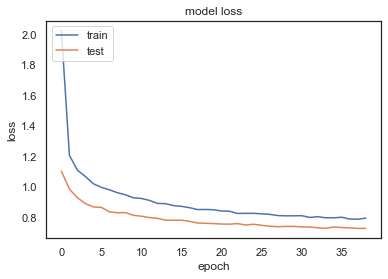

TEST WMSE =  0.7292371736463508
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 57.694204807281494


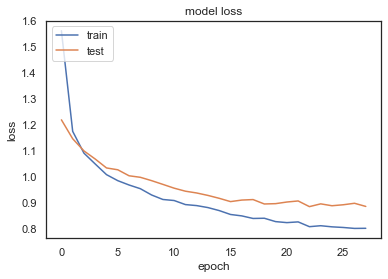

TEST WMSE =  0.7992556145443784
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 60.84227132797241


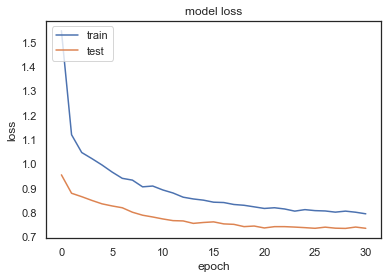

TEST WMSE =  0.7721854835670995
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 59.045994997024536


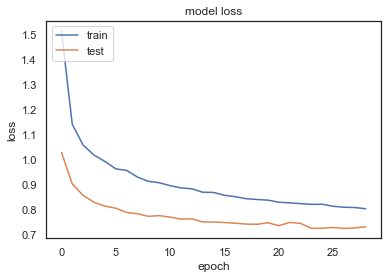

TEST WMSE =  0.790407691429767
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16060, 6, 27)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 76.58946084976196


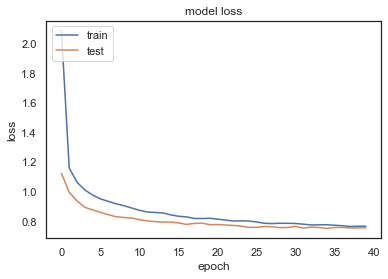

TEST WMSE =  0.8261066569553027
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 102.19005799293518


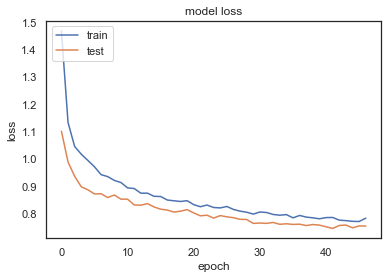

TEST WMSE =  0.7723507907932177
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 121.22382426261902


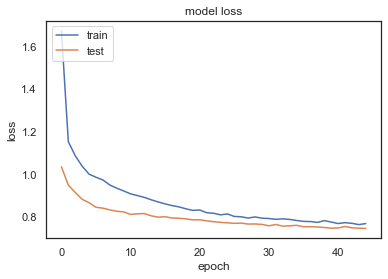

TEST WMSE =  0.7781896446618126
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 124.31866788864136


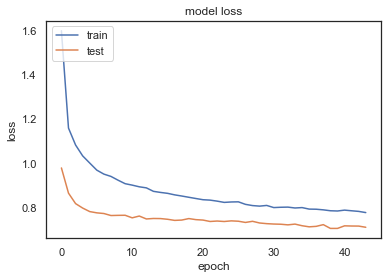

TEST WMSE =  0.7937890178802907
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 69.5590169429779


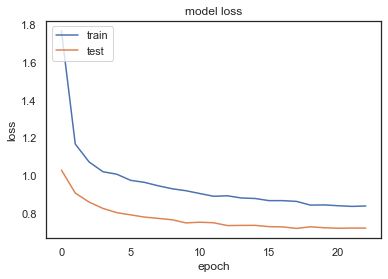

TEST WMSE =  0.763580402497233
x_val.shape = (536, 6, 27)
y_val.shape = (536,)
x_train.shape = (16061, 6, 27)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 148.77480792999268


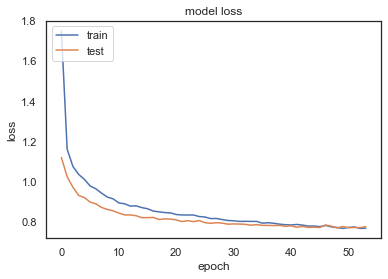

TEST WMSE =  0.7696433958566665
TEST MEAN WMSE =  0.7696433958566665


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,38.000000,0.732169,0.723828,0.736126,1.472840,60.0,86.970359,-1.0
1,0,6.0,6.0,24.000000,0.852527,0.747871,0.727952,1.576495,60.0,65.910439,-1.0
2,0,6.0,6.0,54.000000,0.740821,0.708141,0.761814,1.470222,60.0,140.104371,-1.0
3,0,6.0,6.0,36.000000,0.785982,0.724848,0.697540,1.544394,60.0,80.326084,-1.0
4,0,6.0,6.0,48.000000,0.793044,0.705468,0.828648,1.554486,60.0,97.496805,-1.0
5,0,6.0,6.0,56.000000,0.772366,0.711560,0.732168,1.526080,60.0,113.720339,-1.0
6,0,6.0,6.0,29.000000,0.770621,0.733286,0.843561,1.511541,60.0,61.408817,-1.0
7,0,6.0,6.0,38.000000,0.791173,0.719217,0.726688,1.535090,60.0,82.905045,-1.0
8,0,6.0,6.0,48.000000,0.748445,0.708165,0.661200,1.456435,60.0,99.788477,-1.0
9,0,6.0,6.0,37.000000,0.801911,0.723962,0.772105,1.553687,60.0,75.112221,-1.0


In [20]:
data_csv = "_3cl_18_bioset_3_exps_10cv_13_05_20.csv"

num_experements = 3

cell_line =  'all' #  'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
# bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
#          'is_s2', 'is_kc', 'is_bg', 
#          'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 10
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_18f, eval_models_df_drop_10x_18f, eval_models_df_together_10cv_18f, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = False, 
                                                       do_drop_1_feature_exps = False,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)

eval_models_df_together_10cv_18f

In [21]:
eval_models_df_together_10cv_18f

,exper_num,sequenc_len,num_lstm_units,n_epochs,weighted_mse_test,weighted_mse_train,weighted_mse_val,weighted_mse_test_const,batch_size,duration,missing_feature
0,0,6.0,6.0,38.000000,0.732169,0.723828,0.736126,1.472840,60.0,86.970359,-1.0
1,0,6.0,6.0,24.000000,0.852527,0.747871,0.727952,1.576495,60.0,65.910439,-1.0
2,0,6.0,6.0,54.000000,0.740821,0.708141,0.761814,1.470222,60.0,140.104371,-1.0
3,0,6.0,6.0,36.000000,0.785982,0.724848,0.697540,1.544394,60.0,80.326084,-1.0
4,0,6.0,6.0,48.000000,0.793044,0.705468,0.828648,1.554486,60.0,97.496805,-1.0
5,0,6.0,6.0,56.000000,0.772366,0.711560,0.732168,1.526080,60.0,113.720339,-1.0
6,0,6.0,6.0,29.000000,0.770621,0.733286,0.843561,1.511541,60.0,61.408817,-1.0
7,0,6.0,6.0,38.000000,0.791173,0.719217,0.726688,1.535090,60.0,82.905045,-1.0
8,0,6.0,6.0,48.000000,0.748445,0.708165,0.661200,1.456435,60.0,99.788477,-1.0
9,0,6.0,6.0,37.000000,0.801911,0.723962,0.772105,1.553687,60.0,75.112221,-1.0


data.shape =  (17850, 23)
column names = ['is_s2' 'is_kc' 'is_bg' 'chrN' 'start_coord' 'Chriz' 'CTCF' 'Su(Hw)'
 'BEAF-32' 'CP190' 'GAF' 'H3K4me1' 'H3K4me2' 'H3K4me3' 'H3K9me2' 'H3K9me3'
 'H3K27ac' 'H3K27me1' 'H3K27me3' 'H3K36me1' 'H3K36me3' 'H4K16ac'
 'RNA-polymerase-II']
Scaling of the features: Index(['Chriz', 'CTCF', 'Su(Hw)', 'BEAF-32', 'CP190', 'GAF', 'H3K4me1',
       'H3K4me2', 'H3K4me3', 'H3K9me2', 'H3K9me3', 'H3K27ac', 'H3K27me1',
       'H3K27me3', 'H3K36me1', 'H3K36me3', 'H4K16ac', 'RNA-polymerase-II'],
      dtype='object')
Using chromosome One Hot Encoding: ['chr2L' 'chr2R' 'chr3L' 'chr3R' 'chrX']
proccessed data.shape = (17850, 27)
original target.shape = (17850, 6)
target.columns = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
target.shape = (17850, 6)
target.column = Index(['is_s2', 'is_kc', 'is_bg', 'chrN', 'start_coord', 'gamma'], dtype='object')
data_original.head =    is_s2  is_kc  is_bg   chrN  start_coord     Chriz      CTCF   

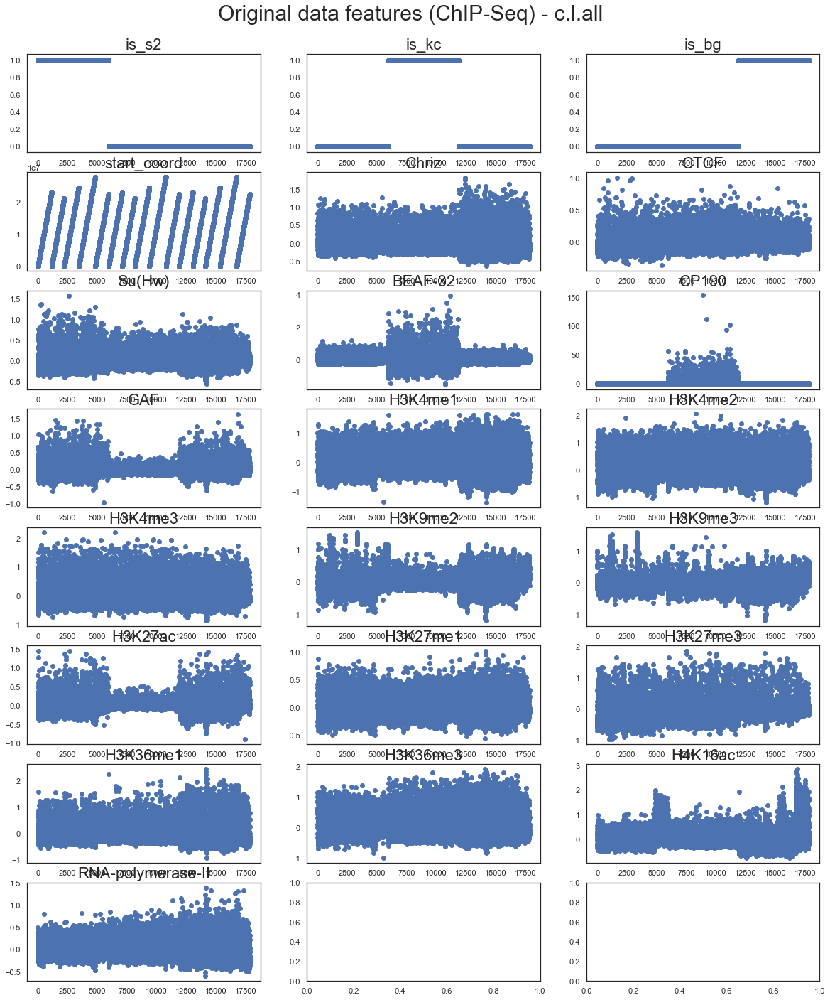

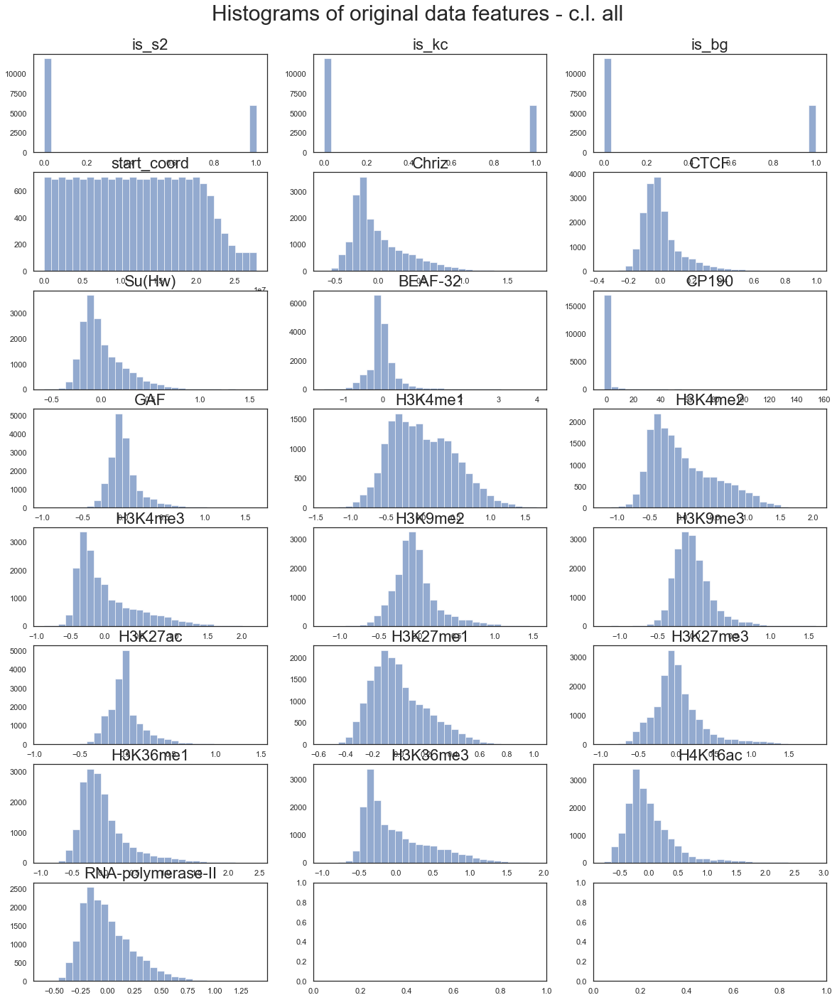

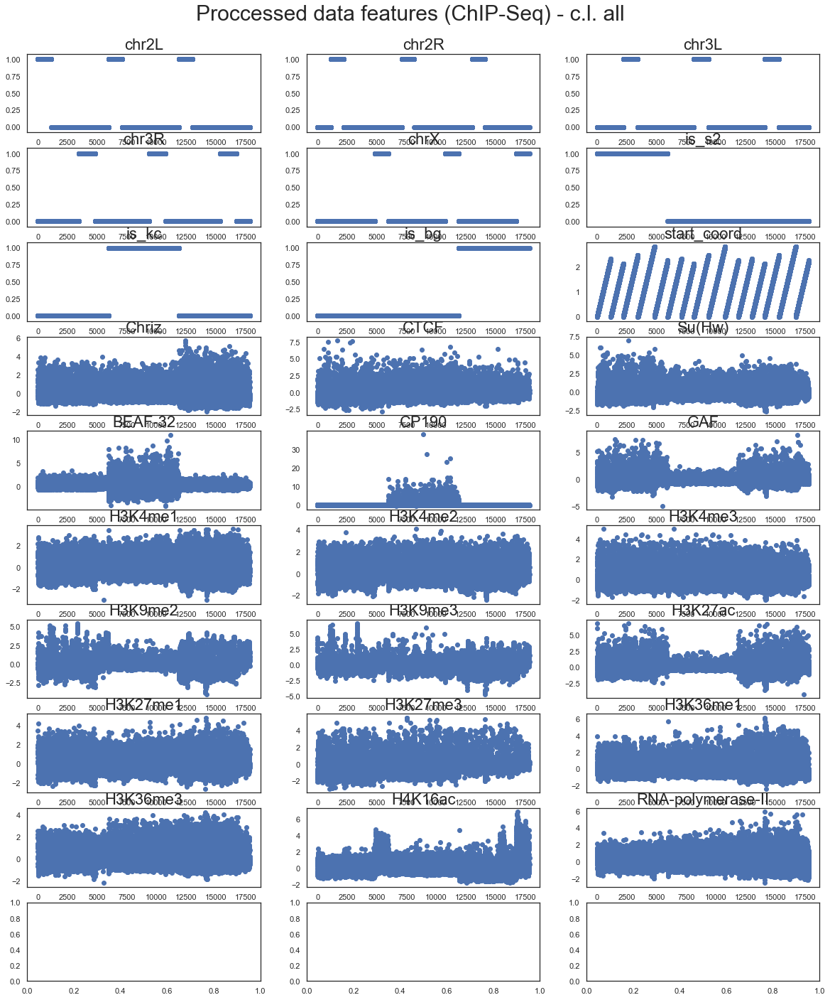

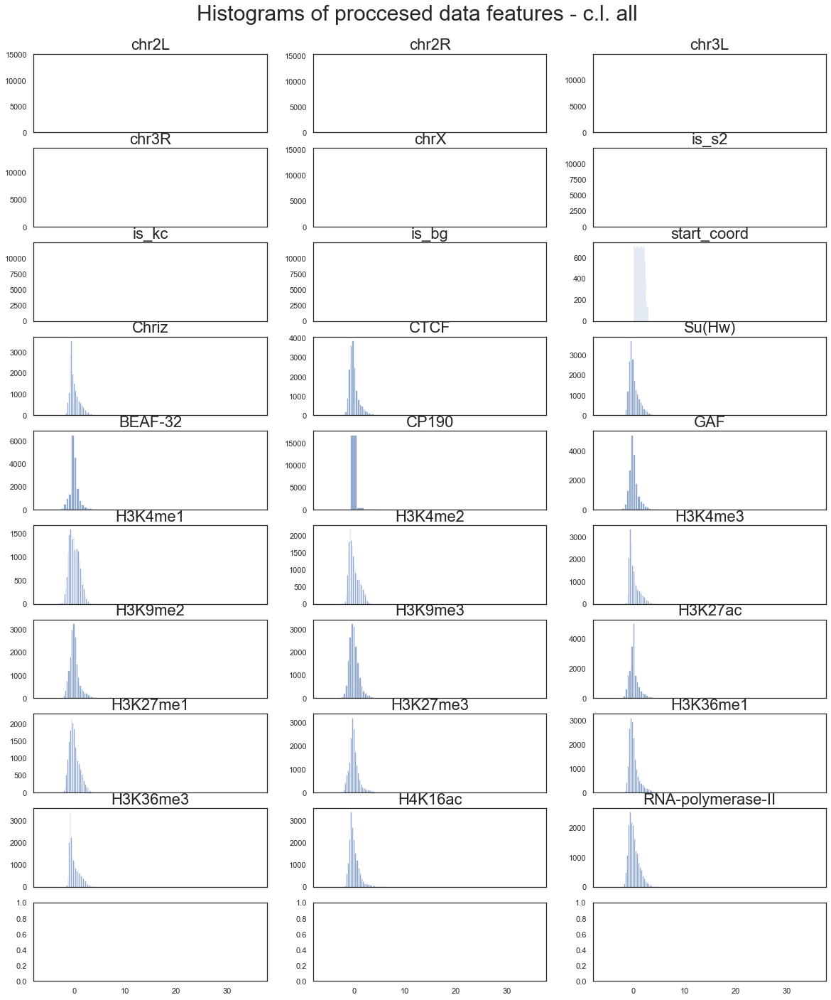

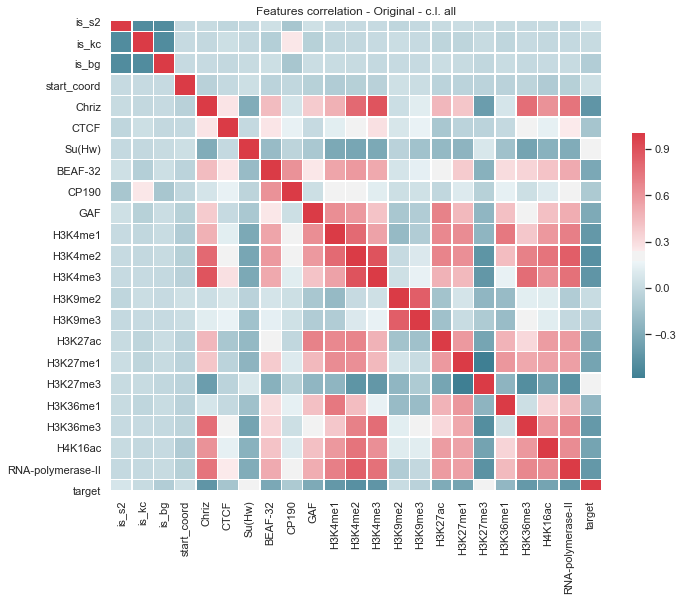

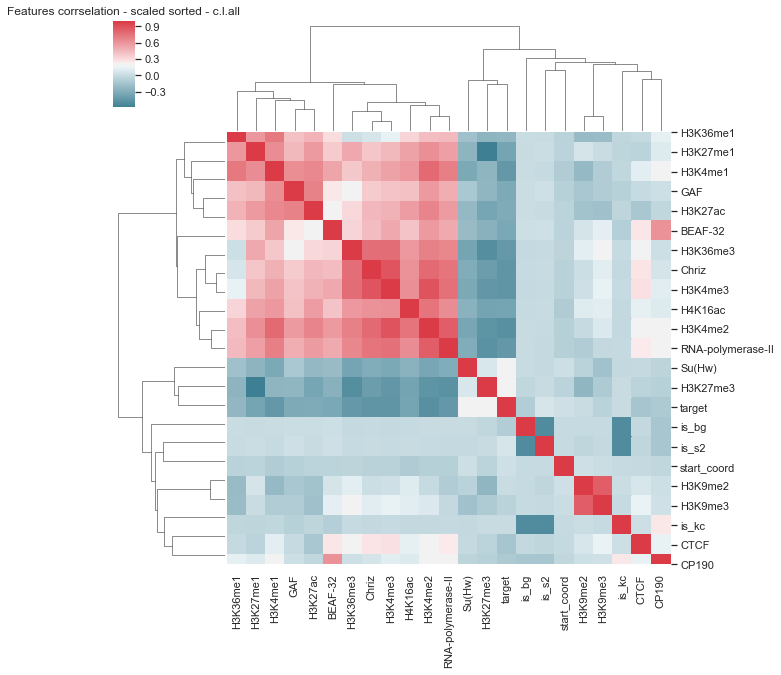

is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', 'H3K27ac',
       'H3K36me1', 'CTCF', 'CP190', 'is_bg', 'H3K9me3', 'is_kc', 'H3K9me2',
       'start_coord', 'is_s2', 'Su(Hw)', 'H3K27me3', 'target'],


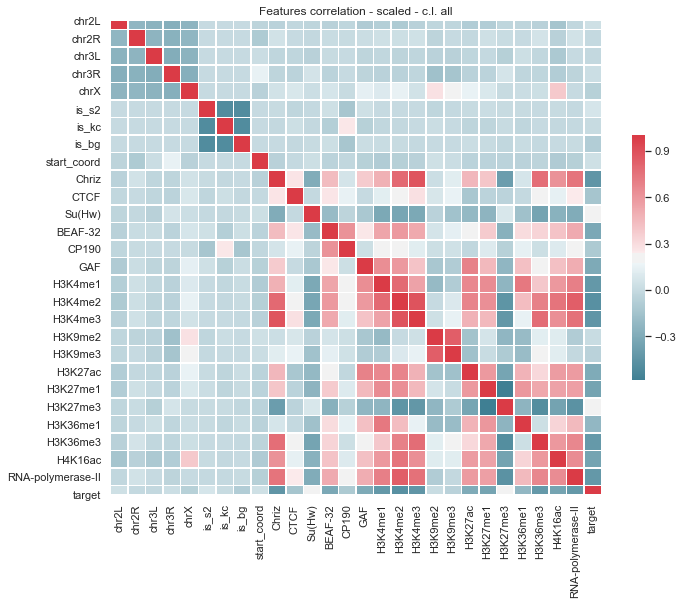

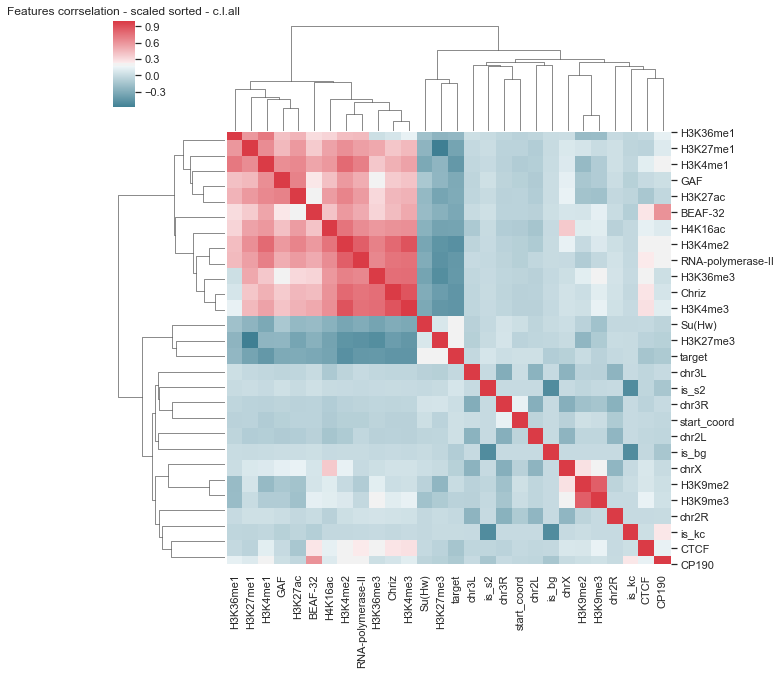

chr2L                0.039413
chr2R               -0.002480
chr3L               -0.008198
chr3R                0.028100
chrX                -0.059338
is_s2                0.068995
is_kc                0.006377
is_bg               -0.075372
start_coord          0.036987
Chriz               -0.435195
CTCF                -0.134135
Su(Hw)               0.189629
BEAF-32             -0.318613
CP190               -0.105750
GAF                 -0.306469
H3K4me1             -0.417050
H3K4me2             -0.468518
H3K4me3             -0.438623
H3K9me2              0.017396
H3K9me3             -0.045845
H3K27ac             -0.299087
H3K27me1            -0.342611
H3K27me3             0.199935
H3K36me1            -0.220909
H3K36me3            -0.410151
H4K16ac             -0.345961
RNA-polymerase-II   -0.415684
target               1.000000
Name: target, dtype: float64 Index(['H3K4me2', 'H3K4me3', 'Chriz', 'H3K4me1', 'RNA-polymerase-II',
       'H3K36me3', 'H4K16ac', 'H3K27me1', 'BEAF-32', 'GAF', '

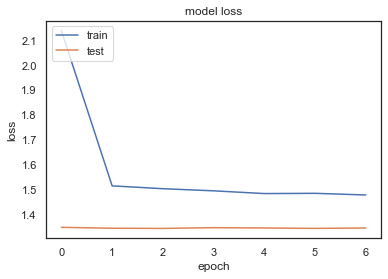

TEST WMSE =  1.400013021720371
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 27.506791830062866


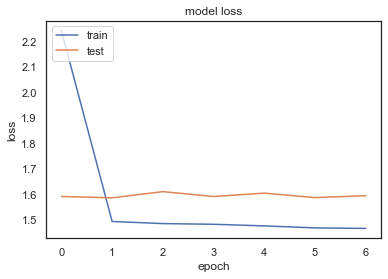

TEST WMSE =  1.4379405074508609
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 23.952760934829712


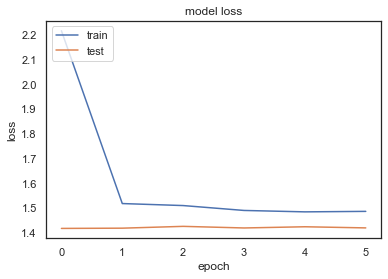

TEST WMSE =  1.3533730179036945
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 26.60825514793396


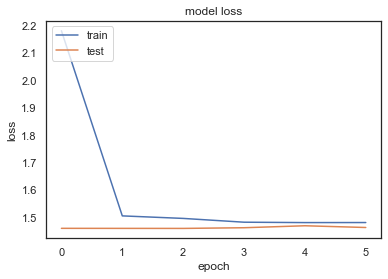

TEST WMSE =  1.4422121073919774
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 28.441107988357544


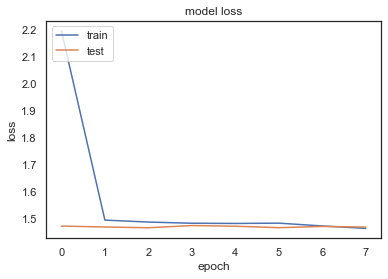

TEST WMSE =  1.44010278683889
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 35.31064987182617


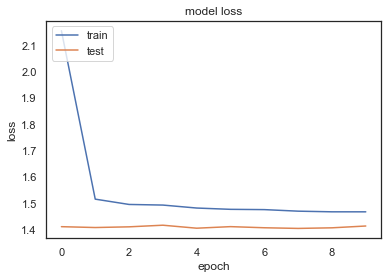

TEST WMSE =  1.396849794023215
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 37.07925200462341


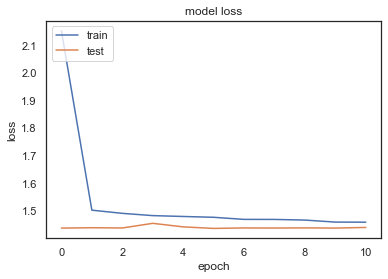

TEST WMSE =  1.4272563669844218
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 30.900536060333252


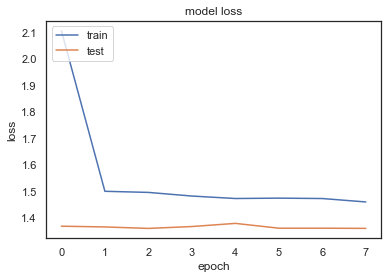

TEST WMSE =  1.4741048408329958
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 25.98387885093689


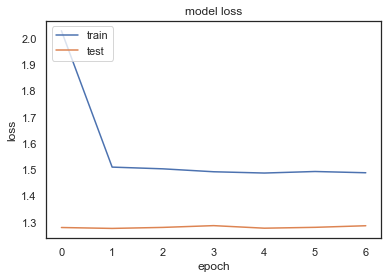

TEST WMSE =  1.360787252033761
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 32.78871488571167


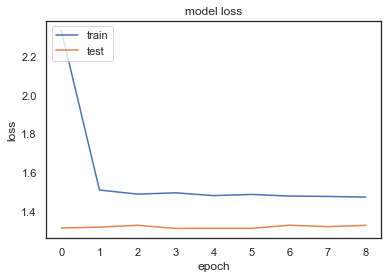

TEST WMSE =  1.4254203087297501
TEST MEAN WMSE =  1.4254203087297501
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 25.697066068649292


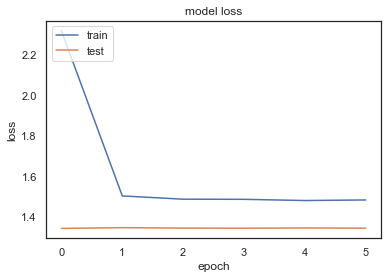

TEST WMSE =  1.3944115727391555
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 25.647235870361328


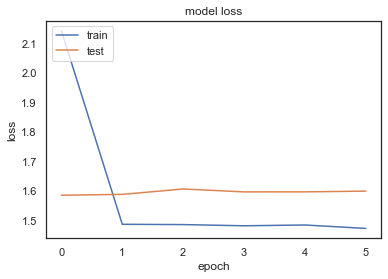

TEST WMSE =  1.4400299636843503
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.14503288269043


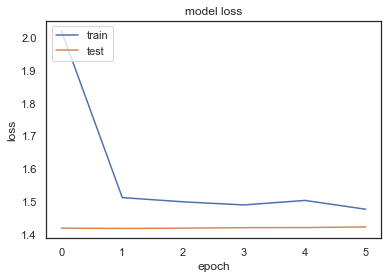

TEST WMSE =  1.355536147925176
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 32.448978900909424


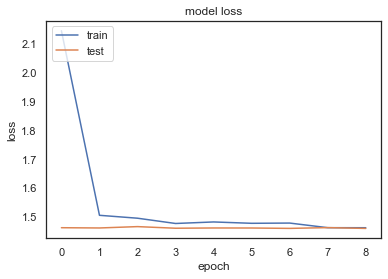

TEST WMSE =  1.4327989350957329
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 37.356067180633545


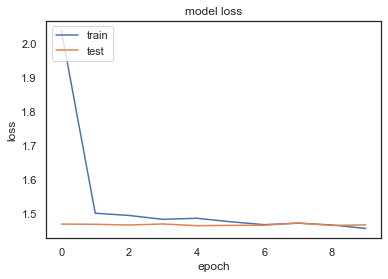

TEST WMSE =  1.439345708717089
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 46.59968686103821


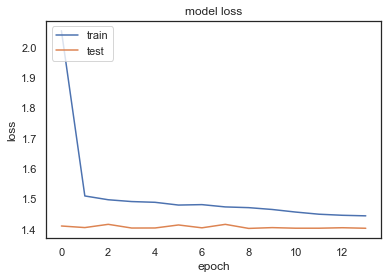

TEST WMSE =  1.3957303850663874
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 32.28726506233215


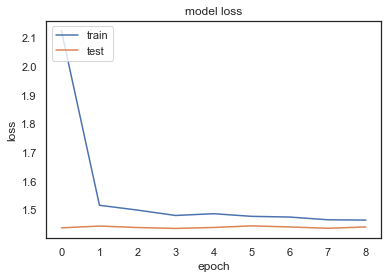

TEST WMSE =  1.4266381734347802
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.92503786087036


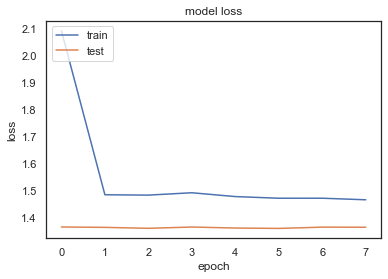

TEST WMSE =  1.4775203384057363
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 29.732383012771606


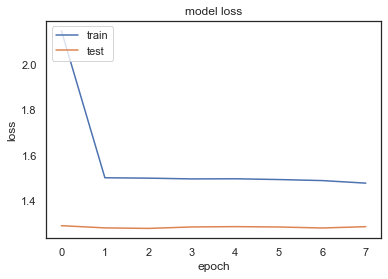

TEST WMSE =  1.3600048147076071
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 28.245150804519653


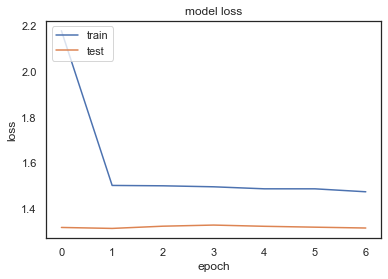

TEST WMSE =  1.4250805207021207
TEST MEAN WMSE =  1.4250805207021207
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 36.65585780143738


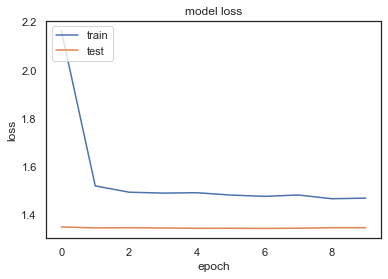

TEST WMSE =  1.3946352883249211
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.941935062408447


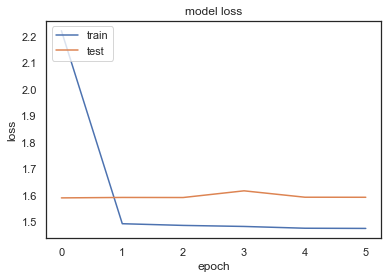

TEST WMSE =  1.4386876682139653
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 23.689271211624146


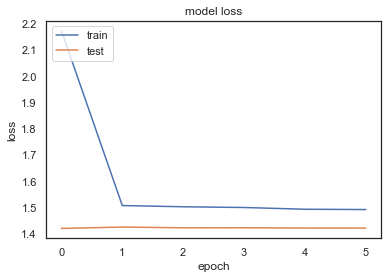

TEST WMSE =  1.3557854942852414
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 39.86670899391174


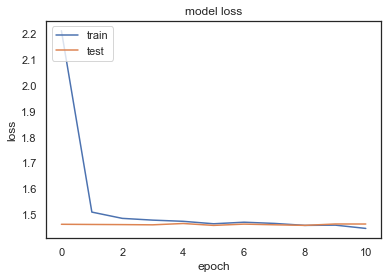

TEST WMSE =  1.4441077584364126
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.70445489883423


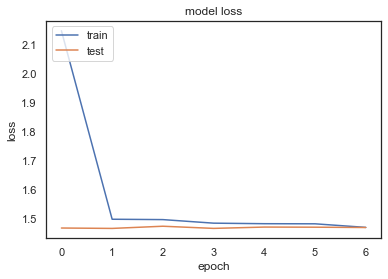

TEST WMSE =  1.4409227528491775
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 29.57736825942993


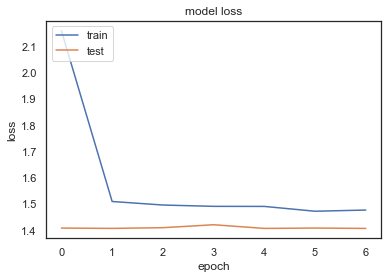

TEST WMSE =  1.3965365201033613
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.98246192932129


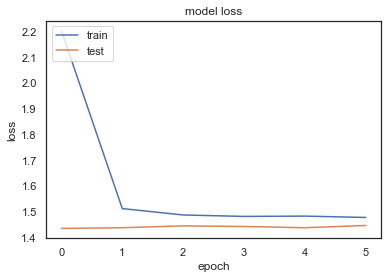

TEST WMSE =  1.4309825707238746
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 29.27897596359253


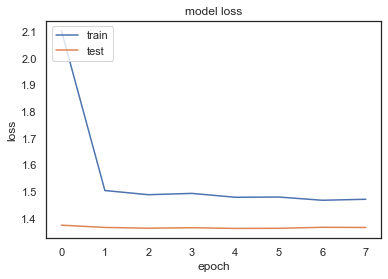

TEST WMSE =  1.4783743648703378
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 36.94921898841858


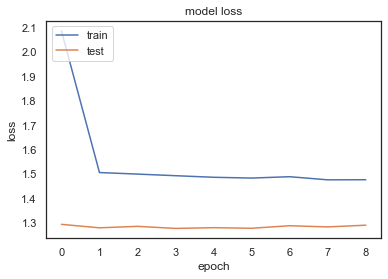

TEST WMSE =  1.3648217711465704
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 28.787864685058594


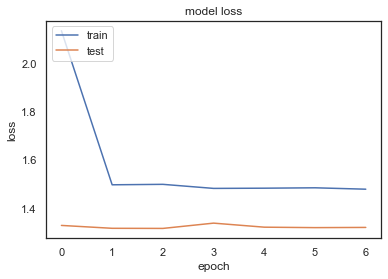

TEST WMSE =  1.4227605153175984
TEST MEAN WMSE =  1.4227605153175984


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 1
-----


-----
 FEATURE NAME -- chr2R
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.00337314605713


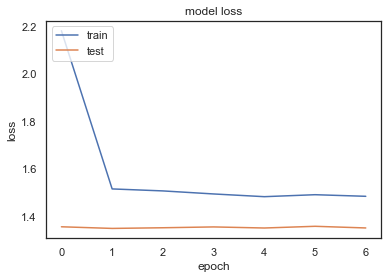

TEST WMSE =  1.4040875888234547
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 49.16430401802063


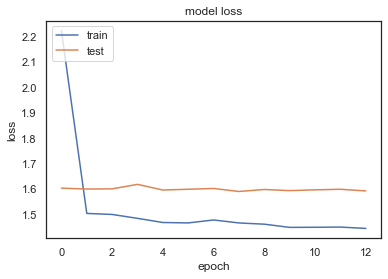

TEST WMSE =  1.4366965696894511
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 37.42050886154175


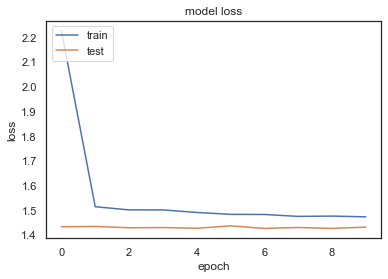

TEST WMSE =  1.359754675751187
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.46187114715576


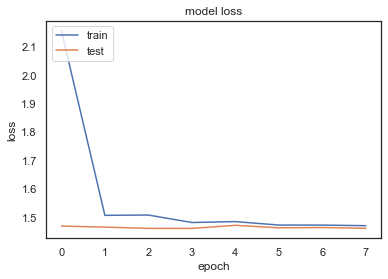

TEST WMSE =  1.4351452099919781
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 25.09625220298767


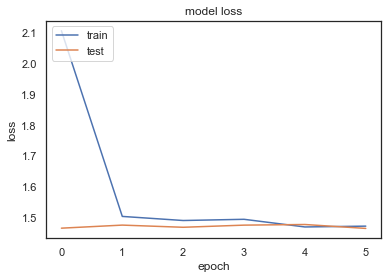

TEST WMSE =  1.4425926598889625
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 28.373615741729736


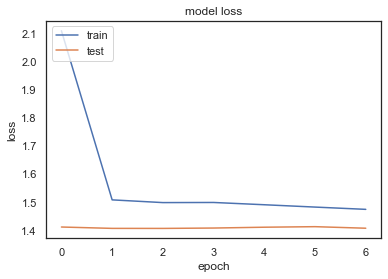

TEST WMSE =  1.3939643548536056
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 36.27918314933777


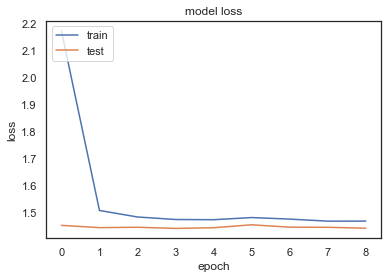

TEST WMSE =  1.4297214734064136
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.220818042755127


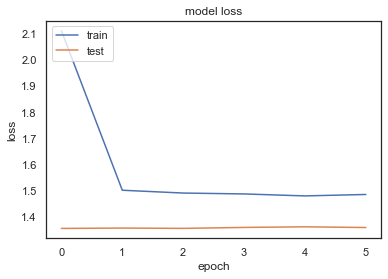

TEST WMSE =  1.4771811201879201
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 41.96353578567505


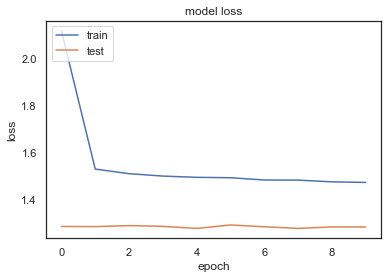

TEST WMSE =  1.3604895943471844
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 40.360856771469116


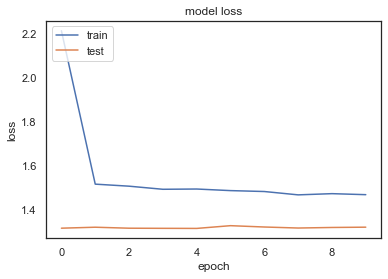

TEST WMSE =  1.4284232421337892
TEST MEAN WMSE =  1.4284232421337892
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.080852031707764


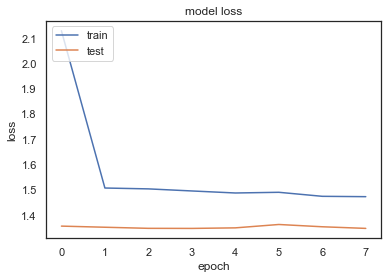

TEST WMSE =  1.3970512641500532
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 41.48300623893738


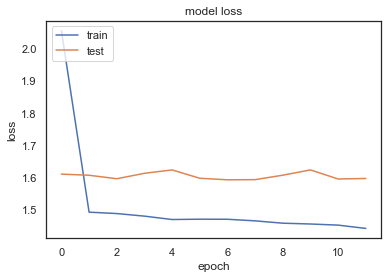

TEST WMSE =  1.4391662663666993
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.50024700164795


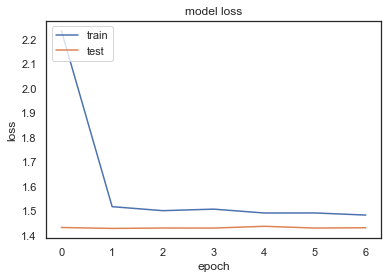

TEST WMSE =  1.3615391938084012
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.43845343589783


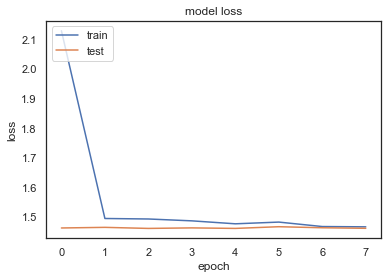

TEST WMSE =  1.4403371489322796
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.15228796005249


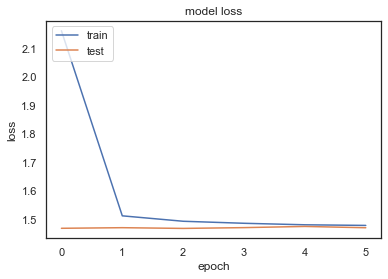

TEST WMSE =  1.4446570472542468
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.562448024749756


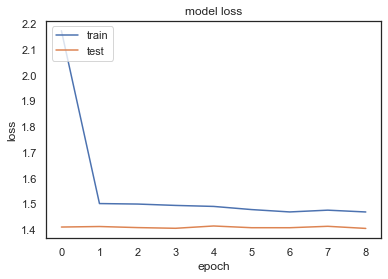

TEST WMSE =  1.395478112108545
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 37.88093686103821


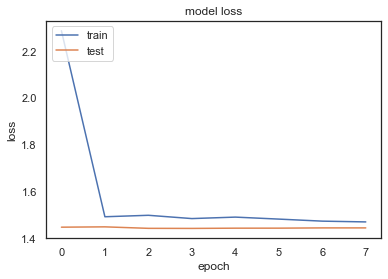

TEST WMSE =  1.4293965747508293
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.565533876419067


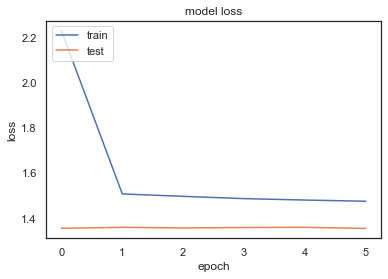

TEST WMSE =  1.471267797010207
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.712295055389404


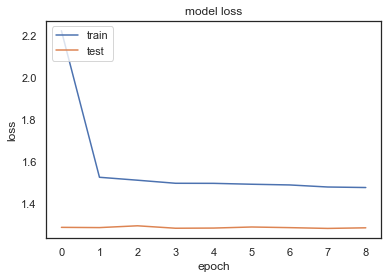

TEST WMSE =  1.359413534260524
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 45.01044201850891


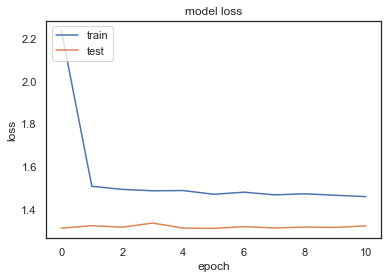

TEST WMSE =  1.4286395569454216
TEST MEAN WMSE =  1.4286395569454216
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.417786836624146


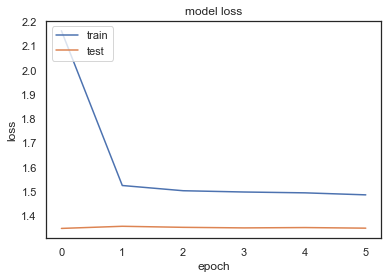

TEST WMSE =  1.3995796800901608
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.168046712875366


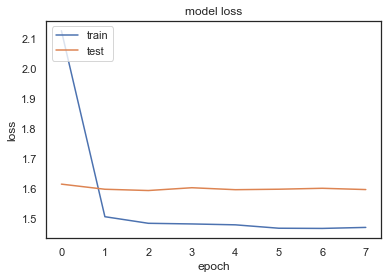

TEST WMSE =  1.437571993361708
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.97057580947876


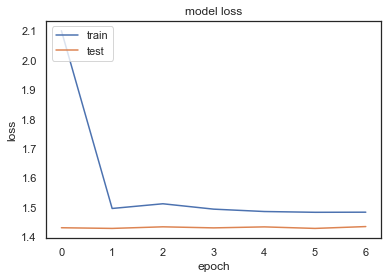

TEST WMSE =  1.3628302987065033
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.635101079940796


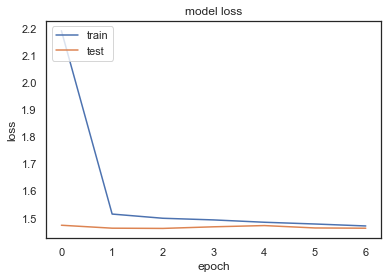

TEST WMSE =  1.4431440650105745
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.259827136993408


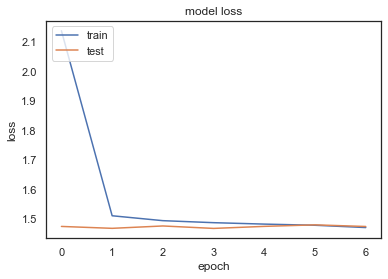

TEST WMSE =  1.4453683108809863
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.81805205345154


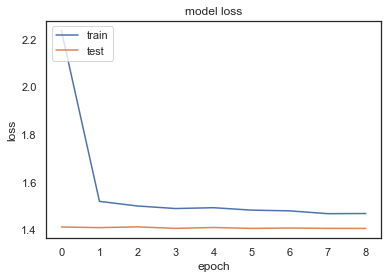

TEST WMSE =  1.3943996871191535
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 37.46211218833923


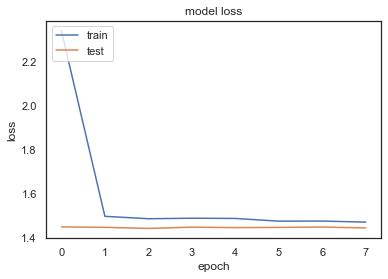

TEST WMSE =  1.4287779471372382
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.40536093711853


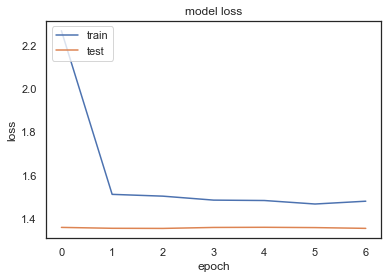

TEST WMSE =  1.4721830931751159
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.36000299453735


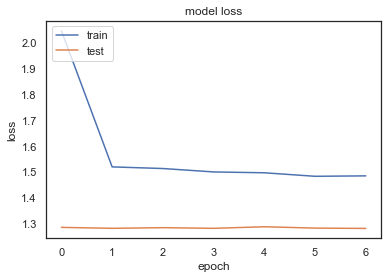

TEST WMSE =  1.357940641435818
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 28.26921796798706


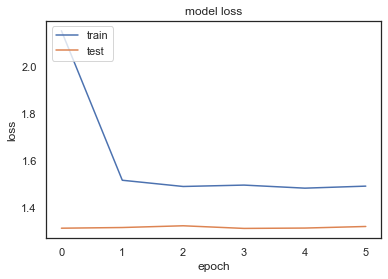

TEST WMSE =  1.4283372796893958
TEST MEAN WMSE =  1.4283372796893958


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 2
-----


-----
 FEATURE NAME -- chr3L
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 43.27779984474182


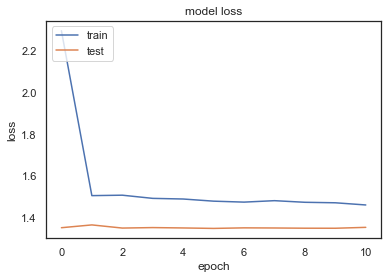

TEST WMSE =  1.3951320341449662
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 26.74214506149292


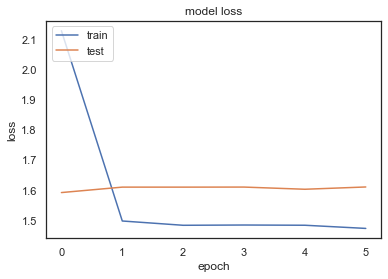

TEST WMSE =  1.441440253778335
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.40515422821045


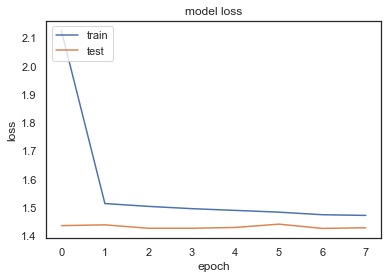

TEST WMSE =  1.3561281362778936
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 55.6568660736084


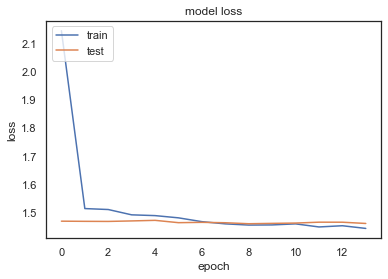

TEST WMSE =  1.4354596677471632
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 38.16560101509094


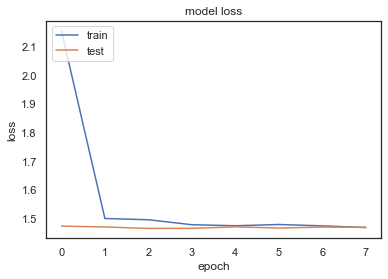

TEST WMSE =  1.4438857326775079
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 42.86107325553894


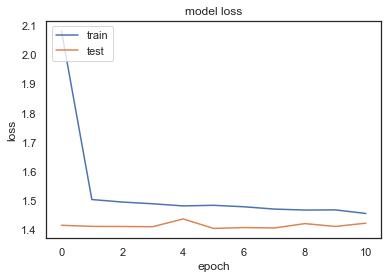

TEST WMSE =  1.399079109824262
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 41.24602007865906


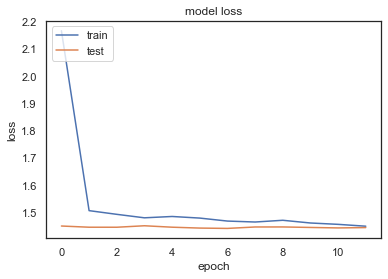

TEST WMSE =  1.428518931245401
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 36.451380014419556


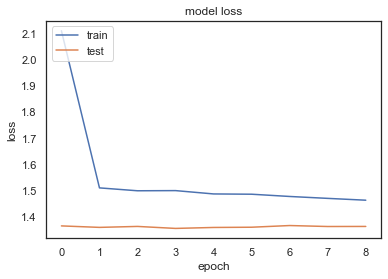

TEST WMSE =  1.476104410244683
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.96080303192139


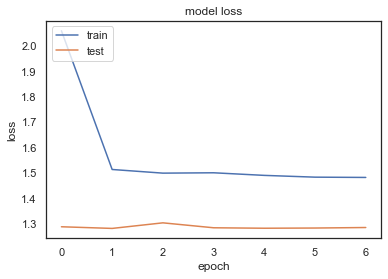

TEST WMSE =  1.3602962717707099
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.20889616012573


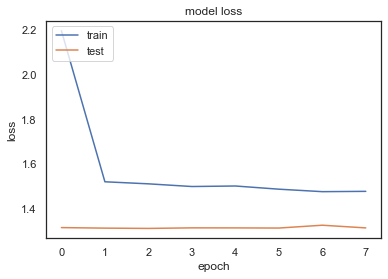

TEST WMSE =  1.4306318273496597
TEST MEAN WMSE =  1.4306318273496597
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 33.283594846725464


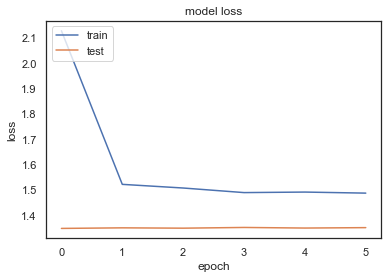

TEST WMSE =  1.4029649979609131
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.2725830078125


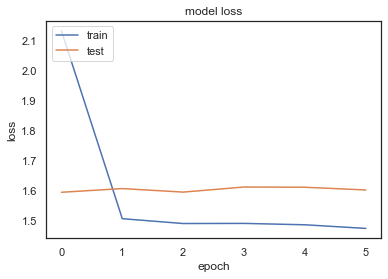

TEST WMSE =  1.437231746814759
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 28.394198179244995


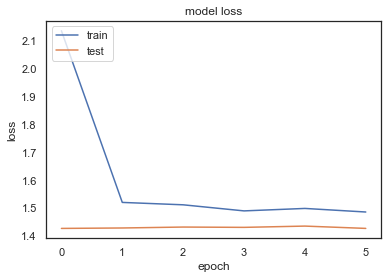

TEST WMSE =  1.356363852227
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.04548501968384


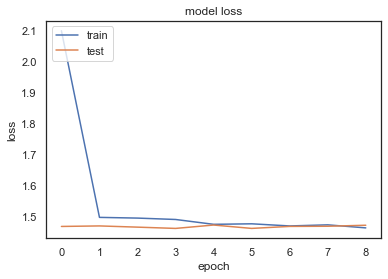

TEST WMSE =  1.442366493687412
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.474688053131104


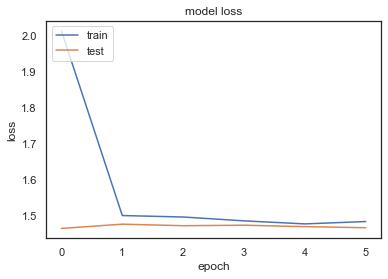

TEST WMSE =  1.4441638186885861
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 33.9953510761261


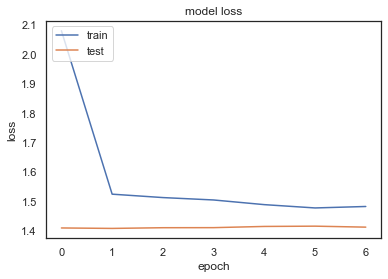

TEST WMSE =  1.3940837476189532
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.71942710876465


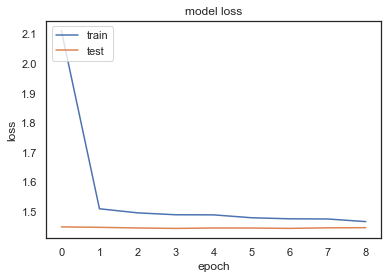

TEST WMSE =  1.4286720167729798
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.29593801498413


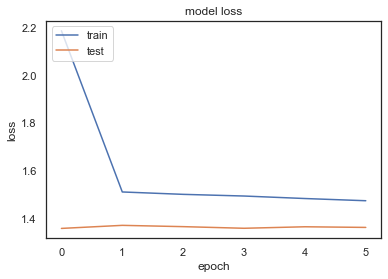

TEST WMSE =  1.4795460080523242
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.193291902542114


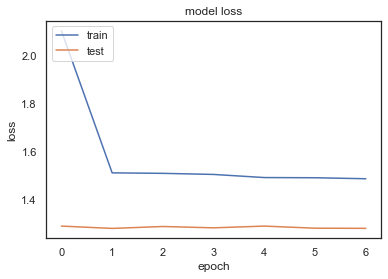

TEST WMSE =  1.3592390774353162
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.27357792854309


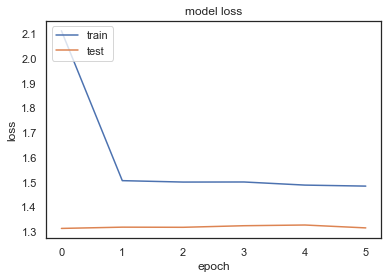

TEST WMSE =  1.428940333972735
TEST MEAN WMSE =  1.428940333972735
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 35.1000280380249


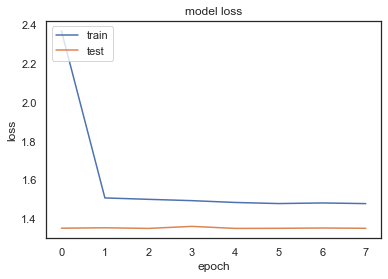

TEST WMSE =  1.4022516165724312
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 39.05788516998291


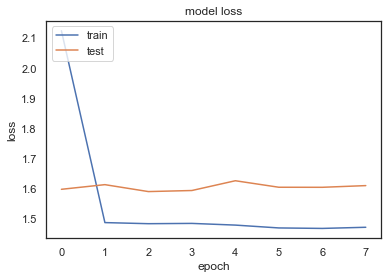

TEST WMSE =  1.4407377711570606
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.318655014038086


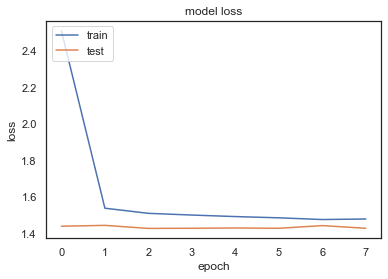

TEST WMSE =  1.3568070503862735
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 26.44852614402771


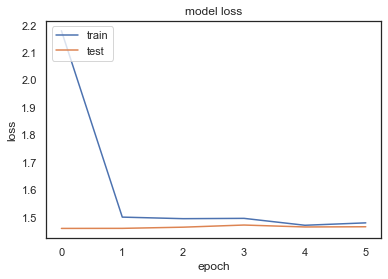

TEST WMSE =  1.4429167002165093
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.446163177490234


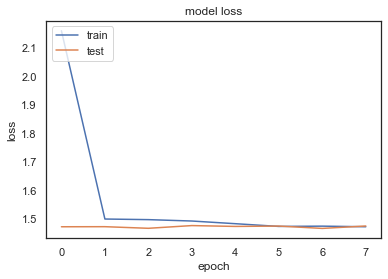

TEST WMSE =  1.4473630183929564
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 49.280057191848755


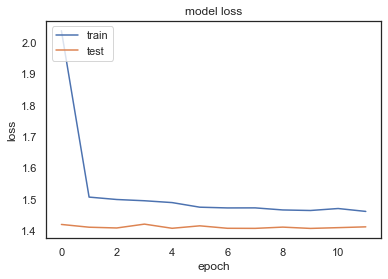

TEST WMSE =  1.3935448339197956
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.114969968795776


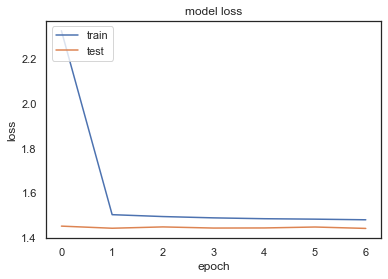

TEST WMSE =  1.427894287699872
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.616618871688843


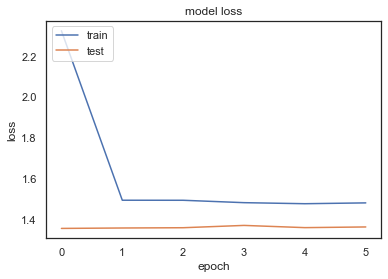

TEST WMSE =  1.4833074287336183
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.789018869400024


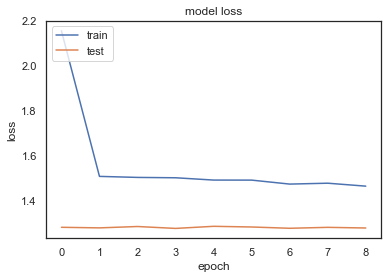

TEST WMSE =  1.3580081861440398
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 39.63618302345276


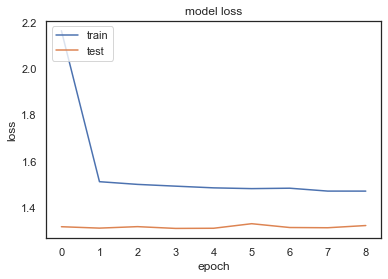

TEST WMSE =  1.4271996211446563
TEST MEAN WMSE =  1.4271996211446563


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 3
-----


-----
 FEATURE NAME -- chr3R
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 38.566797733306885


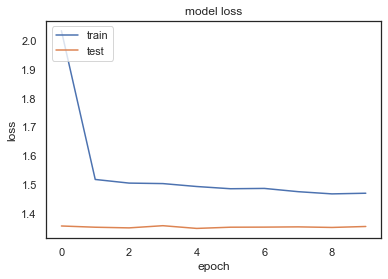

TEST WMSE =  1.4063777627116312
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 53.98064589500427


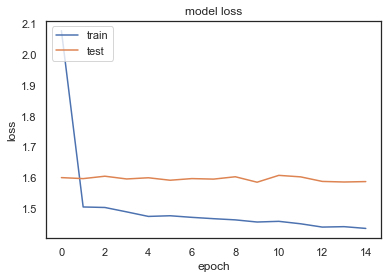

TEST WMSE =  1.4357879070097823
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 44.96164679527283


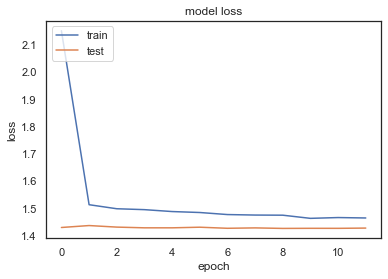

TEST WMSE =  1.359704119540933
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.65652513504028


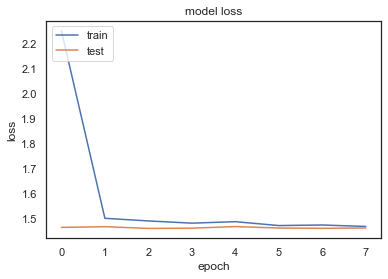

TEST WMSE =  1.4397059524751141
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 31.107709169387817


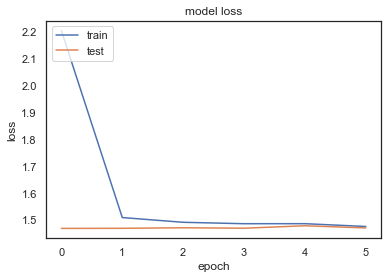

TEST WMSE =  1.4444676513581187
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.4883189201355


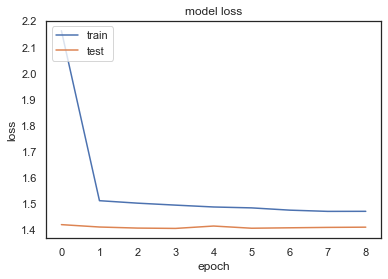

TEST WMSE =  1.3939105804280796
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.5761239528656


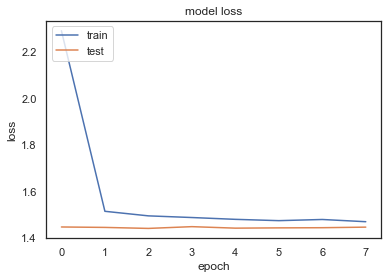

TEST WMSE =  1.4298467003836253
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 40.82074189186096


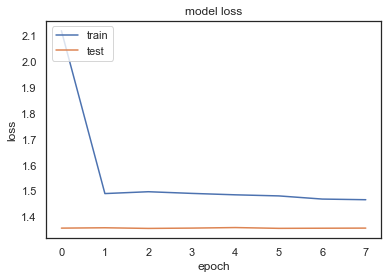

TEST WMSE =  1.474214306106269
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 42.74257206916809


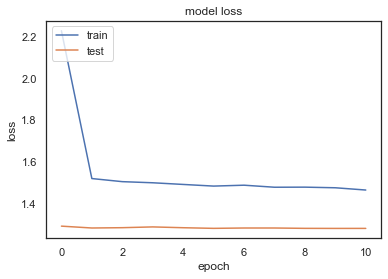

TEST WMSE =  1.3575249227425206
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 35.429043769836426


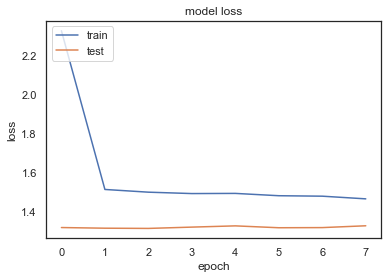

TEST WMSE =  1.4289502600212585
TEST MEAN WMSE =  1.4289502600212585
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 28.734790086746216


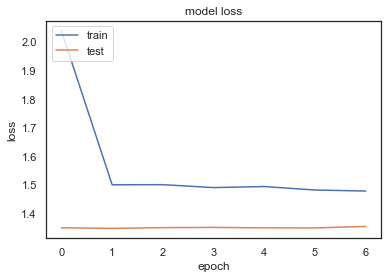

TEST WMSE =  1.4082174391920999
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 33.87584090232849


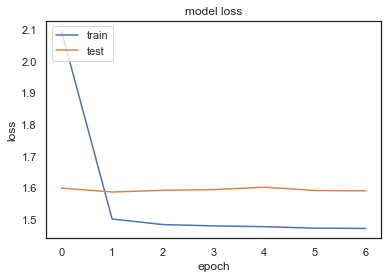

TEST WMSE =  1.4352472096386635
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.38776707649231


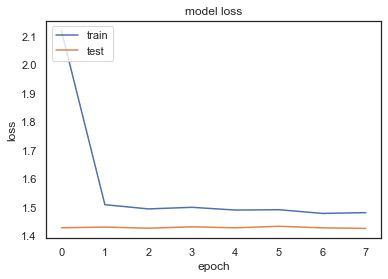

TEST WMSE =  1.3585422220131718
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 26.86153483390808


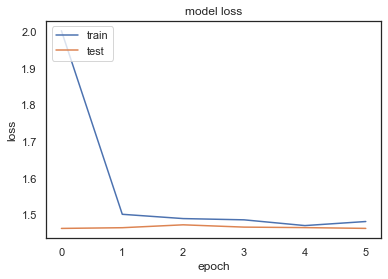

TEST WMSE =  1.4399723303385157
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 29.61656093597412


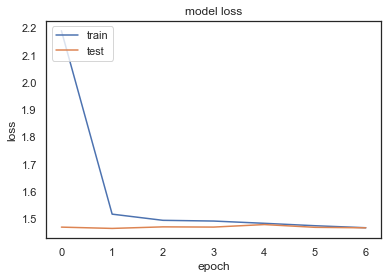

TEST WMSE =  1.4427243825642793
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 43.2105987071991


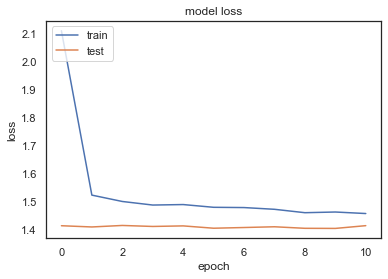

TEST WMSE =  1.3957574602790468
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 45.81554985046387


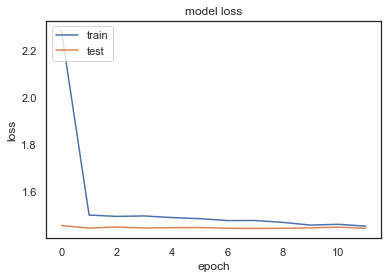

TEST WMSE =  1.4279885006202646
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.170584201812744


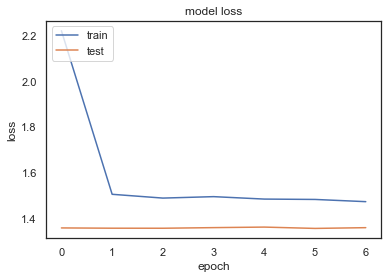

TEST WMSE =  1.477511318014959
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 39.698456048965454


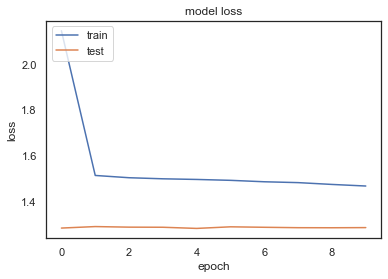

TEST WMSE =  1.359616643379928
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.8991801738739


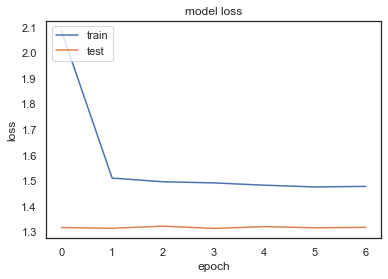

TEST WMSE =  1.4285740233186248
TEST MEAN WMSE =  1.4285740233186248
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 44.16442799568176


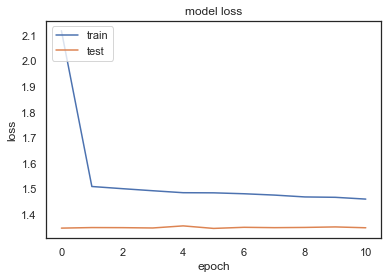

TEST WMSE =  1.396697514827994
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 55.3084180355072


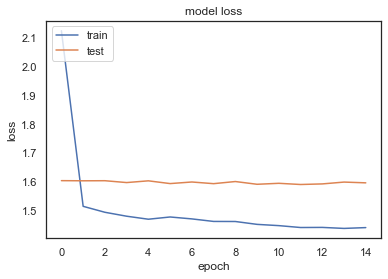

TEST WMSE =  1.4360309386525432
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.68803691864014


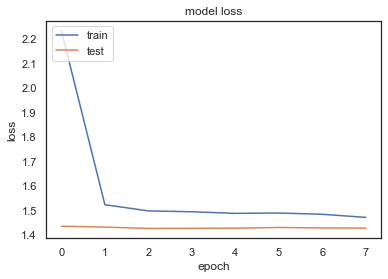

TEST WMSE =  1.3603959309277764
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.119746923446655


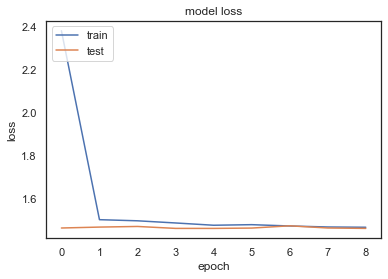

TEST WMSE =  1.4376492779727479
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 41.82435488700867


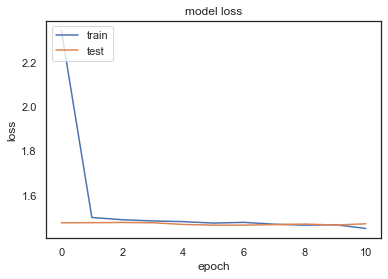

TEST WMSE =  1.4454681094760604
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 45.3906569480896


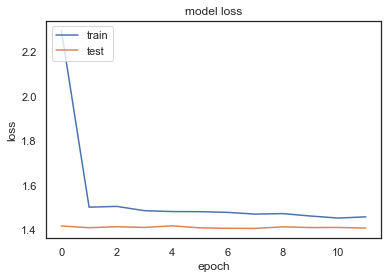

TEST WMSE =  1.3933123780191583
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.275972843170166


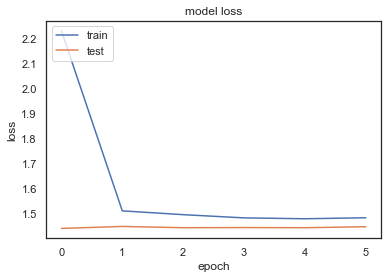

TEST WMSE =  1.4296101068433407
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 38.203022956848145


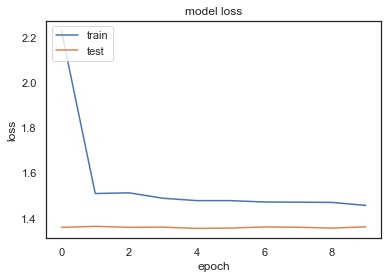

TEST WMSE =  1.4817600364230883
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 40.866410970687866


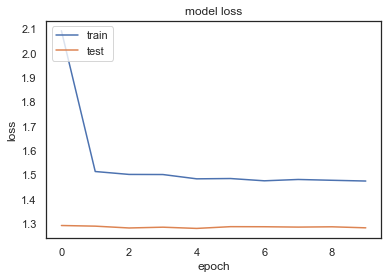

TEST WMSE =  1.3585809834028653
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.19071936607361


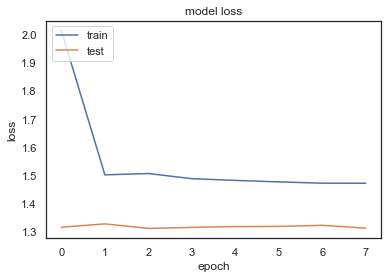

TEST WMSE =  1.430308828926969
TEST MEAN WMSE =  1.430308828926969


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 4
-----


-----
 FEATURE NAME -- chrX
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 28.05319094657898


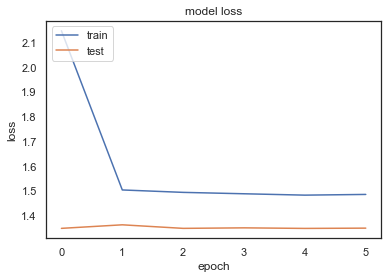

TEST WMSE =  1.401506958884336
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 53.57484221458435


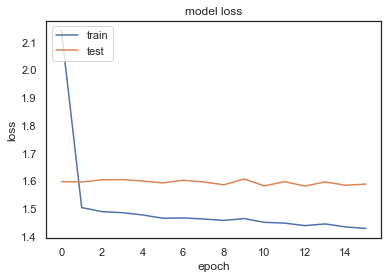

TEST WMSE =  1.4332409057587256
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.588335275650024


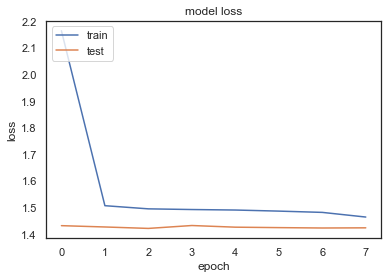

TEST WMSE =  1.370193412648161
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 51.737157106399536


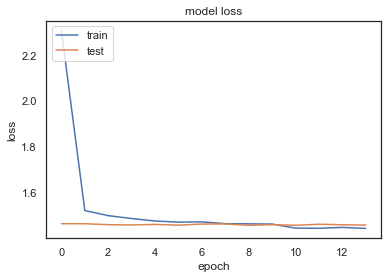

TEST WMSE =  1.4336837302607555
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 40.383949756622314


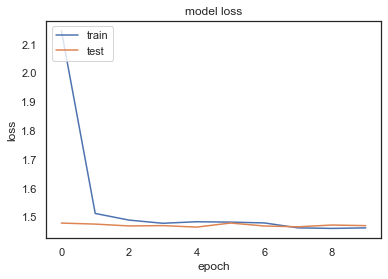

TEST WMSE =  1.4424074862930334
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 45.92853403091431


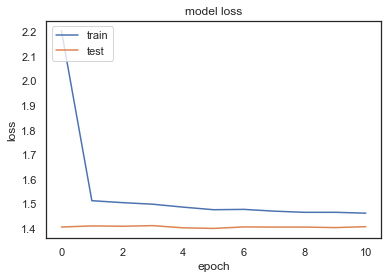

TEST WMSE =  1.396165183803783
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.001660108566284


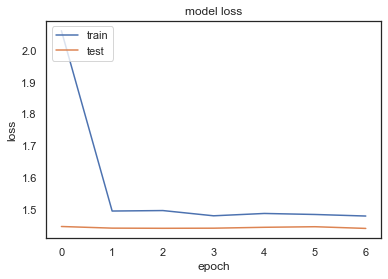

TEST WMSE =  1.4233153645453331
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 39.844757080078125


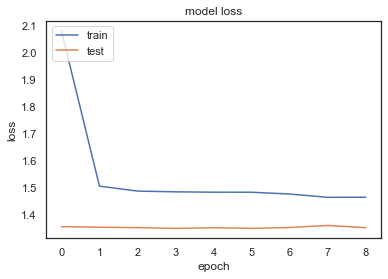

TEST WMSE =  1.4684963291582986
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.53918409347534


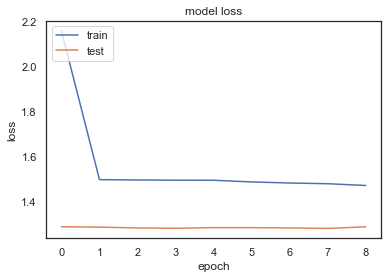

TEST WMSE =  1.3567867221203902
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.767875909805298


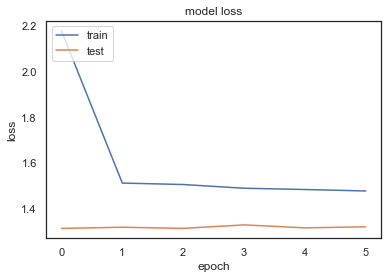

TEST WMSE =  1.4263788903929546
TEST MEAN WMSE =  1.4263788903929546
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 38.59322500228882


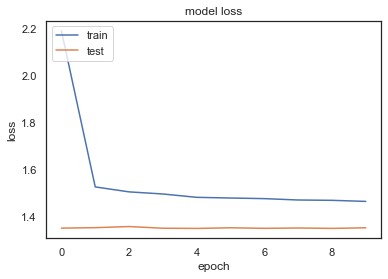

TEST WMSE =  1.39709257929025
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.66475796699524


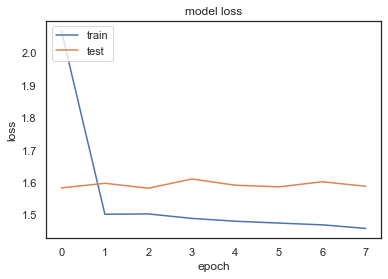

TEST WMSE =  1.4329942395613475
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 41.98925423622131


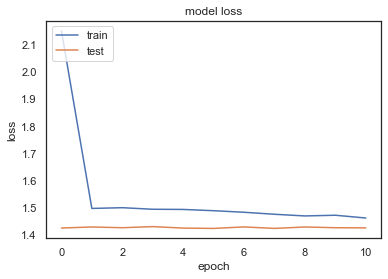

TEST WMSE =  1.3617445680346518
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 31.849421977996826


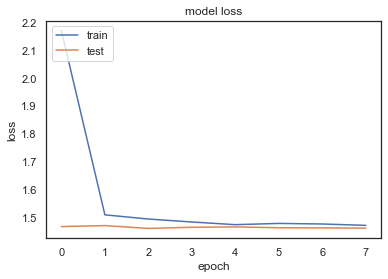

TEST WMSE =  1.4381299115678794
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 27.617117166519165


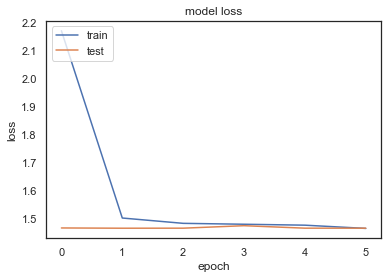

TEST WMSE =  1.4405828684145905
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 44.95436477661133


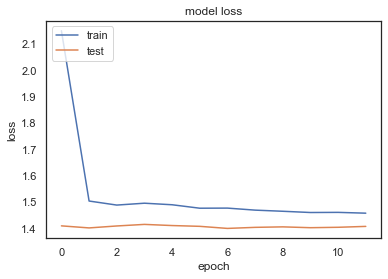

TEST WMSE =  1.3971386891861817
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.38438606262207


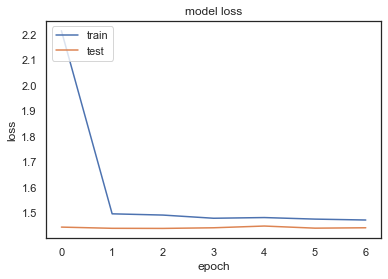

TEST WMSE =  1.4223296135551577
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.15223813056946


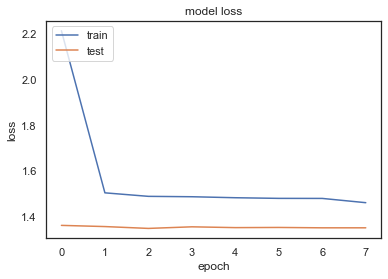

TEST WMSE =  1.4740385836526158
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.44313073158264


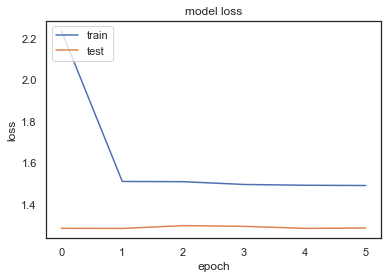

TEST WMSE =  1.3539799284695841
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 33.285491943359375


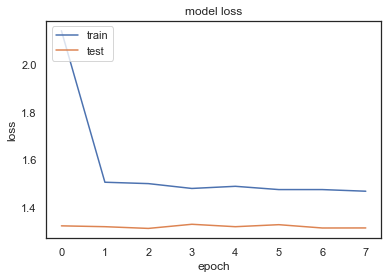

TEST WMSE =  1.4287426305908928
TEST MEAN WMSE =  1.4287426305908928
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 43.38830780982971


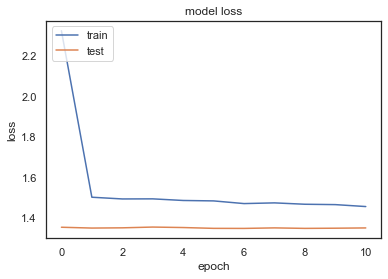

TEST WMSE =  1.3952963252132191
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.373801946640015


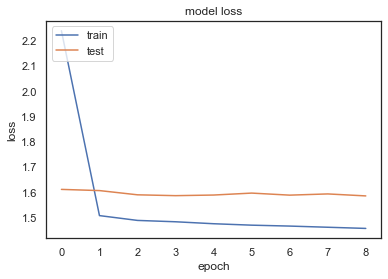

TEST WMSE =  1.432625719121909
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 40.733887910842896


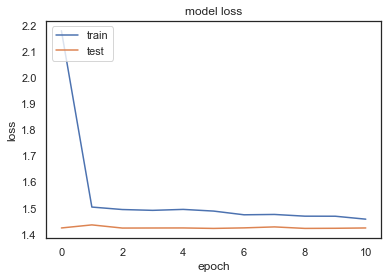

TEST WMSE =  1.364608393629724
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.73721385002136


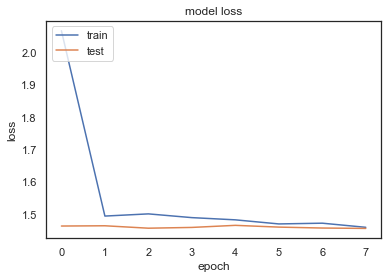

TEST WMSE =  1.432299117895319
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 54.336795806884766


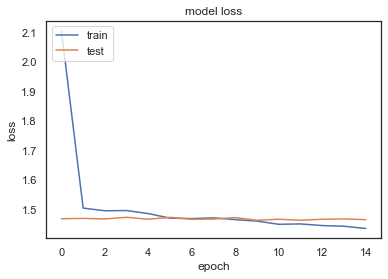

TEST WMSE =  1.4403739598235283
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 42.79171395301819


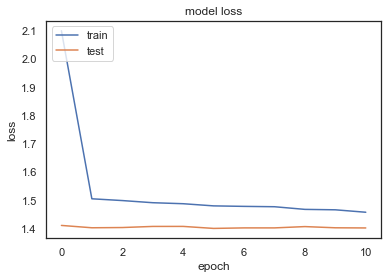

TEST WMSE =  1.3966656661687915
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 38.68558406829834


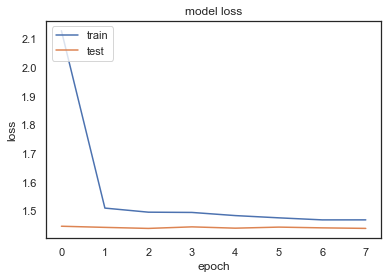

TEST WMSE =  1.4249397793184917
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.17959403991699


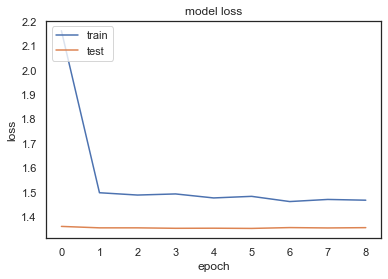

TEST WMSE =  1.4757178040785872
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.720731019973755


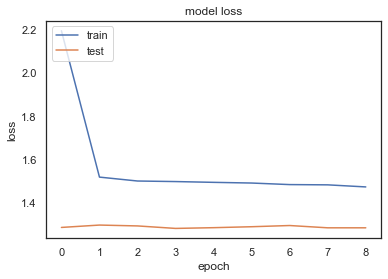

TEST WMSE =  1.3554953271404466
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.5810010433197


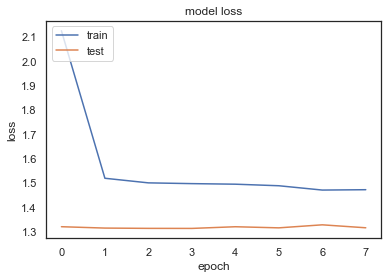

TEST WMSE =  1.4277130834262095
TEST MEAN WMSE =  1.4277130834262095


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 5
-----


-----
 FEATURE NAME -- is_s2
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 42.963659048080444


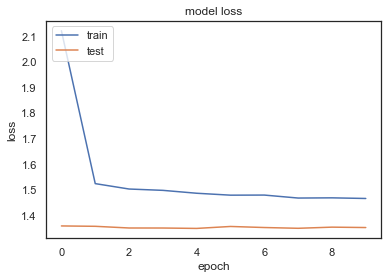

TEST WMSE =  1.40337169554542
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.984303951263428


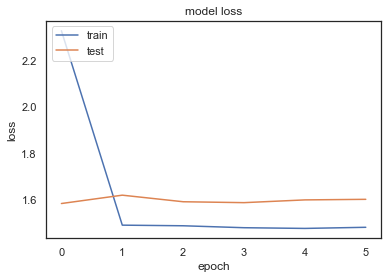

TEST WMSE =  1.4336506196152707
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.76643204689026


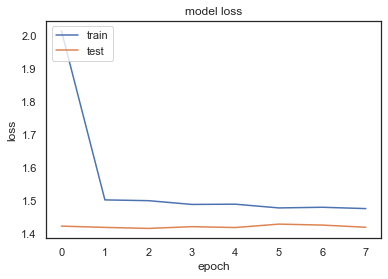

TEST WMSE =  1.3551747593732084
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 44.242894649505615


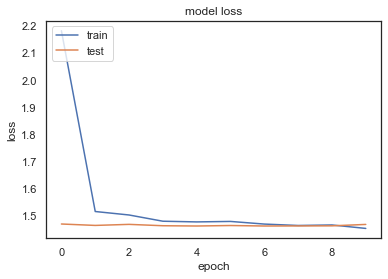

TEST WMSE =  1.4434282232859137
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 46.80292296409607


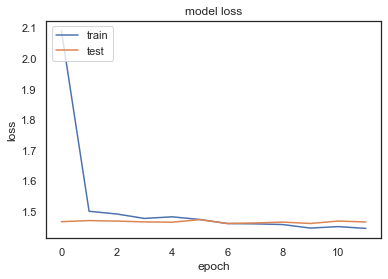

TEST WMSE =  1.4424008181548922
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 53.78957223892212


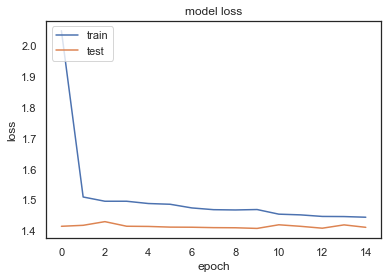

TEST WMSE =  1.3914964219597838
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 53.53888201713562


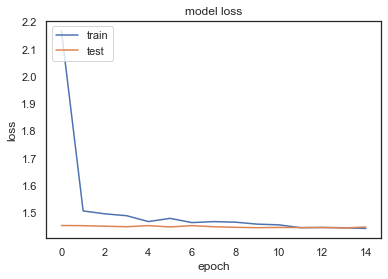

TEST WMSE =  1.4239301419086265
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 35.98972797393799


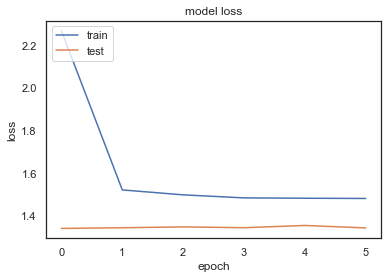

TEST WMSE =  1.4718265546786944
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 39.29469180107117


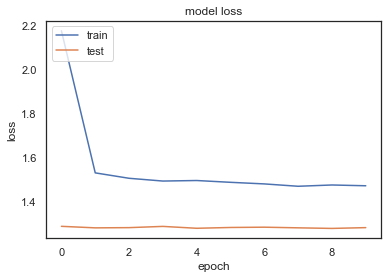

TEST WMSE =  1.3580710510110008
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 34.956109046936035


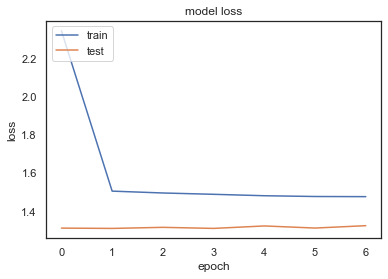

TEST WMSE =  1.4332599709218985
TEST MEAN WMSE =  1.4332599709218985
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 38.53303813934326


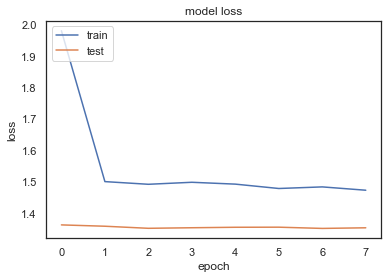

TEST WMSE =  1.4031656914199975
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 49.2754602432251


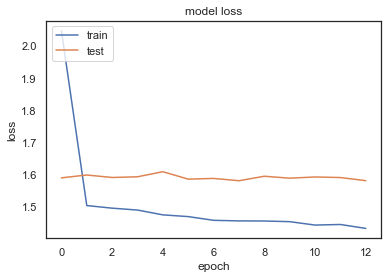

TEST WMSE =  1.4276080876105892
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 35.40190410614014


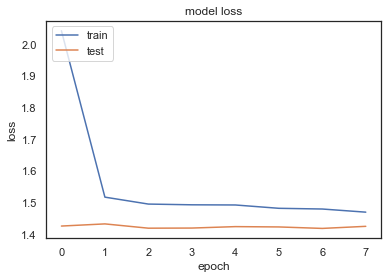

TEST WMSE =  1.3596899782348848
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 33.163978576660156


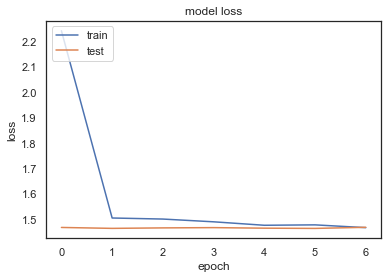

TEST WMSE =  1.4425721864696353
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 41.74627995491028


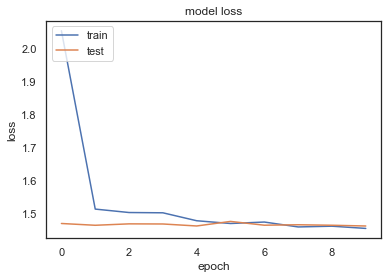

TEST WMSE =  1.4419580858127636
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.376757860183716


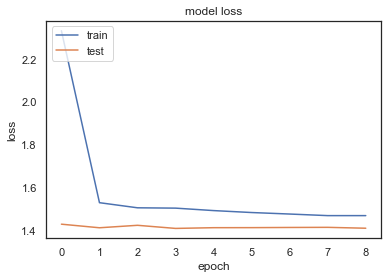

TEST WMSE =  1.3923764948355666
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 39.21705174446106


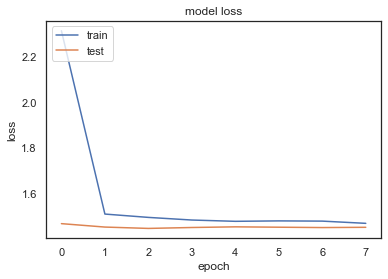

TEST WMSE =  1.426443962544145
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 31.143156051635742


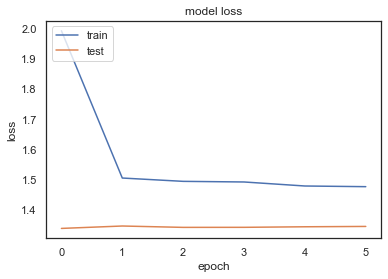

TEST WMSE =  1.4698530899508484
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 41.95493197441101


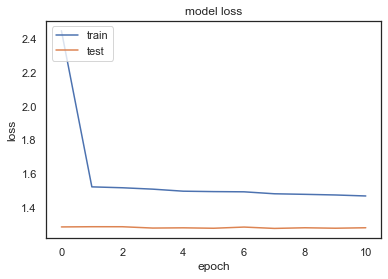

TEST WMSE =  1.3582107366999894
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 41.698617696762085


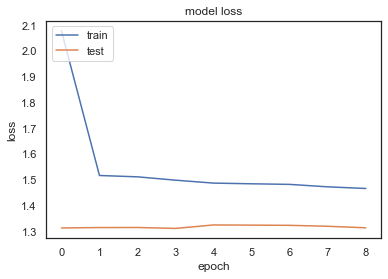

TEST WMSE =  1.4327811442703673
TEST MEAN WMSE =  1.4327811442703673
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 51.08331298828125


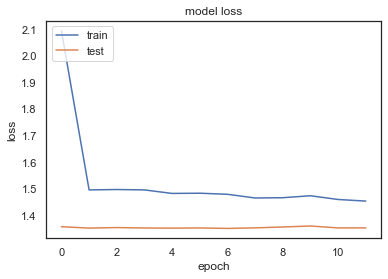

TEST WMSE =  1.403992081199495
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 40.49837803840637


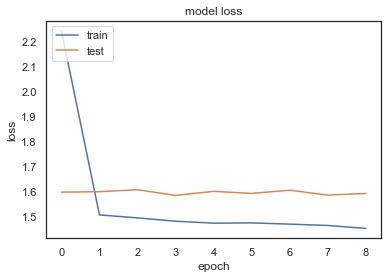

TEST WMSE =  1.4283650612887355
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.837080001831055


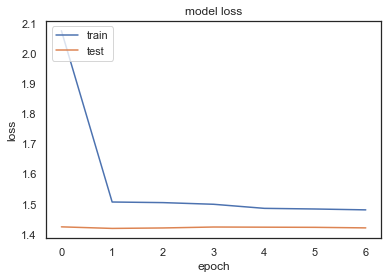

TEST WMSE =  1.3551186334066843
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 33.646466970443726


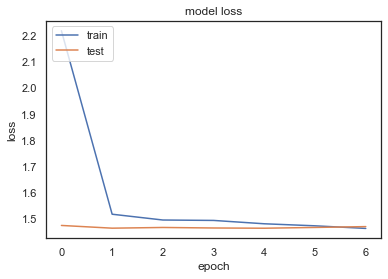

TEST WMSE =  1.443222818472961
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 45.68339991569519


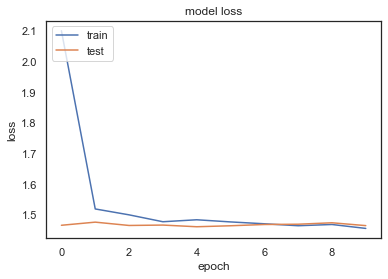

TEST WMSE =  1.4420413801116734
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 40.09449005126953


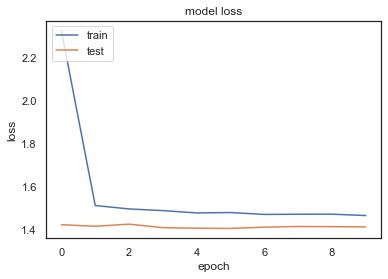

TEST WMSE =  1.3917761804579412
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 34.39355707168579


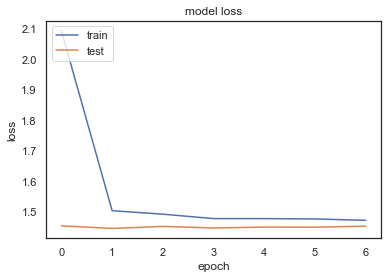

TEST WMSE =  1.4276486592392599
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.651761054992676


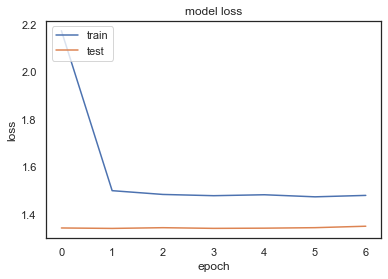

TEST WMSE =  1.4850404324182362
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.222997903823853


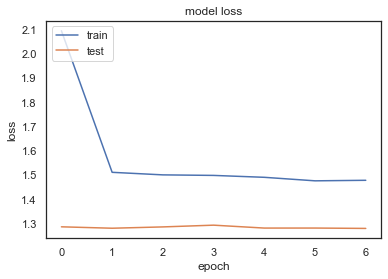

TEST WMSE =  1.3577638081756893
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.48146104812622


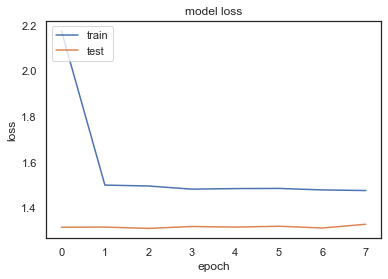

TEST WMSE =  1.4321521718565176
TEST MEAN WMSE =  1.4321521718565176


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 6
-----


-----
 FEATURE NAME -- is_kc
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 34.540700912475586


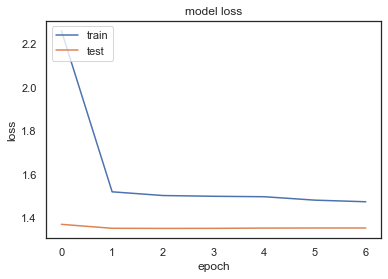

TEST WMSE =  1.4025110189981922
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.851985931396484


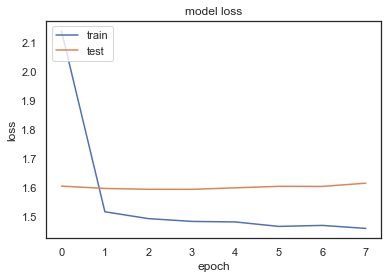

TEST WMSE =  1.4443368656789939
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 35.83917593955994


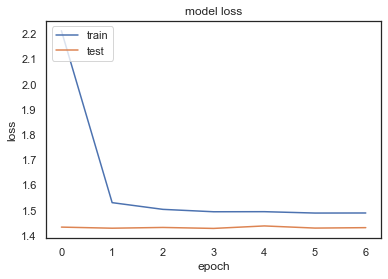

TEST WMSE =  1.3593781661496662
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 30.81922197341919


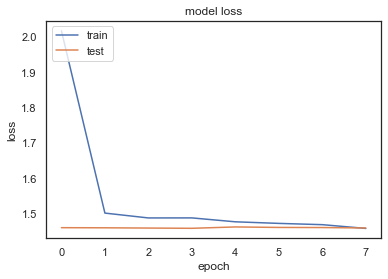

TEST WMSE =  1.4373183107207426
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.53924584388733


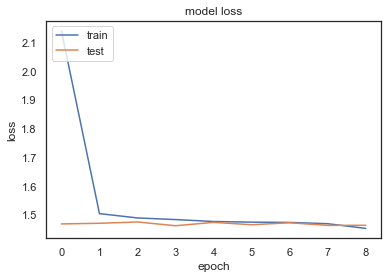

TEST WMSE =  1.4424003019082305
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 32.87017607688904


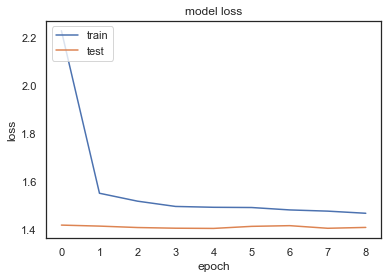

TEST WMSE =  1.3927915610953316
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 44.55449914932251


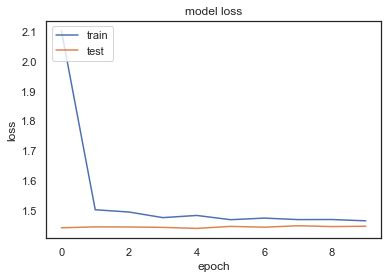

TEST WMSE =  1.4314322445610321
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.23949313163757


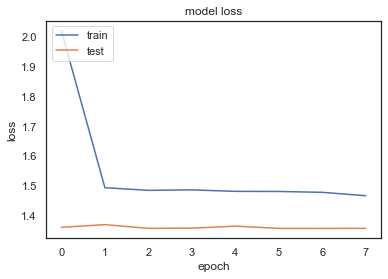

TEST WMSE =  1.4739106539876063
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 44.95422434806824


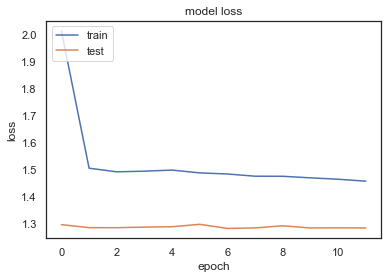

TEST WMSE =  1.358762224885547
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 39.30096483230591


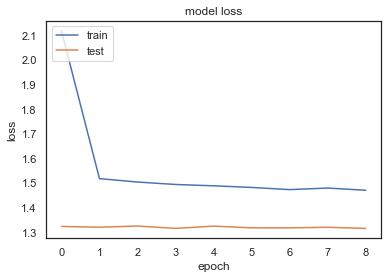

TEST WMSE =  1.429253091156614
TEST MEAN WMSE =  1.429253091156614
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 26.94992208480835


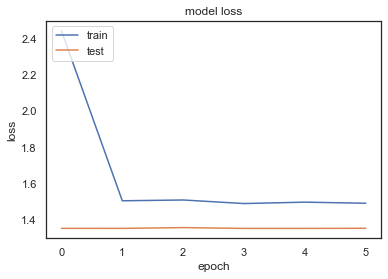

TEST WMSE =  1.400722602684555
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 41.00751185417175


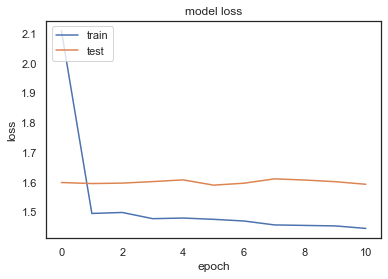

TEST WMSE =  1.4357109525935863
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.98901605606079


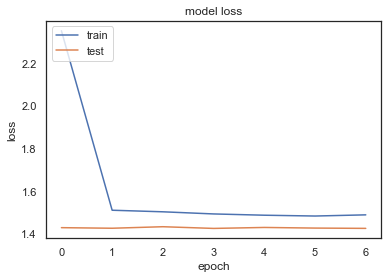

TEST WMSE =  1.3562969180903612
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.347513675689697


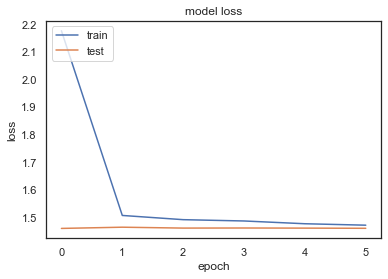

TEST WMSE =  1.4367743742599313
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 45.116886138916016


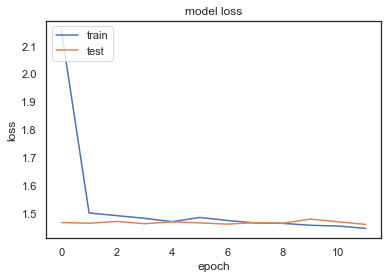

TEST WMSE =  1.4415646025136395
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 39.934760332107544


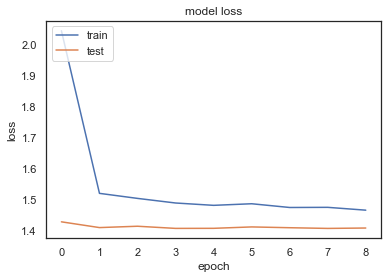

TEST WMSE =  1.3919991570035972
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 31.10908818244934


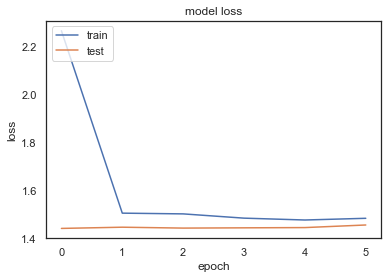

TEST WMSE =  1.434879455322345
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.39038419723511


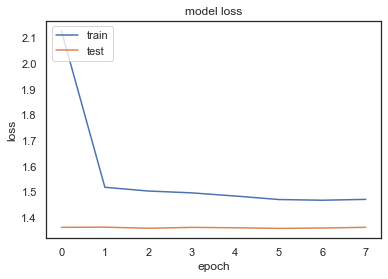

TEST WMSE =  1.4797764609046418
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 53.955772161483765


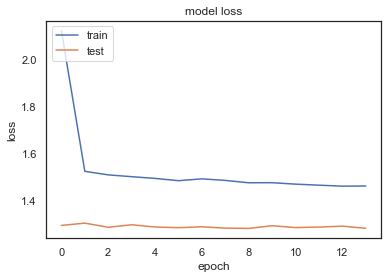

TEST WMSE =  1.356894569428709
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 54.855082988739014


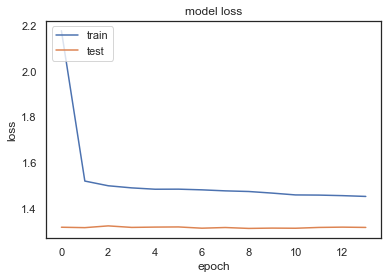

TEST WMSE =  1.4288089862174966
TEST MEAN WMSE =  1.4288089862174966
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.34107422828674


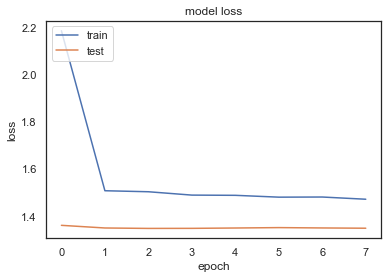

TEST WMSE =  1.3977226519810397
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 41.54816699028015


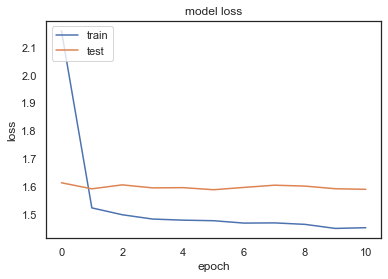

TEST WMSE =  1.4353399486635148
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 34.77081608772278


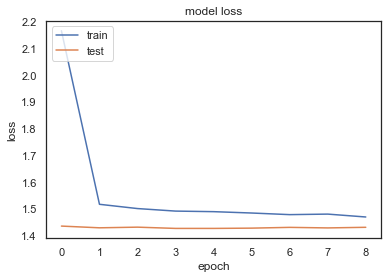

TEST WMSE =  1.3612937540151324
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.050694942474365


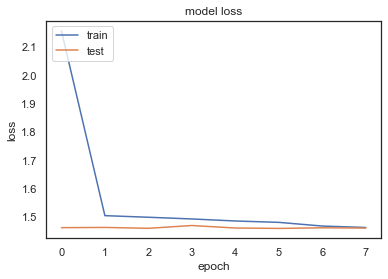

TEST WMSE =  1.4417425804026567
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.79689002037048


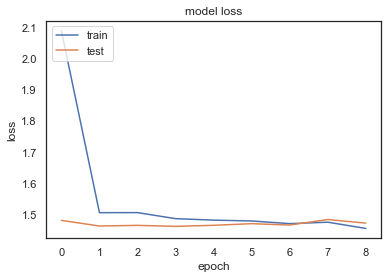

TEST WMSE =  1.445080285280429
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 49.25038385391235


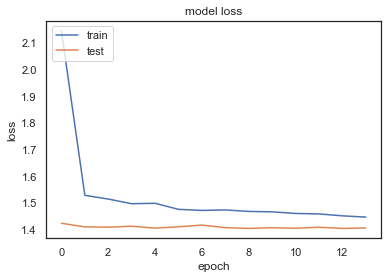

TEST WMSE =  1.392524830280446
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 28.59932017326355


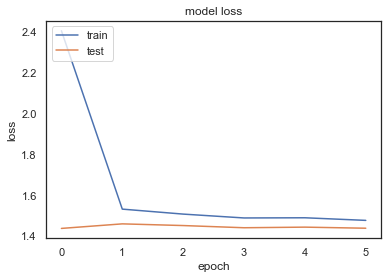

TEST WMSE =  1.4300750361506722
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.116570234298706


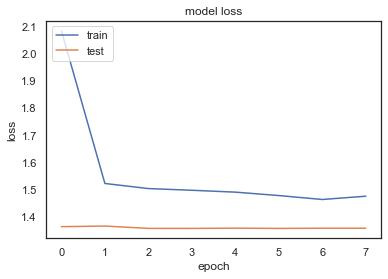

TEST WMSE =  1.4747942693585272
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.5993378162384


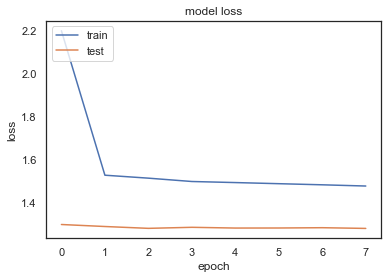

TEST WMSE =  1.3597042719820263
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 32.232568979263306


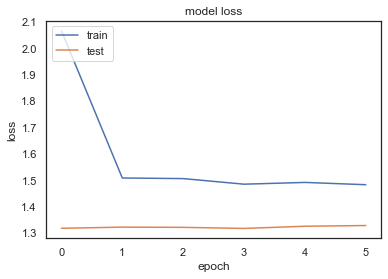

TEST WMSE =  1.4292204958096821
TEST MEAN WMSE =  1.4292204958096821


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 7
-----


-----
 FEATURE NAME -- is_bg
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 25.46958303451538


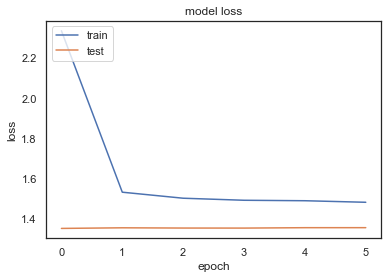

TEST WMSE =  1.4012778349390316
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 48.45562791824341


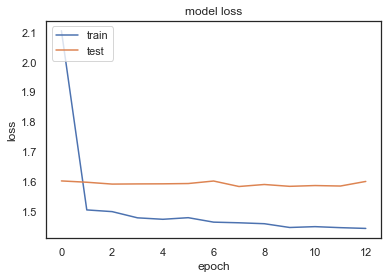

TEST WMSE =  1.430995970931957
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 48.358069896698


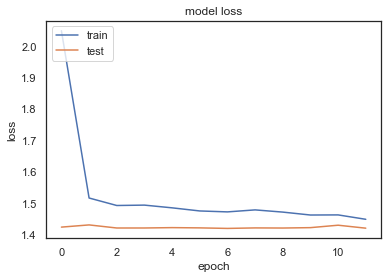

TEST WMSE =  1.3521672370058946
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 46.1305730342865


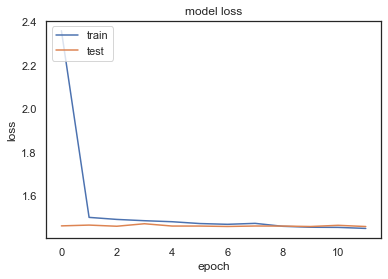

TEST WMSE =  1.4319781790995725
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 34.50224804878235


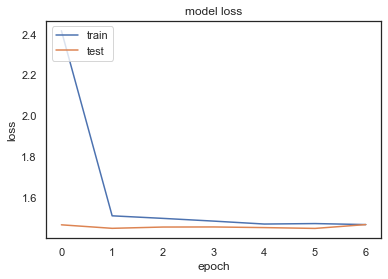

TEST WMSE =  1.44656654426112
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 38.14576482772827


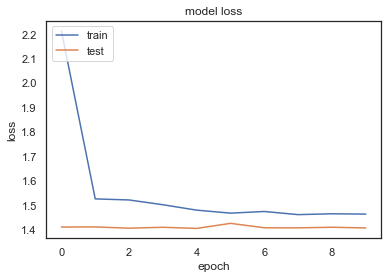

TEST WMSE =  1.3881279197590262
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 42.25950789451599


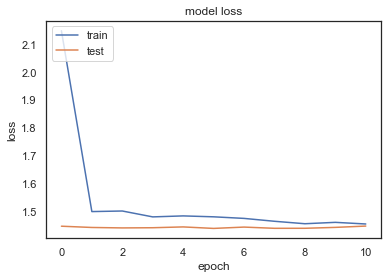

TEST WMSE =  1.4297611551414982
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 50.833091020584106


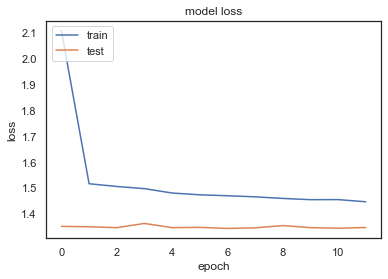

TEST WMSE =  1.4764922480146416
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 32.05350613594055


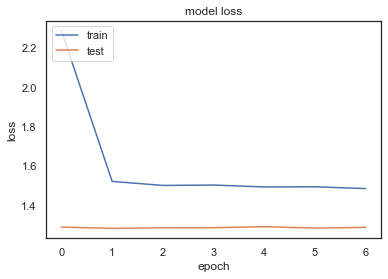

TEST WMSE =  1.3551042642411573
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 50.93646597862244


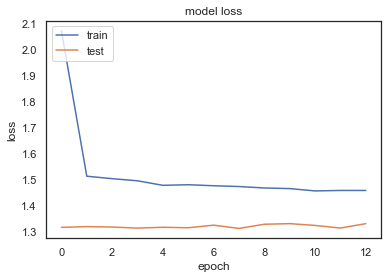

TEST WMSE =  1.430599427947244
TEST MEAN WMSE =  1.430599427947244
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.033679962158203


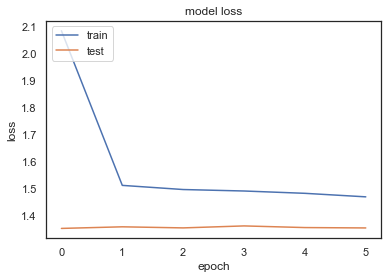

TEST WMSE =  1.396272949814476
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 49.402026891708374


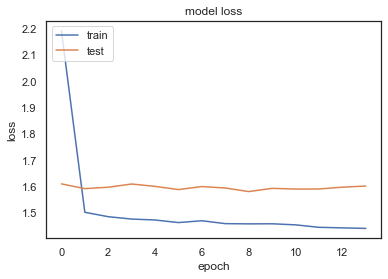

TEST WMSE =  1.4297843817255522
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 35.486433029174805


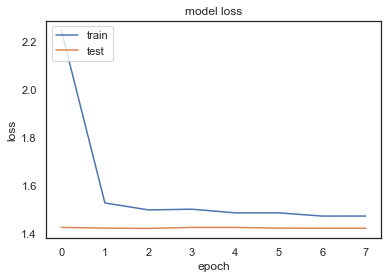

TEST WMSE =  1.3529608408123748
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 34.64477181434631


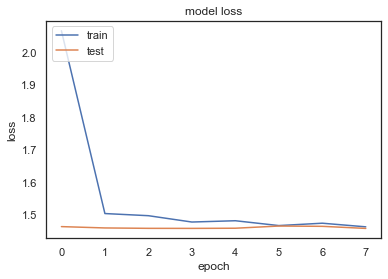

TEST WMSE =  1.4320047343415512
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 44.05150485038757


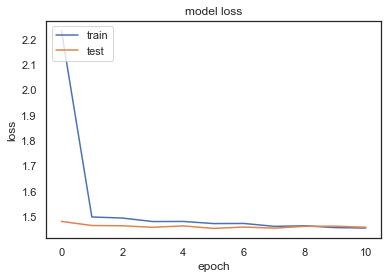

TEST WMSE =  1.4392315486529599
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 44.566346883773804


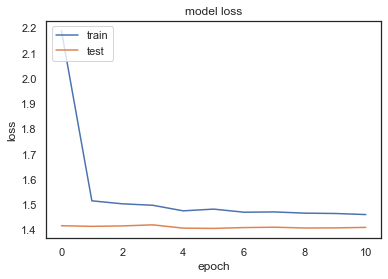

TEST WMSE =  1.3875992634945267
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.34239482879639


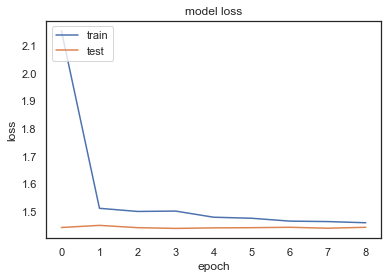

TEST WMSE =  1.4280917547988052
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.330228090286255


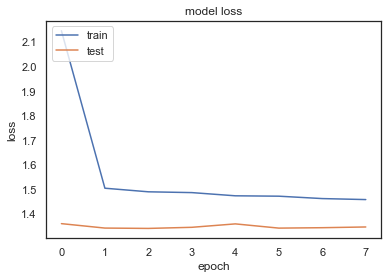

TEST WMSE =  1.4695847989706414
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 29.506803035736084


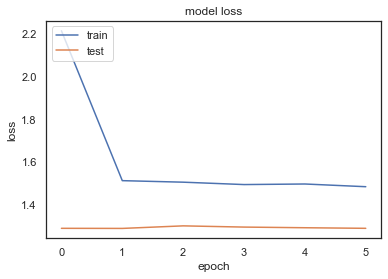

TEST WMSE =  1.3572677290473403
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 35.63717293739319


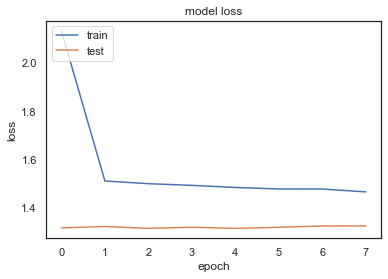

TEST WMSE =  1.428716301225254
TEST MEAN WMSE =  1.428716301225254
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 32.37510108947754


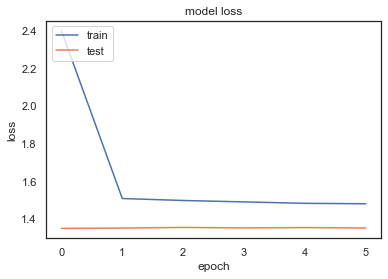

TEST WMSE =  1.3980496451957094
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 45.64693593978882


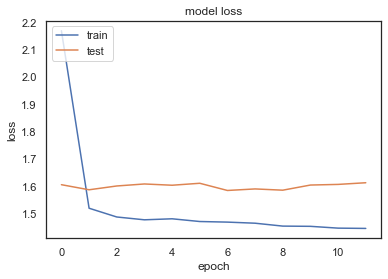

TEST WMSE =  1.4383463960791034
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 34.87384510040283


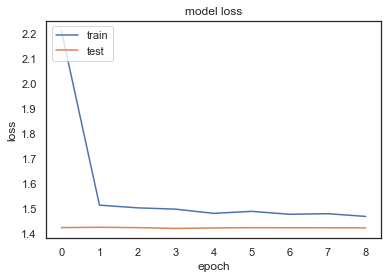

TEST WMSE =  1.3535356409673573
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 38.90156888961792


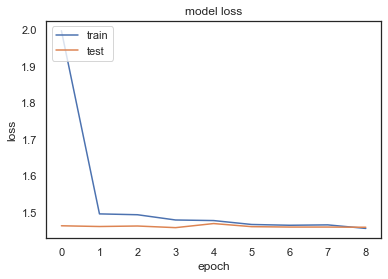

TEST WMSE =  1.4349648595243938
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 47.013060092926025


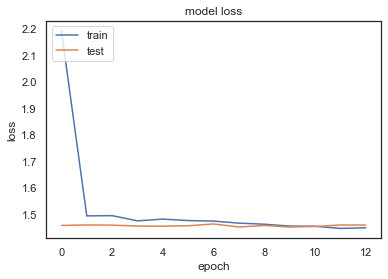

TEST WMSE =  1.441927481798868
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 53.59363317489624


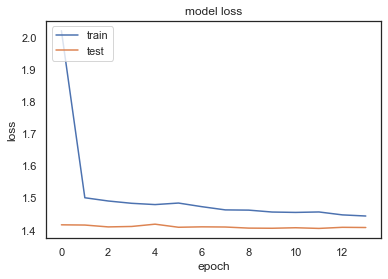

TEST WMSE =  1.3867916100726758
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 35.59862303733826


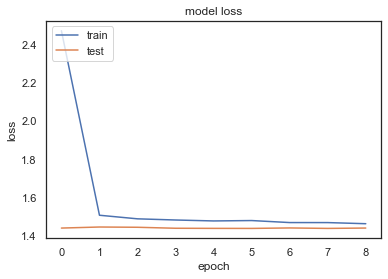

TEST WMSE =  1.426165488376314
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 49.02037715911865


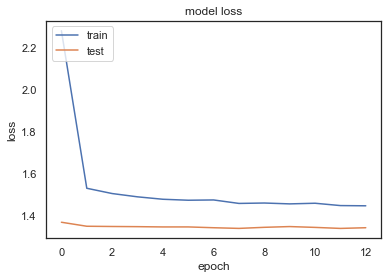

TEST WMSE =  1.4796458317367638
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 30.516080856323242


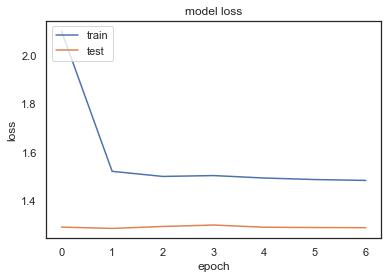

TEST WMSE =  1.3551798950613556
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00007: early stopping
duration: 31.54232096672058


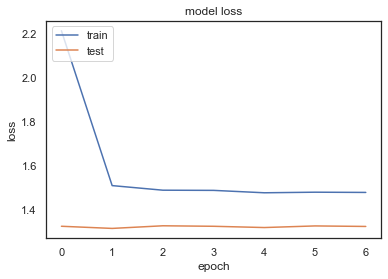

TEST WMSE =  1.4279481739647666
TEST MEAN WMSE =  1.4279481739647666


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 8
-----


-----
 FEATURE NAME -- start_coord
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 54.06570601463318


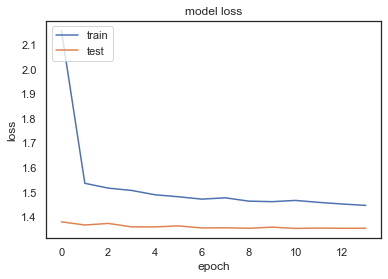

TEST WMSE =  1.3985809692324154
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 39.909647941589355


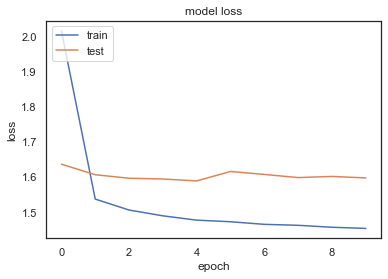

TEST WMSE =  1.4363019885861454
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 55.035709857940674


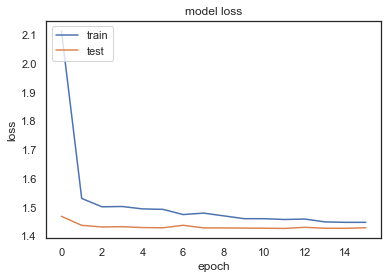

TEST WMSE =  1.3586120759705616
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 68.50863432884216


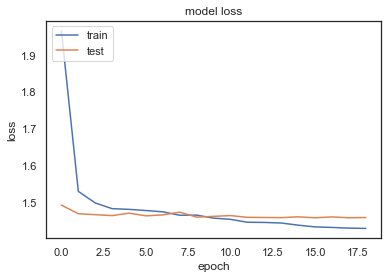

TEST WMSE =  1.4364439656289905
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 40.39362382888794


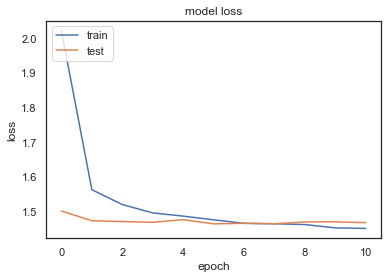

TEST WMSE =  1.444846153056534
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 57.45452690124512


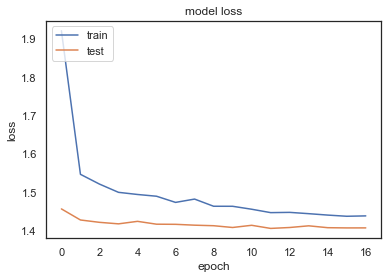

TEST WMSE =  1.3928133522211894
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.98647379875183


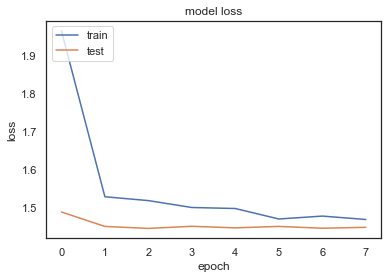

TEST WMSE =  1.4294479624957301
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 64.96614599227905


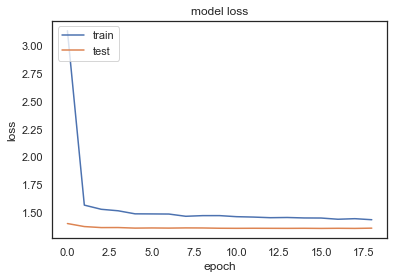

TEST WMSE =  1.4752230177798713
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 36.83793616294861


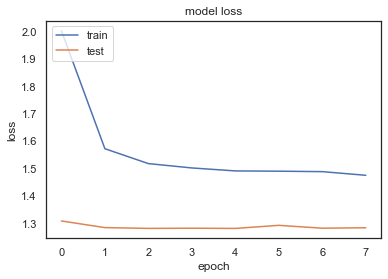

TEST WMSE =  1.3583151041686934
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 61.77008891105652


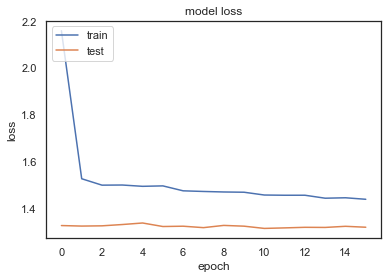

TEST WMSE =  1.428177909113061
TEST MEAN WMSE =  1.428177909113061
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 71.04218482971191


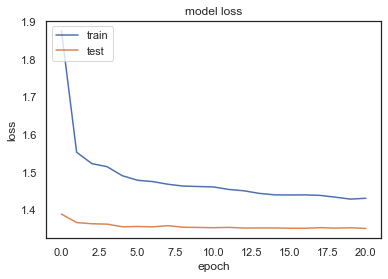

TEST WMSE =  1.395039118251705
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 52.931395053863525


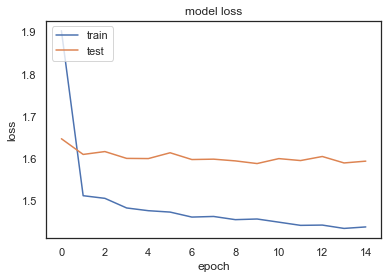

TEST WMSE =  1.4341547950938598
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 54.10706186294556


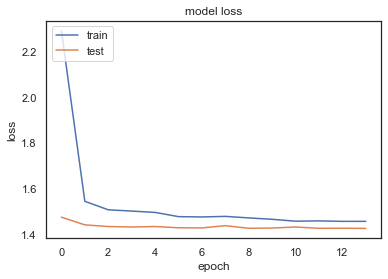

TEST WMSE =  1.3555478498790834
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.24601697921753


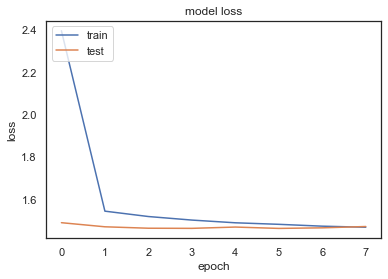

TEST WMSE =  1.4521392210678532
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 44.90360689163208


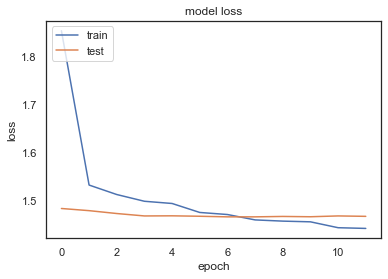

TEST WMSE =  1.4443500558065845
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 82.59143805503845


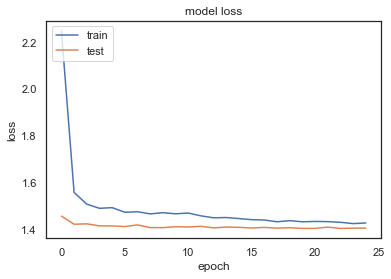

TEST WMSE =  1.3925967290232715
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 37.154906272888184


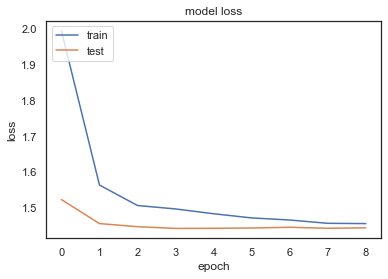

TEST WMSE =  1.4224828604460882
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 42.28977108001709


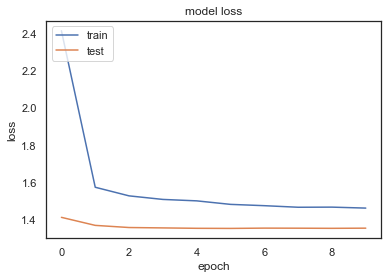

TEST WMSE =  1.4716909486528744
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 55.03732705116272


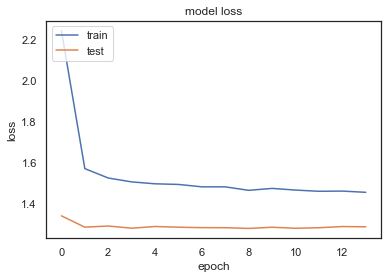

TEST WMSE =  1.3614596498429872
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 30.613645792007446


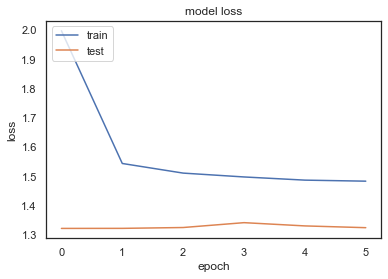

TEST WMSE =  1.429768387433712
TEST MEAN WMSE =  1.429768387433712
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 71.02194786071777


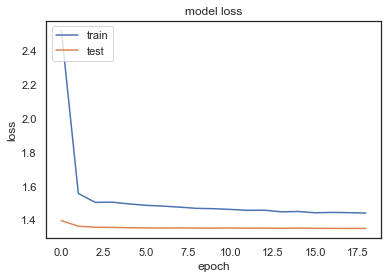

TEST WMSE =  1.395682007208524
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00011: early stopping
duration: 45.5600368976593


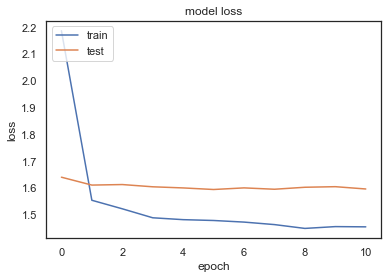

TEST WMSE =  1.4373167289619937
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 52.582841873168945


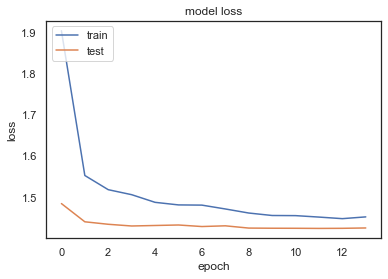

TEST WMSE =  1.3552131830990608
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 73.38957023620605


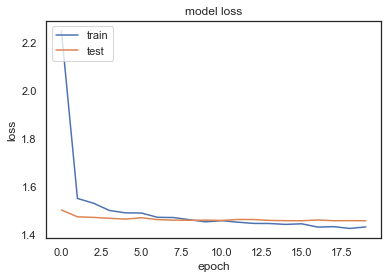

TEST WMSE =  1.4335394171246316
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 44.50888919830322


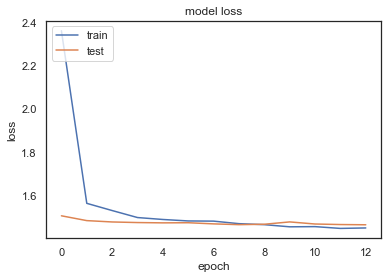

TEST WMSE =  1.443259418927215
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 70.75609111785889


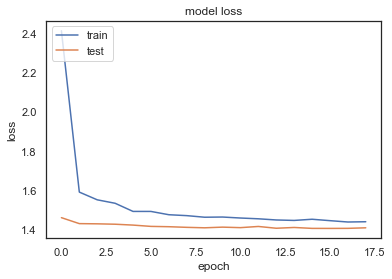

TEST WMSE =  1.394075745531319
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 38.76150989532471


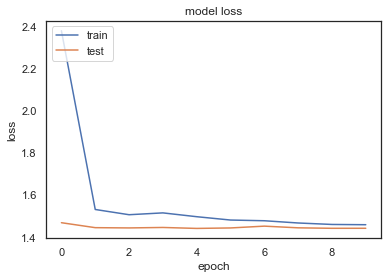

TEST WMSE =  1.4259823408438375
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00010: early stopping
duration: 39.61013984680176


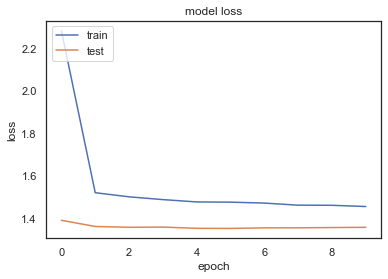

TEST WMSE =  1.4794447475522816
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 62.628968954086304


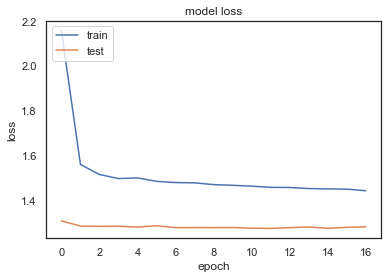

TEST WMSE =  1.3619238635515158
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 52.13417911529541


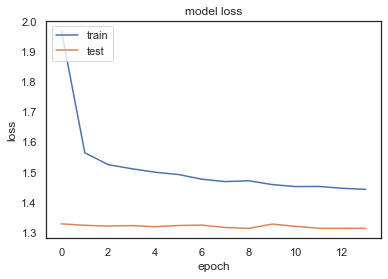

TEST WMSE =  1.4270775695555864
TEST MEAN WMSE =  1.4270775695555864


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 9
-----


-----
 FEATURE NAME -- Chriz
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 120.00878596305847


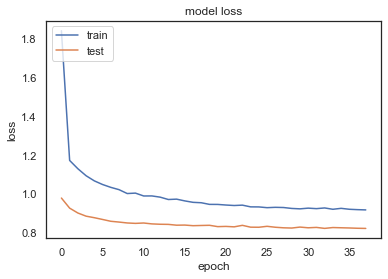

TEST WMSE =  0.8591965166182252
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 73.31022596359253


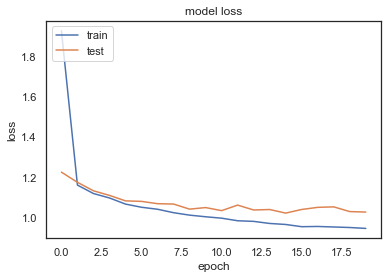

TEST WMSE =  0.8767770042559925
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 179.8592450618744


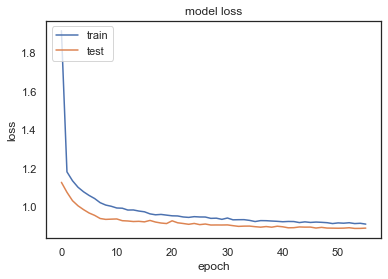

TEST WMSE =  0.8613685219349697
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 125.97029113769531


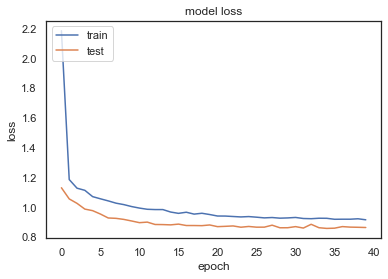

TEST WMSE =  0.8689518242150727
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 99.04731321334839


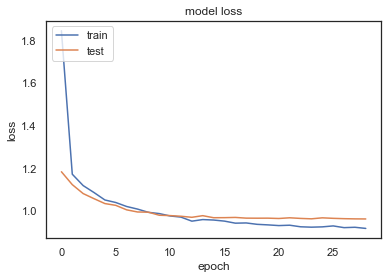

TEST WMSE =  0.9416846553255828
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 77.58221411705017


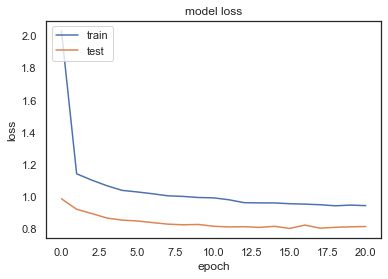

TEST WMSE =  0.9468641167370421
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 56.70063829421997


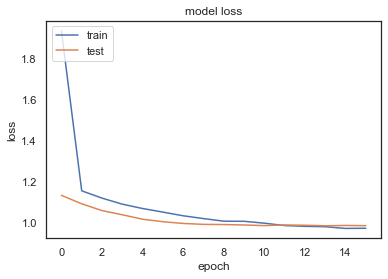

TEST WMSE =  0.9121163113626927
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 68.1168942451477


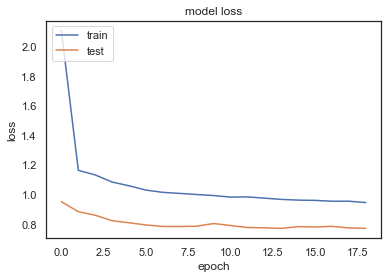

TEST WMSE =  0.932827184363153
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 129.9227888584137


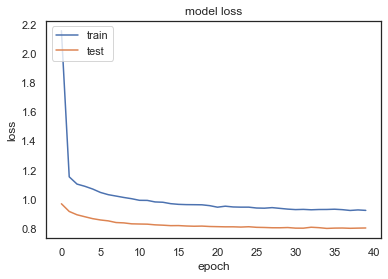

TEST WMSE =  0.8736848655543213
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 54.08074593544006


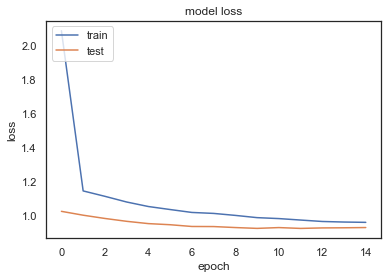

TEST WMSE =  0.9113035358147983
TEST MEAN WMSE =  0.9113035358147983
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 111.11826300621033


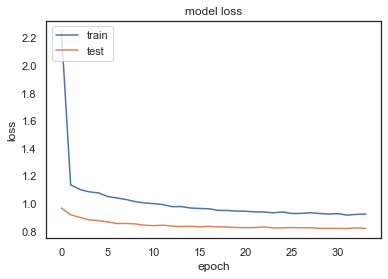

TEST WMSE =  0.8590118032086367
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 57.836742877960205


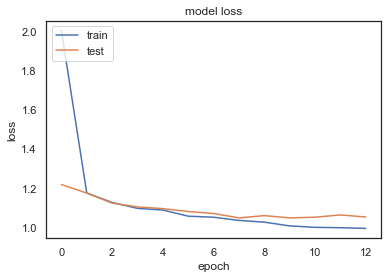

TEST WMSE =  0.897241471996137
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 143.36974382400513


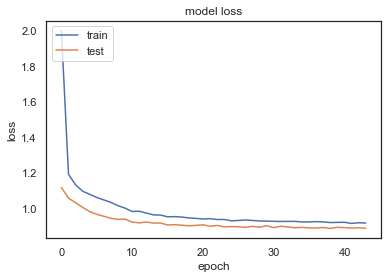

TEST WMSE =  0.8636317809018845
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 98.23265790939331


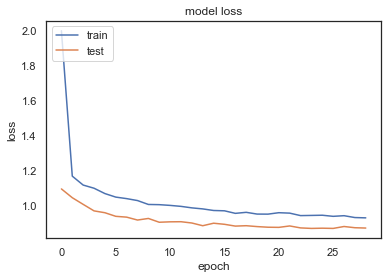

TEST WMSE =  0.8748989088279774
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 132.83116698265076


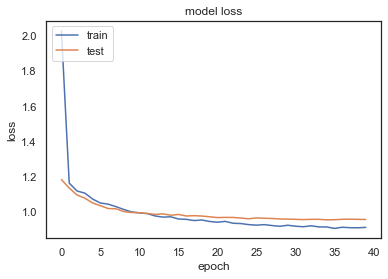

TEST WMSE =  0.9279787502248967
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 87.8650860786438


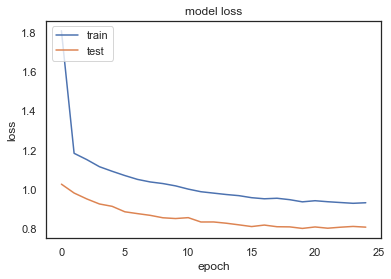

TEST WMSE =  0.9435559288354395
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 78.79751801490784


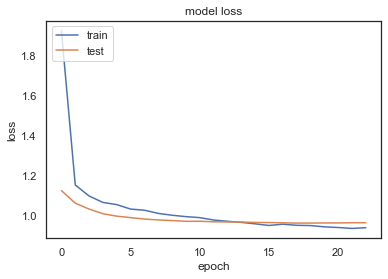

TEST WMSE =  0.8922045983666524
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 82.11560702323914


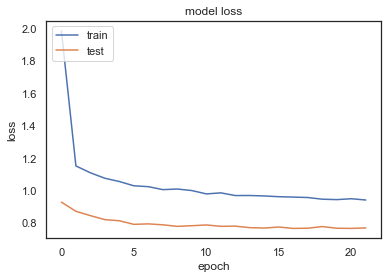

TEST WMSE =  0.9298135466129576
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 113.23772478103638


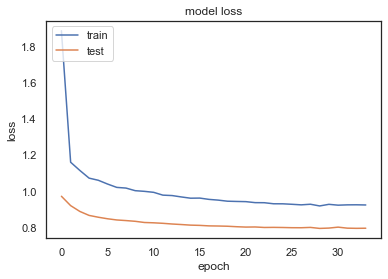

TEST WMSE =  0.8679367742783726
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 59.82911705970764


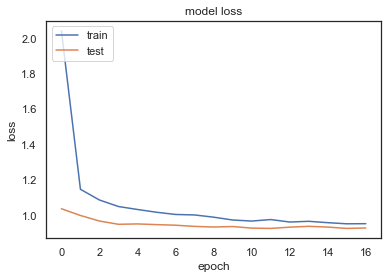

TEST WMSE =  0.9094708494381554
TEST MEAN WMSE =  0.9094708494381554
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 110.48868608474731


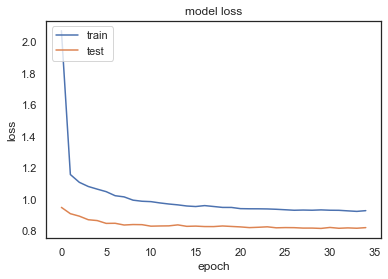

TEST WMSE =  0.8619514869352578
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 76.14049625396729


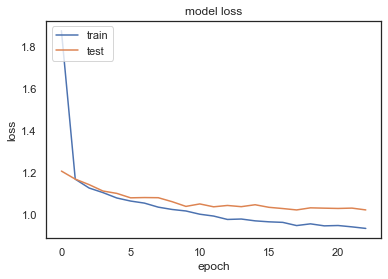

TEST WMSE =  0.8699996934259098
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 75.14342379570007


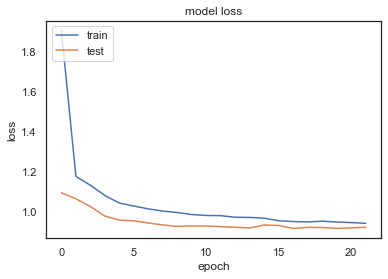

TEST WMSE =  0.8758186921572012
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 78.5682327747345


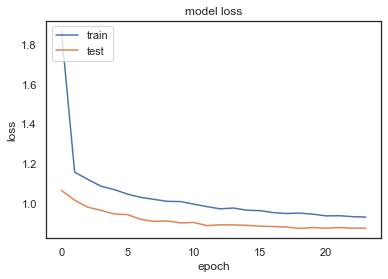

TEST WMSE =  0.8796857284852951
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 73.76404094696045


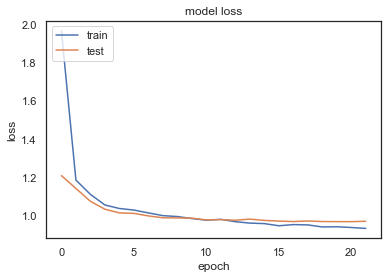

TEST WMSE =  0.9544585457753989
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 106.68873310089111


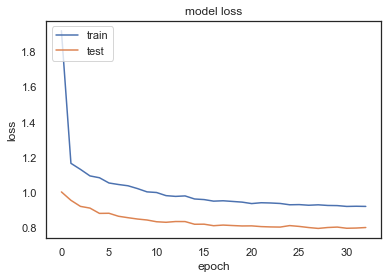

TEST WMSE =  0.9366155044085006
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 149.23362159729004


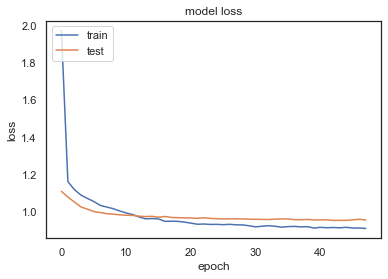

TEST WMSE =  0.884938993371657
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 44.38819980621338


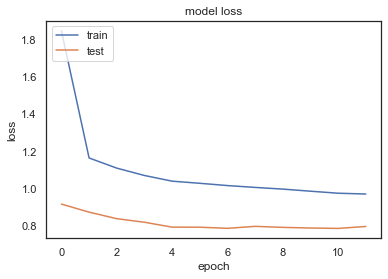

TEST WMSE =  0.9491463827480675
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 84.53994488716125


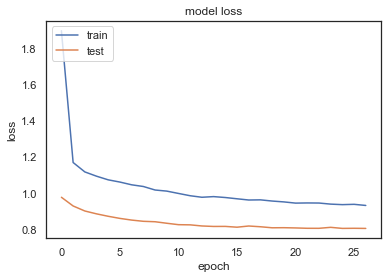

TEST WMSE =  0.883814965983549
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 55.09430480003357


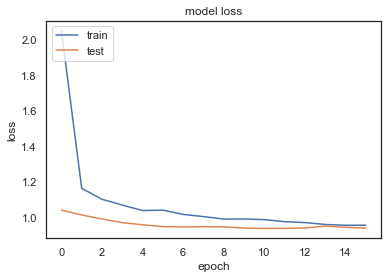

TEST WMSE =  0.9091523559092881
TEST MEAN WMSE =  0.9091523559092881


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 10
-----


-----
 FEATURE NAME -- CTCF
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 150.89186716079712


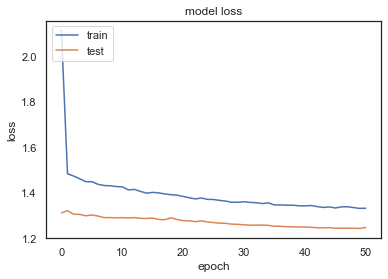

TEST WMSE =  1.2668247973968665
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 123.8494861125946


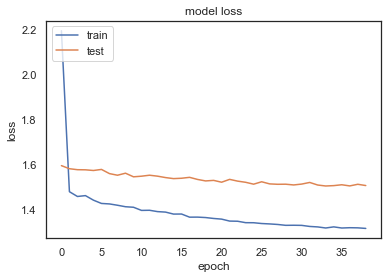

TEST WMSE =  1.3476976474504732
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 149.97371792793274


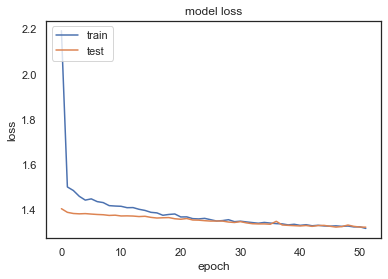

TEST WMSE =  1.2985084265807918
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 118.9145188331604


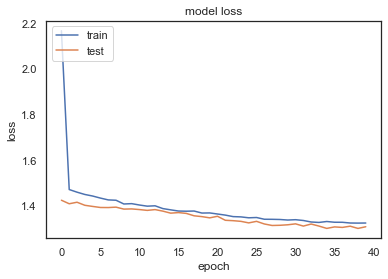

TEST WMSE =  1.3621398516891032
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 119.16240501403809


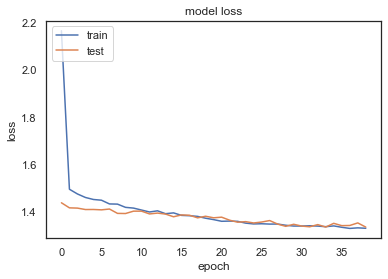

TEST WMSE =  1.3631589576034733
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 122.43810510635376


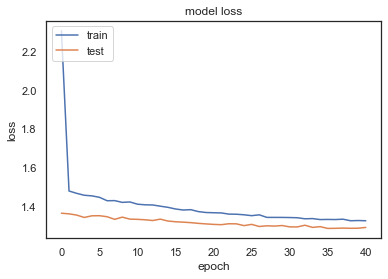

TEST WMSE =  1.3007900979214289
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 176.05457997322083


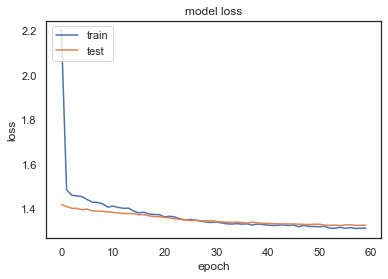

TEST WMSE =  1.2804663181732758
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 175.1216368675232


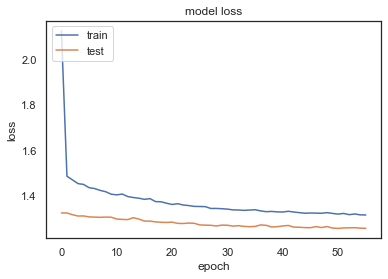

TEST WMSE =  1.3661162823957702
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 158.62015581130981


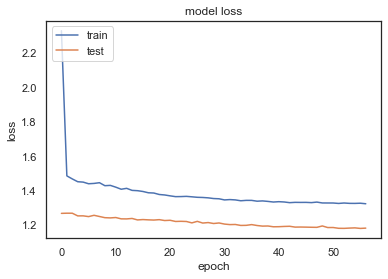

TEST WMSE =  1.2513396128100076
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 32.70786190032959


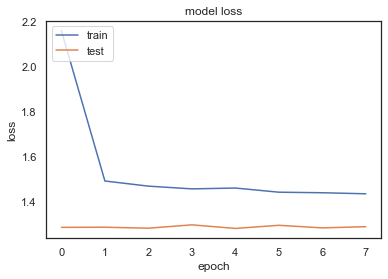

TEST WMSE =  1.3876767597560695
TEST MEAN WMSE =  1.3876767597560695
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 166.29948902130127


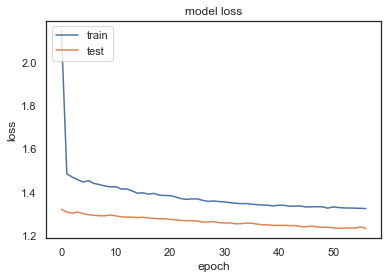

TEST WMSE =  1.2397814289656308
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 131.07568883895874


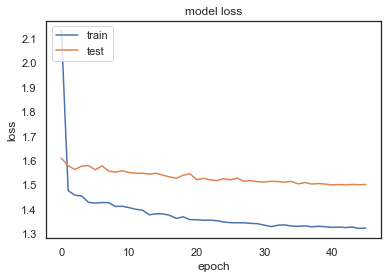

TEST WMSE =  1.3650866314828551
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 151.01869893074036


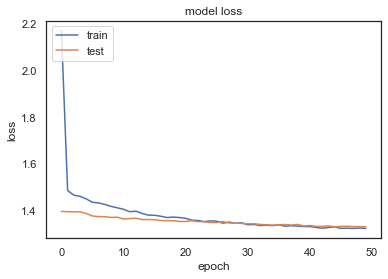

TEST WMSE =  1.2927290477057614
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 125.5162570476532


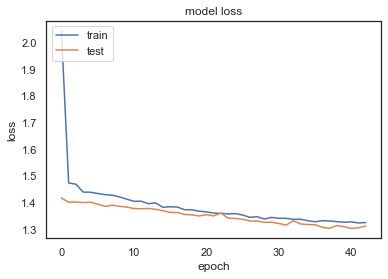

TEST WMSE =  1.3660847837609797
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 114.96587610244751


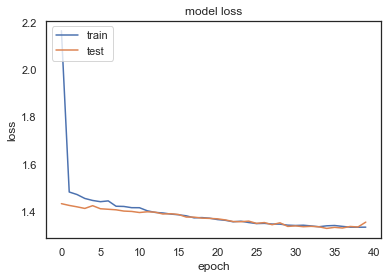

TEST WMSE =  1.3785669899261856
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 97.34277296066284


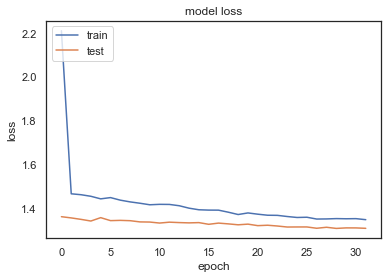

TEST WMSE =  1.3144385083667807
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 175.10770893096924


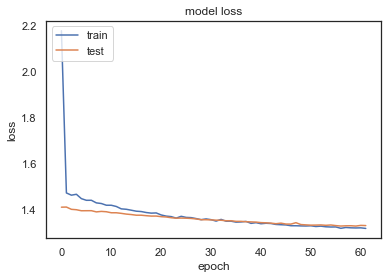

TEST WMSE =  1.291578006666741
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 98.66445398330688


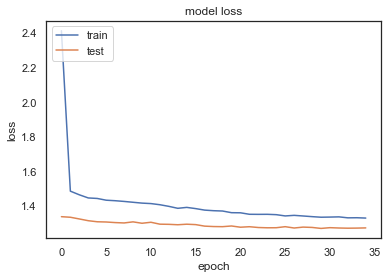

TEST WMSE =  1.38961442466121
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 2691.615147829056


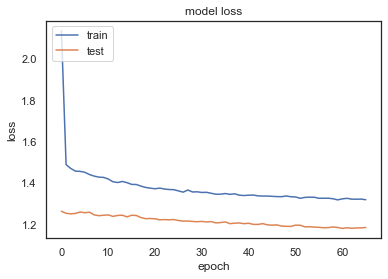

TEST WMSE =  1.2446887766745904
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 28.438476085662842


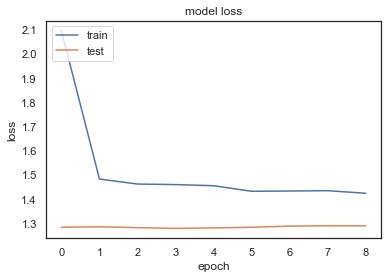

TEST WMSE =  1.3867494242622724
TEST MEAN WMSE =  1.3867494242622724
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 103.67406272888184


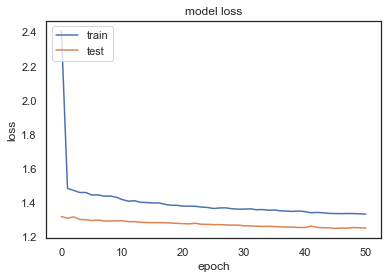

TEST WMSE =  1.259917881207625
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 28.59163188934326


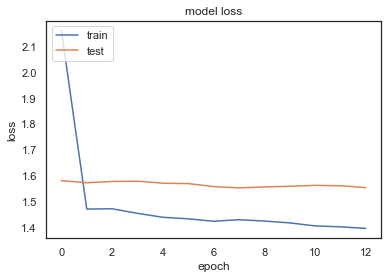

TEST WMSE =  1.397202890791259
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 122.55279278755188


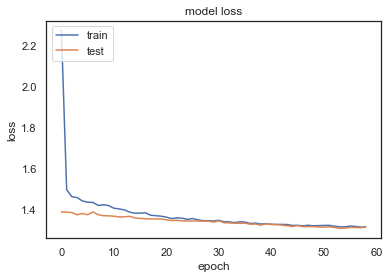

TEST WMSE =  1.278350536786806
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 61.12868905067444


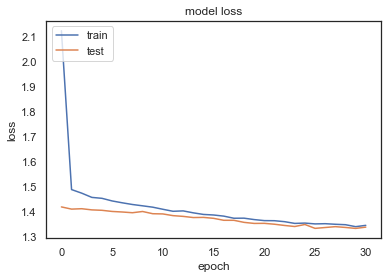

TEST WMSE =  1.3745446537301875
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 69.84760022163391


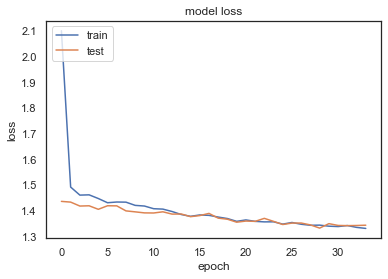

TEST WMSE =  1.3750986158573228
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 442.37570691108704


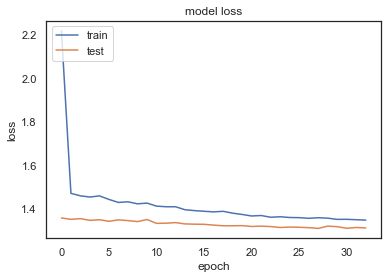

TEST WMSE =  1.319165328574176
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 139.38600897789001


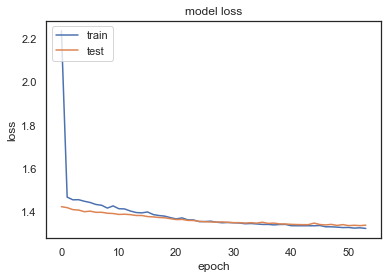

TEST WMSE =  1.2982638104854545
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 141.3907928466797


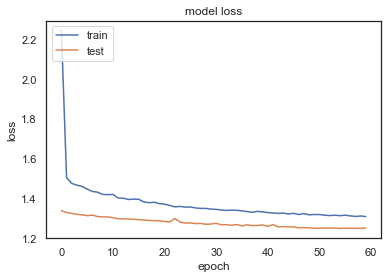

TEST WMSE =  1.3660755562470692
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 162.84927606582642


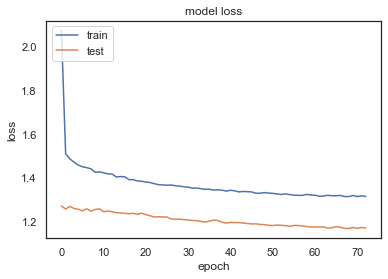

TEST WMSE =  1.238969264767815
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 25.19025683403015


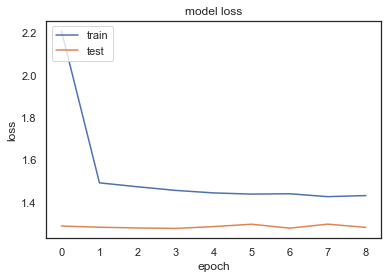

TEST WMSE =  1.3826866863074594
TEST MEAN WMSE =  1.3826866863074594


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 11
-----


-----
 FEATURE NAME -- Su(Hw)
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 55.01519799232483


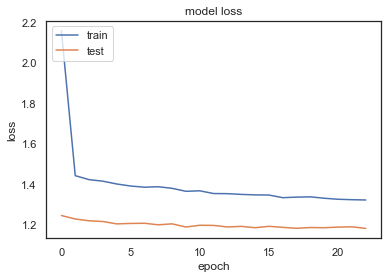

TEST WMSE =  1.2904230545421318
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 48.24211096763611


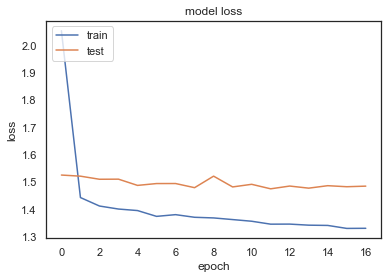

TEST WMSE =  1.3404993038508206
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 51.9363009929657


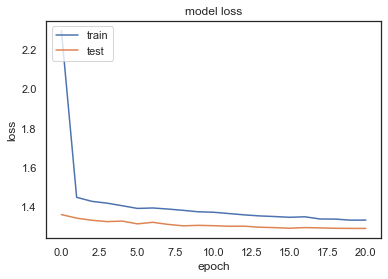

TEST WMSE =  1.2413544493480337
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 60.63523983955383


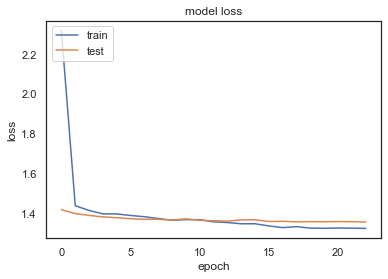

TEST WMSE =  1.313670952996118
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 56.96678876876831


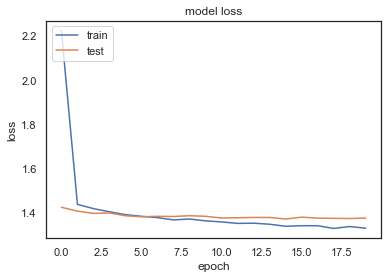

TEST WMSE =  1.351175420886479
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 47.254456758499146


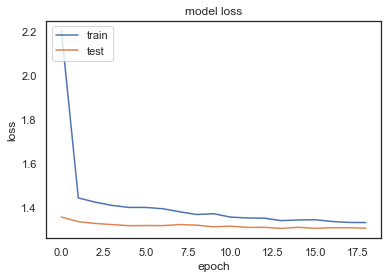

TEST WMSE =  1.3070214725587597
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 63.428518295288086


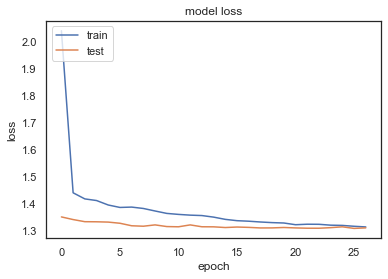

TEST WMSE =  1.3255830667793236
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 55.57915282249451


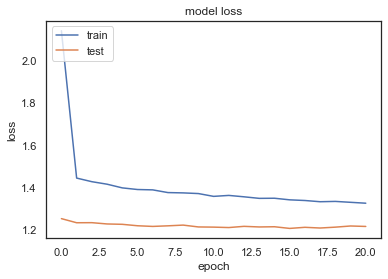

TEST WMSE =  1.3568197916451252
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00014: early stopping
duration: 34.67823004722595


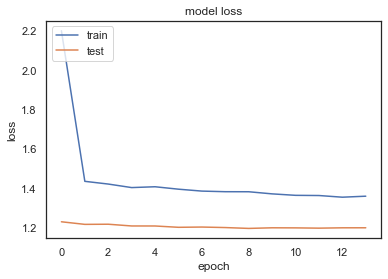

TEST WMSE =  1.2351637831178595
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 42.002838134765625


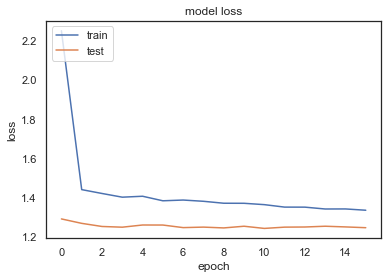

TEST WMSE =  1.299831182144199
TEST MEAN WMSE =  1.299831182144199
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 40.56806206703186


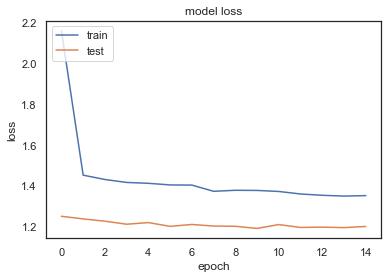

TEST WMSE =  1.3067623899315004
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 41.669044971466064


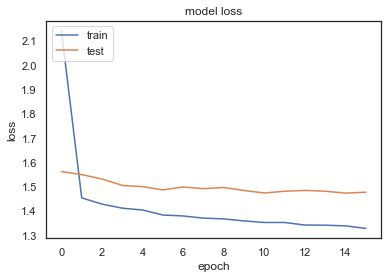

TEST WMSE =  1.3388159729988647
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 79.4595718383789


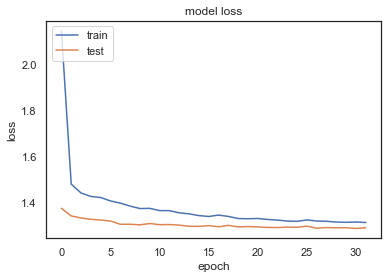

TEST WMSE =  1.2332237659649572
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 46.0714852809906


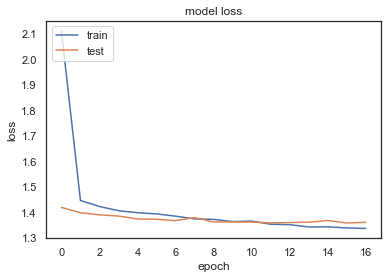

TEST WMSE =  1.323219119925252
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 52.186577796936035


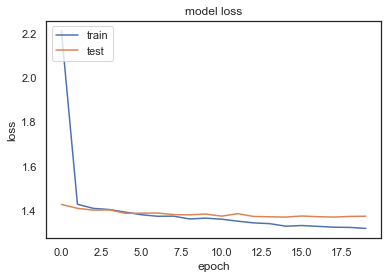

TEST WMSE =  1.348053206642286
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 45.3472638130188


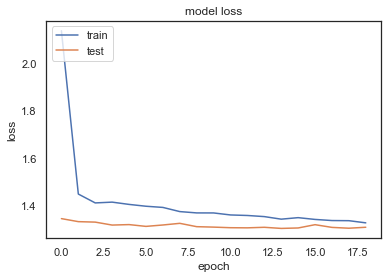

TEST WMSE =  1.3088472401658005
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 71.20829582214355


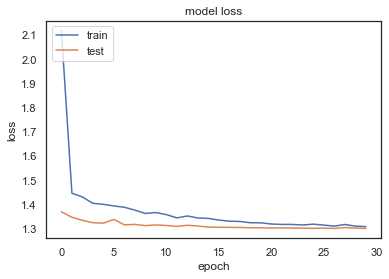

TEST WMSE =  1.3247269407377098
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 40.59654498100281


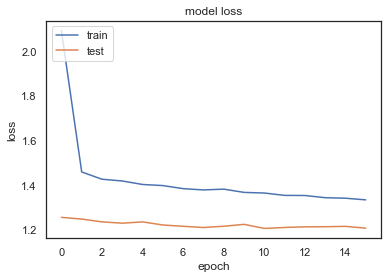

TEST WMSE =  1.3548784847702722
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 52.72002911567688


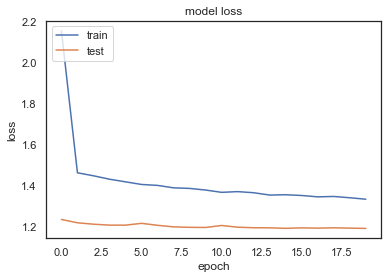

TEST WMSE =  1.228806463816761
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 46.55341696739197


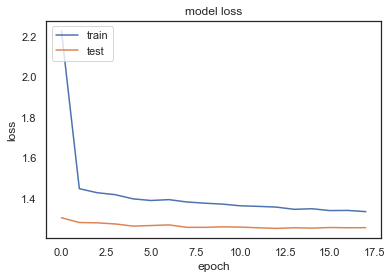

TEST WMSE =  1.3030851736460092
TEST MEAN WMSE =  1.3030851736460092
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 40.55225491523743


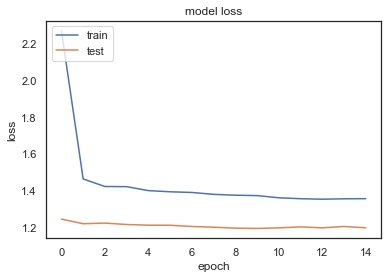

TEST WMSE =  1.298461731077033
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 37.422964096069336


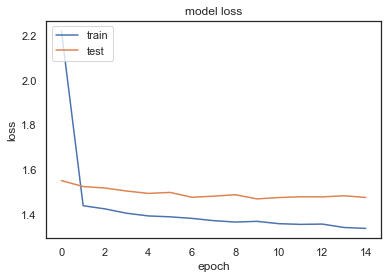

TEST WMSE =  1.3386365751269544
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 77.1321189403534


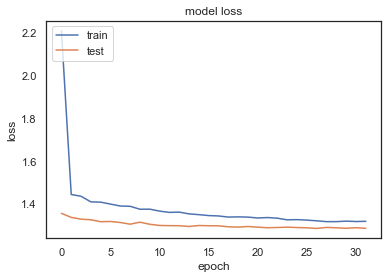

TEST WMSE =  1.2362510718846027
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 57.55590319633484


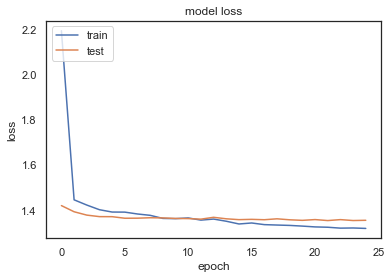

TEST WMSE =  1.3173627859684254
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 51.622910022735596


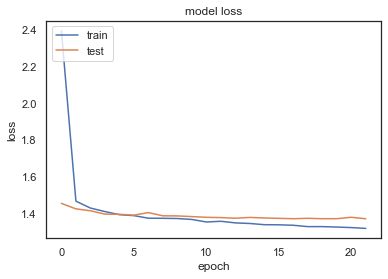

TEST WMSE =  1.3510909207539783
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 41.08253598213196


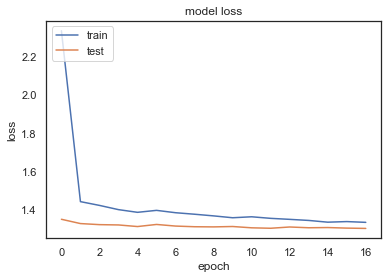

TEST WMSE =  1.3076119137622084
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 57.81015586853027


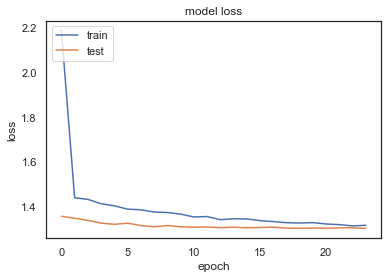

TEST WMSE =  1.3272399003622588
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 29.720781087875366


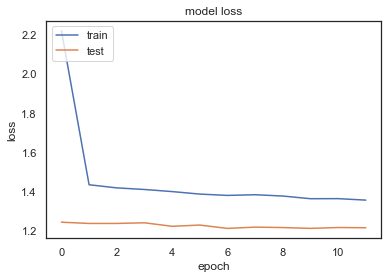

TEST WMSE =  1.357234920087497
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 43.839759826660156


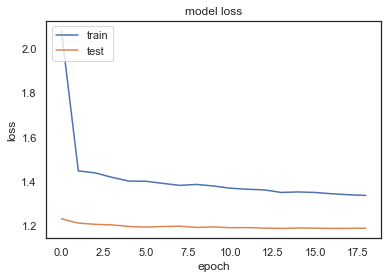

TEST WMSE =  1.2293901829385827
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 37.48486590385437


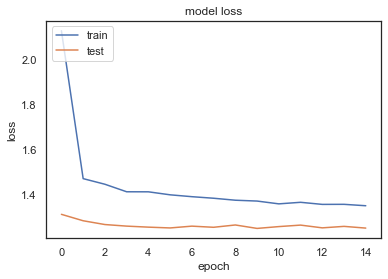

TEST WMSE =  1.3047047986911362
TEST MEAN WMSE =  1.3047047986911362


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 12
-----


-----
 FEATURE NAME -- BEAF-32
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 50.7477240562439


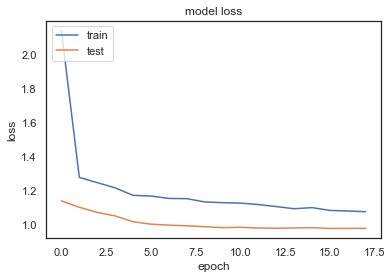

TEST WMSE =  1.0416286372299992
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 105.29226016998291


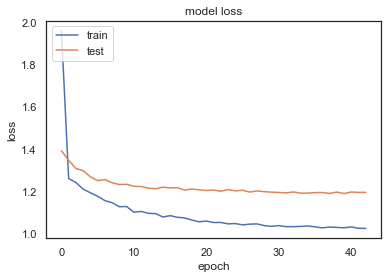

TEST WMSE =  1.0005975246312784
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 134.22057390213013


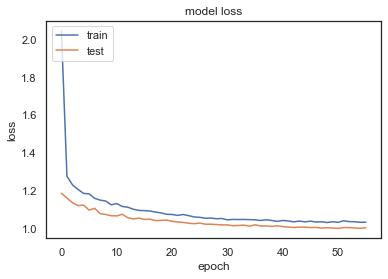

TEST WMSE =  0.9589583696946072
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 113.23117399215698


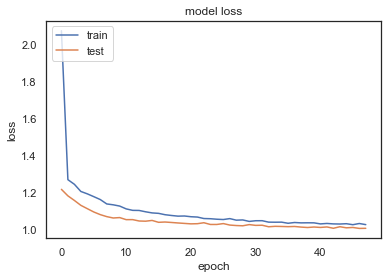

TEST WMSE =  0.9951573336826656
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 111.12545680999756


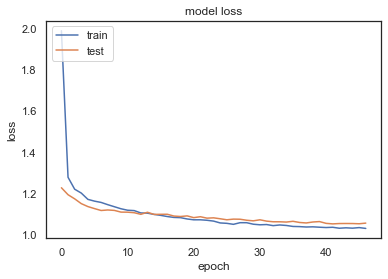

TEST WMSE =  1.0312338949489286
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 70.33082509040833


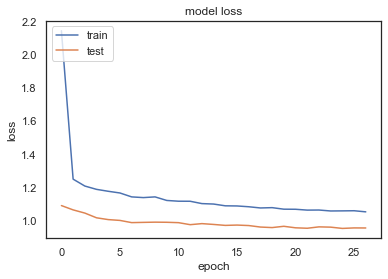

TEST WMSE =  1.0685783652593515
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 91.67768502235413


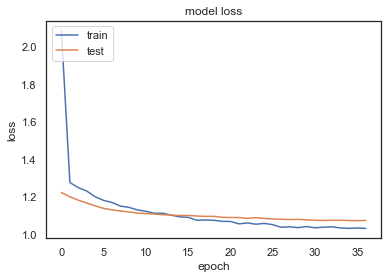

TEST WMSE =  1.0122849042803044
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 64.30800938606262


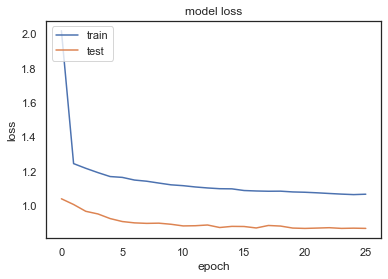

TEST WMSE =  1.0830058304047345
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 55.11587619781494


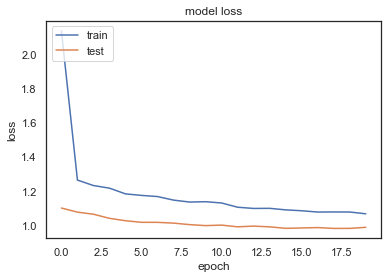

TEST WMSE =  0.9868810135591626
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 85.32033610343933


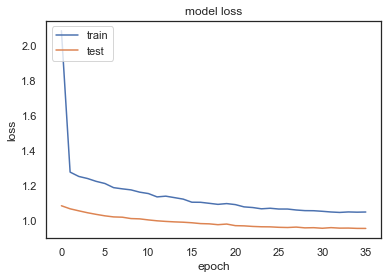

TEST WMSE =  1.0252351799236967
TEST MEAN WMSE =  1.0252351799236967
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 86.89805006980896


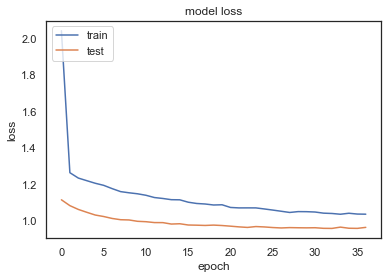

TEST WMSE =  1.0308968776083198
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 114.48449301719666


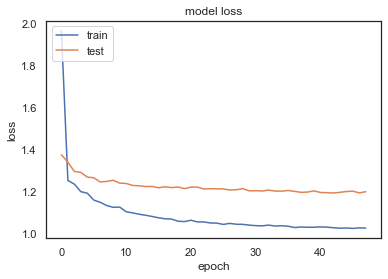

TEST WMSE =  0.9882825702764882
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 108.2358570098877


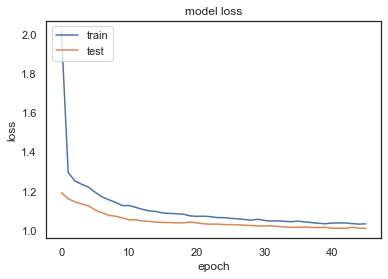

TEST WMSE =  0.9638119906286426
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 69.59780406951904


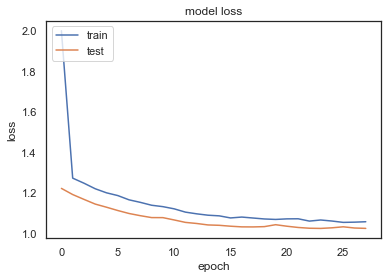

TEST WMSE =  1.0144811778963325
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 83.57214283943176


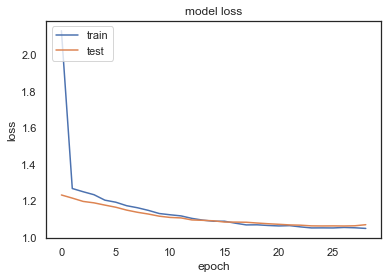

TEST WMSE =  1.0460878900802635
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 116.2694902420044


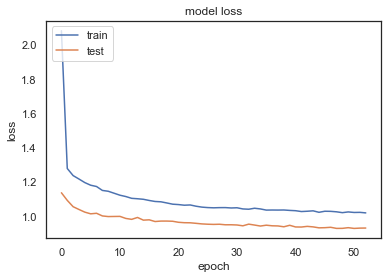

TEST WMSE =  1.0367503763865966
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 116.80989599227905


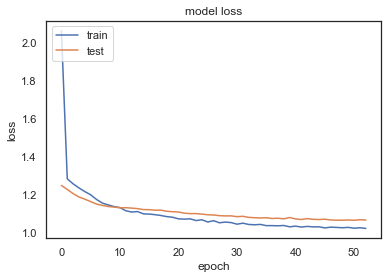

TEST WMSE =  1.0124909181731723
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 105.82711291313171


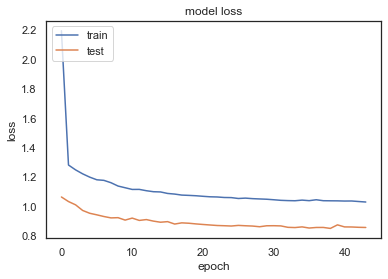

TEST WMSE =  1.0573500966146432
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 68.19443607330322


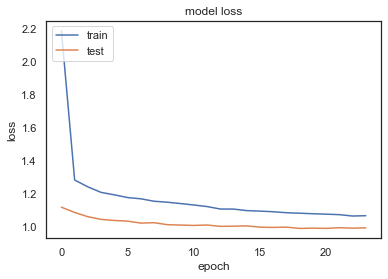

TEST WMSE =  0.9868702083732059
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 97.16241097450256


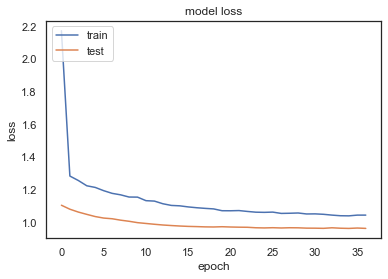

TEST WMSE =  1.026229485534237
TEST MEAN WMSE =  1.026229485534237
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 67.35855007171631


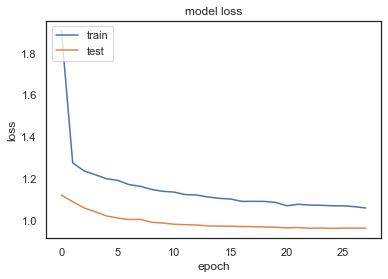

TEST WMSE =  1.0432743516582101
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 83.59615397453308


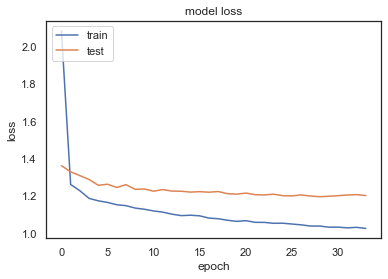

TEST WMSE =  0.9951019873001379
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 154.04760193824768


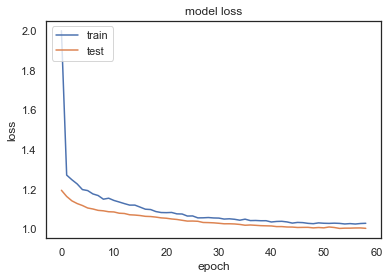

TEST WMSE =  0.9617241383514016
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 120.57648515701294


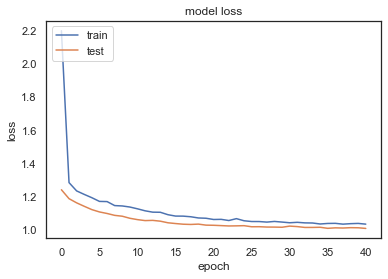

TEST WMSE =  0.997081633084342
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 123.81104898452759


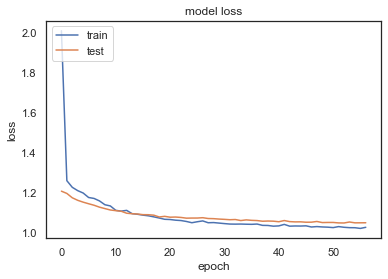

TEST WMSE =  1.025861872920992
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 97.90391397476196


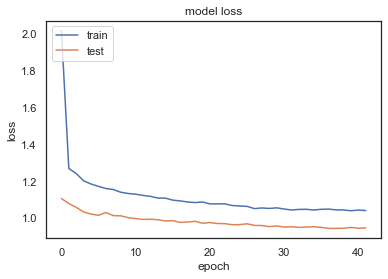

TEST WMSE =  1.0548072516158757
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 95.5908453464508


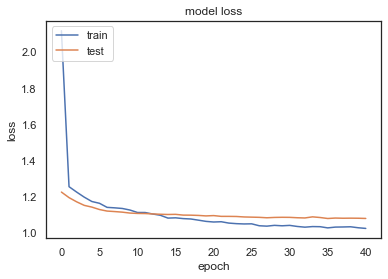

TEST WMSE =  1.007067002721309
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 101.69636106491089


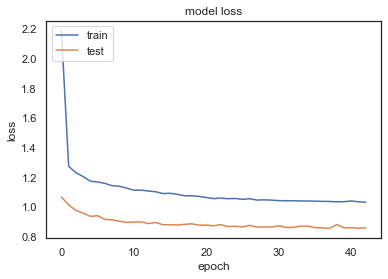

TEST WMSE =  1.0601219863816627
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 121.16561269760132


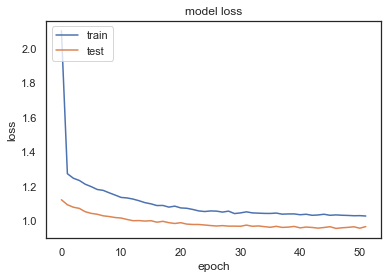

TEST WMSE =  0.9599825089353146
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 118.97855591773987


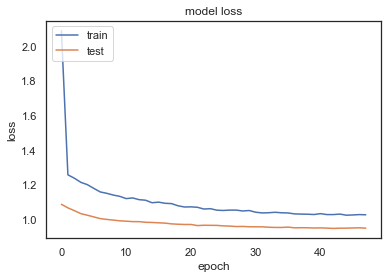

TEST WMSE =  1.011018697788075
TEST MEAN WMSE =  1.011018697788075


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 13
-----


-----
 FEATURE NAME -- CP190
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 131.60833287239075


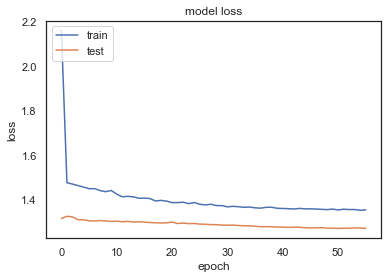

TEST WMSE =  1.3261254145778383
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 47.72665071487427


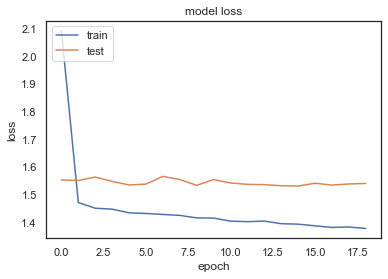

TEST WMSE =  1.3928789600584073
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 74.3186731338501


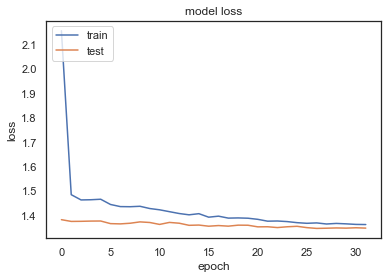

TEST WMSE =  1.2977944474418435
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00115: early stopping
duration: 255.81621599197388


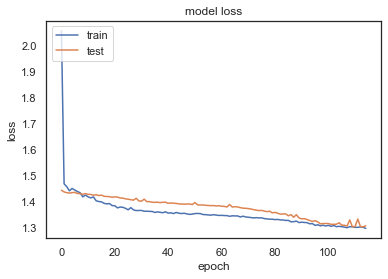

TEST WMSE =  1.3134675751703067
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00117: early stopping
duration: 260.74508786201477


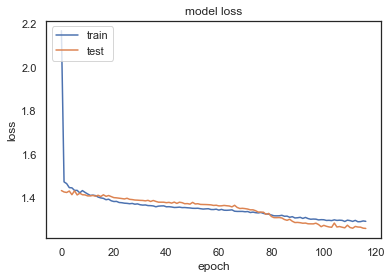

TEST WMSE =  1.3103307059581033
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00090: early stopping
duration: 204.27006793022156


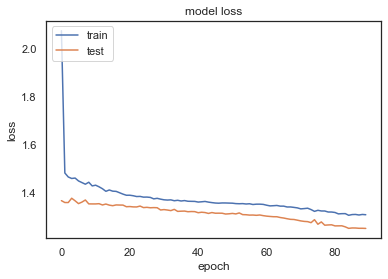

TEST WMSE =  1.280548607603906
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 51.52900004386902


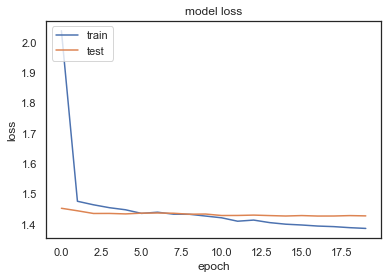

TEST WMSE =  1.3612285990429358
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 81.64599084854126


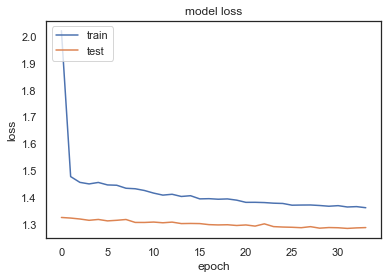

TEST WMSE =  1.4110379168315335
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 46.62302303314209


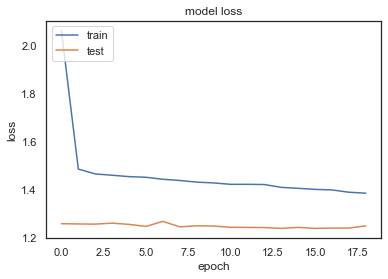

TEST WMSE =  1.3189613069708568
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 74.62545824050903


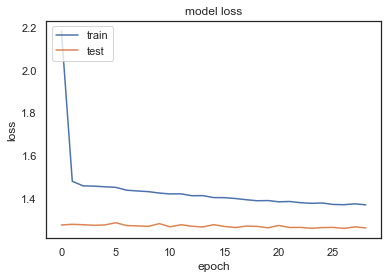

TEST WMSE =  1.3617017140501366
TEST MEAN WMSE =  1.3617017140501366
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 101.77127981185913


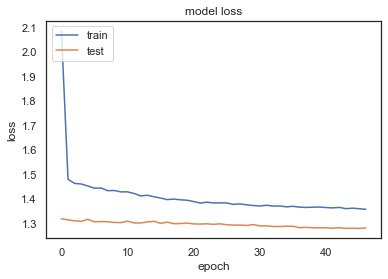

TEST WMSE =  1.3340160624601827
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 32.98136806488037


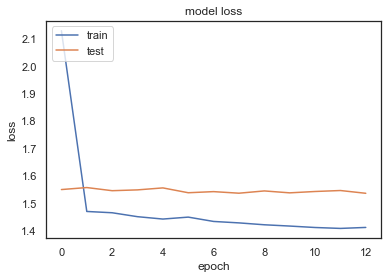

TEST WMSE =  1.4032422935006077
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00008: early stopping
duration: 23.67438507080078


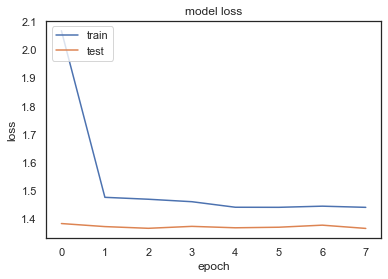

TEST WMSE =  1.3226705896489248
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00097: early stopping
duration: 216.17285990715027


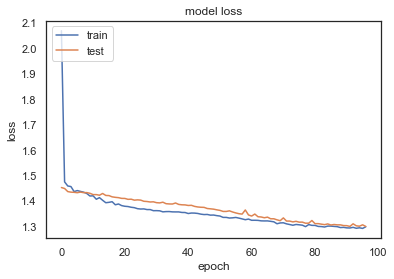

TEST WMSE =  1.3067373323486906
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 31.810492038726807


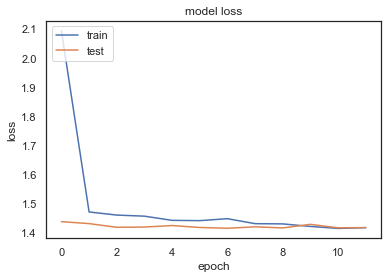

TEST WMSE =  1.4112035101876577
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 103.43066477775574


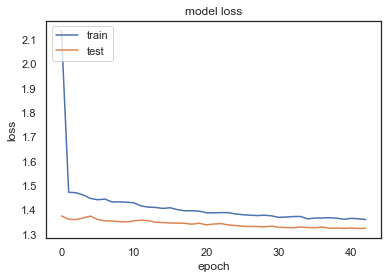

TEST WMSE =  1.3371752663084822
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 85.94921112060547


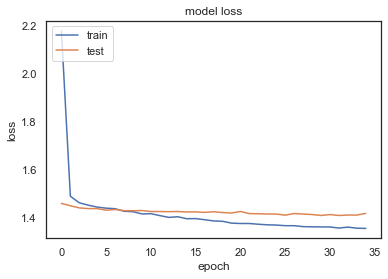

TEST WMSE =  1.3492227929220508
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 48.139607191085815


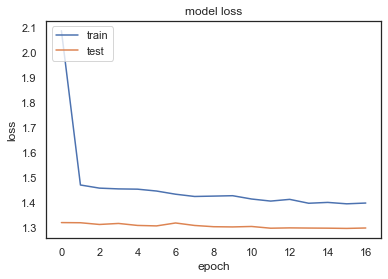

TEST WMSE =  1.42366355327734
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 48.22898721694946


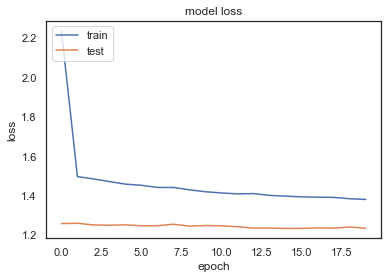

TEST WMSE =  1.3115981962839103
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 33.730767011642456


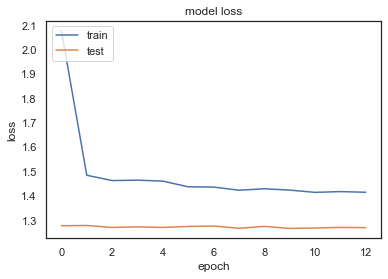

TEST WMSE =  1.3766087738176087
TEST MEAN WMSE =  1.3766087738176087
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 129.78520393371582


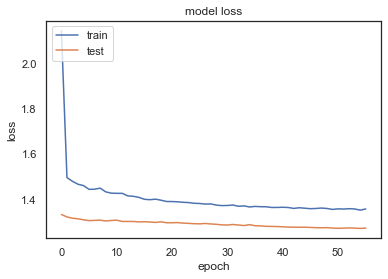

TEST WMSE =  1.3210396257317003
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 46.049741983413696


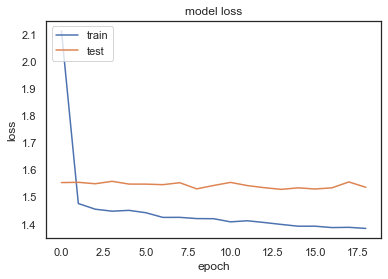

TEST WMSE =  1.40054827100777
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 33.78164601325989


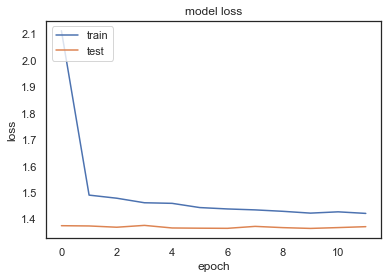

TEST WMSE =  1.3304005219555295
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00082: early stopping
duration: 177.71346998214722


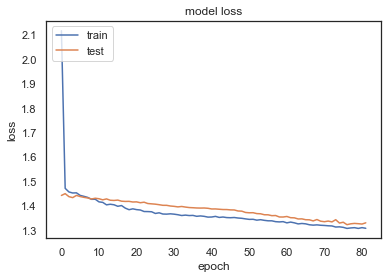

TEST WMSE =  1.3240304198010735
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00009: early stopping
duration: 27.322194814682007


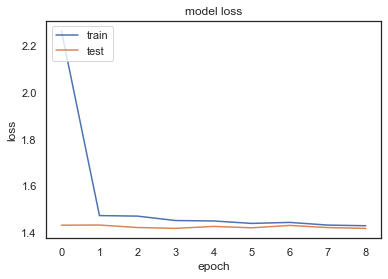

TEST WMSE =  1.4154561228807245
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00084: early stopping
duration: 186.02141976356506


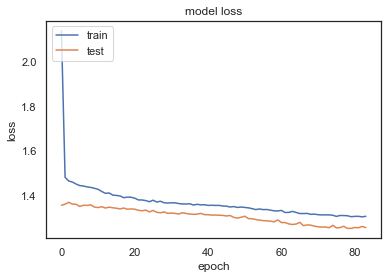

TEST WMSE =  1.2832485925440278
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 86.13932991027832


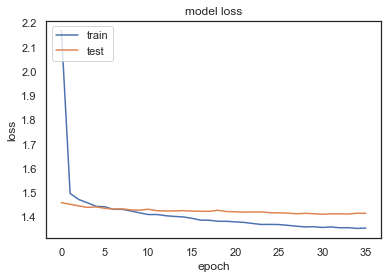

TEST WMSE =  1.350553167091788
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 93.678631067276


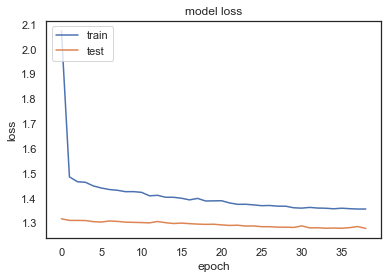

TEST WMSE =  1.4006202234710565
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00006: early stopping
duration: 18.37262201309204


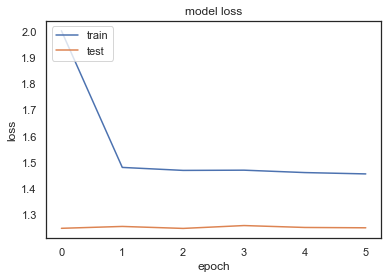

TEST WMSE =  1.3316698890255216
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 31.00301694869995


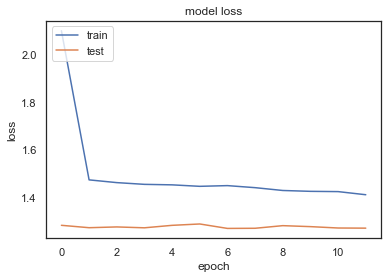

TEST WMSE =  1.3801486747147609
TEST MEAN WMSE =  1.3801486747147609


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 14
-----


-----
 FEATURE NAME -- GAF
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00064: early stopping
duration: 140.47373604774475


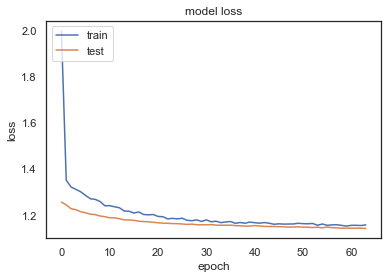

TEST WMSE =  1.0956389590830133
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 60.765976905822754


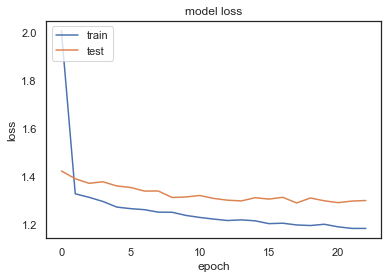

TEST WMSE =  1.1806186921585295
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 112.4881238937378


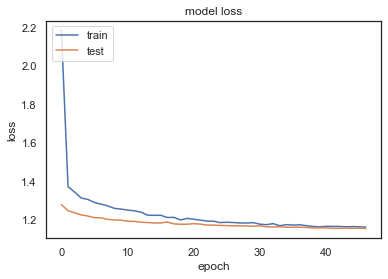

TEST WMSE =  1.1160087576614133
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 63.11905908584595


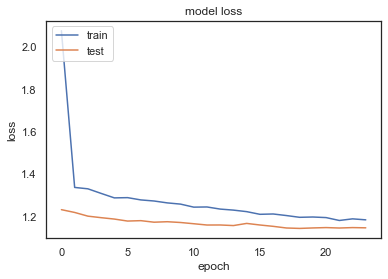

TEST WMSE =  1.1722879408315547
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00067: early stopping
duration: 154.21143698692322


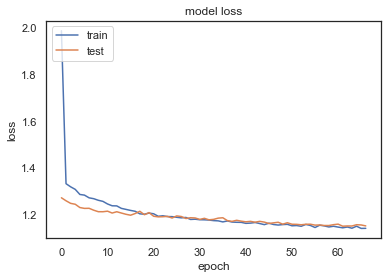

TEST WMSE =  1.168705912482668
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 71.42822504043579


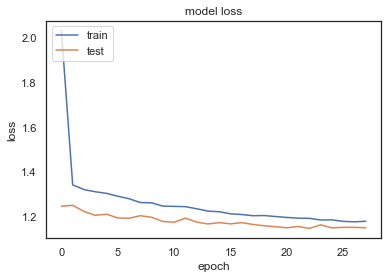

TEST WMSE =  1.1892469239595476
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 94.30465793609619


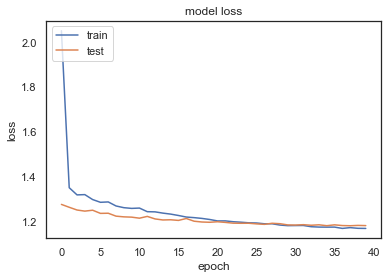

TEST WMSE =  1.1648700167134938
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 104.69039011001587


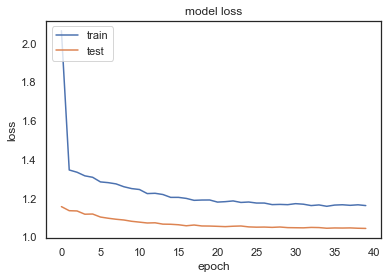

TEST WMSE =  1.2045347949718839
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 77.26710081100464


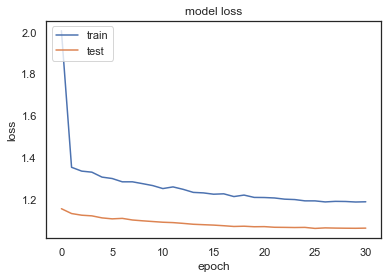

TEST WMSE =  1.0944559116331085
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 117.83937001228333


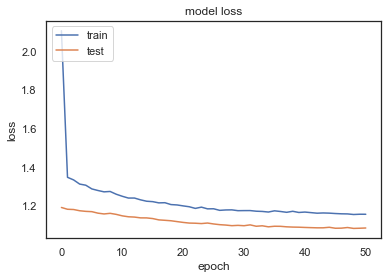

TEST WMSE =  1.155040260763646
TEST MEAN WMSE =  1.155040260763646
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 149.70310592651367


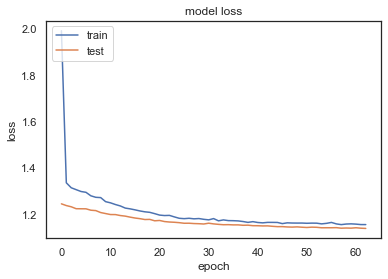

TEST WMSE =  1.085485828588448
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 82.14726996421814


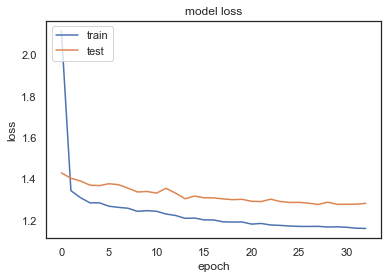

TEST WMSE =  1.1632701754885135
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00080: early stopping
duration: 190.15917897224426


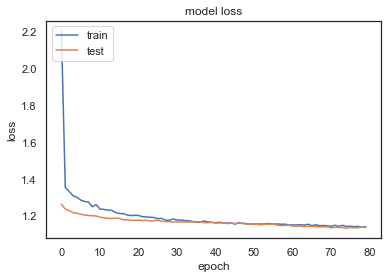

TEST WMSE =  1.0990903329334167
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 57.97103714942932


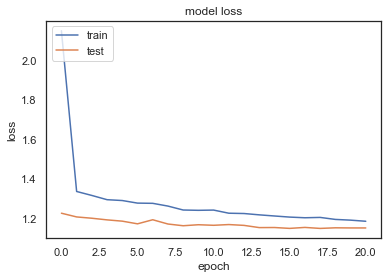

TEST WMSE =  1.1828527701437193
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 56.736682653427124


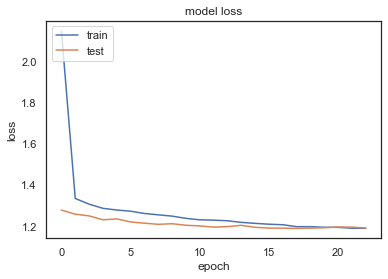

TEST WMSE =  1.2117918200404136
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 103.0515468120575


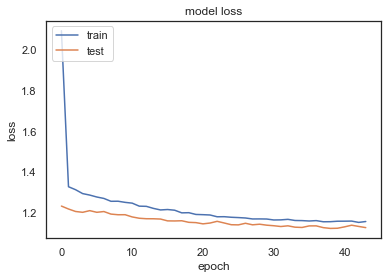

TEST WMSE =  1.1714053166724974
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 106.95119118690491


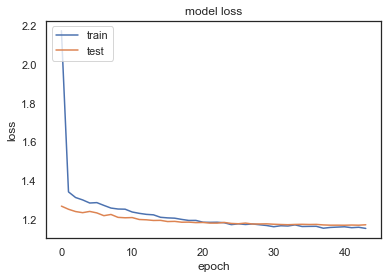

TEST WMSE =  1.1505478782581182
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 107.2157199382782


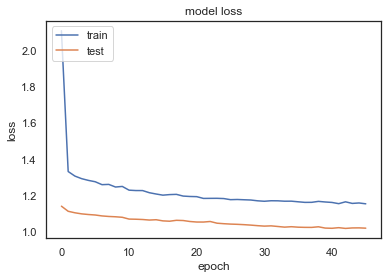

TEST WMSE =  1.204261688270523
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00060: early stopping
duration: 144.94113206863403


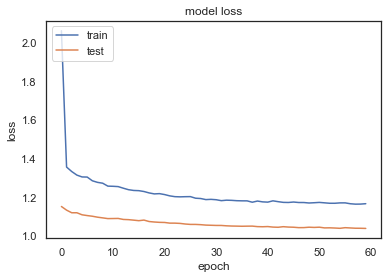

TEST WMSE =  1.0763209496335213
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 81.46321034431458


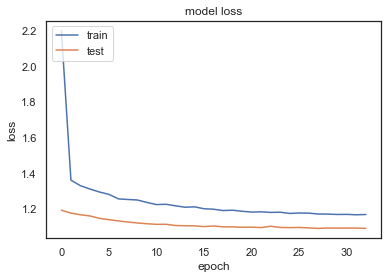

TEST WMSE =  1.1684605541762292
TEST MEAN WMSE =  1.1684605541762292
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00085: early stopping
duration: 197.61649918556213


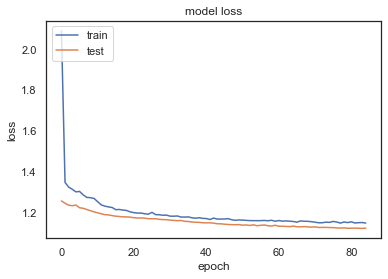

TEST WMSE =  1.0784380148798827
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 65.2288830280304


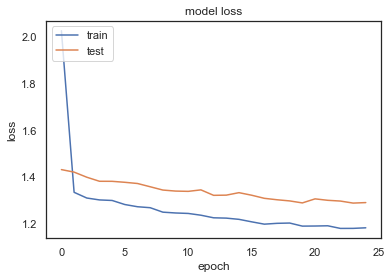

TEST WMSE =  1.1636508434972415
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00054: early stopping
duration: 130.6018569469452


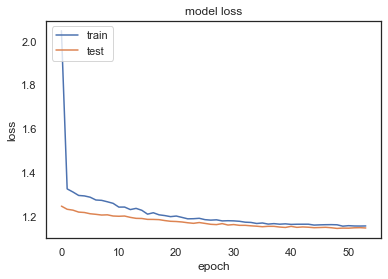

TEST WMSE =  1.1193796678181913
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 53.91677403450012


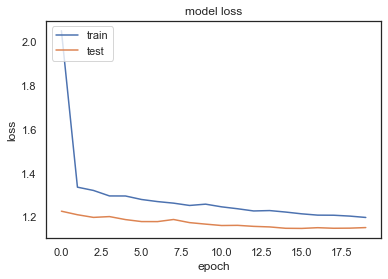

TEST WMSE =  1.1940011609705061
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 74.7164978981018


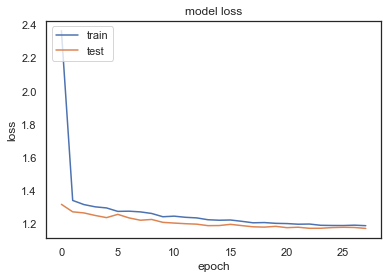

TEST WMSE =  1.197213819991928
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 92.86070585250854


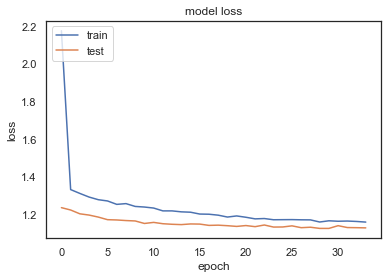

TEST WMSE =  1.1751774563541808
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 88.44708108901978


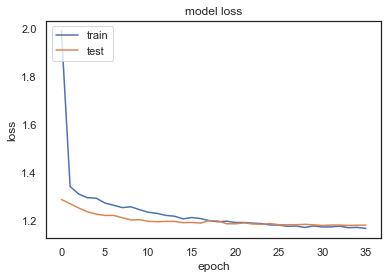

TEST WMSE =  1.158552819136935
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 124.06134676933289


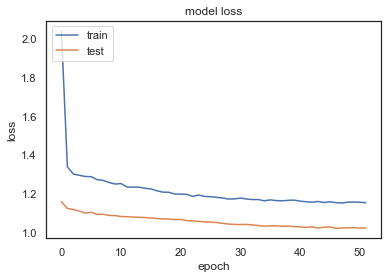

TEST WMSE =  1.2008275967326296
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 110.87496995925903


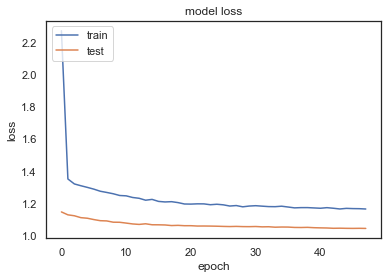

TEST WMSE =  1.0794260823066713
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 86.26723885536194


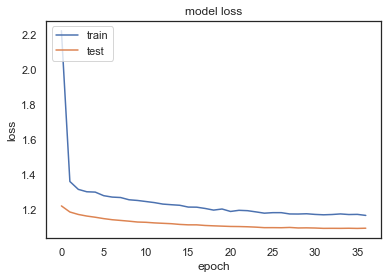

TEST WMSE =  1.1644626285813118
TEST MEAN WMSE =  1.1644626285813118


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 15
-----


-----
 FEATURE NAME -- H3K4me1
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 68.30831384658813


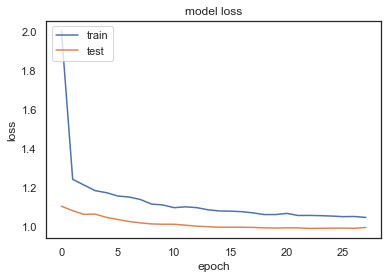

TEST WMSE =  0.9703370928134739
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 51.62044072151184


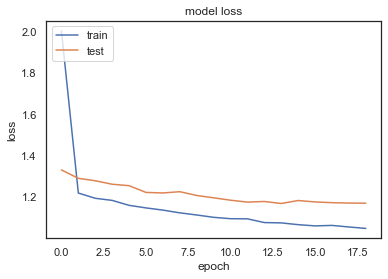

TEST WMSE =  1.0589472889046485
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 86.22753024101257


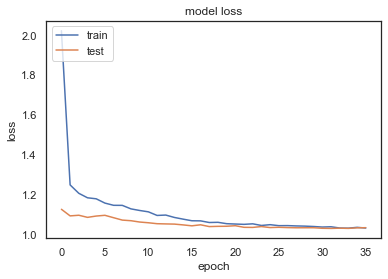

TEST WMSE =  0.9859607753260097
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 57.926990270614624


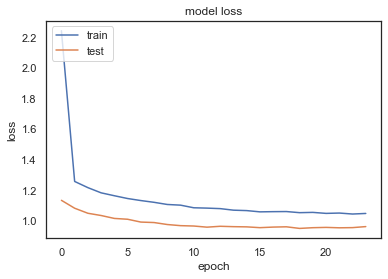

TEST WMSE =  1.042232380209857
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 64.89159226417542


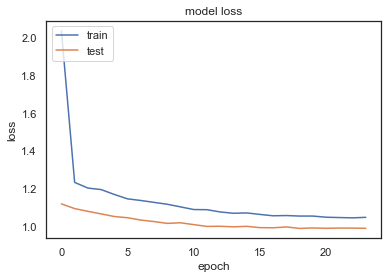

TEST WMSE =  1.0588341118886813
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 52.52805519104004


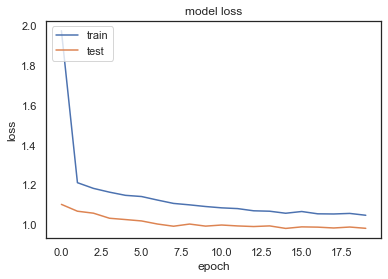

TEST WMSE =  1.0573511593627563
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 63.838276863098145


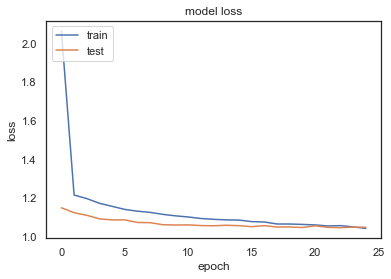

TEST WMSE =  0.9883728010551779
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 61.055081367492676


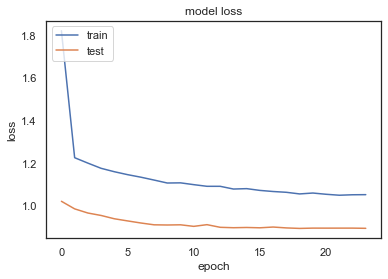

TEST WMSE =  1.049992483073619
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 87.20462894439697


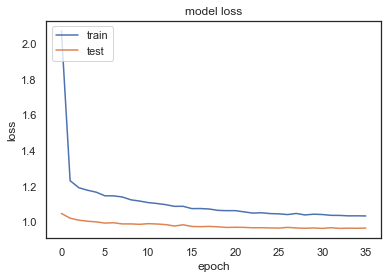

TEST WMSE =  0.9650009416961339
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 65.2748920917511


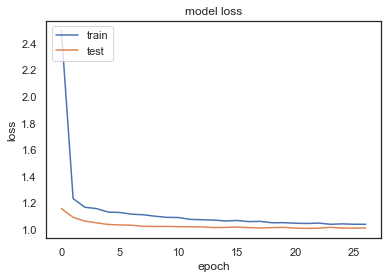

TEST WMSE =  1.0152707529057858
TEST MEAN WMSE =  1.0152707529057858
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 62.29106879234314


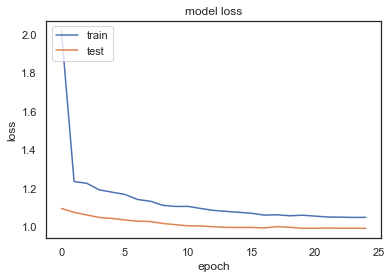

TEST WMSE =  0.9621395880746242
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 59.250303983688354


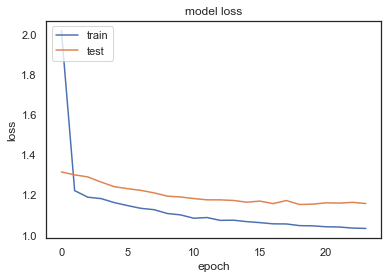

TEST WMSE =  1.0584580741581555
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 89.5822069644928


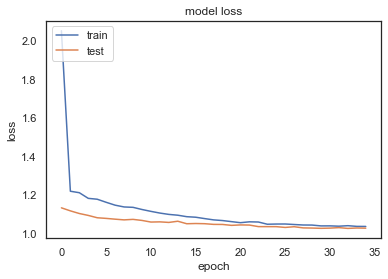

TEST WMSE =  0.9848479242779713
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 61.14050889015198


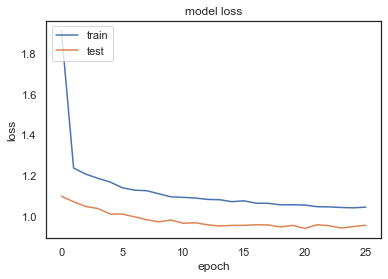

TEST WMSE =  1.042628896018128
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 60.40041708946228


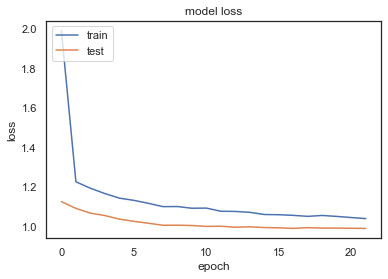

TEST WMSE =  1.0648623581026284
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 66.09942889213562


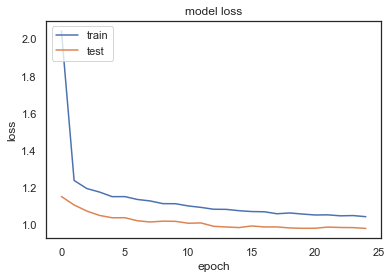

TEST WMSE =  1.0639586488159165
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 79.21099472045898


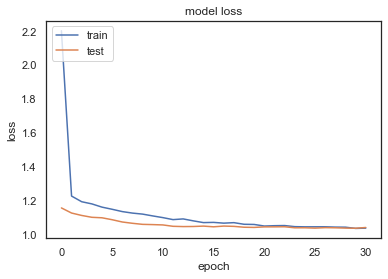

TEST WMSE =  0.9859554597879143
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 53.25116586685181


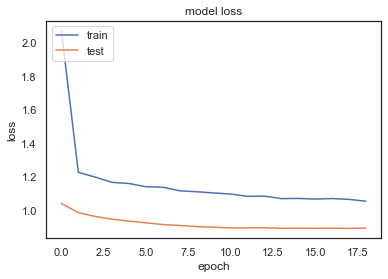

TEST WMSE =  1.053839429173254
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 73.68245005607605


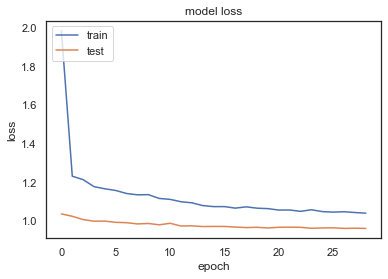

TEST WMSE =  0.9676660323414855
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 91.91927409172058


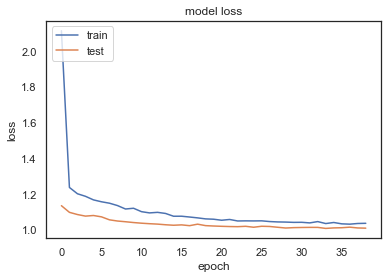

TEST WMSE =  1.0130938013761406
TEST MEAN WMSE =  1.0130938013761406
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 73.8822889328003


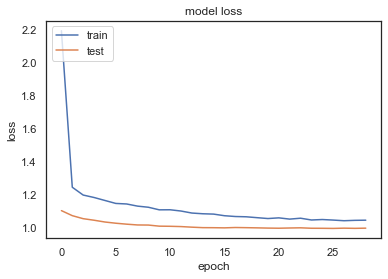

TEST WMSE =  0.9669570626946004
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 65.22331595420837


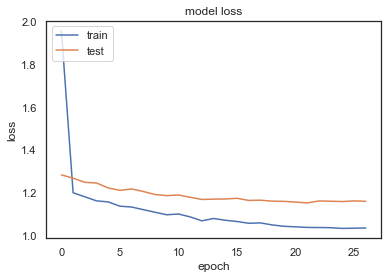

TEST WMSE =  1.0549011050227042
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 88.8936676979065


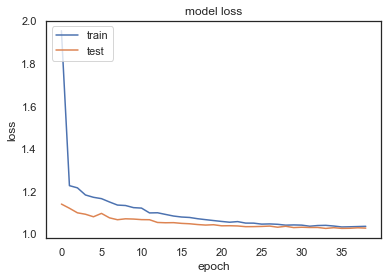

TEST WMSE =  0.9851607104998069
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 45.92933988571167


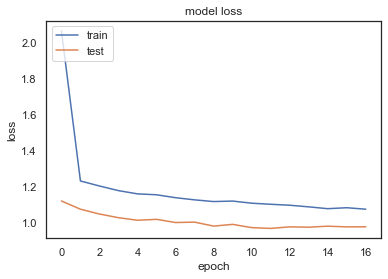

TEST WMSE =  1.0625195470079236
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 80.96152782440186


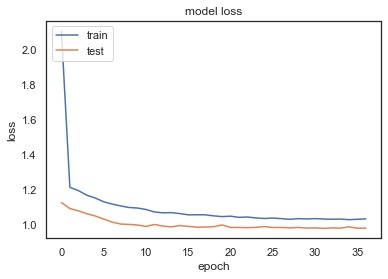

TEST WMSE =  1.0556113518405328
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 58.123112201690674


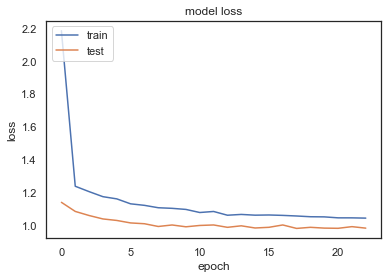

TEST WMSE =  1.059763339508533
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 72.25395607948303


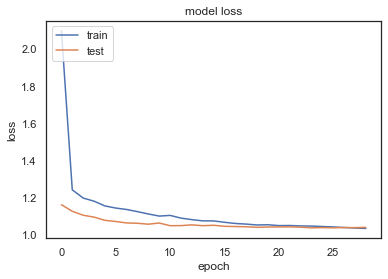

TEST WMSE =  0.9864672529034334
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 76.11245012283325


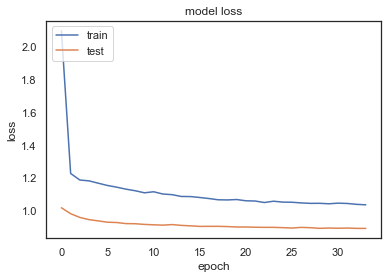

TEST WMSE =  1.0465904030554152
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 78.62670993804932


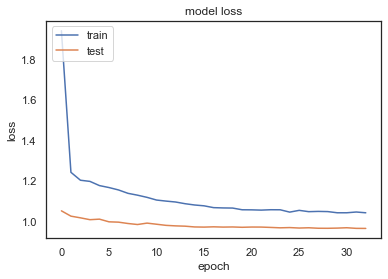

TEST WMSE =  0.9689560705352803
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 104.33881711959839


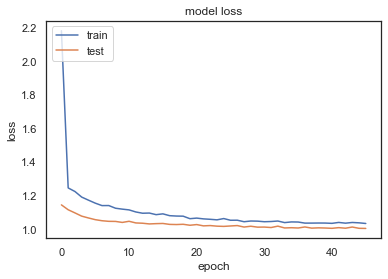

TEST WMSE =  1.0091411688894778
TEST MEAN WMSE =  1.0091411688894778


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 16
-----


-----
 FEATURE NAME -- H3K4me2
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 81.51528120040894


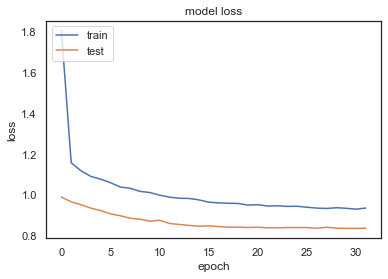

TEST WMSE =  0.845154501489893
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 75.15421891212463


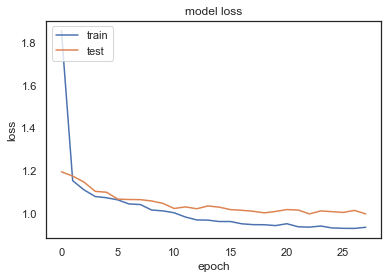

TEST WMSE =  0.9232432072884891
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 78.69754481315613


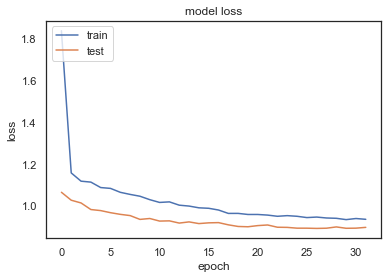

TEST WMSE =  0.8570169496914364
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 66.7970039844513


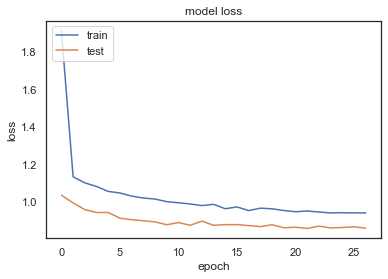

TEST WMSE =  0.9011156431059308
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 108.44761610031128


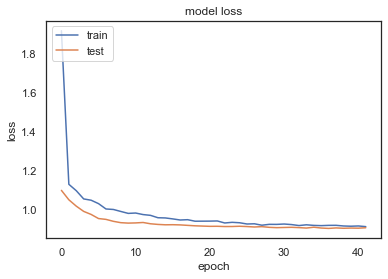

TEST WMSE =  0.9545056110464956
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 77.56118488311768


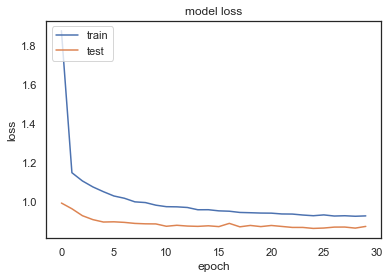

TEST WMSE =  0.9499461133770711
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 103.35548806190491


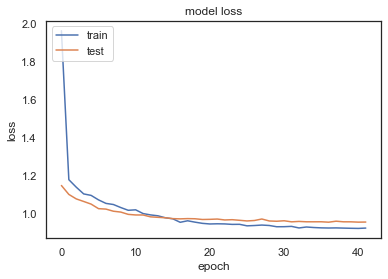

TEST WMSE =  0.8926527943586582
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 80.4174587726593


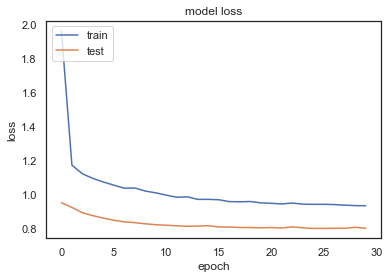

TEST WMSE =  0.9410551023996326
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 54.71705222129822


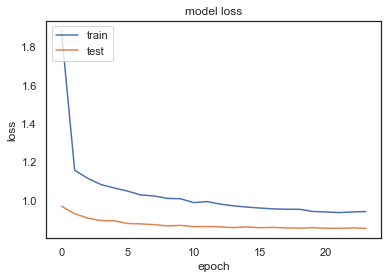

TEST WMSE =  0.8562987537839828
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 101.43595695495605


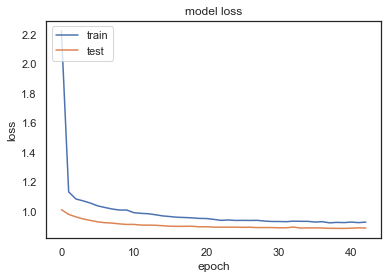

TEST WMSE =  0.9068253476401821
TEST MEAN WMSE =  0.9068253476401821
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 98.12622308731079


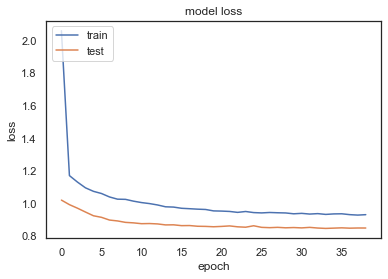

TEST WMSE =  0.8519061765112586
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 51.088611125946045


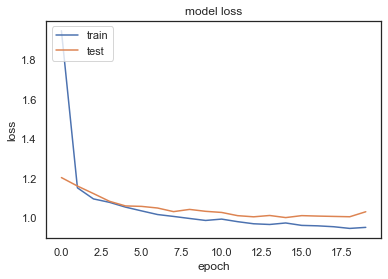

TEST WMSE =  0.9383648994869294
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 91.1632490158081


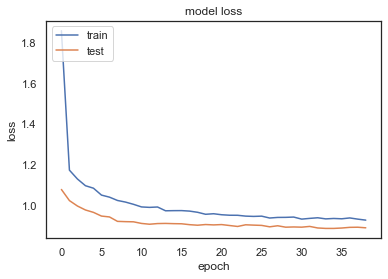

TEST WMSE =  0.851732050013137
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 53.0813090801239


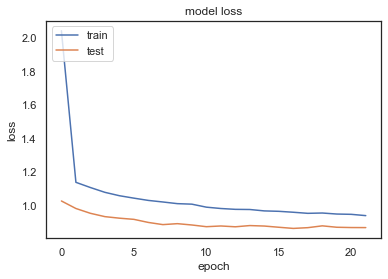

TEST WMSE =  0.9101693945931566
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 128.22126507759094


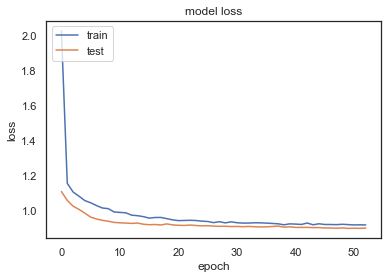

TEST WMSE =  0.9534757091228125
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 57.38936400413513


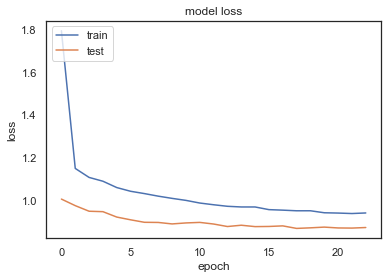

TEST WMSE =  0.9548634765130402
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 85.48902606964111


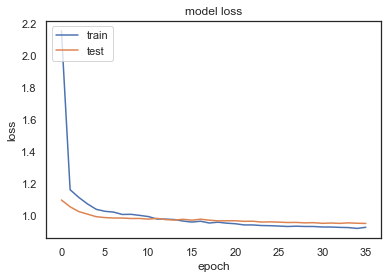

TEST WMSE =  0.8884671323083169
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 74.48341298103333


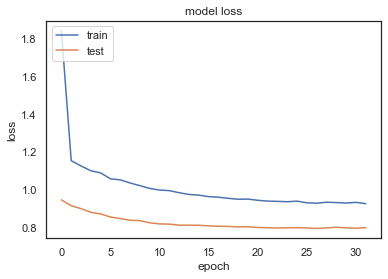

TEST WMSE =  0.9346575626830819
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 69.38004994392395


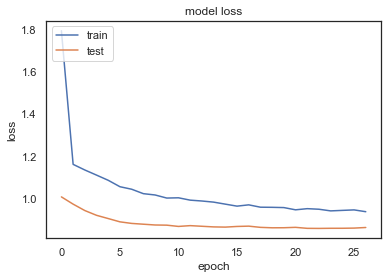

TEST WMSE =  0.857648555735513
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 67.66538190841675


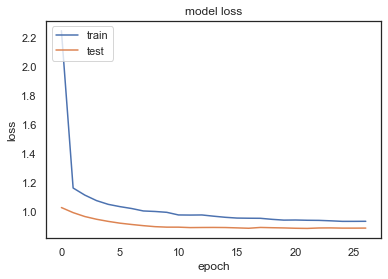

TEST WMSE =  0.9064723512949769
TEST MEAN WMSE =  0.9064723512949769
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 78.13474583625793


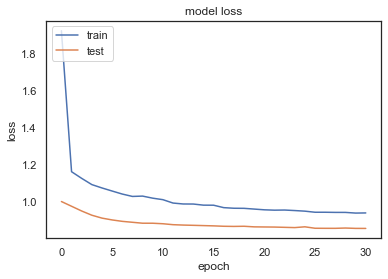

TEST WMSE =  0.8505141317006811
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 56.86383891105652


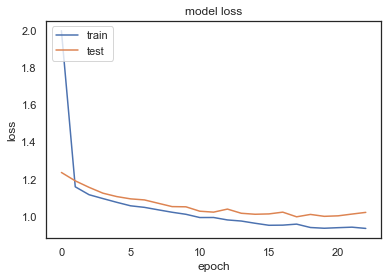

TEST WMSE =  0.9290977804867346
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 64.43709206581116


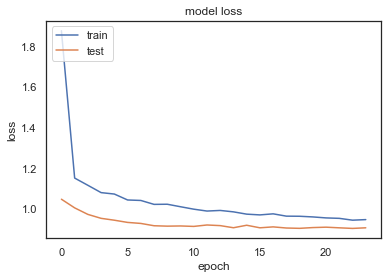

TEST WMSE =  0.85738352646516
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 61.75030708312988


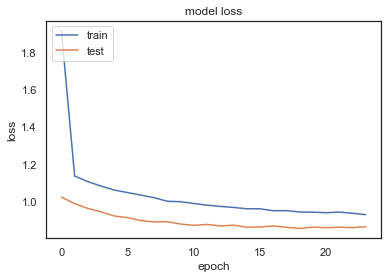

TEST WMSE =  0.9052001587533968
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 88.27609610557556


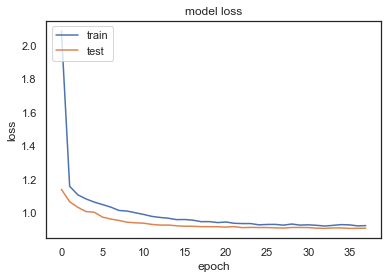

TEST WMSE =  0.9570646671055673
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 47.0723340511322


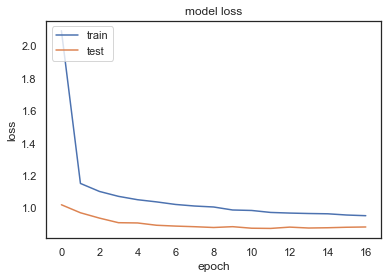

TEST WMSE =  0.9627800998791479
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 60.90575885772705


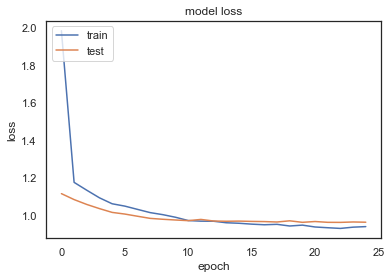

TEST WMSE =  0.8964623099290453
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 89.55411982536316


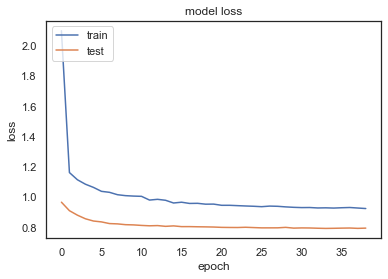

TEST WMSE =  0.9325200875591281
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 102.40412402153015


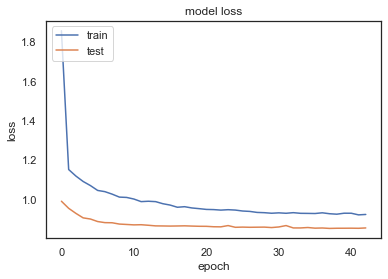

TEST WMSE =  0.8519979180423917
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 105.21522617340088


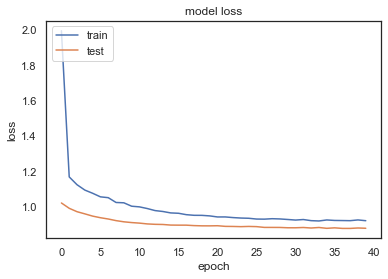

TEST WMSE =  0.9032721121889317
TEST MEAN WMSE =  0.9032721121889317


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 17
-----


-----
 FEATURE NAME -- H3K4me3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 52.116820096969604


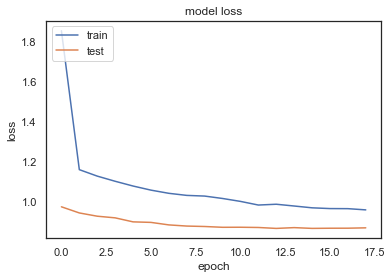

TEST WMSE =  0.8881830168046267
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 56.03113293647766


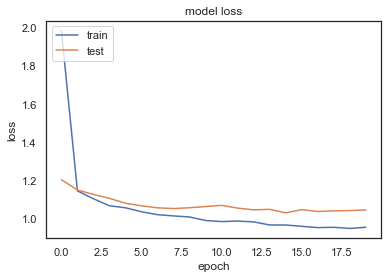

TEST WMSE =  0.8872263485492653
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 55.106345891952515


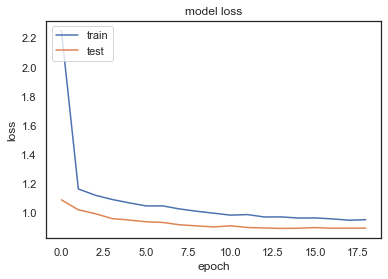

TEST WMSE =  0.8554423642371026
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 48.22489094734192


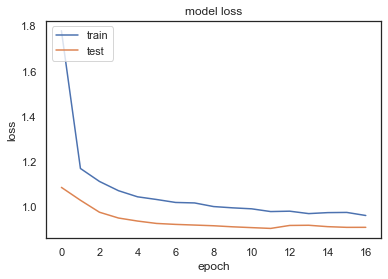

TEST WMSE =  0.9107114149022881
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 76.66506910324097


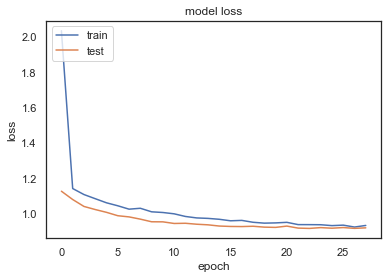

TEST WMSE =  0.9368957764441744
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 71.22875690460205


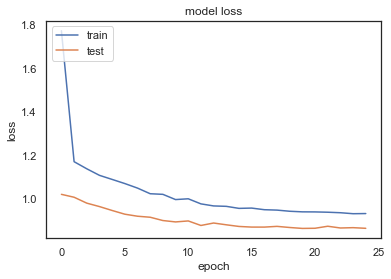

TEST WMSE =  0.9444815471274235
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 64.21309304237366


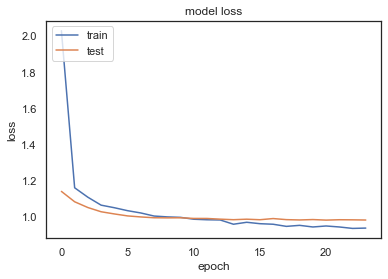

TEST WMSE =  0.8959763401510883
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 45.7112078666687


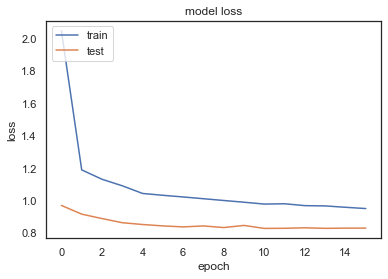

TEST WMSE =  0.9554287813164948
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 101.2739188671112


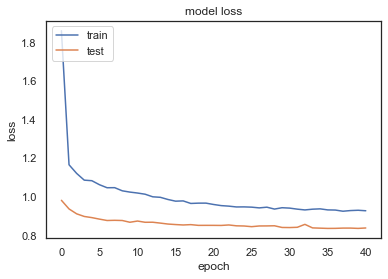

TEST WMSE =  0.8728619763534986
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 52.941888093948364


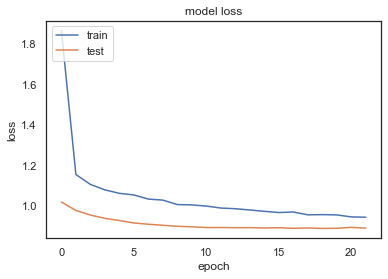

TEST WMSE =  0.9151768398603771
TEST MEAN WMSE =  0.9151768398603771
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 68.96307110786438


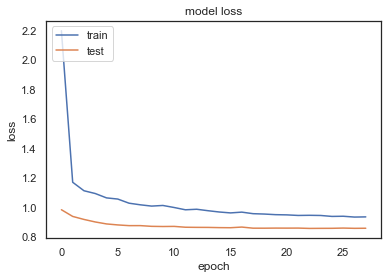

TEST WMSE =  0.8724099008210339
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 50.82236385345459


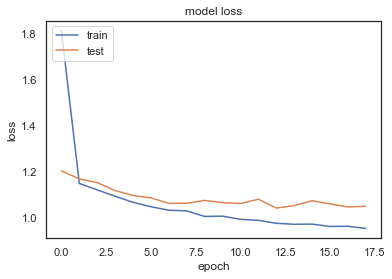

TEST WMSE =  0.8871585784286675
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 122.03881812095642


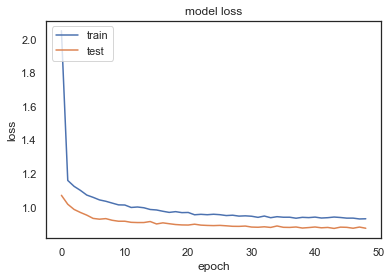

TEST WMSE =  0.8466702117054702
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 72.79175972938538


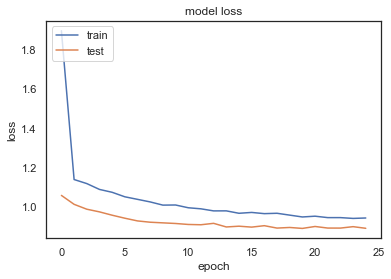

TEST WMSE =  0.9049497567438926
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 82.85822296142578


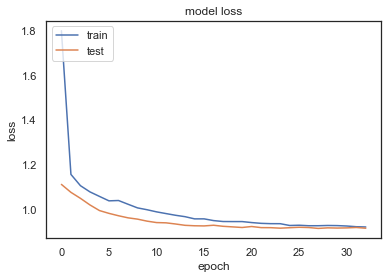

TEST WMSE =  0.9335314232518797
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 75.98375701904297


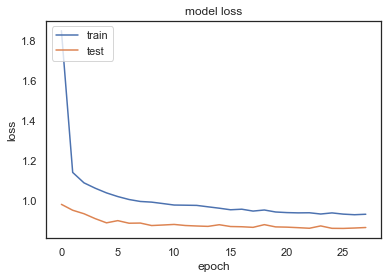

TEST WMSE =  0.9469642414284958
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 58.33988809585571


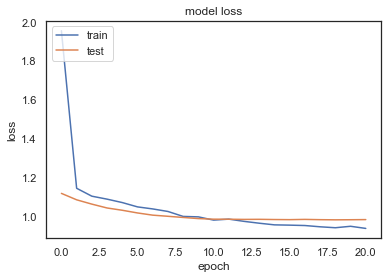

TEST WMSE =  0.8978187700380434
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 96.17823314666748


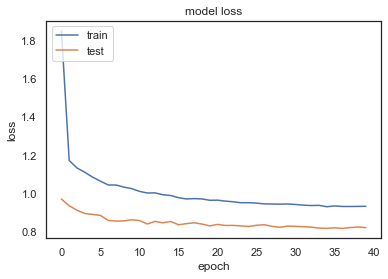

TEST WMSE =  0.9543088744402843
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 132.6335871219635


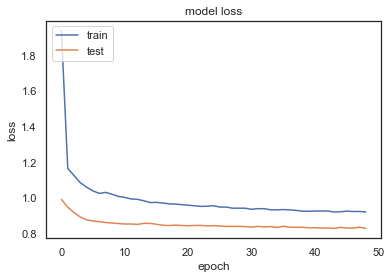

TEST WMSE =  0.8564741319707029
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 84.55754804611206


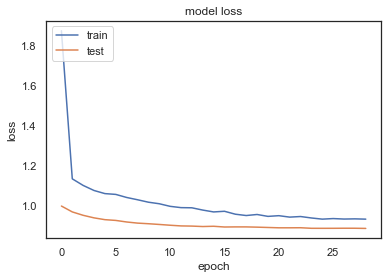

TEST WMSE =  0.9100844950255113
TEST MEAN WMSE =  0.9100844950255113
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 54.45718479156494


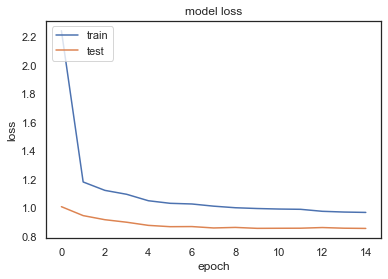

TEST WMSE =  0.8662014689017414
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 77.1321759223938


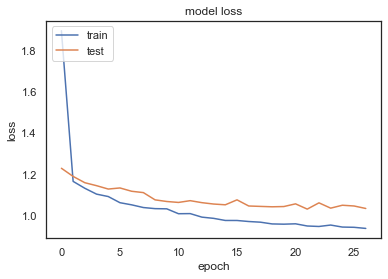

TEST WMSE =  0.877163217838235
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 94.84882712364197


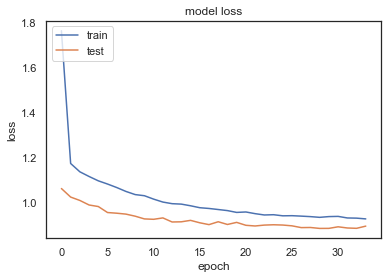

TEST WMSE =  0.8553852837294379
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 66.9336040019989


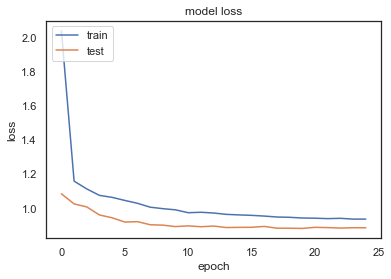

TEST WMSE =  0.9019883878401267
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 104.0694088935852


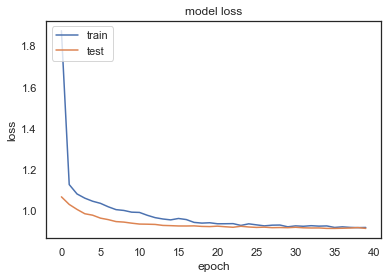

TEST WMSE =  0.9296227152132878
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 131.78692722320557


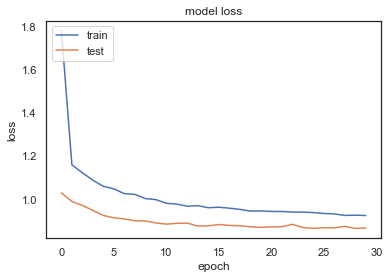

TEST WMSE =  0.9455057257048683
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 142.1527168750763


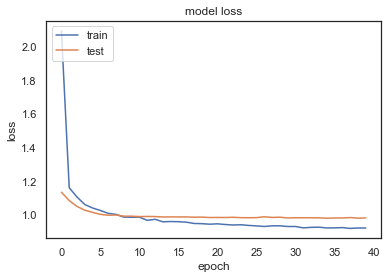

TEST WMSE =  0.8951602898938588
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 67.40416216850281


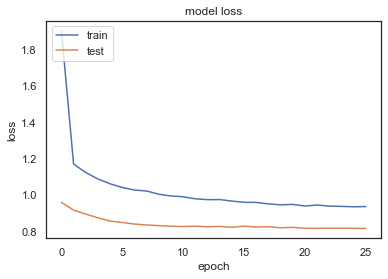

TEST WMSE =  0.9469207766594866
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 65.8313410282135


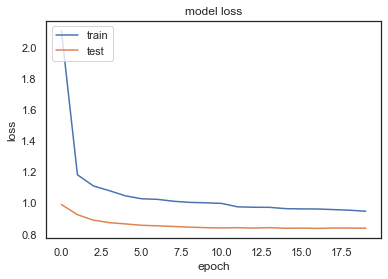

TEST WMSE =  0.8798100112960673
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 119.6369149684906


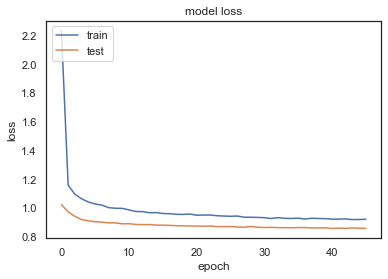

TEST WMSE =  0.9039316048540976
TEST MEAN WMSE =  0.9039316048540976


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 18
-----


-----
 FEATURE NAME -- H3K9me2
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00073: early stopping
duration: 185.92530012130737


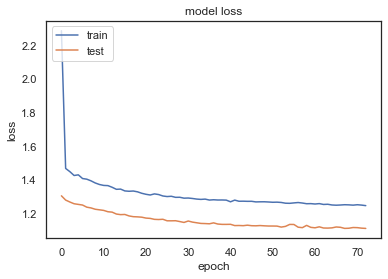

TEST WMSE =  1.1825802937186223
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 53.290382862091064


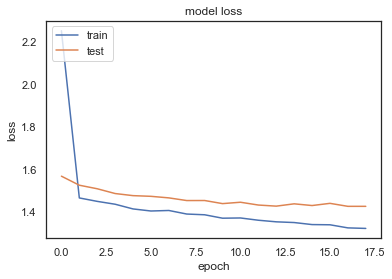

TEST WMSE =  1.3118473472284768
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 139.18648600578308


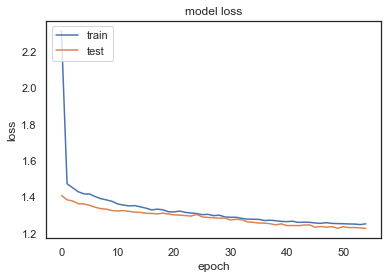

TEST WMSE =  1.2018452273213767
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 130.4301118850708


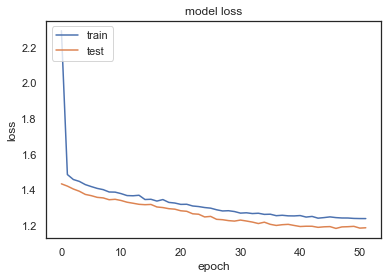

TEST WMSE =  1.2967838068271098
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00071: early stopping
duration: 164.28736400604248


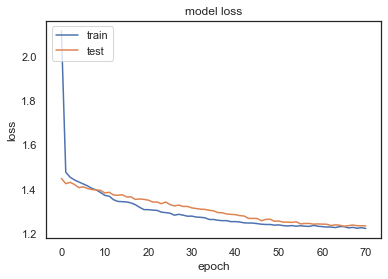

TEST WMSE =  1.2624023092948833
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 137.74591898918152


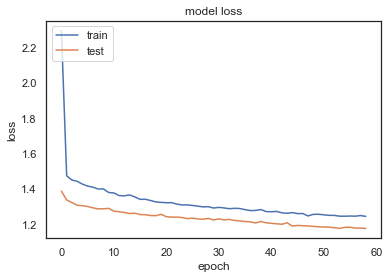

TEST WMSE =  1.238632116477229
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 132.6768400669098


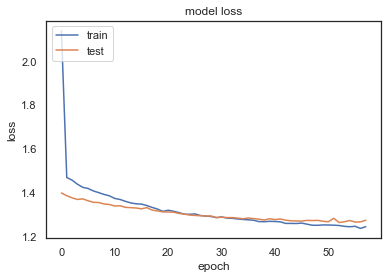

TEST WMSE =  1.2097253218554822
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 165.17374801635742


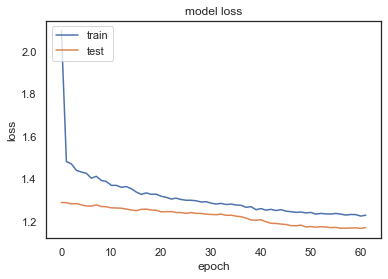

TEST WMSE =  1.2856161973831517
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 128.965665102005


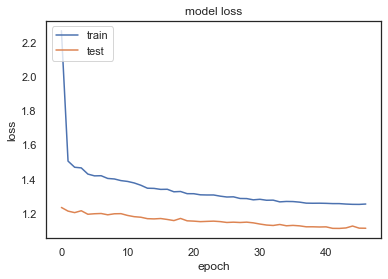

TEST WMSE =  1.2101640449788937
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 107.07611894607544


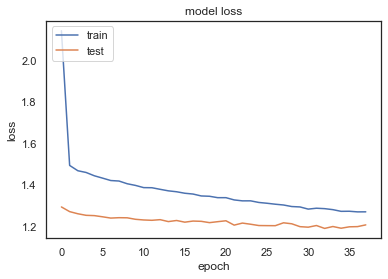

TEST WMSE =  1.252293421547812
TEST MEAN WMSE =  1.252293421547812
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 125.1938202381134


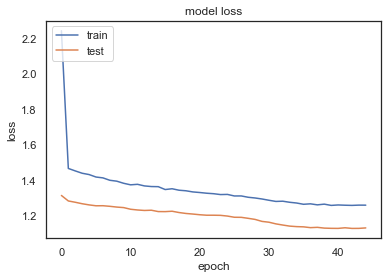

TEST WMSE =  1.2093464221439005
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 72.59704875946045


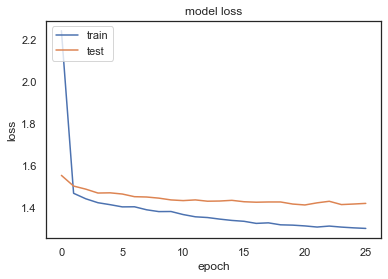

TEST WMSE =  1.3042027897320838
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00074: early stopping
duration: 209.42213606834412


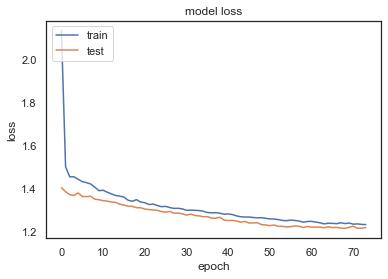

TEST WMSE =  1.1882217396494992
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 143.2089238166809


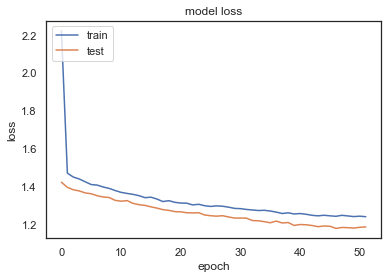

TEST WMSE =  1.283568421320223
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00084: early stopping
duration: 238.25189018249512


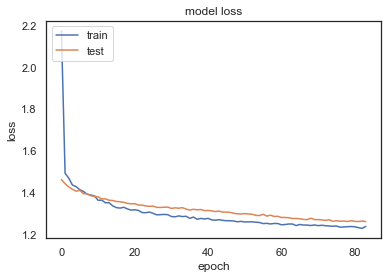

TEST WMSE =  1.2621830444349968
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 134.59258794784546


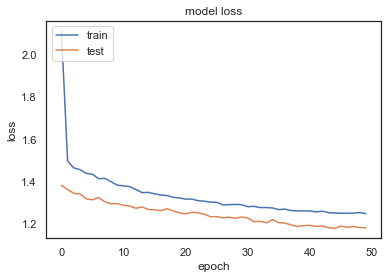

TEST WMSE =  1.241422359176128
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 144.06088876724243


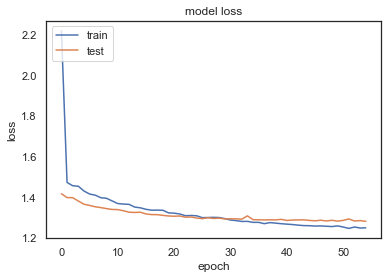

TEST WMSE =  1.2101953161719223
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00096: early stopping
duration: 244.79075479507446


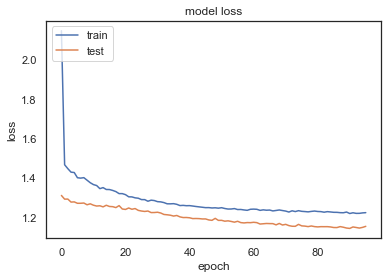

TEST WMSE =  1.2899680795227868
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 79.94645190238953


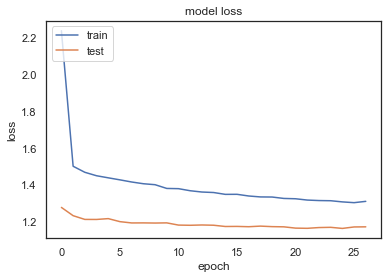

TEST WMSE =  1.252354384851348
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 127.44552302360535


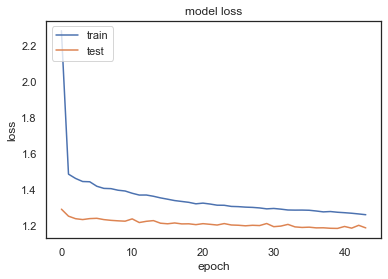

TEST WMSE =  1.2453232263911864
TEST MEAN WMSE =  1.2453232263911864
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00078: early stopping
duration: 213.4286847114563


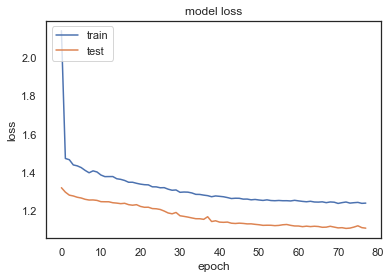

TEST WMSE =  1.1883237111159275
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 96.37738919258118


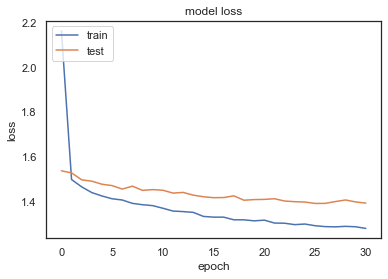

TEST WMSE =  1.2768298365473711
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 155.68378686904907


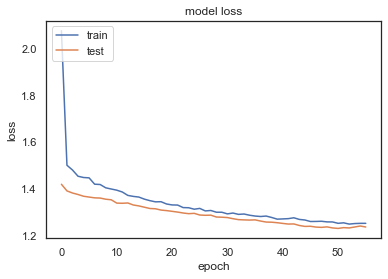

TEST WMSE =  1.1909540608069396
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 121.41520309448242


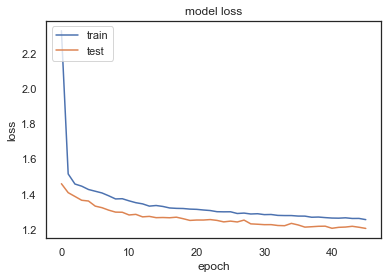

TEST WMSE =  1.2897847427725249
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00061: early stopping
duration: 182.19696688652039


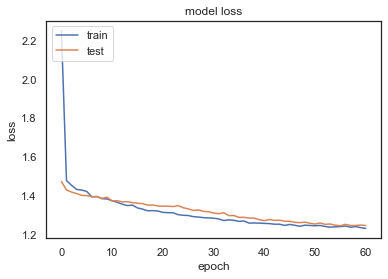

TEST WMSE =  1.2628587309733057
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 102.65286183357239


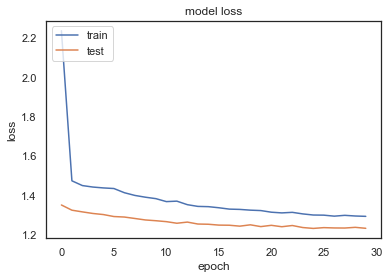

TEST WMSE =  1.2885977841053682
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 169.59731721878052


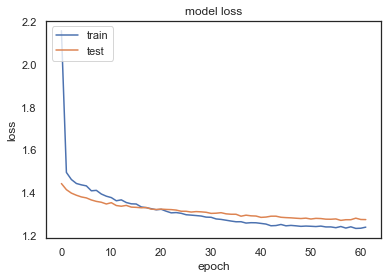

TEST WMSE =  1.1963519184316032
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00085: early stopping
duration: 219.4561312198639


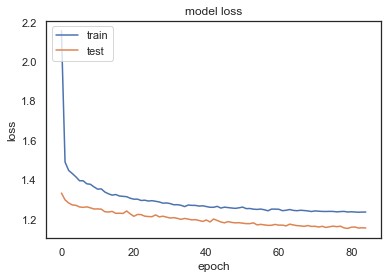

TEST WMSE =  1.2890366485921285
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 167.8306851387024


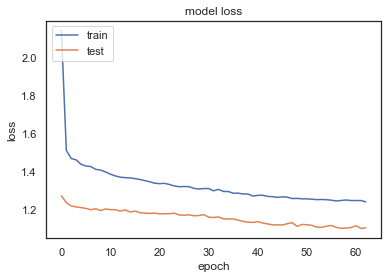

TEST WMSE =  1.2102313387658867
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 89.93577909469604


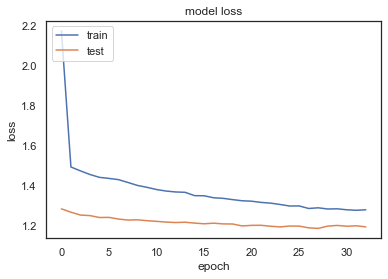

TEST WMSE =  1.2534981855656129
TEST MEAN WMSE =  1.2534981855656129


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 19
-----


-----
 FEATURE NAME -- H3K9me3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 116.03873586654663


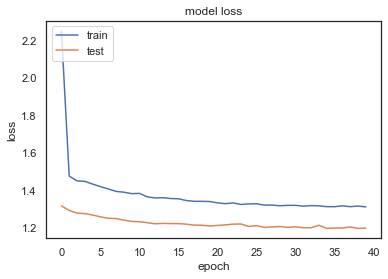

TEST WMSE =  1.272307957536755
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 87.11062788963318


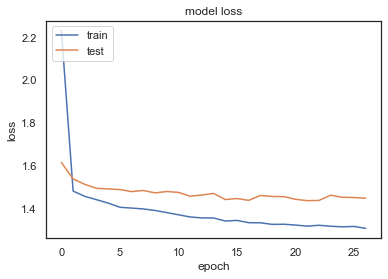

TEST WMSE =  1.3060536475819977
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 143.66799592971802


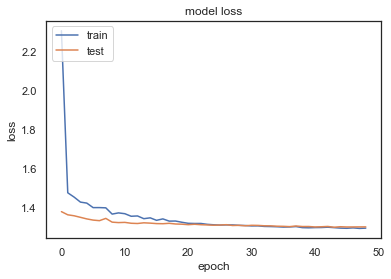

TEST WMSE =  1.2794780672632349
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 93.97429585456848


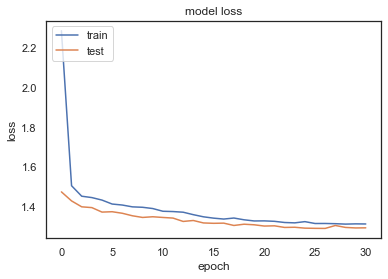

TEST WMSE =  1.3553092675391039
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 118.29532480239868


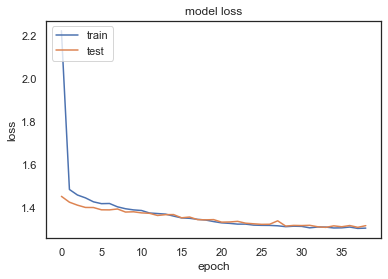

TEST WMSE =  1.3459636519107223
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 113.9684910774231


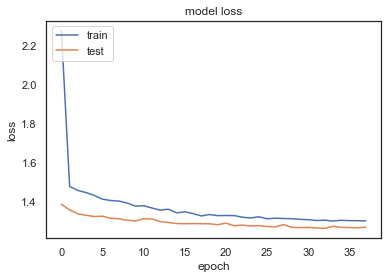

TEST WMSE =  1.3074010713610902
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 84.1306381225586


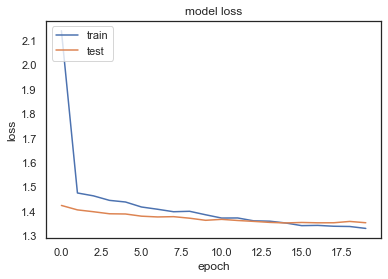

TEST WMSE =  1.2880219592307887
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 93.21901297569275


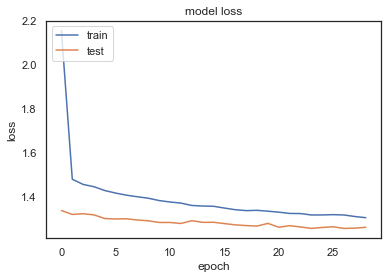

TEST WMSE =  1.3600926465593748
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 110.0485270023346


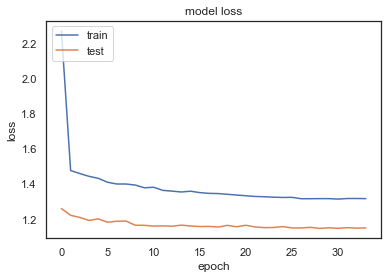

TEST WMSE =  1.2414766173770024
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 67.53865694999695


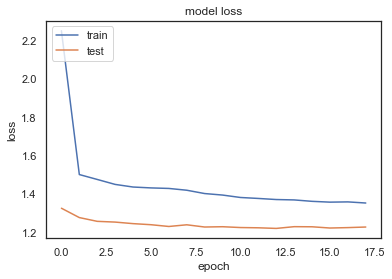

TEST WMSE =  1.317443362250584
TEST MEAN WMSE =  1.317443362250584
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 114.23747897148132


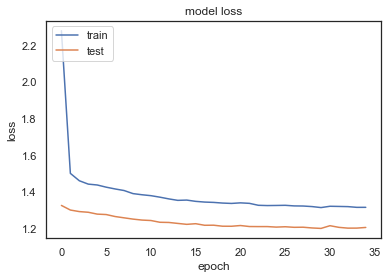

TEST WMSE =  1.2758664049013577
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 85.39032292366028


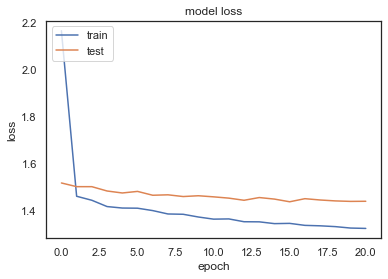

TEST WMSE =  1.3076225782826687
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 121.11708426475525


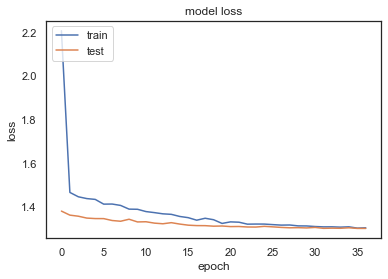

TEST WMSE =  1.271811506123941
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 125.48095107078552


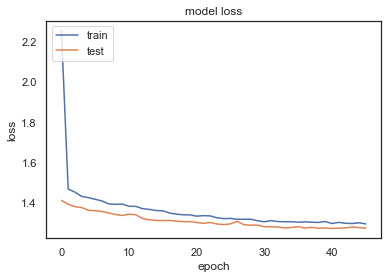

TEST WMSE =  1.3491604889099302
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 106.8936059474945


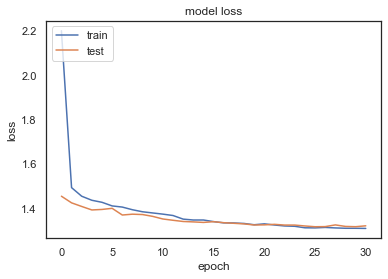

TEST WMSE =  1.347928668449
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 83.87557601928711


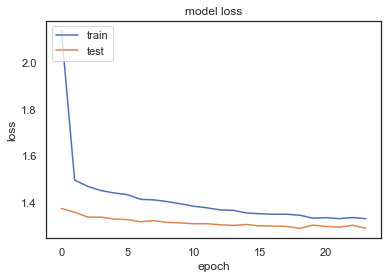

TEST WMSE =  1.3169017341124687
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 122.59966588020325


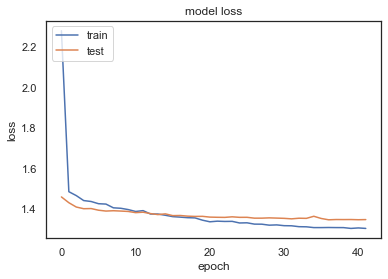

TEST WMSE =  1.2778004995678318
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 86.52478194236755


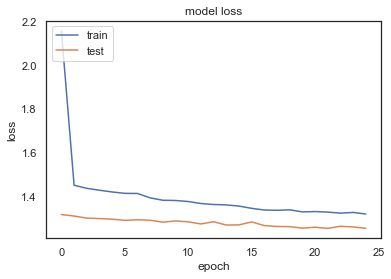

TEST WMSE =  1.361797535003949
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 103.99441170692444


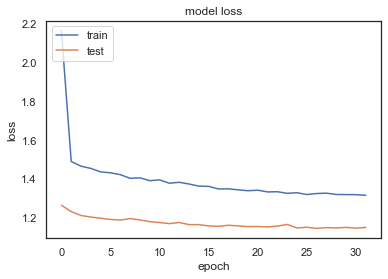

TEST WMSE =  1.2493502156874108
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00017: early stopping
duration: 58.08910393714905


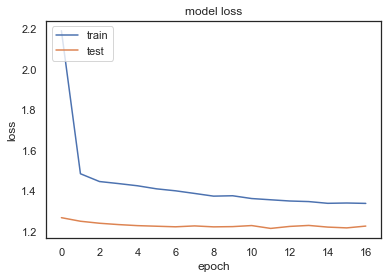

TEST WMSE =  1.3010945236070348
TEST MEAN WMSE =  1.3010945236070348
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 109.36928915977478


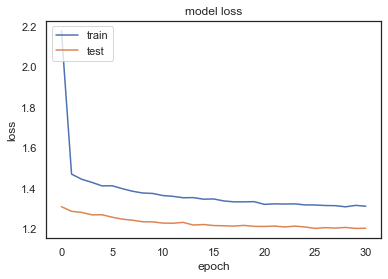

TEST WMSE =  1.281123553482554
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 68.96423888206482


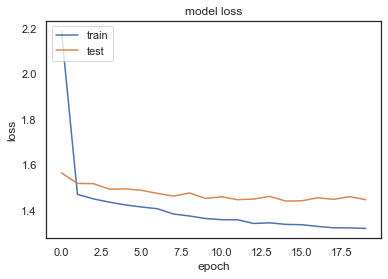

TEST WMSE =  1.309998391759273
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 95.90035200119019


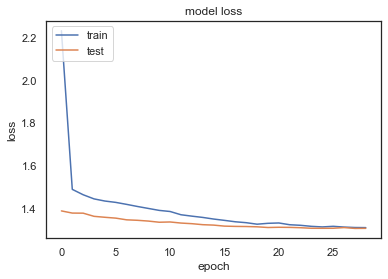

TEST WMSE =  1.2792649363275521
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 129.86210680007935


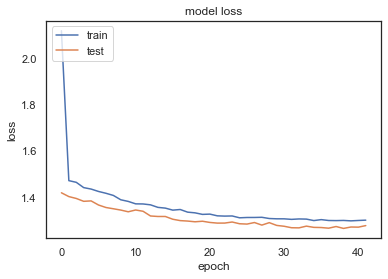

TEST WMSE =  1.349235947180729
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00061: early stopping
duration: 177.59506821632385


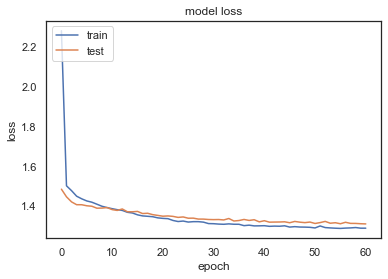

TEST WMSE =  1.3259685547126105
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 135.01343894004822


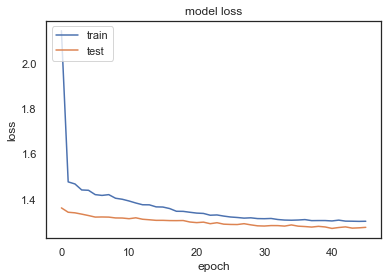

TEST WMSE =  1.320342493877073
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00012: early stopping
duration: 46.71127510070801


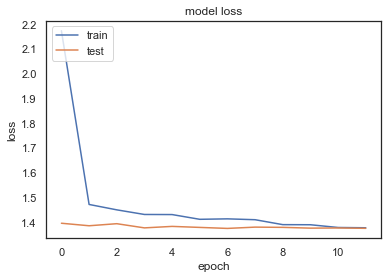

TEST WMSE =  1.3050398259713298
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 74.7343418598175


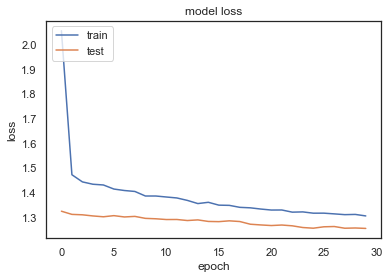

TEST WMSE =  1.349844482355628
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 65.91343283653259


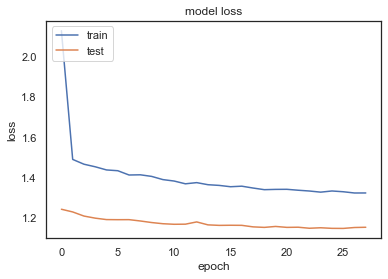

TEST WMSE =  1.247817910828064
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 70.69196486473083


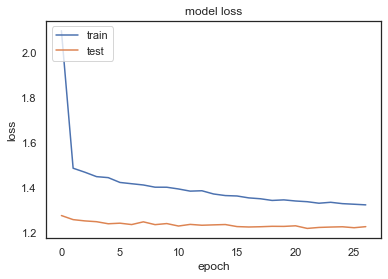

TEST WMSE =  1.2987155061931934
TEST MEAN WMSE =  1.2987155061931934


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 20
-----


-----
 FEATURE NAME -- H3K27ac
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 80.96219396591187


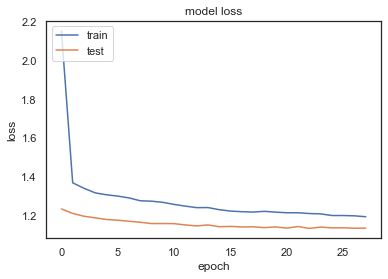

TEST WMSE =  1.163282102378121
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 96.94442009925842


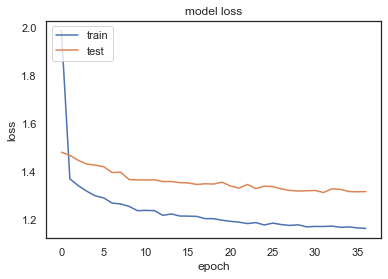

TEST WMSE =  1.125118521902033
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00098: early stopping
duration: 223.08507800102234


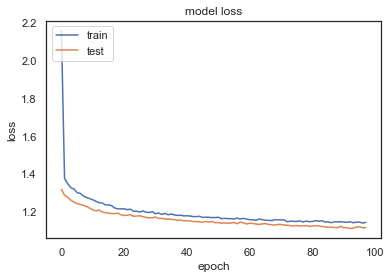

TEST WMSE =  1.068287661430407
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 104.36678671836853


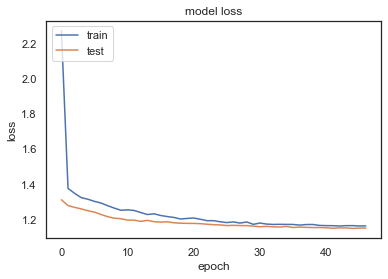

TEST WMSE =  1.1523771100482527
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 63.425657987594604


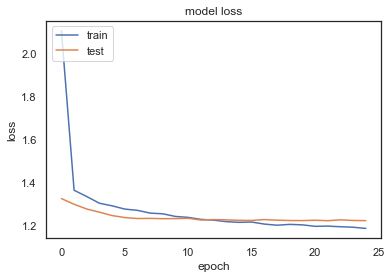

TEST WMSE =  1.206924962103858
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 151.21971201896667


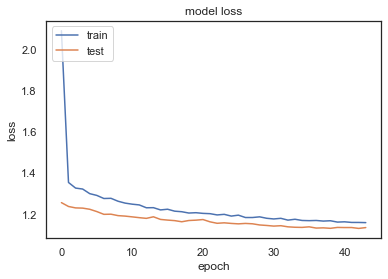

TEST WMSE =  1.1793608058025904
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 157.12983083724976


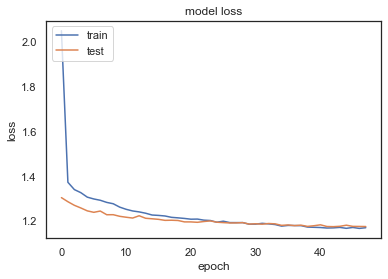

TEST WMSE =  1.1660264813082541
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 102.82713389396667


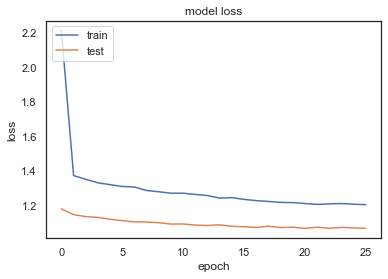

TEST WMSE =  1.2201333729257058
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 76.9849328994751


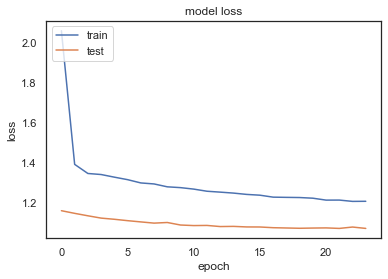

TEST WMSE =  1.0900992062858788
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 163.2007417678833


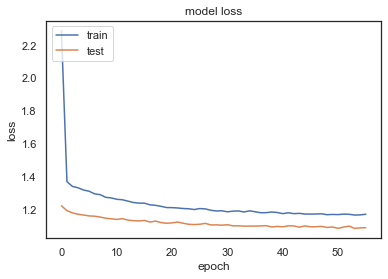

TEST WMSE =  1.1858819768225728
TEST MEAN WMSE =  1.1858819768225728
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 182.78922486305237


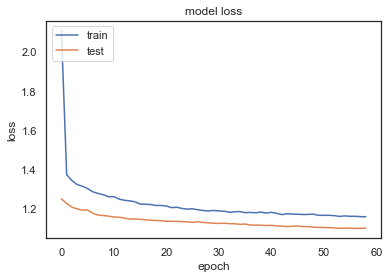

TEST WMSE =  1.134254777285133
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 110.67584013938904


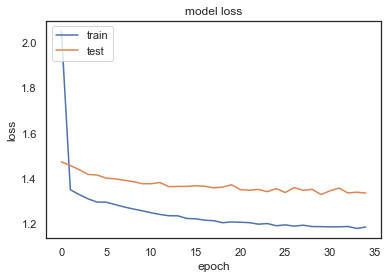

TEST WMSE =  1.1390500181392502
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 179.5995020866394


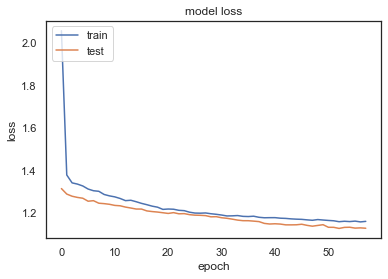

TEST WMSE =  1.069383039292482
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00049: early stopping
duration: 165.80274605751038


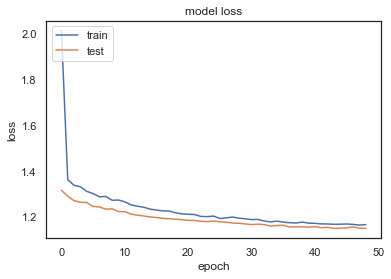

TEST WMSE =  1.1515807444035835
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00061: early stopping
duration: 222.83794903755188


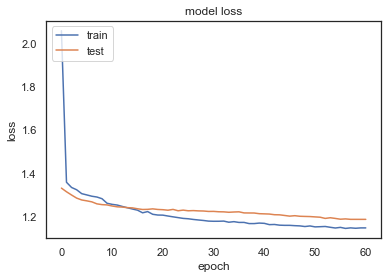

TEST WMSE =  1.1975798386722316
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 234.33343696594238


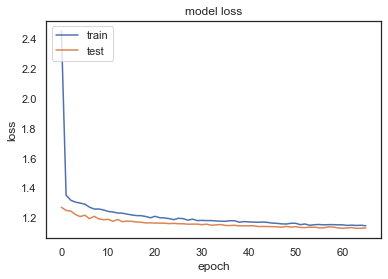

TEST WMSE =  1.1720610549485093
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 130.3401370048523


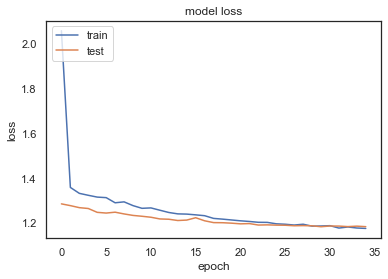

TEST WMSE =  1.1727365337167515
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 103.05498695373535


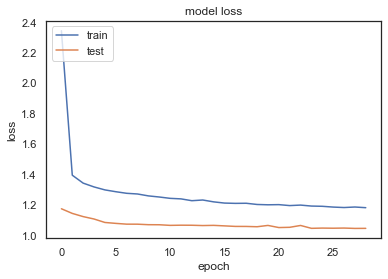

TEST WMSE =  1.2041525135430766
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 98.58228206634521


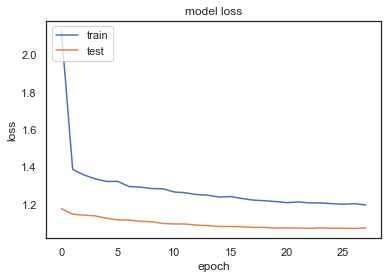

TEST WMSE =  1.091731242821079
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 120.8608751296997


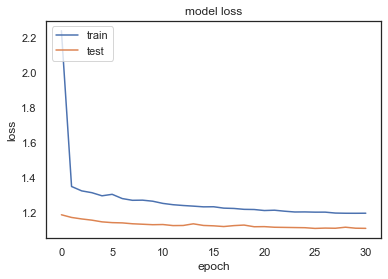

TEST WMSE =  1.2015518086157
TEST MEAN WMSE =  1.2015518086157
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 192.67259812355042


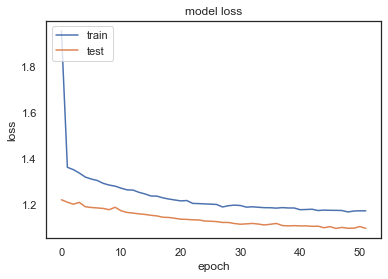

TEST WMSE =  1.1346405550781082
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 97.24575400352478


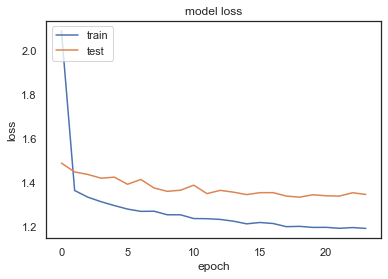

TEST WMSE =  1.1441520481435627
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 156.50660920143127


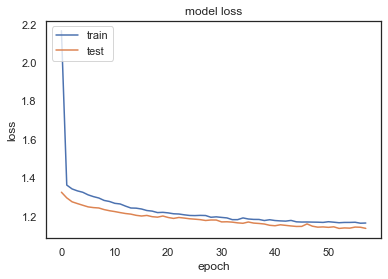

TEST WMSE =  1.0791321794149336
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 96.08466005325317


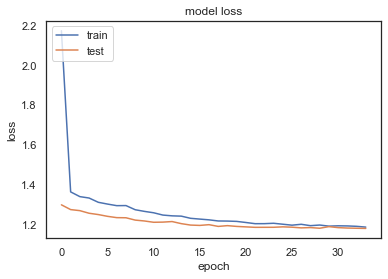

TEST WMSE =  1.1753204421613874
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 66.95905613899231


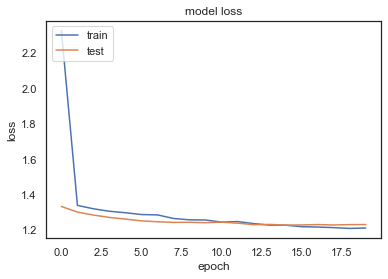

TEST WMSE =  1.2262304659915577
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 189.02618217468262


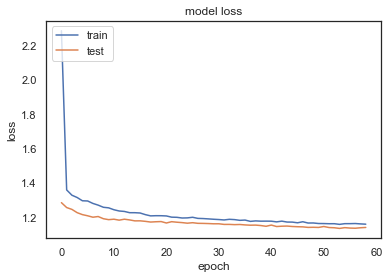

TEST WMSE =  1.181819172543967
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 125.62036514282227


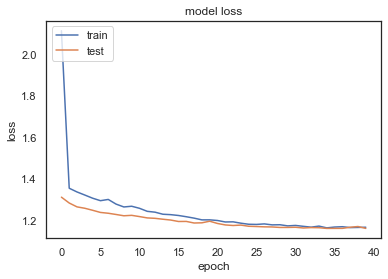

TEST WMSE =  1.1573813777025446
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 98.33774495124817


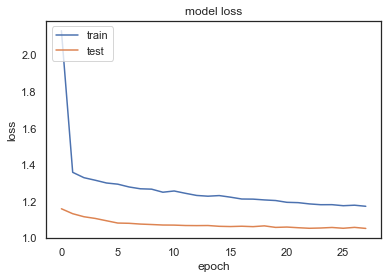

TEST WMSE =  1.1993179521173218
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 176.3322298526764


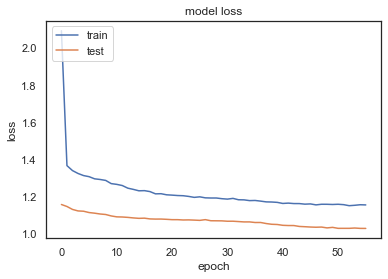

TEST WMSE =  1.052733622710526
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 129.6477198600769


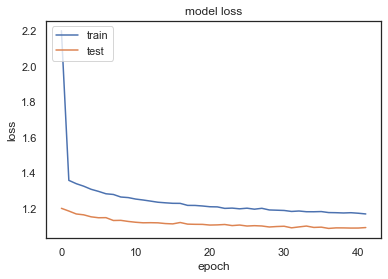

TEST WMSE =  1.1858539112222355
TEST MEAN WMSE =  1.1858539112222355


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 21
-----


-----
 FEATURE NAME -- H3K27me1
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 156.17573022842407


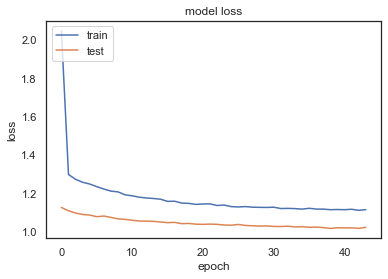

TEST WMSE =  1.0830229548841475
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 122.32116484642029


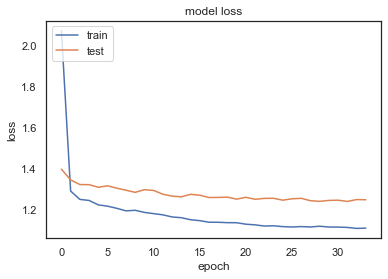

TEST WMSE =  1.0865756415343364
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 170.35821795463562


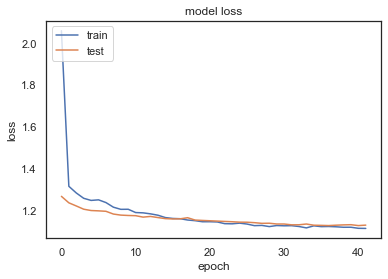

TEST WMSE =  1.0451599973857728
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00040: early stopping
duration: 124.01323795318604


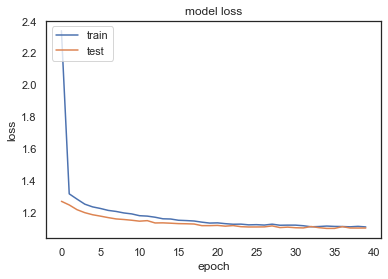

TEST WMSE =  1.1041463337949977
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00076: early stopping
duration: 234.06784915924072


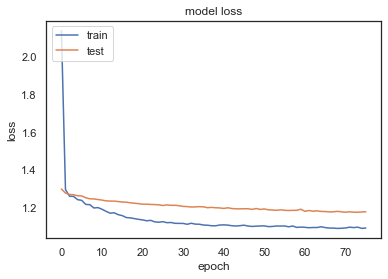

TEST WMSE =  1.135432817571508
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 145.35382175445557


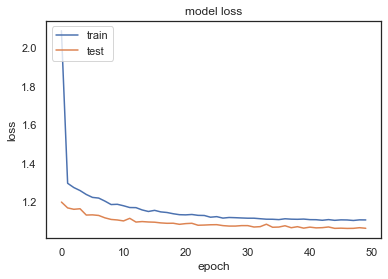

TEST WMSE =  1.1002829735067612
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 63.91578698158264


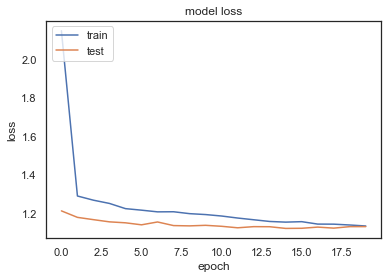

TEST WMSE =  1.1001020988701182
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 85.4739899635315


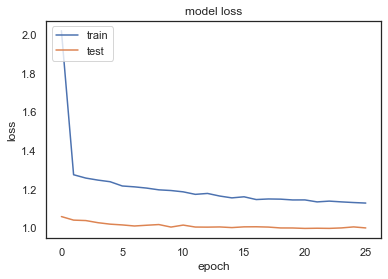

TEST WMSE =  1.1285503763703135
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 74.54707407951355


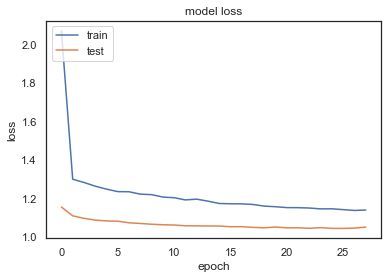

TEST WMSE =  1.0283682355663115
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 125.40466976165771


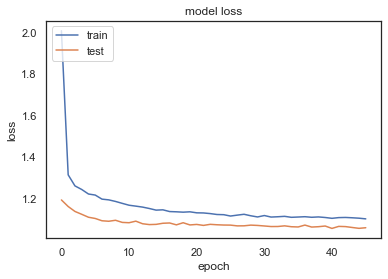

TEST WMSE =  1.1264981068714346
TEST MEAN WMSE =  1.1264981068714346
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 150.54607915878296


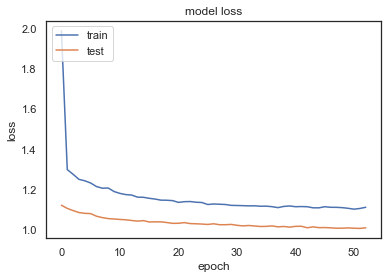

TEST WMSE =  1.0797025122622368
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 86.11435627937317


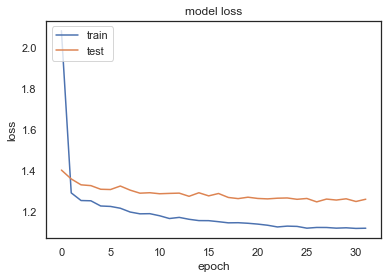

TEST WMSE =  1.0909505344586206
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 109.23732614517212


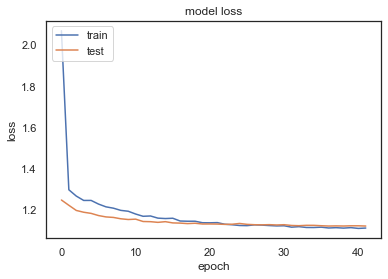

TEST WMSE =  1.0376103960991707
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 122.48949027061462


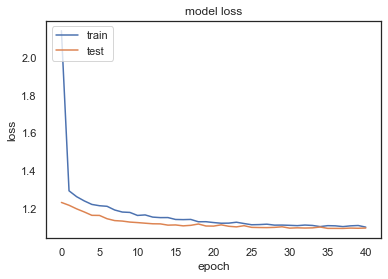

TEST WMSE =  1.1066486946312784
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 100.36185312271118


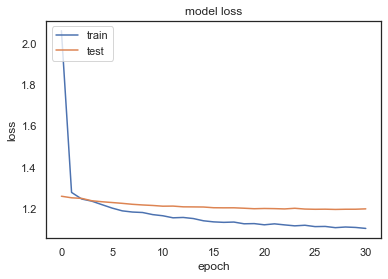

TEST WMSE =  1.1477695090073456
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 99.09563398361206


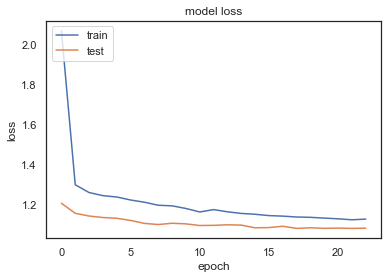

TEST WMSE =  1.1055749447166194
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 84.91651010513306


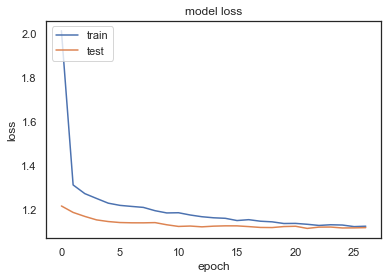

TEST WMSE =  1.1002533557050374
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 93.78866314888


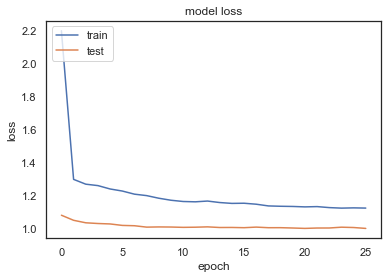

TEST WMSE =  1.126256973620035
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 75.31343412399292


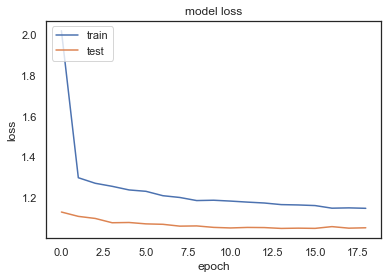

TEST WMSE =  1.0291771800783485
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 117.44524002075195


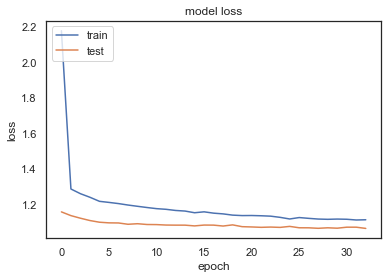

TEST WMSE =  1.1297108013102486
TEST MEAN WMSE =  1.1297108013102486
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 183.14302587509155


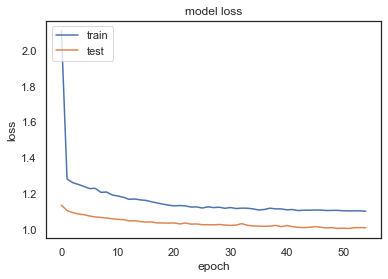

TEST WMSE =  1.076213362110412
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 97.40368628501892


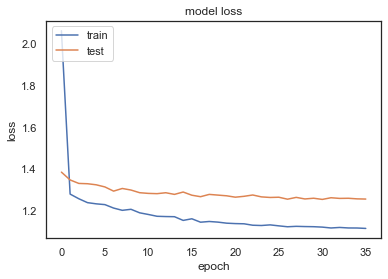

TEST WMSE =  1.0919304533687635
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 130.73749899864197


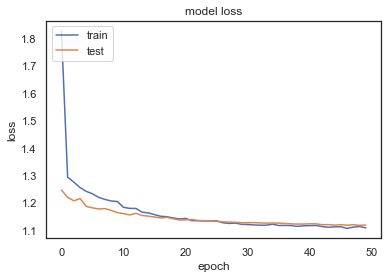

TEST WMSE =  1.0426912571460085
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 158.29879665374756


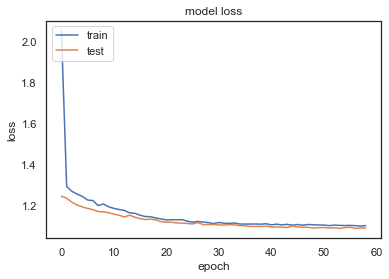

TEST WMSE =  1.0995776453990742
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00066: early stopping
duration: 167.4681568145752


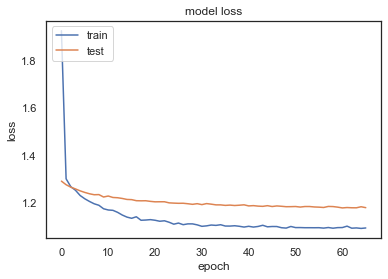

TEST WMSE =  1.134804699124247
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 71.89416193962097


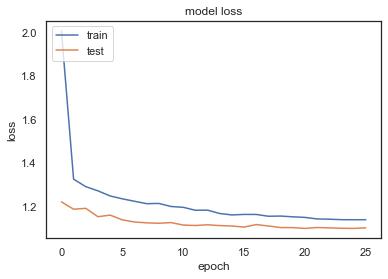

TEST WMSE =  1.1102655399230414
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 98.71152210235596


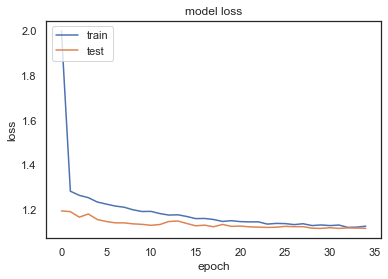

TEST WMSE =  1.0939359309444625
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 62.16118788719177


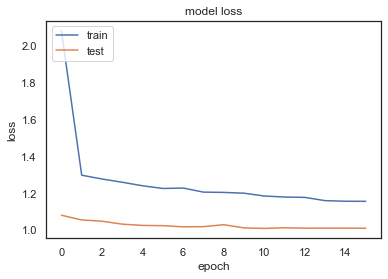

TEST WMSE =  1.143643880418125
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 89.36665081977844


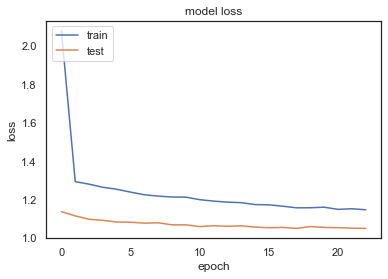

TEST WMSE =  1.0388270063555762
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 137.76762008666992


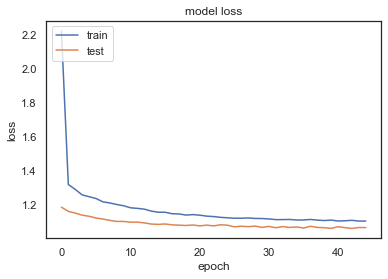

TEST WMSE =  1.1214710914684636
TEST MEAN WMSE =  1.1214710914684636


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 22
-----


-----
 FEATURE NAME -- H3K27me3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 178.05148696899414


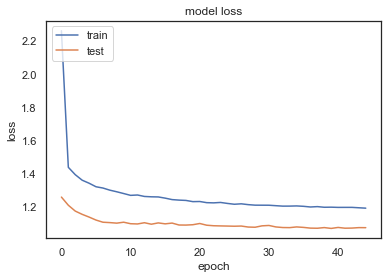

TEST WMSE =  1.1599109011116278
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 114.25165605545044


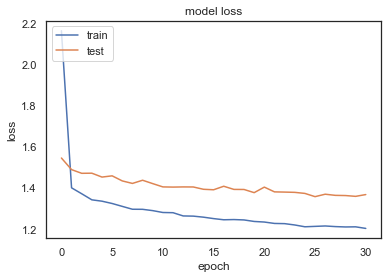

TEST WMSE =  1.2482258856800568
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 99.4153892993927


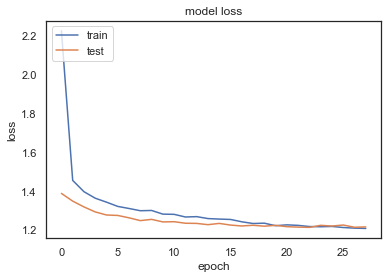

TEST WMSE =  1.136242111875214
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00058: early stopping
duration: 171.79908108711243


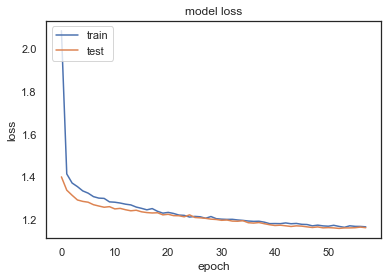

TEST WMSE =  1.186035676052841
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 156.25518107414246


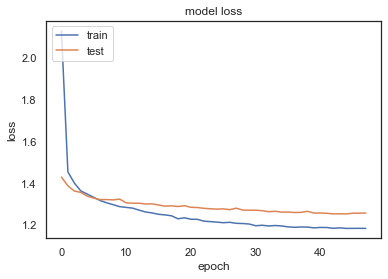

TEST WMSE =  1.2151509638780236
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00055: early stopping
duration: 169.92454028129578


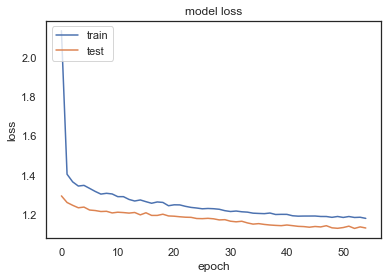

TEST WMSE =  1.163628363197394
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 90.78420996665955


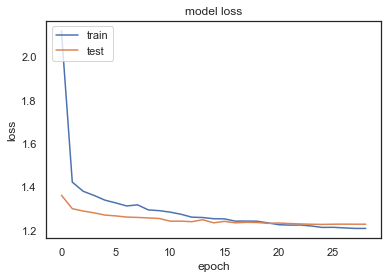

TEST WMSE =  1.1877682818012312
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00033: early stopping
duration: 100.57267785072327


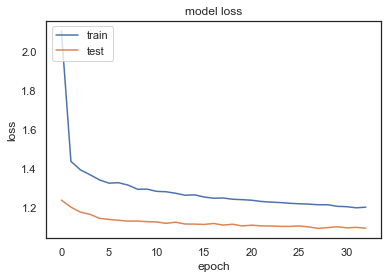

TEST WMSE =  1.2219287750671826
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 234.76339077949524


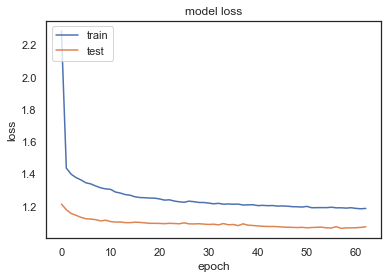

TEST WMSE =  1.0977013211354794
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 80.15872693061829


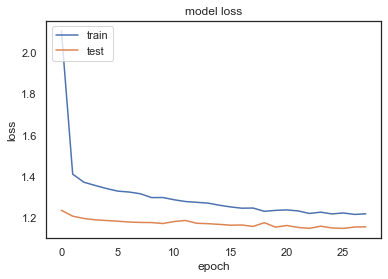

TEST WMSE =  1.211906012665415
TEST MEAN WMSE =  1.211906012665415
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 74.61324095726013


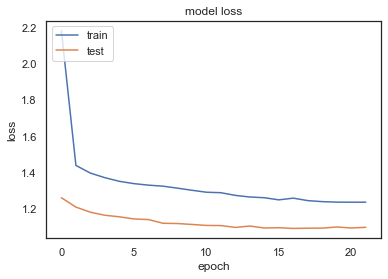

TEST WMSE =  1.183242741657498
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 159.19655585289001


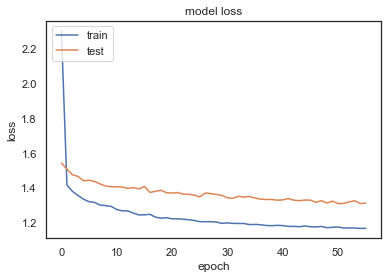

TEST WMSE =  1.213925603690649
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 1824.7553448677063


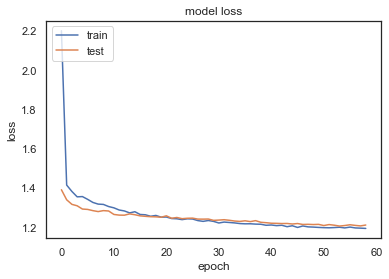

TEST WMSE =  1.1169800194267852
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00065: early stopping
duration: 231.1821539402008


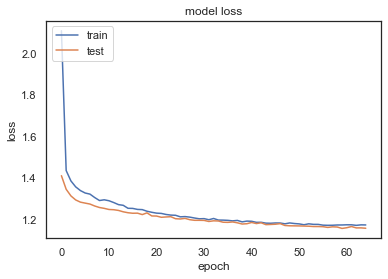

TEST WMSE =  1.1758768708684293
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 163.42615699768066


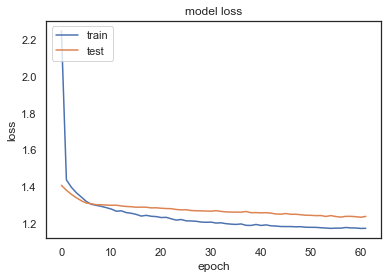

TEST WMSE =  1.2066607206637796
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 121.10125684738159


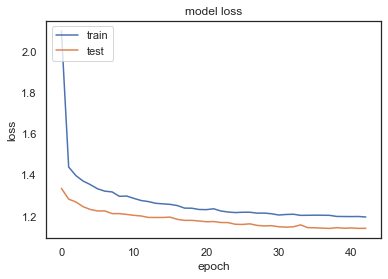

TEST WMSE =  1.1700572715334283
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 47.58301591873169


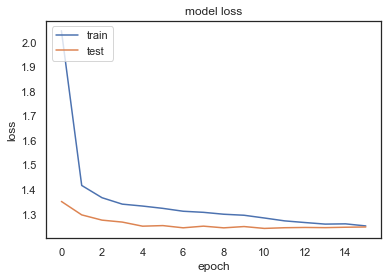

TEST WMSE =  1.2082269579437637
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 97.74596405029297


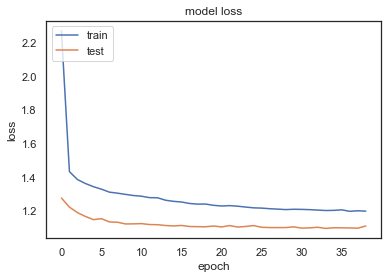

TEST WMSE =  1.216237956508635
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00061: early stopping
duration: 179.02038598060608


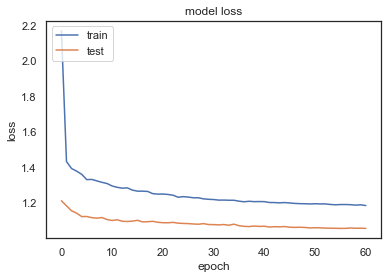

TEST WMSE =  1.090762383933258
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 128.33596110343933


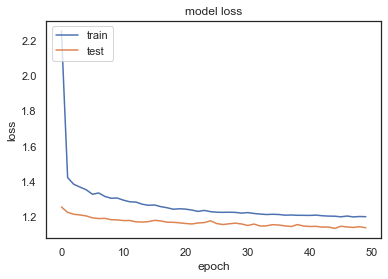

TEST WMSE =  1.1987089438330374
TEST MEAN WMSE =  1.1987089438330374
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 100.15573716163635


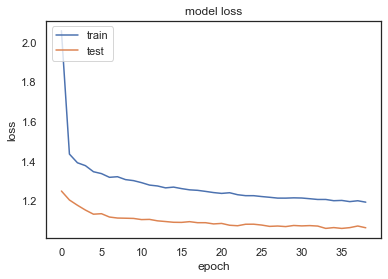

TEST WMSE =  1.1588893241386762
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 57.05579423904419


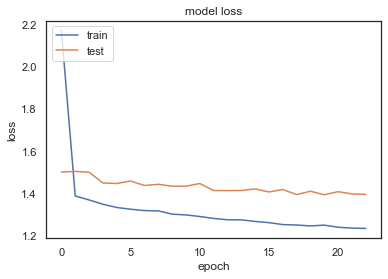

TEST WMSE =  1.253268030057896
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00046: early stopping
duration: 137.56569004058838


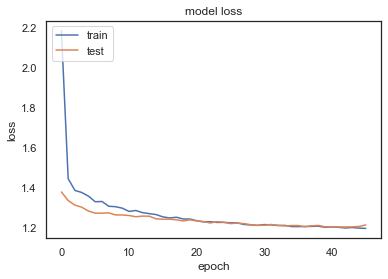

TEST WMSE =  1.1231416249977053
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00080: early stopping
duration: 228.10744500160217


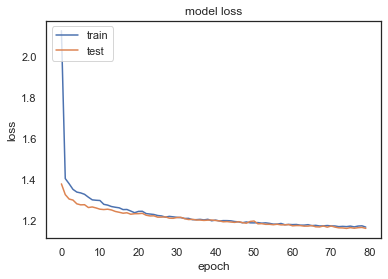

TEST WMSE =  1.176670310885624
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 139.1364448070526


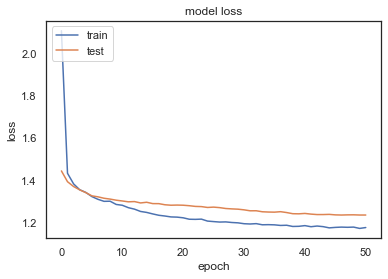

TEST WMSE =  1.1994330485487357
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00062: early stopping
duration: 178.78743982315063


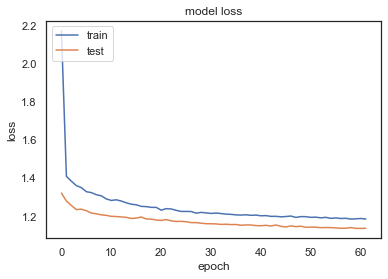

TEST WMSE =  1.1630106236757347
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 99.95036196708679


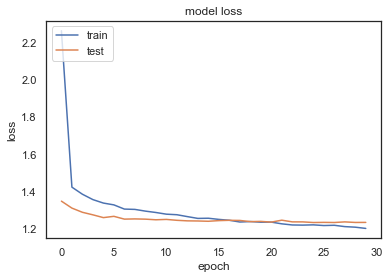

TEST WMSE =  1.1872084444387623
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 83.7746479511261


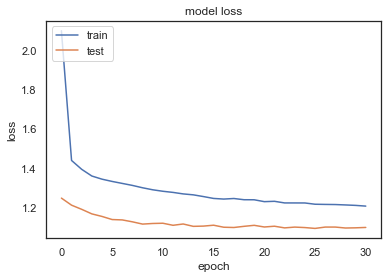

TEST WMSE =  1.2245192478639244
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 74.09365820884705


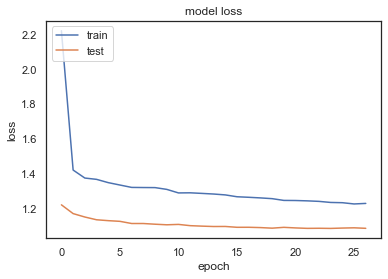

TEST WMSE =  1.1241127461469291
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 58.398175954818726


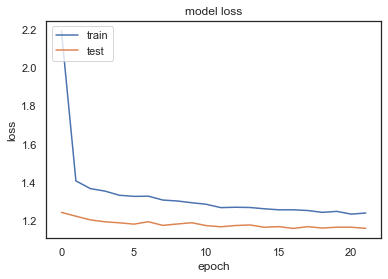

TEST WMSE =  1.2272363314026717
TEST MEAN WMSE =  1.2272363314026717


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 23
-----


-----
 FEATURE NAME -- H3K36me1
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 99.85779905319214


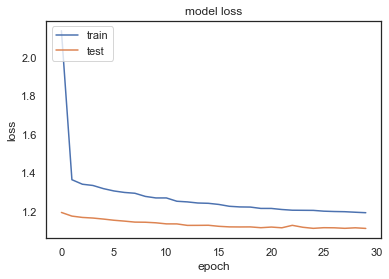

TEST WMSE =  1.13769859846114
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 72.12449312210083


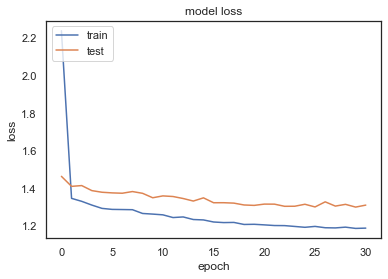

TEST WMSE =  1.1724600215852887
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 68.1945309638977


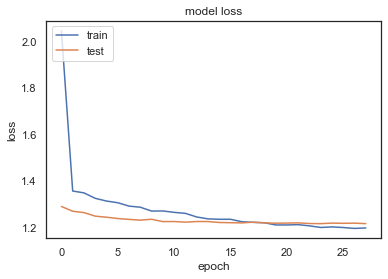

TEST WMSE =  1.1318125923186504
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 98.29013705253601


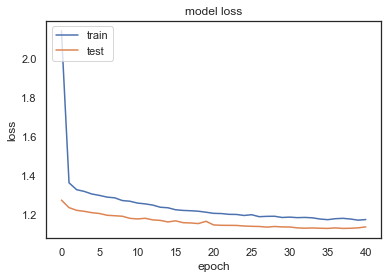

TEST WMSE =  1.2082355296762695
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 108.62983298301697


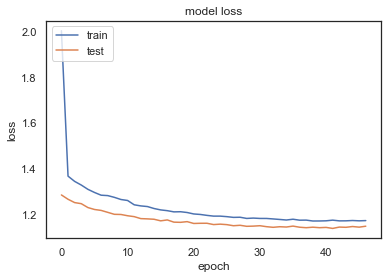

TEST WMSE =  1.2372392636368448
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 833.6520118713379


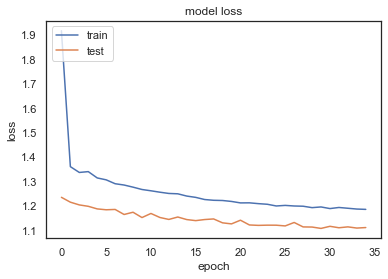

TEST WMSE =  1.1998197328228974
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 95.40985989570618


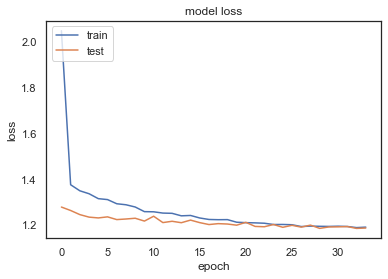

TEST WMSE =  1.1575311574662068
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 70.51432585716248


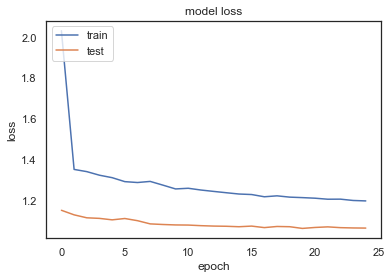

TEST WMSE =  1.218390905092955
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 107.07819700241089


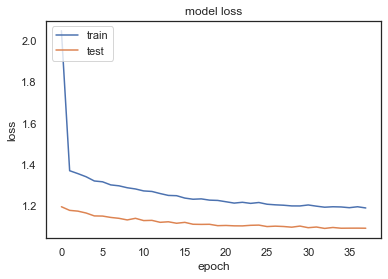

TEST WMSE =  1.1001028054131679
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00019: early stopping
duration: 49.82890295982361


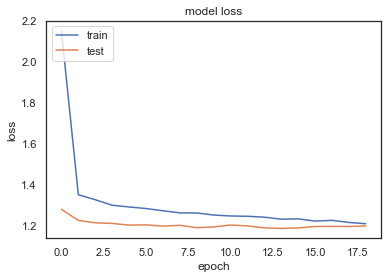

TEST WMSE =  1.2167141870157463
TEST MEAN WMSE =  1.2167141870157463
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 79.8565080165863


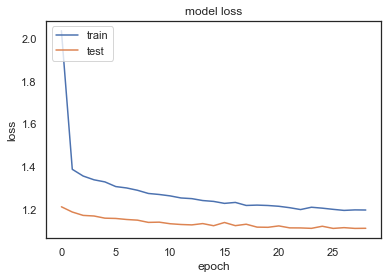

TEST WMSE =  1.147292906752796
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 108.30321884155273


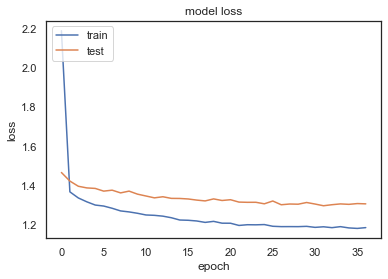

TEST WMSE =  1.1679475826041303
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00044: early stopping
duration: 113.84663605690002


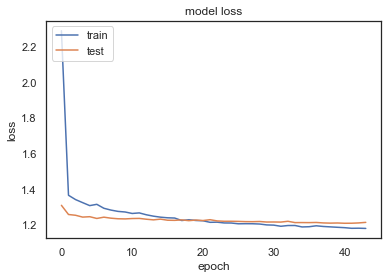

TEST WMSE =  1.1318636724664883
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 90.12051105499268


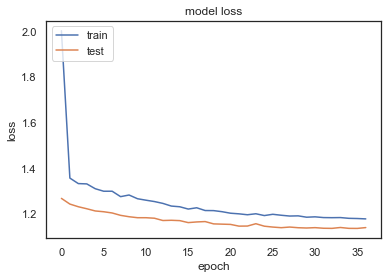

TEST WMSE =  1.203251328936789
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 137.30187392234802


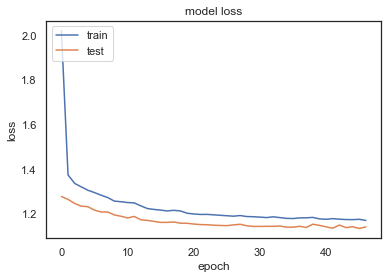

TEST WMSE =  1.23771434943378
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 60.353498697280884


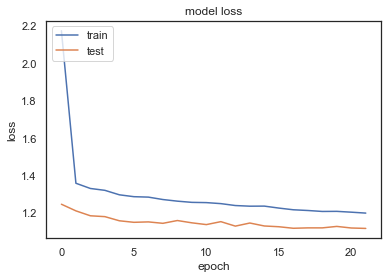

TEST WMSE =  1.2072685671427095
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 80.62134909629822


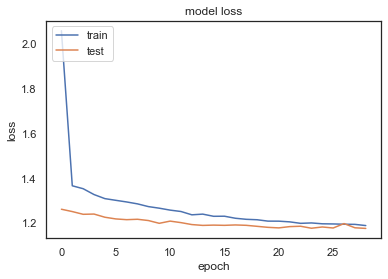

TEST WMSE =  1.1491022368135666
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 92.6532690525055


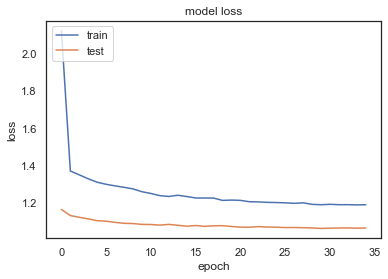

TEST WMSE =  1.2170955268737222
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 136.4518518447876


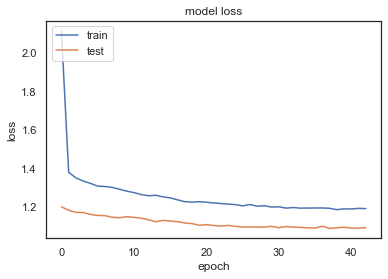

TEST WMSE =  1.100637221483671
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 1004.865152835846


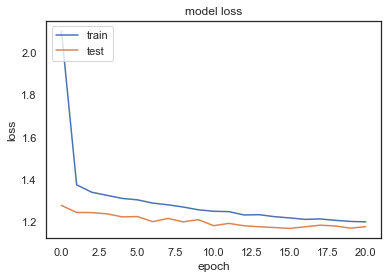

TEST WMSE =  1.2115916076904272
TEST MEAN WMSE =  1.2115916076904272
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 119.03955483436584


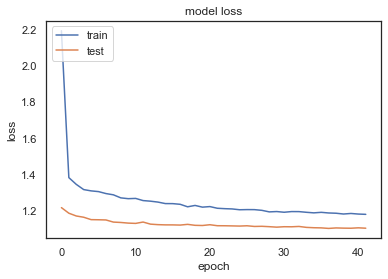

TEST WMSE =  1.1328945346388615
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 92.9394748210907


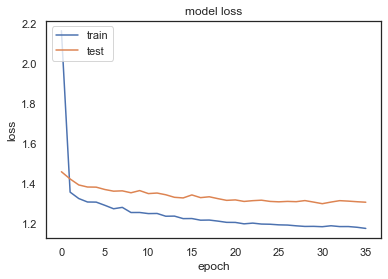

TEST WMSE =  1.164801909094601
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 59.11070394515991


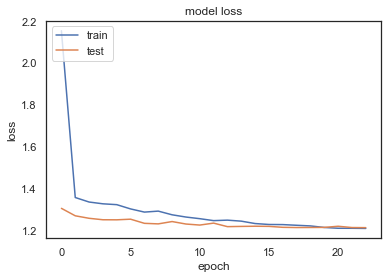

TEST WMSE =  1.1359226996284804
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 116.34757208824158


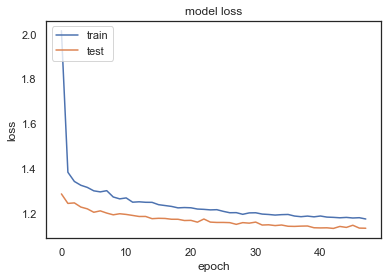

TEST WMSE =  1.2004548309965999
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 97.05129504203796


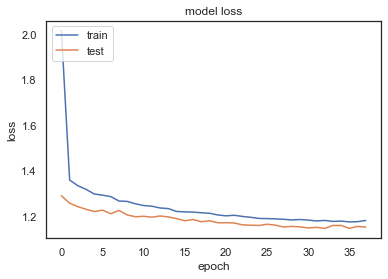

TEST WMSE =  1.2404800920429522
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 86.08896589279175


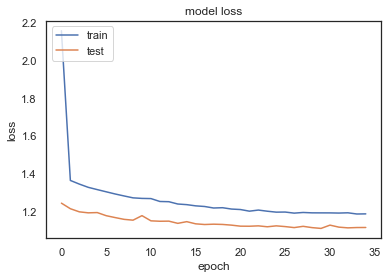

TEST WMSE =  1.1963377633668348
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 64.24402403831482


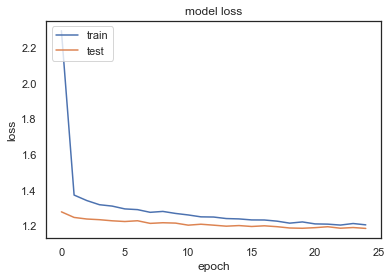

TEST WMSE =  1.1685865970177163
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 114.35507702827454


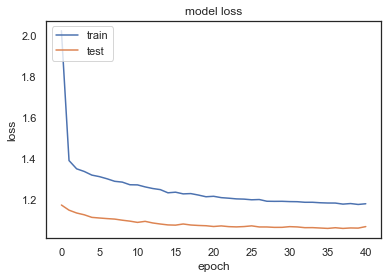

TEST WMSE =  1.2242090873961398
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00045: early stopping
duration: 123.58479380607605


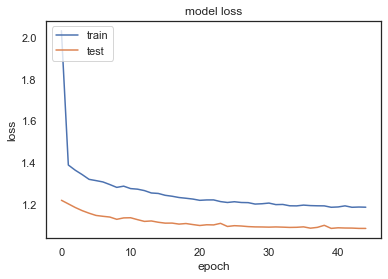

TEST WMSE =  1.1093512749347958
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 64.7200620174408


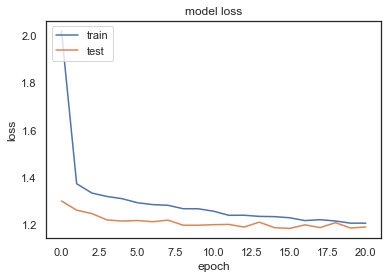

TEST WMSE =  1.2133470637758659
TEST MEAN WMSE =  1.2133470637758659


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 24
-----


-----
 FEATURE NAME -- H3K36me3
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 68.7817280292511


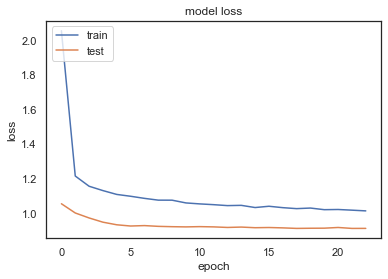

TEST WMSE =  0.9339917590078053
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00029: early stopping
duration: 78.80160212516785


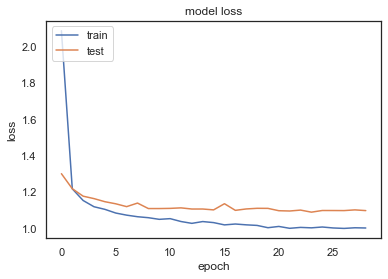

TEST WMSE =  0.9531765141894759
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 146.06069707870483


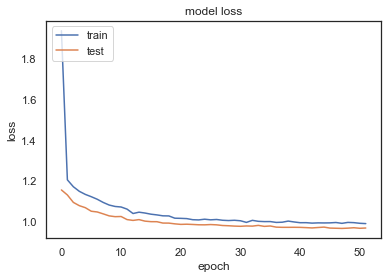

TEST WMSE =  0.9576388069427882
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00038: early stopping
duration: 100.94272303581238


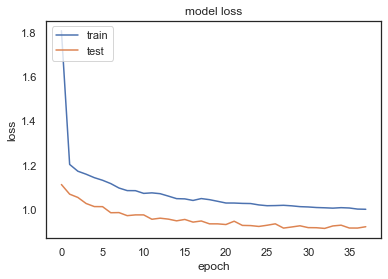

TEST WMSE =  0.9434526954436909
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 149.07595109939575


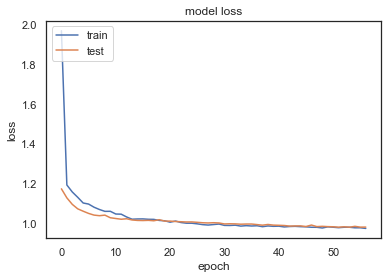

TEST WMSE =  1.0305384922077048
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 132.62341475486755


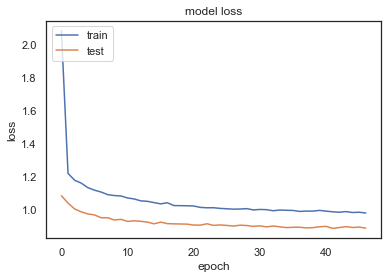

TEST WMSE =  1.0034828344576157
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 48.59981894493103


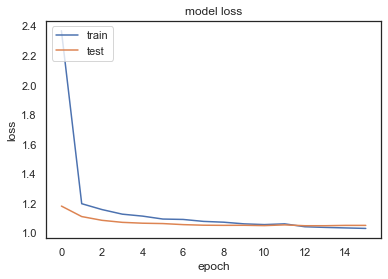

TEST WMSE =  0.9822913207131081
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00021: early stopping
duration: 58.288557052612305


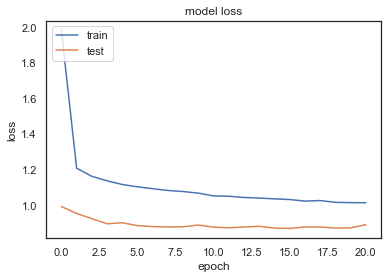

TEST WMSE =  1.0546697882707692
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00039: early stopping
duration: 120.25290012359619


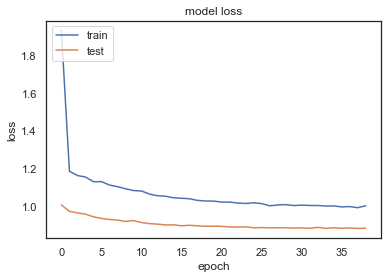

TEST WMSE =  0.934026268284529
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 80.56968092918396


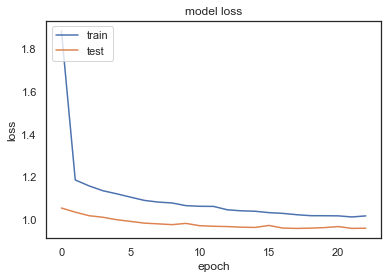

TEST WMSE =  0.9879842304273647
TEST MEAN WMSE =  0.9879842304273647
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00023: early stopping
duration: 78.72639584541321


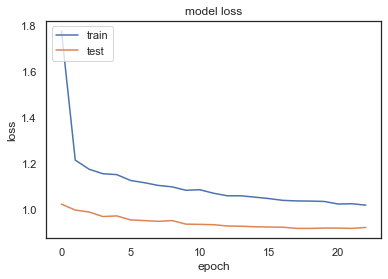

TEST WMSE =  0.9398340380315879
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 75.65690279006958


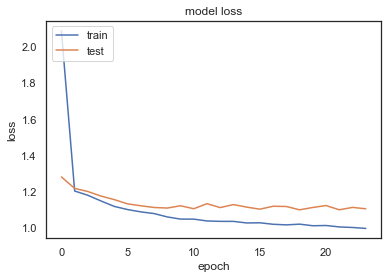

TEST WMSE =  0.9550947403818452
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00053: early stopping
duration: 215.28527188301086


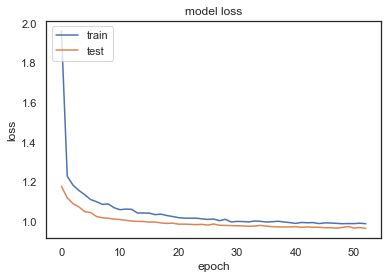

TEST WMSE =  0.9572771493301726
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00025: early stopping
duration: 84.84649801254272


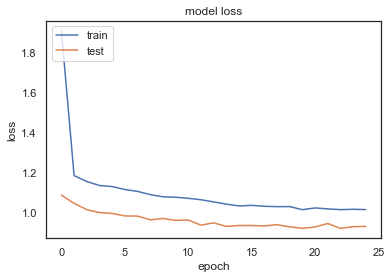

TEST WMSE =  0.9574815619934465
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00063: early stopping
duration: 236.67613315582275


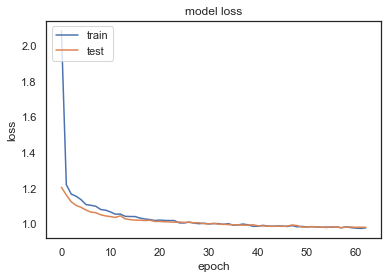

TEST WMSE =  1.027963222207657
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 122.6462779045105


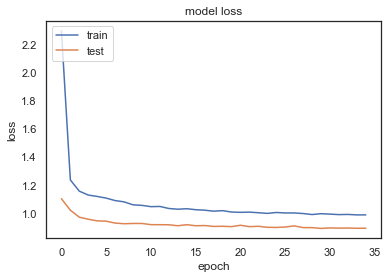

TEST WMSE =  1.0091131816744028
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 78.62657308578491


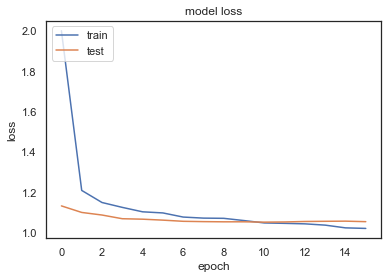

TEST WMSE =  0.9872684370786057
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 92.75955414772034


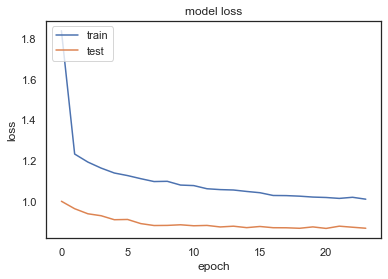

TEST WMSE =  1.0369882010020048
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 159.96100187301636


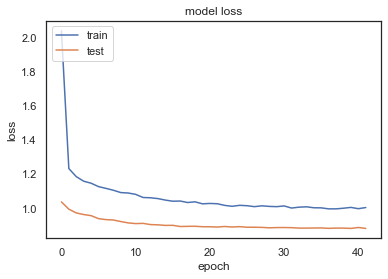

TEST WMSE =  0.9296802229244225
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 242.52826809883118


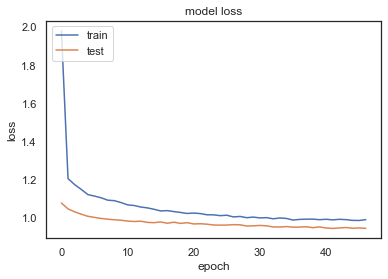

TEST WMSE =  0.978033160566691
TEST MEAN WMSE =  0.978033160566691
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00026: early stopping
duration: 147.5554268360138


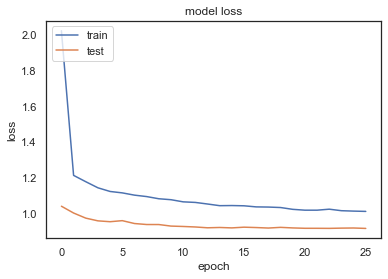

TEST WMSE =  0.9311357287034536
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00018: early stopping
duration: 83.9030020236969


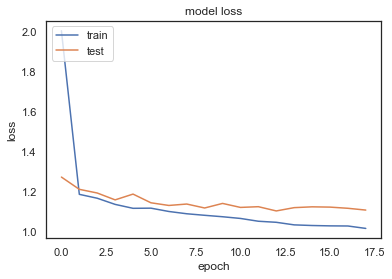

TEST WMSE =  0.9618826857535197
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00048: early stopping
duration: 135.79431915283203


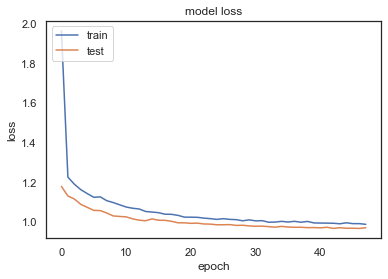

TEST WMSE =  0.9572983936325744
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00028: early stopping
duration: 99.72401475906372


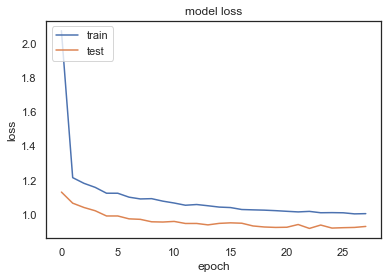

TEST WMSE =  0.9488218493753249
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 210.73463487625122


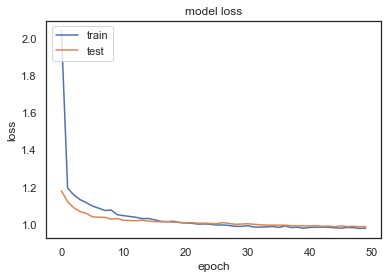

TEST WMSE =  1.0321098900275607
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00022: early stopping
duration: 75.41509795188904


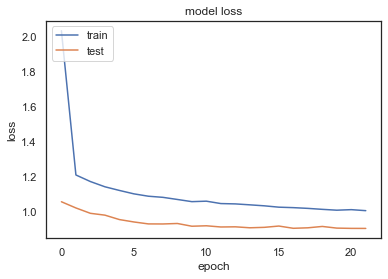

TEST WMSE =  1.0158663712607334
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00015: early stopping
duration: 58.643049001693726


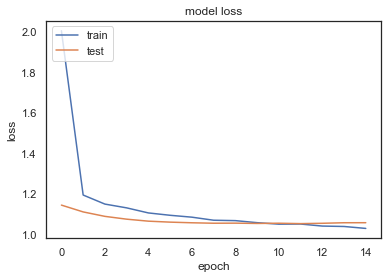

TEST WMSE =  0.9837190835150874
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00013: early stopping
duration: 51.743396043777466


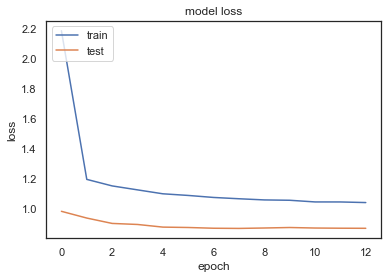

TEST WMSE =  1.0467446644076055
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00016: early stopping
duration: 63.17705178260803


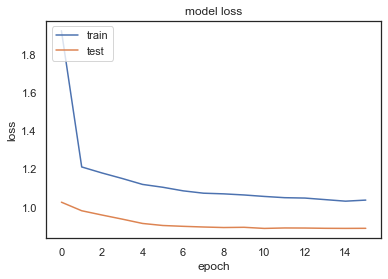

TEST WMSE =  0.9385860765685364
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00042: early stopping
duration: 149.61837005615234


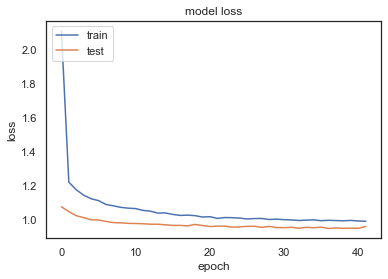

TEST WMSE =  0.9885716694072201
TEST MEAN WMSE =  0.9885716694072201


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:150: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



-----
 USE FEATURE NUMBER -- 25
-----


-----
 FEATURE NAME -- H4K16ac
-----

X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00032: early stopping
duration: 121.43341422080994


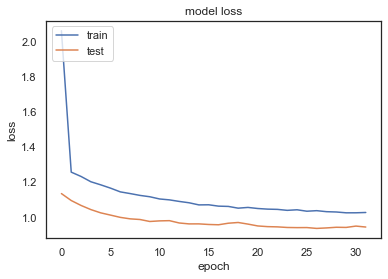

TEST WMSE =  0.9761018666489186
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00027: early stopping
duration: 125.92348575592041


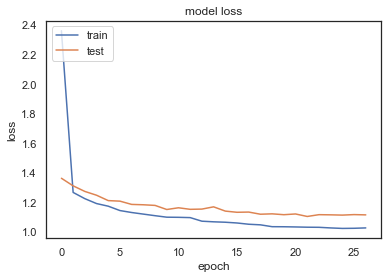

TEST WMSE =  0.9862036349065998
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00052: early stopping
duration: 172.8870348930359


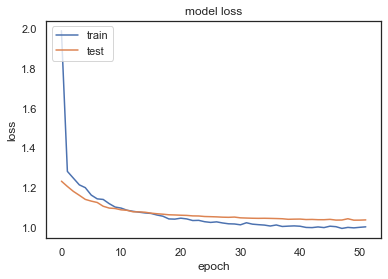

TEST WMSE =  0.9682086299373037
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00030: early stopping
duration: 83.20223808288574


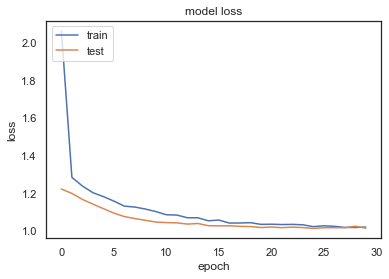

TEST WMSE =  0.9696903235802381
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 131.31249594688416


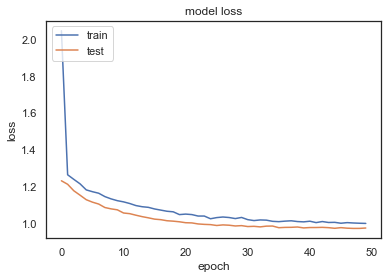

TEST WMSE =  1.0329083895271263
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00047: early stopping
duration: 141.44866585731506


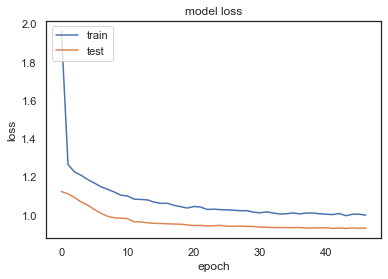

TEST WMSE =  1.0054155594651755
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 113.26589918136597


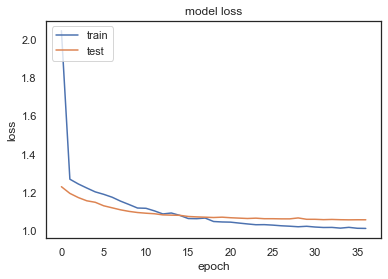

TEST WMSE =  0.9645336421603186
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00043: early stopping
duration: 121.73129916191101


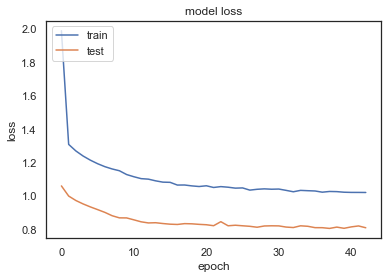

TEST WMSE =  1.0307811951412498
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00020: early stopping
duration: 46.4024600982666


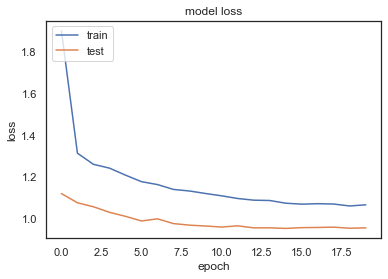

TEST WMSE =  0.9596477834085818
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 79.36924600601196


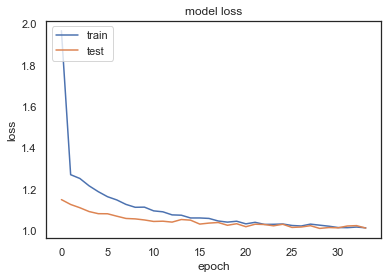

TEST WMSE =  1.0149297577499163
TEST MEAN WMSE =  1.0149297577499163
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00056: early stopping
duration: 175.66525983810425


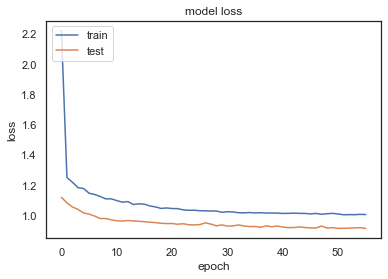

TEST WMSE =  0.9390249457530427
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 74.51856112480164


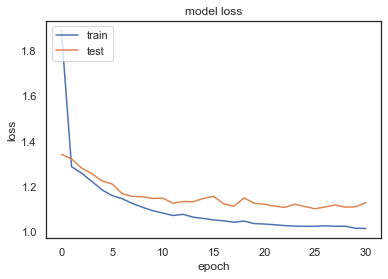

TEST WMSE =  0.9915684168505149
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00041: early stopping
duration: 90.77868795394897


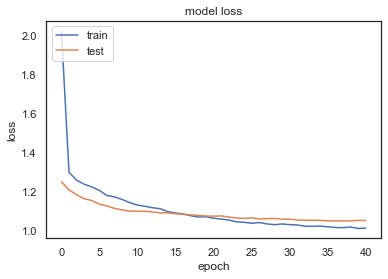

TEST WMSE =  0.9765891088926044
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 134.80202388763428


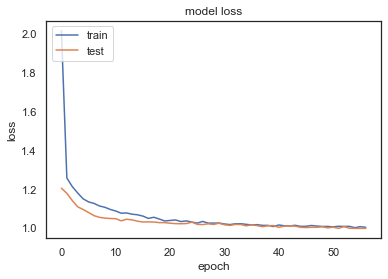

TEST WMSE =  0.9529861706872527
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00051: early stopping
duration: 123.41613101959229


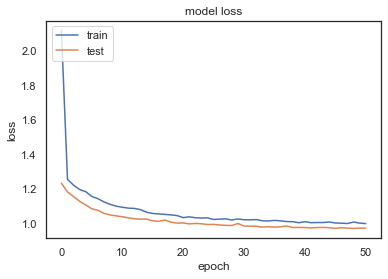

TEST WMSE =  1.0281465326339092
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00050: early stopping
duration: 141.968013048172


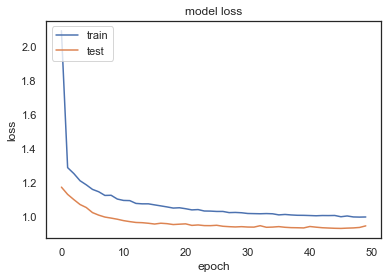

TEST WMSE =  1.0109612082149289
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00059: early stopping
duration: 164.43491506576538


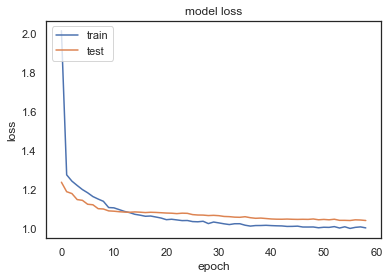

TEST WMSE =  0.9578478839208965
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 67.18316388130188


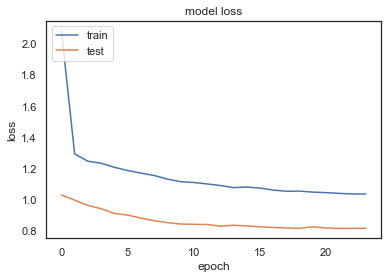

TEST WMSE =  1.0331312084075868
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00035: early stopping
duration: 92.45303511619568


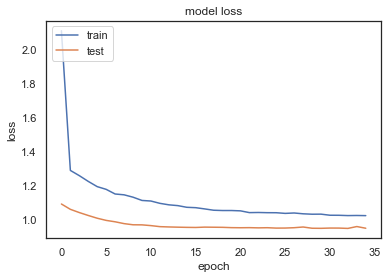

TEST WMSE =  0.9474446961113482
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00031: early stopping
duration: 80.31839203834534


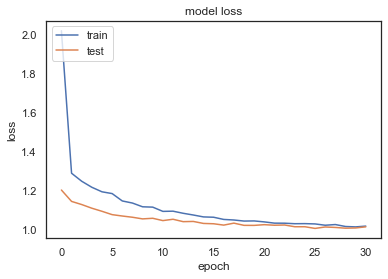

TEST WMSE =  1.017241733812298
TEST MEAN WMSE =  1.017241733812298
X_train.shape, X_test.shape, y_train.shape, y_test.shape = (12491, 6, 1) (3747, 6, 1) (12491,) (3747,)
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00036: early stopping
duration: 90.70184874534607


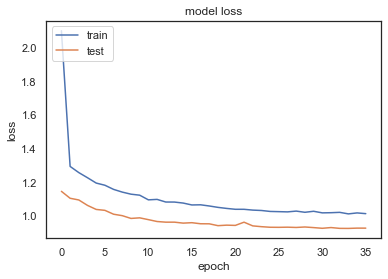

TEST WMSE =  0.9666215768302752
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00034: early stopping
duration: 75.00738191604614


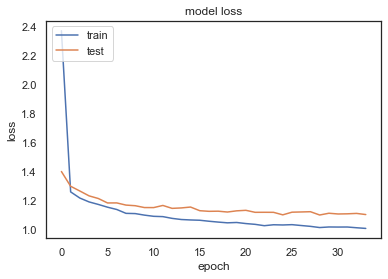

TEST WMSE =  0.9825544868168031
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00057: early stopping
duration: 118.69110703468323


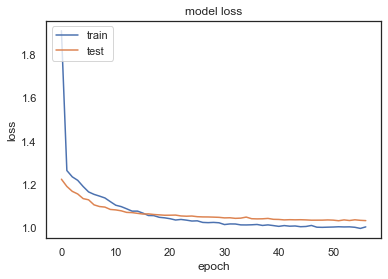

TEST WMSE =  0.9686545094289727
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00024: early stopping
duration: 56.12378811836243


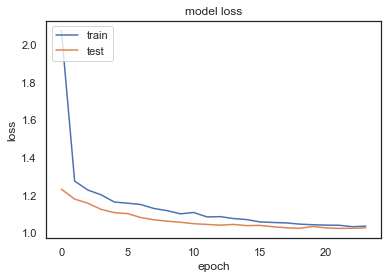

TEST WMSE =  0.9784473578964932
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16060, 6, 1)
y_train.shape = (16060,)
min_delta =  0.001 patience =  5
Train... with 
Epoch 00037: early stopping
duration: 59.98225784301758


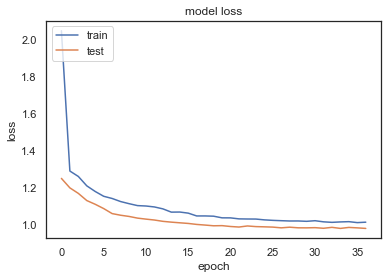

TEST WMSE =  1.0355110805905552
x_val.shape = (536, 6, 1)
y_val.shape = (536,)
x_train.shape = (16061, 6, 1)
y_train.shape = (16061,)
min_delta =  0.001 patience =  5
Train... with 


In [ ]:
data_csv = "_3cl_18_bioset_3_exps_10cv_drops_13_05_20.csv"

num_experements = 3

cell_line =  'all'  #  'is_s2' #  'is_bg' # 'all' # 'is_s2' # cell_line one of: 'is_s2', 'is_kc', 'is_bg',  or 'all'


bioset = None  # bioset: defines the biological features to use. 
               #  If bioset is None, use all availible features
# bioset = ['Chriz', 'CTCF', 'Su(Hw)', 'H3K27me3', 'H3K27ac',
#          'is_s2', 'is_kc', 'is_bg', 
#          'chrN', 'start_coord']

# bioset = [ 
#     'H3K4me2', 
#     'ISWI',
#     'Chriz',
#     'WDS', 
#     'MRG15',
#     'H3K79me3', 
#     'RNA-polymerase-II',
#     'H1', 
#     'H3K27me3',
#     'is_s2', 'is_kc', 'is_bg', 
#     'chrN', 
#     'start_coord',
#   ]


# data_features_path   = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_18features = '../../data/epigenetics/s2_kc_bg_scaled_18_features.csv'
data_path_35features = '../../data/epigenetics/s2_kc_bg_scaled_34_overlap_features_2901.csv'
data_path = data_path_18features

target_path = "../../data/target/s2_kc_bg_clean_gamma_2901.csv"
index_col = 0

random_state = 16 # None  # Shuffle the data splittings
batch_size = 60 
sequenc_len_list =  [6]
num_lstm_units = 64 
n_epochs_max = 364 
num_folds = 10
file_path = "./exps" + data_csv
use_chr_onehotenc = True
use_coord_scale = True

eval_models_df_1_10x_18f, eval_models_df_drop_10x_18f, eval_models_df_together_10cv_18f_dr, \
            mean_together_10x_5f, std_together_10x_5f, feature_score_1, feature_score_drop, \
            data_scaled_clean, target_clean, = main_analysis(data_path,  
                                                       cell_line, 
                                                       bioset, 
                                                       num_experements,
                                                       sequenc_len_list = [6], 
                                                       num_lstm_units = 6,
                                                       num_folds = num_folds,
                                                       batch_size = batch_size,
                                                       do_only_1_feature_exps = True, 
                                                       do_drop_1_feature_exps = True,
                                                       do_all_together = True,
                                                       use_chr_onehotenc = use_chr_onehotenc,
                                                       use_coord_scale=use_coord_scale,
                                                       verbose=True)

eval_models_df_together_10cv_18f_dr

In [ ]:

eval_models_df_together_10cv_18f_dr